In [1]:
#tweet cleaning
#https://www.kaggle.com/ragnisah/text-data-cleaning-tweets-analysis
#https://towardsdatascience.com/basic-data-cleaning-engineering-session-twitter-sentiment-data-95e5bd2869ec

#Topic Modeilling
#https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0

#Cleaning
#Puncuation
#lower case
#stopwords
#abbreviations

# Importing modules
import pandas as pd
import os

# Load the regular expression library
import re

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
import nltk as nltk
nltk.download('stopwords')
nltk.download('wordnet')
import gensim
from gensim.utils import simple_preprocess
from gensim.models.wrappers import LdaMallet
from nltk.corpus import stopwords
import string
import re
%matplotlib inline
pd.set_option('display.max_colwidth', 100)
import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)

import pyLDAvis.gensim
import pickle 
import pyLDAvis
#import spacy
#from scispacy.abbreviation import AbbreviationDetector

#sentiment analysis
#https://medium.com/swlh/simple-sentiment-analysis-for-nlp-beginners-and-everyone-else-using-vader-and-textblob-728da3dbe33d
import sqlite3
from textblob import TextBlob
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\megha\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\megha\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
C:\Users\megha\anaconda3\lib\site-packages\sklearn\decomposition\_lda.py:28: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  EPS = np.finfo(np.float).eps


In [2]:
warnings.filterwarnings("ignore",category=DeprecationWarning)

C:\Users\megha\anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [3]:
diabetes_all = pd.read_csv('all_diabetes.csv')

In [4]:
# Print head
diabetes_all

,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/


In [5]:
#remove any blank texts
diabetes_all = diabetes_all[diabetes_all['Text'].notna()]
diabetes_all

,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/


In [6]:
#remove posts with less than 5 words
word_count = diabetes_all['Text'].str.split().str.len()
~(word_count < 5)

0         True
1         True
2         True
3         True
4         True
          ... 
100882    True
100883    True
100884    True
100885    True
100886    True
Name: Text, Length: 98560, dtype: bool

In [7]:
diabetes_all = diabetes_all [~(word_count < 5)]
diabetes_all

,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/


In [8]:
#remove any duplicate posts
diabetes_all = diabetes_all.drop_duplicates(subset=['Text'])
diabetes_all

,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/


In [9]:
#remove url from text
diabetes_all['Text'] = diabetes_all['Text'].apply(lambda x: re.split('http:\/\/.*', str(x))[0])
diabetes_all['Text'] = diabetes_all['Text'].apply(lambda x: re.split('https:\/\/.*', str(x))[0])
diabetes_all

<ipython-input-9-78d2816d99c6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['Text'] = diabetes_all['Text'].apply(lambda x: re.split('http:\/\/.*', str(x))[0])
<ipython-input-9-78d2816d99c6>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['Text'] = diabetes_all['Text'].apply(lambda x: re.split('https:\/\/.*', str(x))[0])


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/


In [10]:
#view gensim stopwords
all_stopwords = gensim.parsing.preprocessing.STOPWORDS
print(all_stopwords)

frozenset({'hereupon', 'eg', 'another', 'amongst', 'nor', 'sometime', 'what', 'found', 'seeming', 'with', 'didn', 'by', 'doesn', 'i', 'more', 'thereupon', 'now', 'whoever', 'these', 'ltd', 'third', 'being', 'hence', 'your', 'then', 'don', 'cannot', 'at', 'should', 'thereby', 'anyway', 'per', 'against', 'only', 'front', 'them', 'why', 'towards', 'show', 'that', 'whatever', 'thus', 'us', 'somewhere', 'ever', 'elsewhere', 'hereafter', 'latter', 'beforehand', 'in', 'could', 'not', 'toward', 'when', 'interest', 'out', 'fifty', 'but', 'due', 'nine', 'someone', 'ours', 'unless', 'others', 'off', 'sometimes', 'neither', 'amount', 'any', 'as', 'nobody', 'can', 'etc', 'a', 'noone', 'full', 'everyone', 'into', 'too', 'first', 'herein', 'co', 'after', 'eleven', 'its', 'until', 'de', 'there', 'fire', 'whenever', 'meanwhile', 'becomes', 'has', 'various', 'whether', 'side', 'whom', 'became', 'on', 'each', 'since', 'eight', 'such', 'mostly', 'during', 'say', 'hereby', 'km', 'via', 'anywhere', 'anyone'

In [11]:
#stopword libraries https://stackabuse.com/removing-stop-words-from-strings-in-python/
#gensim stopwords
from gensim.parsing.preprocessing import remove_stopwords


#text = "Nick likes to play football, however he is not too fond of tennis."
#filtered_sentence = remove_stopwords(text)

#print(filtered_sentence)
#def remove_stopwords(text):
    #text = [word for word in text if word not in stopword]
    #print(text)
    #return text
    
#diabetes2018['text_nonstop'] = diabetes2018['text_tokenized'].apply(lambda x: remove_stopwords(x))
#diabetes2018.head(10)

diabetes_all['text_gens_nonstop'] = diabetes_all['Text'].apply(lambda x: remove_stopwords(x))
diabetes_all

<ipython-input-11-c020e4ae435a>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_gens_nonstop'] = diabetes_all['Text'].apply(lambda x: remove_stopwords(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use ."
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ..."
...,...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN,"I didn't effects, fyi. Some people don't."
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN,Fasting brought numbers were! I keto omad came 160-200s 85-120 month.
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/,I've battling depression anxiety like living end times. I apprehensive getting blood work I've s...
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/,So it’s week I diagnosed. Metformin 1000mg twice day. BS 200 days. Problem I eat literally going...


In [12]:
#Remove punctuations & upper case
#Remove stopwords
#Lammetization/stemming - Tranforming any form of a word to its root word
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [13]:
#remove puncutation
def remove_punct(text):
    text  = "".join([char for char in text if char not in string.punctuation])
    text = re.sub('[0-9]+', '', text)
    return text

diabetes_all['text_processed'] = diabetes_all['text_gens_nonstop'].apply(lambda x: remove_punct(x))
diabetes_all.head(10)

<ipython-input-13-1843cac758be>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_processed'] = diabetes_all['text_gens_nonstop'].apply(lambda x: remove_punct(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,Hey all Happy New years Just wanted hi I diagnosed type DM Thursday Ive crazy fatigued thirsty ...
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",Hello Im lbs male Type diabetes Ive looking Keto way lose weight hopefully lower medication im...
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,I ac checked today its Threefour months ago Im taken metformin and Ill tested months see Im ex...
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",Hey old post congrats This motivating Side note desk cycle for I got sure reasonable time use
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",I stick fitbit ankle count steps I end entire time Im desk days hours not usually fast I k step...
5,7nnogn,jdong4321,"My mom has diabetes and I check a lot of the symptoms of type 2, and have for a few months now b...",1,2018-01-02 9:02,/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,Type 2,6.0,"I think I have diabetes but I'm overseas travelling for another 45 days, how urgent is it?",https://www.reddit.com/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,"My mom diabetes I check lot symptoms type 2, months I lazy/in denial (I know, I'm actual idiot) ...",My mom diabetes I check lot symptoms type months I lazyin denial I know Im actual idiot go Just...
6,7npao8,douglas4321,"I am type 2 not on insulin, my doctor has told me to take it before bed. I have heard people say...",1,2018-01-02 12:51,/r/diabetes/comments/7npao8/when_is_the_best_time_to_take_my_10mg_jardiance/,Type 2,2.0,when is the best time to take my 10mg jardiance Pill?,https://www.reddit.com/r/diabetes/comments/7npao8/when_is_the_best_time_to_take_my_10mg_jardiance/,"I type 2 insulin, doctor told bed. I heard people best directly largest meal day. Wondering cons...",I type insulin doctor told bed I heard people best directly largest meal day Wondering consensu...
8,7ntfa9,SeanP93,"Hey y’all,\n\nI’m 24-years-old, a couple pounds shy of 140 pounds, and if a stranger saw me they...",7,2018-01-03 0:43,/r/diabetes/comments/7ntfa9/new_young_type_ii_here_looking_for_help_guidance/,Type 2,17.0,"New, young type II here.. looking for help, guidance, advice, and

In [14]:
#switch to lower case
diabetes_all['text_processed'] = \
diabetes_all['text_processed'].map(lambda x: x.lower())
diabetes_all

<ipython-input-14-3b3093dd6c42>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_processed'] = \


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...
...,...,...,...,...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",1,2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,NaN,NaN,"I didn't effects, fyi. Some people don't.",i didnt effects fyi some people dont
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,1,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,NaN,NaN,Fasting brought numbers were! I keto omad came 160-200s 85-120 month.,fasting brought numbers were i keto omad came s month
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,39,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,9.0,5.4 A1C!!!,https://www.reddit.com/r/type2diabetes/comments/lthxwe/54_a1c/,I've battling depression anxiety like living end times. I apprehensive getting blood work I've s...,ive battling depression anxiety like living end times i apprehensive getting blood work ive slac...
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,10.0,Still new to this.....,https://www.reddit.com/r/type2diabetes/comments/lu13pm/still_new_to_this/,So it’s week I diagnosed. Metformin 1000mg twi

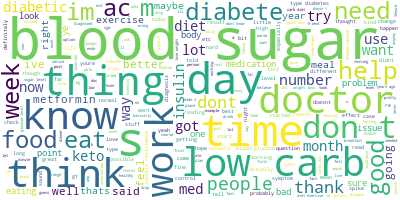

In [15]:
# Import the wordcloud library
from wordcloud import WordCloud, STOPWORDS , ImageColorGenerator

# Join the different processed titles together.
long_string = ','.join(list(diabetes_all['text_processed'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue')

# Generate a word cloud
wordcloud.generate(long_string)

# Visualize the word cloud
wordcloud.to_image()

In [16]:
#tokenization
def tokenization(text):
    text = re.split('\W+', text)
    return text

diabetes_all['text_tokenized'] = diabetes_all['text_processed'].apply(lambda x: tokenization(x.lower()))
diabetes_all.head(10)

<ipython-input-16-39d95f6d7200>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_tokenized'] = diabetes_all['text_processed'].apply(lambda x: tokenization(x.lower()))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona..."
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...,"[i, stick, fitbit, ankle, count, steps, i, end, entire, time, im, desk, days, hours, not, usuall..."
5,7nnogn,jdong4321,"My mom has diabetes and I check a lot of the symptoms of type 2, and have for a few months now b...",1,2018-01-02 9:02,/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,Type 2,6.0,"I think I have diabetes but I'm overseas travelling for another 45 days, how urgent is it?",https://www.reddit.com/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,"My mom diabetes I check lot symptoms type 2, months I lazy/in denial (I know, I'm actual idiot) ...",my mom diabetes i check lot symptoms type months i lazyin denial i know im actual idiot go just...,"[my, mom, diabetes, i, check, lot, symptoms, type, months, i, lazyin, denial, i, know, im, actua..."
6,7npao8,douglas4321,"I am type 2 not on insulin, my doctor has told me to take it before bed. I have heard people say...",1,2018-01-02 12:51,/r/diabetes/comments/7npao8/when_is_the_best_time_to_take_my_10mg_jardiance/,Type 2,2.0,when is the best tim

In [17]:
#remove special characters
diabetes_all['text_tokenized'] = diabetes_all['text_tokenized'].apply(' '.join).str.replace('[^A-Za-z\s]+', '') \
           .str.split(expand=False)
diabetes_all.head(10)

<ipython-input-17-7d5aad277fd7>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  diabetes_all['text_tokenized'] = diabetes_all['text_tokenized'].apply(' '.join).str.replace('[^A-Za-z\s]+', '') \
<ipython-input-17-7d5aad277fd7>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_tokenized'] = diabetes_all['text_tokenized'].apply(' '.join).str.replace('[^A-Za-z\s]+', '') \


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona..."
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...,"[i, stick, fitbit, ankle, count, steps, i, end, entire, time, im, desk, days, hours, not, usuall..."
5,7nnogn,jdong4321,"My mom has diabetes and I check a lot of the symptoms of type 2, and have for a few months now b...",1,2018-01-02 9:02,/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,Type 2,6.0,"I think I have diabetes but I'm overseas travelling for another 45 days, how urgent is it?",https://www.reddit.com/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,"My mom diabetes I check lot symptoms type 2, months I lazy/in denial (I know, I'm actual idiot) ...",my mom diabetes i check lot symptoms type months i lazyin denial i know im actual idiot go just...,"[my, mom, diabetes, i, check, lot, symptoms, type, months, i, lazyin, denial, i, know, im, actua..."
6,7npao8,douglas4321,"I am type 2 not on insulin, my doctor has told me to take it before bed. I have heard people say...",1,2018-01-02 12:51,/r/diabetes/comments/7npao8/when_is_the_best_time_to_take_my_10mg_jardiance/,Type 2,2.0,when is the best tim

In [18]:
#remove nlk stopwords
stopword = nltk.corpus.stopwords.words('english')
stopword.extend(['get', "didnt", 'would', 'a', 'hey', 'hello', 'hi', "ive", "im", 'like', 'also','ok',
                 "don't", "I've", "I'm", "I'll", 'id', 'dont', 'wont', 'isnt', 'hadnt', 'okay', 
                 'lol', 'youre', 'youll', 'doesnt', 'ok', 'thing', 'havent', 'thats', 
                 'diabetes', 'diabetic', 'told', 'thing', 'good', 'day', 'bad', 'cant','ago', 'yeah', 'hasnt', 'havent'])
stopword

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [19]:
#remove nlk stopwords
def remove_nlk_stopwords(text):
    text = [word for word in text if word not in stopword]
    print(text)
    return text
    
diabetes_all['text_nlk_nonstop'] = diabetes_all['text_tokenized'].apply(lambda x: remove_nlk_stopwords(x))
diabetes_all.head(10)

['happy', 'new', 'years', 'wanted', 'diagnosed', 'type', 'dm', 'thursday', 'crazy', 'fatigued', 'thirsty', 'x', 'months', 'fasting', 'glucose', 'morning', 'started', 'metformin', 'trulicity', 'eating', 'feel', 'better', 'generally', 'hungry', 'tired', 'fasting', 'glucose', 'morning', 'since', 'looking', 'forward', 'journey']
['lbs', 'male', 'type', 'looking', 'keto', 'way', 'lose', 'weight', 'hopefully', 'lower', 'medication', 'currently', 'metformin', 'gliclazide', 'jardiance', 'pills', 'total', 'risky', 'keto', 'diet', 'medication', 'jardiancealso', 'called', 'empagliflozin', 'new', 'ac', 'risen', 'mid', 'one', 'reasons', 'got', 'new', 'doctor', 'late', 'old', 'doctor', 'metformins', 'gliclazides', 'getting', 'ac', 'new', 'doctor', 'acs', 'gliclazide', 'great', 'heart', 'reduced', 'problem', 'wasnt', 'eating', 'great', 'habitstoo', 'snacking', 'meal', 'bed', 'work', 'hour', 'days', 'home', 'till', 'ac', 'went', 'till', 'hit', 'jardiancerather', 'expensive', 'drug', 'feel', 'failure',

['thank', 'taking', 'time', 'respond', 'answers', 'certainly', 'helped', 'feel', 'better', 'results', 'look', 'diets', 'closely', 'try', 'lifestyles', 'certainly', 'worried', 'damage', 'kidneys', 'based', 'albumin', 'tests', 'online']
['thanks', 'warm', 'welcome', 'tips', 'books', 'buy', 'order', 'remember', 'test', 'strips', 'gd', 'thought', 'order', 'amazon', 'though', 'excellent', 'tip', 'ask', 'personal', 'magic', 'number', 'carbs']
['albumin', 'level', 'worry', 'slightly', 'elevated', 'corrected', 'potentially']
['rketo', 'worked', 'great', 'insulin', 'nearly', 'years', 'vial', 'insulin', 'daily', 'switched', 'lazy', 'keto', 'restricted', 'calorie', 'version', 'keto', 'start', 'goal', 'lt', 'calories', 'gtg', 'protein', 'ltg', 'net', 'carbs', 'dropped', 'pounds', 'far', 'go', 'insulin', 'longer', 'taking', 'metformin', 'medication', 'ac', 'dropped', 'average', 'blood', 'sugar', 'dropped', 'insulin', 'insulin', 'almost', 'blood', 'work', 'improved', 'hungry', 'time', 'ymmv', 'edit'

['unconventional', 'shes', 'ignoring', 'needs', 'hospital', 'ketones', 'likely', 'die', 'needs', 'medication', 'insulin', 'tablets', 'needs', 'needs', 'endo', 'needs', 'head', 'die', 'sorry', 'brutal', 'truth', 'show', 'thread', 'years', 'great', 'health', 'care', 'die', 'choices', 'deal', 'die']
['please', 'convince', 'wife', 'hospital', 'following', 'doctors', 'advice', 'taking', 'medication', 'jeopardy', 'denial', 'learning', 'couldnt', 'word', 'test', 'strips', 'took', 'insulin', 'followed', 'diet']
['thank', 'appreciate', 'detailed', 'tips', 'list', 'going', 'doc', 'mention', 'doc', 'proably', 'order', 'easily', 'high', 'yes', 'think', 'stick', 'keto', 'way', 'mentally', 'right']
['interesting', 'thanks', 'interrelated', 'kind', 'chicken', 'egg', 'ask', 'drs', 'thanks']
['reverse', 'neuropathy', 'tight', 'blood', 'sugar', 'control', 'please', 'pick', 'solution', 'dr', 'bernstein', 'year', 'old', 'endocrinologist', 'type', 'kid', 'terrible', 'neuropathy', 'fully', 'reversed', 'tigh

['tested', 'cpeptide', 'antibodies', 'endo', 'sure', 'type', 'type', 'confirmed', 'aware', 'carbs', 'meaningless', 'store', 'days', 'blood', 'glucose', 'spike', 'rise', 'fall', 'hour', 'eating', 'close', 'look', 'carbs', 'meal', 'test', 'review', 'adjust']
['need', 'lose', 'pounds', 'high', 'end', 'np', 'wants', 'middle', 'range', 'ft', 'think', 'actually', 'qualify', 'big', 'bonedwrists', 'measure', 'inches', 'wrist', 'bone']
['fat', 'guy', 'another', 'congrats', 'weight', 'loss']
['thanks', 'man', 'appreciate', 'lot', 'weight', 'loss', 'making', 'better', 'decisions', 'eat', 'certain', 'things', 'timing', 'macro', 'intake', 'believe', 'ill', 'allow', 'carbs', 'breakfasthalf', 'bagel', 'toast', 'eggs', 'lunch', 'ill', 'allow', 'gets', 'rest', 'carbsor', 'ill', 'save', 'snack', 'evening', 'allow', 'extras', 'bread', 'potatoes', 'usually', 'chicken', 'decent', 'serving', 'meat', 'boring', 'diet', 'removes', 'lot', 'choices', 'trip', 'folks', 'want', 'lose', 'weight', 'diet', 'mean', 'fa

['thanks', 'meatfish', 'cook', 'fish', 'steaks', 'pork', 'chopcuts', 'ground', 'meat', 'breaded', 'gravy', 'kind', 'sauce', 'hot', 'saucesaltpeppers', 'diabetics', 'need', 'watch', 'salt', 'protein', 'powder', 'gold', 'standard', 'grams', 'carbs', 'low', 'mixed', 'water', 'snack', 'greek', 'yogurtavocado', 'maybe', 'cut', 'yogurt', 'avocado', 'instead', 'protein', 'intake', 'higher', 'fats', 'drinks', 'coffee', 'mixed', 'butter', 'heavy', 'cream', 'cups', 'lots', 'water', 'sure', 'needs', 'magnesium', 'supplements', 'hes', 'getting', 'enough', 'cut', 'fruits', 'beans', 'diet', 'one', 'question', 'soup', 'type', 'soups', 'meaning', 'carbs', 'high', 'protein', 'fats', 'thinking', 'beanless', 'chili', 'appreciate', 'comments', 'diet', 'doctor']
['lot', 'soups', 'live', 'retirement', 'community', 'meal', 'provided', 'home', 'meals', 'remove', 'bread', 'pasta', 'rice', 'potatoes', 'gravies', 'sauces', 'whatnot', 'remake', 'meal', 'veggiemeatcheese', 'dump', 'soup']
['guys', 'sleep', 'sleepi

['almost', 'threw', 'mouth', 'gotta', 'nsfw', 'kinda', 'stuff', 'bro', 'anyway', 'story']
['please', 'mark', 'images', 'nsfw', 'likes', 'seeing', 'images', 'recently', 'operated', 'feet', 'scrolling', 'reddit']
['days', 'postop', 'yikes', 'gross', 'supposed', 'lookbe', 'dirty']
['initial', 'bandage', 'came', 'lookedis']
['yes', 'moderator', 'marked']
['look', 'general', 'info']
['brothers', 'currently', 'hypo', 'middle', 'small', 'forest', 'live', 'likes', 'ride', 'bike', 'managed', 'friend', 'ran', 'house', 'miles', 'roughly', 'parents', 'rushed', 'try', 'phone', 'saying', 'going', 'paradise', 'going', 'sleep', 'know', 'hypos', 'normal', 'think', 'hell', 'called', 'ambulance', 'help', 'exact', 'location', 'worries']
['great', 'danger', 'normally', 'candygatorade', 'emergency', 'snack', 'worst', 'nightmare', 'diabetics']
['hope', 'reach', 'soon', 'frequently', 'middle', 'script', 'glucogon', 'even']
['please', 'let', 'know', 'happens', 'right', 'worry', 'want', 'police', 'help', 'searc

['low', 'carb', 'moderate', 'fat', 'moderate', 'protein', 'go', 'crossfit', 'days', 'week', 'worth', 'takes', 'guesswork', 'fitness', 'best']
['key', 'adopt', 'eating', 'habits', 'life', 'help', 'nutrition', 'professionals', 'special', 'attention', 'paid', 'consumption', 'carbohydrate', 'lipid', 'foods', 'hand', 'carbohydrate', 'intake', 'globally', 'constant', 'present', 'meal', 'appropriate', 'quantities', 'avoid', 'glycemic', 'differences', 'hand', 'lipid', 'contributions', 'mastered', 'quantity', 'quality', 'excess', 'poor', 'quality', 'fats', 'promotes', 'development', 'cardiovascular', 'complications', 'weight', 'gain', 'insulin', 'resistance', 'read', 'advice']
['gt', 'low', 'carb', 'got', 'normal', 'labs', 'tank', 'ac', 'triglycerides', 'trying', 'range', 'helpful', 'advice', 'appreciated', 'quick', 'works', 'click', 'getting', 'started']
['doctor', 'recommending', 'fish', 'oil', 'pills', 'offset', 'high', 'triglycerides', 'wondering', 'mean', 'mg', 'omega', 'pills', 'omegavia'

['apologize', 'realized', 'mistake', 'meant', 'negative', 'readings', 'came', 'kidney', 'functions', 'yes', 'ac', 'numbers', 'thank', 'much', 'appreciate', 'response', 'ill', 'definitely', 'easier', 'approach']
['read', 'way', 'intended', 'welcome']
['studies', 'early', 'kidney', 'disease', 'exactly', 'healed', 'tight', 'blood', 'sugar', 'control', 'none', 'ac', 'crap', 'diagnosis', 'normal', 'late', 'turn', 'around', 'pick', 'book', 'solution', 'dr', 'bernstein', 'endo', 'strongly', 'advocates', 'normal', 'blood', 'sugars', 'quackery', 'step', 'step', 'nail', 'basal', 'insulin', 'lose', 'weight', 'cut', 'carbs', 'cgm', 'find', 'exact', 'carb', 'protein', 'insulin', 'ratios', 'right', 'correction', 'factor']
['ace', 'inhibitors', 'standard', 'prescription', 'diabetics', 'lower', 'blood', 'pressure', 'help', 'prevent', 'kidney', 'disease', 'minimal', 'risk', 'effects', 'usually', 'cough', 'common', 'wouldnt', 'panic', 'youve', 'prescribed', 'one']
['caused', 'doctor', 'worry', 'albumin'

['gtthe', 'recommended', 'vegan', 'diet', 'comprised', 'approximately', 'energy', 'fat', 'protein', 'carbohydrates', 'consisted', 'vegetables', 'fruits', 'grains', 'legumes', 'participants', 'vegan', 'group', 'asked', 'avoid', 'animal', 'products', 'added', 'fats', 'favor', 'lowglycemic', 'index', 'foods', 'beans', 'green', 'vegetables', 'end', 'trial', 'vegan', 'group', 'ada', 'group', 'participants', 'reduced', 'medications', 'excluding', 'changed', 'medications', 'hemoglobin', 'ac', 'fell', 'points', 'vegan', 'group', 'compared', 'points', 'ada', 'group', 'p', 'gtwhen', 'individuals', 'followed', 'total', 'weeks', 'sustained', 'equivalent', 'weight', 'loss', 'noted', 'groups', 'significant', 'absolute', 'reduction', 'hemoglobin', 'ac', 'points', 'vegan', 'group', 'versus', 'ada', 'group', 'using', 'available', 'hemoglobin', 'ac', 'value', 'prior', 'medication', 'changes', 'think', 'reduction', 'ac', 'vs', 'ada', 'significant']
['comparing', 'dietary', 'method', 'apart', 'sad', 'ada'

['ah', 'type', 'sorry', 'confusion', 'earlier', 'carb', 'counting', 'definitely', 'important', 'portion', 'control', 'easy', 'sure', 'slow', 'progress', 'development', 'awesome', 'development']
['trying', 'tell', 'things', 'come', 'threes', 'usually', 'mental', 'health', 'breakdown', 'abscess', 'tooth', 'job', 'crackdown', 'version', 'following', 'p']
['jardiance', 'awesome', 'job', 'months', 'keeping', 'blood', 'sugar', 'pretty', 'time', 'risk', 'urinary', 'tract', 'infections', 'peeing', 'glucose', 'well', 'issues', 'weeks', 'jardiance', 'developed', 'fungal', 'infection', 'penis', 'probably', 'exacerbated', 'circumcised', 'diflucan', 'pills', 'gone', 'doctor', 'said', 'wed', 'eye', 'happens', 'need', 'discontinue', 'medicine', 'come', 'week', 'looked', 'getting', 'one', 'went', 'local', 'walgreens', 'pick', 'lotrimin', 'stuff', 'worked', 'great', 'week', 'infection', 'definitely', 'getting', 'better', 'gone', 'yesterday', 'happened', 'infection', 'got', 'much', 'worse', 'fast', 'got

['explain', 'endo', 'explained', 'present', 'logbook', 'meter', 'notes', 'taken', 'kept', 'food', 'journal', 'tend', 'eat', 'things', 'helpful', 'information', 'ac', 'great', 'people', 'sub', 'expend', 'considerable', 'effort', 'stay', 'low', 'believe', 'alans', 'provided', 'link', 'test', 'follow', 'hard', 'data', 'endo', 'keep', 'mind', 'insulin', 'hormones', 'affect', 'differently', 'takes', 'time', 'effort', 'sort', 'said', 'shocked', 'neuropathy', 'low', 'ac']
['bydureon', 'med', 'lyrica', 'nerve', 'pain', 'emsam', 'depression', 'labetalol', 'tachycardia', 'lows', 'starting', 'bydureon', 'frequent', 'thank', 'link', 'pcm', 'wasnt', 'clear', 'test', 'telling', 'aim', 'x', 'right', 'sleeping', 'kind', 'trying', 'link', 'said', 'already', 'think', 'need', 'test', 'figure', 'reliably', 'intermittant', 'issues', 'delayed', 'gastric', 'emptying', 'peak', 'usually', 'hours', 'eating', 'rarely', 'highest', 'caught']
['sure', 'pretty', 'surprised', 'determined', 'cause', 'lot', 'health', '

['thanks', 'feedback', 'hope', 'read', 'wine', 'presently', 'conducting', 'long', 'term', 'oneperson', 'study', 'australias', 'low', 'carb', 'beers', 'case', 'case']
['cider', 'ton', 'sugar', 'honestly', 'drink', 'water', 'treat', 'fresh', 'squeezed', 'orange', 'juice', 'said', 'cheat', 'often']
['diagnosed', 'april', 'prescribed', 'mg', 'glyburide', 'xday', 'immediately', 'stopped', 'eating', 'carbs', 'days', 'began', 'lchf', 'net', 'carbs', 'normally', 'lost', 'lbs', 'fluctuating', 'taking', 'glyburide', 'mg', 'xday', 'bg', 'great', 'hours', 'meals', 'fasting', 'ranges', 'glyburide', 'glyburide', 'think', 'safe', 'continue', 'glyburide', 'time', 'fasting', 'come', 'taking', 'med', 'feel', 'couple', 'days', 'row', 'bg', 'drops', 'low', 'meals', 'glyburide', 'actually', 'lower', 'ac', 'happen', 'strictly', 'dietweight', 'loss', 'sorry', 'place', 'thank']
['sorry', 'forgot', 'ac', 'diagnosed', 'th']
['low', 'low']
['fasting', 'low', 'hours', 'meal']
['low', 'sounds', 'blood', 'sugar', '

['doctor', 'eat', 'carbs', 'low', 'carb', 'eat', 'protein', 'ac', 'normal', 'range', 'years', 'meds', 'test', 'daily', 'measure', 'eat', 'etc', 'weight', 'got', 'diagnosed', 'losing', 'weight', 'cure', 'wasnt', 'option', 'wish', 'talked', 'sort', 'fats', 'recommends', 'eat', 'things', 'high', 'cholesterol', 'triglycerides', 'instead', 'fish', 'chicken', 'lean', 'cuts', 'pork', 'tender', 'loin', 'etc', 'almonds', 'avocados', 'supposed', 'healthy', 'fats', 'grains', 'saying', 'grain', 'foods', 'grain', 'makes', 'sense', 'corn', 'meal', 'grain', 'brown', 'rice', 'grain', 'oats', 'grain', 'etc', 'foods', 'unhealthy', 'foods']
['evidence']
['resistance', 'resistance', 'td', 'td', 'difficulty', 'inability', 'process', 'carbs', 'correctly', 'carbs', 'better']
['time', 'watch', 'sugar', 'bitter', 'truth']
['gt', 'insulin', 'resistance', 'fixed', 'insulin', 'resistance', 'aka', 'type', 'permanent', 'cure', 'person', 'eat', 'proper', 'diet', 'numbers', 'normal', 'range', 'nondiabetic']
['tag', '

['might', 'liver', 'dump', 'one', 'highest', 'readings', 'happened', 'morning', 'breakfast', 'yet', 'legs', 'gave', 'weird', 'nerve', 'issues', 'crawled', 'house', 'hour', 'thinking', 'well', 'nice', 'responders', 'showed', 'pick', 'floor', 'littleoldlady', 'help', 'situations', 'took', 'reading', 'standard', 'practice', 'food', 'produced', 'normal', 'numbers', 'quickly', 'insulin']
['usually', 'occurs', 'afternoons', 'eat', 'snack', 'usually', 'normal', 'range', 'mornings', 'insulin', 'eating', 'breakfast', 'november', 'usually', 'exercise', 'hour', 'supper']
['typical', 'dosage', 'tts', 'problem', 'usually', 'insulin', 'resistance', 'first', 'lowno', 'insulin', 'production', 'second', 'every', 'tt', 'persons', 'insulin', 'resistance', 'insulin', 'production', 'going', 'different', 'tresiba', 'basal', 'novolog', 'bolus', 'months', 'x', 'daily', 'dose', 'tresiba', 'units', 'x', 'daily', 'dose', 'novolog', 'units', 'meal', 'medtronic', 'g', 'insulin', 'pump', 'cgm', 'expected', 'total',

['libre', 'sensor', 'uses', 'nfc', 'technology', 'communicate', 'libre', 'reader', 'relatively', 'recent', 'smart', 'phone', 'running', 'android', 'ios', 'ios', 'support', 'states', 'forthcoming', 'sensor', 'collect', 'bg', 'data', 'min', 'hold', 'data', 'hours', 'need', 'pull', 'readings', 'sensor', 'libre', 'reader', 'phone', 'hours', 'lose', 'data', 'pull', 'data', 'bring', 'reader', 'phone', 'near', 'sensor', 'default', 'way', 'freestyle', 'libre', 'system', 'ways', 'involve', 'rd', 'party', 'nfc', 'readers', 'attached', 'sensor', 'continuous', 'readings', 'search', 'subreddit', 'info', 'alternate', 'methods']
['wanted', 'add', 'libre', 'sensor', 'collects', 'bg', 'data', 'points', 'minute', 'minutes']
['take', 'minutes', 'visit', 'abbott', 'product', 'website']
['collects', 'minute', 'stores', 'minute', 'minutes', 'minutes', 'hours']
['ah', 'think', 'mixed', 'sampling', 'rate', 'dexcom', 'g']
['useless', 'stuff', 'utterly', 'confused', 'information', 'read', 'advice', 'contradicts

['recently', 'diagnosed', 'took', 'month', 'vision', 'correct', 'normal', 'levels', 'going', 'mean', 'eyes', 'react', 'automatically', 'probably', 'time', 'levels', 'came', 'quickly', 'rarely', 'spiked', 'usually', 'fasting', 'bg', 'usually', 'took', 'lot', 'time', 'correct', 'eyesight', 'far', 'vision', 'come', 'back', 'nearsightedness', 'took', 'awhile', 'longer']
['went', 'diagnosis', 'hospital', 'normal', 'range', 'span', 'week', 'vision', 'took', 'nearly', 'month', 'recover']
['eye', 'complications', 'actually', 'making', 'vision', 'better', 'helping', 'solve', 'problem', 'eye', 'doctor', 'wouldnt', 'glasses', 'ac', 'vision', 'got', 'worse', 'turns', 'astigmatism']
['astigmatism', 'diagnosed', 'corrected', 'weeks', 'post', 'diagnosis', 'perfect', 'vision', 'need', 'glasses', 'weird', 'phenomenon']
['actually', 'notice', 'eye', 'issues', 'days', 'diagnosed', 'took', 'couple', 'weeks', 'subside', 'glucose', 'came', 'believe', 'lens', 'absorbs', 'fluid', 'glucose', 'high', 'takes', '

['particular', 'order', 'ac', 'infinite', 'thanksgiving', 'dropping', 'following', 'modified', 'keto', 'eat', 'lots', 'protein', 'fats', 'hold', 'carbs', 'gramsday', 'use', 'mysugr', 'log', 'bg', 'readings', 'insulin', 'try', 'stay', 'green', 'readings', 'app', 'thrown', 'away', 'fastacting', 'novolog', 'use', 'fa', 'pen', 'twice', 'week', 'less', 'thanksgiving', 'lantus', 'sliding', 'scale', 'baseline', 'rising', 'today', 'sliding', 'scale', 'falling', 'quickly', 'eat', 'breakfast', 'know', 'best', 'logs', 'poached', 'eggs', 'breakfast', 'brings', 'bg', 'readings', 'lunch', 'endocrinologist', 'nurse', 'practitioner', 'supportive', 'asked', 'dexcom', 'started', 'papers', 'right', 'hypo', 'yes', 'resorted', 'pirated', 'dexcom', 'test', 'obtained', 'service', 'dog', 'prevent', 'life', 'challenging', 'future', 'hypos', 'increased', 'walking', 'simple', 'movement', 'factors', 'multiple', 'times', 'thanksgiving', 'biggie', 'diagnosed', 'gastro', 'problems', 'pancreatitis', 'blown', 'gall', 

['michelle', 'new', 'figured', 'reach', 'community', 'kind', 'person', 'battle', 'definitely', 'struggled', 'way', 'story', 'suppose', 'thought', 'reaching', 'sooner', 'bit', 'defeated', 'family', 'remembers', 'responded', 'diagnosis', 'person', 'supporting', 'boyfriend', 'information', 'online', 'little', 'bit', 'help', 'specialist', 'recently', 'diagnosed', 'type', 'exactly', 'months', 'ac', 'estimated', 'average', 'glucose', 'initial', 'shock', 'severe', 'results', 'immediately', 'insulin', 'injections', 'august', 'th', 'struggled', 'daily', 'ended', 'crying', 'huge', 'phobia', 'needles', 'personal', 'battle', 'overcome', 'inject', 'night', 'sometimes', 'able', 'minutes', 'often', 'struggled', 'inject', 'minutes', 'exactly', 'week', 'injections', 'bringing', 'blood', 'sugar', 'prescribed', 'metformin', 'able', 'lower', 'blood', 'sugar', 'september', 'th', 'able', 'stop', 'insulin', 'injections', 'mg', 'metformin', 'tablets', 'dinner', 'today', 'honestly', 'diet', 'junk', 'ate', 'ton

['antibodies', 'high', 'wbc', 'stuff', 'think']
['well', 'know']
['agap', 'mine', 'time', 'blood', 'drawn']
['obesity', 'factor', 'slower', 'adultonset', 'lada', 'experience', 'hunger', 'weight', 'gain', 'people', 'art', 'td', 'lose', 'weight', 'insulin', 'levels', 'drop', 'body', 'starts', 'turning', 'resources', 'energy', 'ketones', 'come', 'conversion', 'fat', 'energy', 'td', 'approaching', 'problem', 'lack', 'insulin', 'possibly', 'dehydrated', 'body', 'trying', 'rid', 'high', 'glucose', 'acidity', 'caused', 'rising', 'levels', 'ketones', 'blood', 'imbalanced', 'electrolytes', 'manifest', 'muscular', 'problems', 'ketones', 'produced', 'acetone', 'typically', 'manifests', 'funny', 'smelling', 'breath', 'acetone', 'smelling', 'diarrhea', 'dunno', 'regardless', 'autoimmune', 'miss', 'doctors', 'appointment', 'easy', 'initial', 'tests', 'glucose', 'ac', 'ketones', 'etc', 'freaked', 'tests', 'results', 'feel', 'suddenly', 'worse', 'glucose', 'rises', 'lot', 'seek', 'care']
['well', 'ac'

['plenty', 'simple', 'meal', 'plans', 'convinced', 'simple', 'way', 'go', 'important', 'tool', 'glucometer', 'let', 'know', 'body', 'set', 'new', 'set', 'rules', 'foremost', 'figure', 'rules', 'general', 'rules', 'involve', 'carbohydrate', 'management', 'treatment', 'involves', 'attempting', 'stay', 'insulin', 'means', 'carbohydrate', 'restriction']
['thank', 'information', 'tests', 'cause', 'reasons']
['mom', 'consultation', 'dietitian', 'licensed', 'nutrition', 'professional', 'agree', 'ulausannea', 'different', 'works', 'person', 'type', 'work', 'another', 'general', 'need', 'lifestyle', 'changes', 'effectively', 'treat', 'probably', 'going', 'need', 'professional', 'advice', 'moral', 'support', 'changes', 'important', 'mom', 'hung', 'food', 'human', 'need', 'start', 'relationship', 'food', 'order', 'able', 'food', 'way', 'better', 'health', 'shame', 'blame', 'food', 'work', 'things', 'worse', 'people', 'people', 'feel', 'shame', 'foods', 'disinhibited', 'mess', 'gorge', 'kinds', 't

['way', 'go', 'way', 'posting', 'feels', 'sub', 'type', 'diabetics', 'totally', 'case', 'weve', 'got', 'pancreas', 'problems', 'kind', 'commiserate', 'know', 'proud', 'keep', 'work']
['true', 'mere', 'presence', 'muscles', 'change', 'insulin', 'resistance', 'exercise', 'empties', 'muscles', 'glycogen', 'stores', 'triggers', 'binding', 'insulindependent', 'insulinindependent', 'glucose', 'transporters', 'muscle', 'cell', 'membranes', 'soak', 'glucose', 'refill', 'stores', 'sitting', 'moving', 'muscles', 'basically', 'dormant', 'yep', 'visceral', 'fat', 'huge', 'factor', 'insulin', 'resistance', 'hormonally', 'active', 'iirc', 'source', 'insulin', 'resistance', 'type', 'others', 'rare', 'though', 'happen', 'elderly', 'reduced', 'number', 'insulin', 'receptors', 'theres', 'strong', 'correlation', 'diet', 'ir', 'excess', 'weight', 'big', 'driver', 'visceral', 'fat', 'yes', 'people', 'large', 'amounts', 'visceral', 'fat', 'minority']
['arent', 'strangers', 'fight', 'know']
['apparently', 'n

['troll']
['fucking', 'advertise', 'want', 'low', 'carb', 'nonsense', 'worse', 'anti', 'vaxxers']
['control', 'fine', 'ill', 'vice']
['sure', 'true', 'bernstein', 'advocate', 'low', 'carb', 'high', 'fat', 'advocates', 'low', 'carb', 'high', 'protein', 'important', 'distinction', 'huge', 'difference', 'meant', 'switching', 'r', 'insulin', 'meal', 'bolus', 'vial', 'walmart', 'saved', 'lot', 'money', 'giving', 'far', 'better', 'control']
['oh', 'absolutely', 'price', 'hard', 'beat', 'weary', 'diet', 'believe', 'eat', 'especially', 'high', 'protein', 'science', 'proven', 'eating', 'high', 'protein', 'long', 'term', 'affects', 'organs', 'diabetics', 'issues', 'withheart', 'kidneys', 'mainly', 'things', 'exact', 'following', 'diet', 'know', 'exactly', 'limit', 'grams', 'protein', 'think', 'people', 'trouble', 'programs', 'adequately', 'supply', 'body', 'needs', 'b', 'people', 'try', 'short', 'cuts', 'makes', 'sense']
['sense', 'actually', 'got', 'zero', 'carbcarnivore', 'year', 'years', 'ket

['miss', 'diagnosed', 'years', 'type', 'kept', 'numbers', 'low', 'restricting', 'foods', 'eventually', 'couldnt', 'mmol', 'week', 'moved', 'insulin', 'x', 'easier', 'manage', 'levels', 'insulin', 'great', 'tool', 'type', 'opinion', 'metformin', 'co', 'cut', 'want', 'slice', 'cake', 'bowl', 'pasta']
['fasting', 'number', 'little', 'bit', 'higher', 'desired', 'type']
['starting', 'happy', 'decided', 'endo']
['hours', 'lunch']
['nothing', 'numbers', 'higher', 'started', 'monitoring', 'food']
['two', 'hours', 'lunch', 'great', 'maybe', 'endo', 'cautious', 'treatment']
['post', 'prandial', 'bg']
['numbers', 'low', 'meds', 'diet', 'changes', 'cause', 'doctor', 'possibly', 'needing', 'start', 'insulin']
['think', 'uncontrolled', 'long', 'working', 'hard', 'food', 'end', 'numbers']
['skip', 'cake', 'pasta', 'personally', 'prefer', 'keeping', 'keto', 'going', 'insulin', 'type', 'choice']
['timing', 'matters', 'fasting', 'tween', 'meals', 'hours', 'postmeal']
['try', 'changing', 'diet', 'sallads

['gtthe', 'advice', 'given', 'carbs', 'meal', 'snacks', 'sad', 'onesizefitsall', 'given', 'dieticians', 'mired', 'false', 'premises', 'late', 'th', 'century', 'gt', 'awake', 'poor', 'guidelines', 'stay', 'high', 'numbers', 'meals', 'significant', 'fasting', 'blood', 'glucose', 'problem', 'postmeal', 'numbers', 'hour', 'direct', 'improvement', 'morning', 'achieve', 'carbs', 'meal', 'snacks', 'meals', 'read', 'information', 'provided', 'links']
['yet', 'one', 'discovered', 'doctors', 'page', 'comes', 'glucose', 'control', 'personally', 'eliminated', 'carbs', 'diet', 'bread', 'pasta', 'rice', 'bread', 'hardest', 'eliminate', 'live', 'sandwiches', 'another', 'reason', 'read', 'conflicting', 'information', 'people', 'experts', 'know', 'believe', 'anymore', 'aside', 'bedtime', 'glucose', 'morning', 'fasting', 'sure', 'keeping', 'truly', 'helps', 'much']
['pretend', 'expert', 'type', 'diagnosed', 'seventeen', 'years', 'trying', 'pass', 'things', 'learned', 'years', 'reasonably', 'healthy', 'a

['weight', 'loss', 'months', 'statistically', 'significant', 'type', 'months', 'concerning']
['normal', 'blood', 'sugar', 'humans', 'mmoll', 'basically', 'diet', 'carbohydrate', 'break', 'sugar', 'increases', 'blood', 'values', 'carbohydrates', 'composed', 'starch', 'sugar', 'fibre', 'looking', 'nutrition', 'information', 'packaging', 'subtract', 'value', 'sugar', 'fibre', 'carbs', 'starches', 'typically', 'listed', 'starch', 'food', 'longer', 'acting', 'rise', 'sugar', 'body', 'convert', 'starch', 'sugar', 'opposed', 'sugars', 'pretty', 'readily', 'used', 'protein', 'effect', 'conversion', 'carbohydrates', 'longer', 'people', 'rise', 'sugar', 'protein', 'activity', 'body', 'uses', 'sugar', 'blood', 'energy', 'especially', 'cardio', 'exercising', 'holy', 'crap', 'job', 'weight', 'loss', 'keep']
['trying', 'lose', 'success', 'far', 'maybe', 'best', 'person', 'advice', 'people', 'said', 'focus', 'continuing', 'eat', 'healthy', 'low', 'carbs', 'heard', 'eggs', 'great', 'cholesterol', 'doc

['victoza', 'terrible', 'effects', 'job', 'well', 'lows', 'thrown', 'well', 'sounds', 'low', 'blood', 'glucose', 'causing', 'effects', 'rather', 'victoza', 'causing', 'effects', 'losing', 'weight', 'eating', 'low', 'carb', 'quickly', 'lowers', 'need', 'medication', 'last', 'year', 'lost', 'lbs', 'drastically', 'reduced', 'insulin', 'educator', 'figure', 'insulin', 'dose', 'think', 'doctor', 'took', 'victoza', 'making', 'dip', 'low']
['year', 'brand', 'new', 'libre', 'trying', 'control', 'test', 'meter', 'need', 'help', 'understanding', 'range', 'accuracy', 'mistake', 'calling', 'customer', 'service', 'twice', 'understand', 'product', 'guy', 'spoke', 'actually', 'gave', 'long', 'loud', 'belch', 'werent', 'maddening', 'comical']
['way', 'know', 'sucks', 'customer', 'service', 'sharp', 'freestyle', 'customer', 'service', 'order', 'test', 'solution', 'meter', 'think', 'metre', 'inaccurate', 'proceed', 'list', 'account', 'info', 'need', 'serial', 'number', 'ship', 'soon']
['type', 'rocky', 

['newly', 'diagnosed', 'month', 'know', 'long', 'time', 'blood', 'test', 'months', 'prior', 'fine', 'months', 'diagnosed', 'know', 'depression', 'zero', 'energy', 'eating', 'junk', 'food', 'crazy', 'right', 'sleeping', 'wasnt', 'eating', 'sleeping', 'definitely', 'damage', 'months', 'dry', 'mouth', 'went', 'pee', 'lot', 'decided', 'blood', 'test', 'diagnosed', 'prescribed', 'metformin', 'blood', 'pressure', 'cholesterol', 'medication', 'know', 'ac', 'thought', 'difficult', 'bring', 'blood', 'sugar', 'reading', 'normal', 'week', 'fasting', 'reading', 'food', 'ate', 'human', 'cut', 'sugar', 'eating', 'healthy', 'drinking', 'water', 'exercise', 'start', 'uni', 'exams', 'right', 'today', 'kinda', 'fell', 'exams', 'went', 'restaurant', 'plate', 'rice', 'half', 'chicken', 'pita', 'breads', 'different', 'sauces', 'bloated', 'went', 'home', 'metformin', 'mg', 'walked', 'steps', 'health', 'app', 'phone', 'normal', 'big', 'meal', 'pm', 'dinner', 'pm', 'decided', 'check', 'blood', 'sugar', 'readi

['interesting', 'study', 'wonder', 'use', 'milk', 'inflammation', 'either', 'way', 'cool', 'new', 'advancesstudies', 'great', 'post']
['reports', 'occasionally', 'past', 'years', 'camels', 'milk', 'appear', 'seen', 'replication', 'pity', 'australia', 'vast', 'feral', 'population']
['got', 'diagnosed', 'type', 'guide', 'foods', 'ones', 'avoid']
['avoid', 'carbs', 'look', 'guide', 'eating', 'low', 'carb', 'keto']
['wrote', 'mind', 'click', 'getting', 'started']
['illustrated', 'low', 'carb', 'food', 'guides', 'diet', 'doctor', 'web', 'site', 'fruits']
['edge', 'probably', 'low', 'level', 'point', 'years', 'years', 'fasting', 'glucose', 'aic', 'normal', 'range', 'great', 'terms', 'forgive', 'wrong', 'finger', 'stick', 'monitor', 'long', 'ate', 'correctly', 'numbers', 'range', 'hardly', 'tested', 'know', 'eat', 'pasta', 'numbers', 'jump', 'high', 'insulin', 'stupid', 'thought', 'bother', 'know', 'high', 'eat', 'better', 'doc', 'metformin', 'preventative', 'couldnt', 'bothered', 'stick', 'd

['times', 'arguing', 'website', 'expressly', 'says', 'type', 'prevented', 'delayed', 'said', 'numerous', 'times', 'arguing', 'actually', 'mean', 'preventable', 'said', 'reallly', 'understand', 'bringing', 'emphatize', 'type', 'diabetics', 'long', 'family', 'history', 'type', 'mean', 'believe', 'type', 'prevented', 'people', 'delayed', 'others', 'think', 'type', 'inevitable', 'disease', 'think', 'seen', 'medical', 'research', 'claims', 'type', 'inevitable', 'however', 'seen', 'research', 'claims', 'prevalence', 'type', 'higher', 'america', 'lifestyle', 'factors', 'wrong', 'regard', 'said', 'numerous', 'times', 'point', 'anyway', 'demonstrating', 'failing', 'realize', 'arguing', 'said', 'failed', 'comprehend', 'article', 'attempted', 'convey', 'message', 'article', 'simply', 'says', 'type', 'prevented', 'posted', 'additional', 'link', 'said', 'prevented', 'countless', 'times', 'care', 'actual', 'mean', 'prevent', 'simply', 'pointing', 'trying', 'demean', 'reading', 'comprehension', 'skil

['month', 'anniversary', 'diagnosis', 'journey', 'sure', 'first', 'want', 'proud', 'going', 'checked', 'week', 'took', 'months', 'convince', 'checked', 'sure', 'theres', 'damage', 'undo', 'second', 'right', 'joining', 'awesome', 'community', 'help', 'support', 'advice', 'best', 'humor', 'online', 'going', 'blood', 'sugar', 'check', 'ac', 'needs', 'going', 'easy', 'great', 'days', 'notsogreat', 'days', 'support', 'family', 'friends', 'internet', 'strangers', 'hopefully', 'way', 'great', 'days', 'notsogreat', 'ones', 'need', 'change', 'lifestyle', 'eating', 'fewer', 'carbs', 'start', 'possibly', 'cutting', 'carbs', 'whatever', 'works', 'best', 'body', 'biggest', 'advice', 'starting', 'doctor', 'double', 'triple', 'prescription', 'testing', 'strips', 'suggest', 'need', 'help', 'save', 'fight', 'insurance', 'companies', 'month', 'going', 'testing', 'figure', 'going', 'need', 'strips', 'use', 'extra', 'need', 'refill', 'prescription', 'soon']
['position', 'got', 'weeks', 'hearing', 'easy', 

['uvalentari', 'recommend', 'things', 'eliminate', 'carbs', 'means', 'breads', 'pastas', 'cereals', 'etc', 'consuming', 'best', 'track', 'walk', 'bit', 'longer', 'half', 'hour', 'walk', 'minutes', 'pick', 'pace', 'jog', 'minutes', 'steady', 'cardio', 'lower', 'blood', 'sugar', 'try', 'fasting', 'blood', 'sugar', 'high', 'excess', 'energy', 'body', 'fasting', 'helps', 'body', 'process', 'excess', 'energy', 'start', 'try', 'skipping', 'breakfast', 'seeing', 'lowers', 'sugar', 'time', 'taking', 'metformin', 'help', 'much', 'argue', 'metformin', 'makes', 'things', 'worse', 'drug', 'shoves', 'sugar', 'bloodstream', 'organs', 'solve', 'immediate', 'problem', 'necessarily', 'longterm', 'big', 'improvement', 'need', 'time', 'note', 'doctor', 'either', 'fellow']
['heya', 'doctor', 'confirm', 'readings', 'high', 'need', 'er', 'understand', 'disconcerting', 'meter', 'levels', 'want', 'stay', 'long', 'run', 'eventually', 'lead', 'damage', 'parts', 'body', 'want', 'feeling', 'weird', 'forever', 'ei

['doctor', 'prescribed', 'trlicity', 'gave', 'injection', 'saturday', 'evening', 'sunday', 'morning', 'felt', 'bit', 'nauseous', 'come', 'sunday', 'evening', 'vomiting', 'horrible', 'diarrhea', 'night', 'literally', 'minutes', 'got', 'zero', 'sleep', 'monday', 'dehydrated', 'vomiting', 'everything', 'including', 'water', 'called', 'endo', 'er', 'thought', 'pancreatitis', 'effect', 'trulicity', 'hours', 'got', 'cat', 'scan', 'kept', 'vomiting', 'er', 'gave', 'iv', 'replenish', 'fluids', 'body', 'nausea', 'medication', 'started', 'feeling', 'better', 'half', 'hour', 'taking', 'nausea', 'medicine', 'eventually', 'asked', 'leave', 'waited', 'hours', 'results', 'cat', 'scan', 'got', 'triage', 'nurses', 'removed', 'iv', 'let', 'home', 'figured', 'let', 'home', 'serious', 'feeling', 'nauseous', 'today', 'diarrhea', 'hour', 'severely', 'nauseous', 'drinking', 'water', 'vomiting', 'er', 'issues', 'trulicity', 'hell', 'end']
['gti', 'severely', 'nauseous', 'drinking', 'water', 'vomiting', 'er', 

['try', 'online', 'drs', 'freestyle', 'libre', 'rx', 'insurance', 'need', 'rx', 'metformin', 'money']
['countrystate', 'live']
['thank', 'look', 'keto', 'thank', 'taking', 'time', 'reply']
['glucophage', 'xr', 'looking', 'right', 'mine', 'generic', 'form', 'doctor', 'insurance', 'want', 'thank', 'replying']
['community', 'clinic', 'operates', 'sliding', 'fee', 'scale', 'insurance', 'health', 'department', 'ask', 'resources', 'live', 'health', 'department', 'doctors', 'available', 'certain', 'days', 'fees', 'low', 'doctors', 'write', 'prescription', 'metforminglucophage', 'months', 'time', 'know', 'discouraging', 'insurance', 'living', 'money', 'work', 'months', 'communities', 'resources', 'help', 'folk', 'challenge', 'search']
['yes', 'money', 'biggest', 'problem', 'tennessee', 'qualify', 'state', 'insurance', 'payment', 'month', 'plus', 'pocket', 'meds', 'month', 'coming', 'household', 'managed', 'pay', 'monthly', 'bills', 'electricity', 'water', 'reduce', 'payment', 'led', 'insurance

['looking', 'idea', 'raise', 'testosterone', 'levels', 'diagnosed', 'testosterone', 'borderline', 'low', 'think', 'blamed', 'noticed', 'low', 'sex', 'drive', 'tired', 'depressed', 'general', 'hoping', 'idea', 'bring', 'mood', 'energy', 'normal', 'please', 'advice', 'thank', 'advance']
['totally', 'safe', 'dude']
['prescription', 'counter', 'know', 'country', 'pharmacy', 'prescription', 'doctor', 'know', 'online', 'pharmacy', 'need', 'research', 'counter', 'probably', 'better', 'taking', 'prescribed']
['leaning', 'counter', 'guess', 'safer', 'consult', 'doctor', 'first']
['gt', 'testosterone', 'borderline', 'low', 'doctor', 'prescribe']
['nothing', 'idk', 'need', 'book', 'appointment', 'able', 'accomodate', 'problems', 'visit', 'free', 'healthcare', 'canada', 'moneymaking', 'business']
['selfmedicating', 'problem', 'wise', 'borderline', 'suggest', 'wait', 'doctors', 'appointment', 'meantime', 'concentrate', 'achieving', 'blood', 'glucose', 'management', 'lucky', 'makes', 'problem', 'dis

['looking', 'convenient', 'way', 'meals', 'cooking', 'quickly', 'figured', 'time', 'continue', 'cook', 'meals', 'everyday', 'jobs', 'basically', 'home', 'week', 'sleeping', 'spent', 'running', 'important', 'errands', 'doctors', 'appointments', 'dentist', 'appoints', 'need', 'handle', 'ampxb', 'question', 'guys', 'ideas', 'create', 'meals', 'bit', 'easier', 'cooking', 'thinking', 'getting', 'rotisserie', 'chickens', 'days', 'eating', 'lunchdinner', 'salad', 'broccoli', 'problem', 'read', 'high', 'sodium', 'value', 'course', 'taking', 'skin', 'guys', 'restaurant', 'friendly', 'places', 'maybe', 'buy', 'chicken', 'breast', 'bulk', 'eat', 'nuts', 'avocados', 'eggs', 'easy', 'things', 'home', 'eating', 'meals']
['bought', 'anova', 'sous', 'vide']
['wow', 'actually', 'sounds', 'cool', 'long', 'usually', 'meats', 'cook', 'generally']
['consider', 'looking', 'meal', 'delivery', 'services', 'cater', 'specifically', 'healthspecific', 'needs', 'especially', 'ones', 'designed', 'bodybuilders', 'me

['thinking', 'think', 'goes', 'big', 'difference', 'dietitian', 'sees', 'patients', 'versus', 'dietitian', 'works', 'exclusively', 'clinic', 'cde', 'different', 'objectives', 'orientations', 'work', 'different', 'knowledge', 'bases']
['mean', 'guy', 'term', 'net', 'carbs', 'coined', 'food', 'industry', 'lowcarb', 'marketing', 'term', 'endorsed', 'fda', 'american', 'association', 'insulindependent', 'careful', 'trusting', 'net', 'carb', 'numbers', 'per', 'american', 'associations', 'web', 'page', 'companies', 'define', 'net', 'carbs', 'total', 'grams', 'carbohydrate', 'minus', 'grams', 'sugar', 'alcohols', 'fiber', 'glycerin', 'equation', 'entirely', 'accurate', 'sugar', 'alcohols', 'fiber', 'absorbed', 'body', 'affect', 'blood', 'glucose']
['thanks', 'comment', 'agree', 'general', 'trust', 'front', 'box', 'numbers', 'insulin', 'dosing', 'front', 'box', 'advertising', 'box', 'nutrition', 'info', 'actual', 'useful', 'information', 'however', 'net', 'carbs', 'calculate', 'nutrition', 'inf

['type', 'struggled', 'years', 'lost', 'pounds', 'prevent', 'happening', 'common', 'sides', 'family', 'regardless', 'weight', 'years', 'hard', 'feel', 'depressed', 'argue', 'years', 'insulin', 'acs', 'went', 'feel', 'failure', 'keto', 'rare', 'folks', 'severe', 'reactions', 'point', 'doctor', 'wrote', 'advised', 'diet', 'post', 'keto', 'watch', 'eat', 'hydrated', 'avoid', 'carbs', 'possible', 'eat', 'fruit', 'hangs', 'time', 'aunt', 'sisters', 'try', 'backseat', 'manage', 'screech', 'diet', 'week', 'makes', 'feel', 'guilt', 'feel', 'feel', 'failure', 'right']
['congratulations', 'ac', 'awesome', 'shows', 'making', 'work', 'recommend', 'trying', 'remember', 'people', 'care', 'trying', 'help', 'recommend', 'diets', 'supplements', 'whatever', 'honestly', 'thank', 'advice', 'talk', 'medical', 'team', 'shame', 'disease', 'fault', 'fine', 'take', 'deep', 'breath', 'remember', 'pace', 'lot', 'work', 'worth', 'long', 'run']
['hugs', 'unrelenting', 'nature', 'makes', 'hard', 'sisters', 'aunt', 

['interesting', 'science', 'theory', 'expected', 'side', 'note', 'feel', 'dehydrated', 'lowercarb', 'try', 'add', 'enough', 'salt', 'nearly', 'sodium', 'ingest', 'chips', 'processed', 'food']
['mother', 'yearold', 'female', 'type', 'lately', 'shes', 'losing', 'weight', 'struggles', 'gain', 'backmaintain', 'healthy', 'weight', 'currently', 'weighs', 'kg', 'lbs', 'cm', 'generally', 'feels', 'weakerless', 'energetic', 'works', 'fulltime', 'half', 'chores', 'barely', 'ends', 'meets', 'diet', 'contains', 'boiled', 'vegetables', 'lean', 'meat', 'lowsugar', 'biscuits', 'fruits', 'avocado', 'guava', 'green', 'tea', 'bit', 'rice', 'started', 'work', 'entry', 'level', 'job', 'love', 'support', 'family', 'finally', 'let', 'mom', 'rest', 'years', 'years', 'labor', 'realistic', 'moment', 'want', 'buy', 'food', 'salary', 'instead', 'pay', 'debt', 'googled', 'topic', 'want', 'hear', 'personal', 'experience', 'fluent', 'english', 'new', 'reddit', 'forgive', 'thread', 'correctly', 'made', 'thank', 'tim

['ac', 'sent', 'endocrinologist', 'past', 'years', 'working', 'ass', 'diet', 'exercise', 'past', 'weeks', 'appointment', 'february', 'goal']
['change', 'diet', 'excercise']
['insulin', 'humilin', 'morning', 'humilin', 'n', 'night', 'metformin', 'well', 'drop', 'units', 'crashing', 'much']
['congrats', 'bro']
['got', 'stoked']
['learned', 'week', 'feels', 'def', 'pushing', 'lower']
['yeap', 'one', 'drop', 'predictions', 'going']
['hope', 'longer', 'np', 'money', 'seeing']
['stopped', 'appointment']
['ac', 'ya', 'know']
['u', 'probably', 'come', 'insulin', 'results']
['obese', 'reversed', 'reduce', 'insulin', 'stopped', 'altogether', 'living', 'eating', 'ham', 'sandwich', 'wheat']
['sorry', 'relatively', 'new', 'learning', 'ins', 'outs', 'condition', 'information', 'lean', 'people', 'develop']
['sorry', 'nosy', 'neighbor', 'insulin', 'dependent', 'test', 'antibodies', 'actually']
['tested', 'type', 'body', 'use', 'insulin', 'doctor', 'said', 'eat', 'way', 'eat', 'way', 'wouldnt', 'thin',

['gt', 'curious', 'bg', 'drinking', 'eat', 'sugary', 'gets', 'low', 'continue', 'stay', 'low', 'alcohol', 'leaves', 'system', 'gt', 'wanna', 'hammered', 'wish', 'point', 'going', 'carbs', 'alcohol', 'type', 'getting', 'drunk', 'foolish', 'fairly', 'early', 'night', 'wisdom', 'food', 'drink', 'choices', 'disappear']
['mean', 'eat', 'fridge', 'orrrr', 'answer', 'confused']
['mean', 'control', 'discernment', 'choosing', 'eat', 'drink', 'hammered', 'maybe', 'choose', 'sensibly', 'likely']
['insulin', 'right', 'eli', 'problem', 'liver', 'busy', 'metabolizing', 'alcohol', 'forgets', 'release', 'normal', 'stored', 'glucose', 'letting', 'insulin', 'burn', 'available', 'blood', 'sugar', 'drop', 'back', 'insulin', 'bit', 'andor', 'eat', 'high', 'carb', 'snack', 'middle', 'bar', 'pretzels', 'favorite', 'mine', 'yes', 'stomach', 'intestines', 'work', 'drunk', 'liver', 'gets', 'bogged']
['ahhh', 'nah', 'eat', 'drunk', 'way', 'weed', 'munchies', 'actually', 'pushes', 'away', 'food', 'wanted', 'know'

['read', 'title', 'post', 'op', 'hypo', 'literally', 'topic', 'post']
['seriously', 'low', 'carb', 'diet', 'wonders', 'blood', 'sugars', 'glucose', 'falling', 'ill']
['low', 'blood', 'sugar', 'level']
['type', 'insulin', 'drugs', 'far', 'concerned', 'low']
['someone', 'strict', 'keto', 'diet', 'glucose', 'primary', 'fuel', 'definition', 'low', 'blood', 'sugar', 'reading', 'different', 'anecdotally', 'seen', 'discussions', 'issues', 'example']
['hear', 'hear', 'keto', 'diet', 'allowed', 'stop', 'insulin', 'metformin', 'coincidence', 'td', 'drug', 'disclaimer', 'saying', 'work', 'combined', 'diet', 'exercise', 'case', 'water', 'reduce', 'blood', 'sugar', 'levels', 'combined', 'diet']
['goal', 'fine']
['gt', 'definition', 'low', 'blood', 'sugar', 'reading', 'different', 'wouldnt', 'think', 'diet', 'change', 'medical', 'thresholds', 'hypoglycemia']
['admission', 'op', 'hypoglycemic', 'hes', 'either', 'way', 'op', 'comfortable']
['gt', 'admission', 'op', 'hypoglycemic', 'theyre', 'mgdl', 'o

['felt', 'invincible', 'eat', 'wanted', 'fine', 'little', 'overweight', 'crazy', 'well', 'changed', 'weekend', 'hanging', 'kitchen', 'little', 'bit', 'weed', 'knew', 'floor', 'covered', 'vomit', 'chewing', 'thought', 'apples', 'peanut', 'butter', 'surrounded', 'wife', 'friends', 'dogs', 'running', 'covered', 'vomit', 'thought', 'happened', 'little', 'high', 'feel', 'center', 'attention', 'start', 'spitting', 'chewing', 'vomit', 'looking', 'towels', 'vomit', 'everywhere', 'asking', 'dazed', 'overly', 'calm', 'tone', 'happened', 'breathe', 'sigh', 'relief', 'contemplating', 'calling', 'ambulance', 'pregnant', 'wife', 'breathing', 'heavily', 'face', 'painted', 'fear', 'worried', 'nurse', 'scares', 'says', 'gray', 'remember', 'happened', 'explain', 'felt', 'dizzy', 'little', 'light', 'headed', 'remember', 'closing', 'eyes', 'room', 'spinning', 'feeling', 'jaw', 'harder', 'tried', 'chew', 'peanut', 'butter', 'remember', 'floor', 'stopped', 'breathing', 'convulsing', 'kitchen', 'cabinet', 'w

['reverse', 'remission', 'want', 'non', 'saying', 'force', 'anything', 'asking', 'people', 'relay', 'success', 'benefit', 'judgey', 'preachy', 'tones']
['gttype', 'twos', 'remission', 'reversal', 'way', 'lifestyle', 'remission', 'word', 'accept', 'control', 'reversal', 'close', 'cure', 'reason', 'context', 'gtme', 'dx', 'march', 'late', 'aic', 'wt', 'far', 'bloods', 'improved', 'bp', 'high', 'normal', 'use', 'libre', 'congratulations', 'public', 'speaking', 'volunteer', 'talk', 'local', 'support', 'group', 'meetings', 'town', 'small', 'prepared', 'travel', 'bigger', 'towns', 'public', 'speaking', 'instead', 'began', 'blog']
['non', 'moment', 'metabolic', 'disease', 'numbers', 'control', 'got', 'got', 'body', 'handles', 'sugarinsulin', 'differently', 'numbers', 'normal', 'range']
['canada', 'know', 'ada', 'american', 'association', 'early', 'year', 'new', 'endorses', 'lowcarb', 'diet', 'option', 'year', 'advised']
['read', 'lot', 'curretn', 'food', 'guideline', 'usa', 'copied', 'others'

['kresser', 'institute', 'suggests', 'american', 'association', 'high', 'goal', 'real', 'normal', 'ac', 'closer']
['average', 'glucose', 'ideal', 'way', 'little', 'variability', 'want', 'means', 'going', 'based', 'seen', 'fantasylevel', 'optimal', 'especially', 'adults']
['maybe', 'current', 'level', 'fast', 'food', 'marketing', 'lack', 'willpower', 'america']
['effective', 'management', 'ltgt', 'remission', 'difference', 'management', 'options', 'plentiful', 'true', 'remission', 'rarity']
['agreed', 'best', 'cause', 'remission', 'including', 'fast', 'lb', 'weight', 'loss', 'months']
['certainly', 'diet', 'willpower', 'issue', 'undeniable', 'however', 'know', 'people', 'older', 'metabolic', 'functions', 'efficient', 'metabolizing', 'glucose', 'considered', 'progressive', 'inefficiency', 'result', 'diet', 'damned', 'olds', 'tend', 'higher', 'glucose', 'levels', 'youngs']
['deserve', 'news', 'youve', 'earned']
['cool', 'story', 'bro', 'note', 'study', 'people', 'total', 'sons', 'th', 'gr

['higher', 'normal', 'high', 'long', 'stays', 'feel', 'given', 'circunstances', 'worry', 'dangerous', 'normalize', 'flu', 'smart', 'reduce', 'carbs', 'temporarily', 'however', 'suddenly', 'flies', 'feel', 'ill', 'different', 'way', 'flu', 'doctor', 'feel', 'better']
['truthillness', 'spikes', 'getting', 'sicbing', 'sick', 'recovering', 'sick', 'doctor', 'ask', 'advice', 'needing', 'insulin', 'people', 'oral', 'meds', 'known', 'need', 'insulin', 'fast', 'slow', 'sick', 'try', 'wait', 'long', 'going', 'high']
['thanks', 'advice', 'think', 'high', 'need', 'insulin', 'yet', 'going', 'ride', 'happens', 'sick', 'hopefully', 'quick', 'one']
['thank', 'hoping', 'control', 'downside', 'sick', 'crave', 'orange', 'juice', 'absolutely', 'spike', 'sugars', 'oj', 'anymore']
['salmonella', 'oral', 'meds', 'doc', 'gave', 'insulin', 'samples', 'days']
['quickly', 'answering', 'phone', 'calls', 'workdamn', 'came', 'unable', 'use', 'english']
['diagnosed', 'may', 'year', 'finally', 'got', 'ac', 'luck']
[

['got', 'figure', 'works', 'best', 'active', 'job', 'overweight', 'job', 'active', 'property', 'maintenance', 'acre', 'community', 'mf', 'need', 'carbs', 'workdays', 'lows', 'test', 'morning', 'smoothie', 'dose', 'slow', 'release', 'insulin', 'oatmeal', 'work', 'eat', 'mornings', 'lunch', 'eat', 'lunch', 'come', 'home', 'test', 'dinners', 'eat', 'low', 'carb', 'meal', 'usually', 'meat', 'vegetables', 'sugar', 'spike', 'night', 'dose', 'insulin', 'pm', 'weekends', 'active', 'limit', 'carbs', 'best', 'limit', 'spikes', 'type', 'weight', 'issues', 'lbs', 'non', 'active', 'job', 'suggest', 'exercise', 'regiment', 'assist', 'keeping', 'levels', 'low', 'getting', 'weight', 'issues', 'body', 'take', 'care', 'eating', 'healthy', 'variety', 'moderation', 'medicine', 'effective', 'suppose', 'best', 'wishes']
['td', 'exactly', 'things', 'worry', 'need', 'panic', 'body', 'responsibility', 'testing', 'x', 'run', 'test', 'strips', 'quickly', 'work', 'react', 'foods', 'maybe', 'scale', 'little']
['no

['gti', 'try', 'diet', 'concentrate', 'blood', 'glucose', 'levels', 'weight', 'use', 'meter', 'peak', 'meals', 'blood', 'glucose', 'general', 'menu', 'improves', 'weight', 'likely', 'improve', 'technique', 'used', 'getting', 'started']
['guys', 'recently', 'prediabetic', 'scared', 'thought', 'feets', 'going', 'cut', 'burden', 'family', 'want', 'scared', 'lose', 'sight', 'burden', 'scared', 'yhere', 'comforting', 'words']
['battle', 'vs', 'suck', 'times', 'turn', 'constant', 'nightmare', 'taking', 'opportunity', 'create', 'real', 'habits', 'lifestyle', 'feet', 'cut', 'lose', 'sight', 'kind', 'stuff', 'happen', 'single', 'night', 'body', 'simply', 'asking', 'courage', 'action', 'help']
['thank', 'going', 'gym']
['zero', 'reason', 'burden', 'anyone', 'completely', 'controllable', 'patient', 'habit', 'diet', 'excercise', 'glucose', 'control', 'years', 'friends', 'surprised']
['control', 'sugars', 'burden']
['donuts', 'excess', 'weight', 'learning', 'eating', 'habits']
['make', 'appointment

['recently', 'got', 'diagnosed', 'type', 'half', 'weeks', 'past', 'week', 'days', 'cough', 'hurt', 'throat', 'eating', 'stung', 'drinking', 'hurt', 'food', 'ate', 'finished', 'portion', 'threw', 'unfortunately', 'reaction', 'things', 'going', 'throat', 'cough', 'mucus', 'sniff', 'brings', 'nose', 'mouthsorry', 'gross', 'detail', 'gag', 'throw', 'sick', 'coughing', 'mucus', 'food', 'ends', 'coming', 'hardly', 'eaten', 'hardly', 'drank', 'week', 'starting', 'better', 'reckon', 'final', 'couple', 'days', 'sickness', 'backstory', 'eating', 'nowhealthy', 'meals', 'healthy', 'portions', 'drinking', 'lot', 'glasses', 'water', 'suddenly', 'though', 'weird', 'feeling', 'hard', 'explain', 'bare', 'best', 'way', 'try', 'explain', 'kind', 'nervous', 'worried', 'something', 'suddenly', 'stand', 'called', 'nervous', 'nerves', 'flying', 'body', 'feel', 'weak', 'tired', 'tired', 'unable', 'nap', 'trying', 'hours', 'walk', 'feel', 'uneasy', 'feel', 'walking', 'legs', 'kind', 'weak', 'feeling', 'sitting

['guys', 'uh', 'supposed', 'stay', 'range', 'tonight', 'meter', 'said', 'checked', 'times', 'initial', 'reading', 'morning', 'careful', 'food', 'today', 'blood', 'sugar', 'high', 'lately', 'filipino', 'family', 'infections', 'know', 'got', 'metphormin', 'forgot', 'mg', 'morning', 'forget', 'normally', 'end', 'tomorrow', 'gonna', 'stick', 'keto', 'diet', 'hope', 'coach', 'makes', 'breathless', 'swim', 'practice', 'tomorrow', 'hopefully', 'bring', 'know']
['sounds', 'high', 'mexican', 'grew', 'filipino', 'family', 'missing', 'rice', 'pancit', 'yummy', 'carbs', 'dishes', 'eat', 'adobo', 'rice', 'diet', 'wise', 'infection', 'hear', 'cause', 'high', 'blood', 'sugars', 'doctor', 'case', 'safe', 'luck']
['exercising', 'high', 'blood', 'sugar', 'certain', 'point', 'body', 'release', 'sugar', 'exercising', 'increase', 'drink', 'lot', 'water', 'low', 'carb']
['oh', 'shiti', 'guess', 'talk', 'coach', 'thank']
['thank', 'insanely', 'high', 'clue', 'recently', 'diet', 'grilled', 'chicken', 'boba', 

['check', 'blood', 'sugar', 'religiously', 'morning', 'meals', 'hours', 'meal', 'bed', 'asked', 'shocked', 'meet', 'fellow', 'meds', 'wasnt', 'instructed', 'religiously', 'track', 'bs', 'test', 'ac', 'months', 'doctor', 'recommended', 'check', 'bs', 'maybe', 'nutritionist', 'recommended', 'atleast', 'g', 'carbs', 'meal', 'think', 'advises', 'wrong', 'check', 'bs', 'religiously', 'meds', 'lowest', 'carbs', 'gram', 'think', 'g', 'carbs', 'ideal', 'scratching', 'head', 'act', 'surprise', 'ac', 'climbs', 'religiously', 'check', 'bs', 'idea', 'ac', 'sitting', 'fact', 'glucometer', 'roughly', 'calculates', 'ac', 'level', 'based', 'numbers', 'input', 'think', 'week', 'glucometer', 'estimate', 'ac', 'apps', 'important', 'religiously', 'check', 'bs', 'eventually', 'able', 'figure', 'foods', 'eating', 'raiseslower', 'bs', 'based', 'diet', 'yes', 'exercise', 'definitely', 'helps', 'counting', 'carbssugar', 'key', 'think', 'mandatory', 'counting', 'carbssugar', 'classes', 'implemented', 'diagnosed

['pen', 'needles', 'short', 'mm', 'usually', 'recommended', 'people', 'little', 'subcutaneous', 'fat', 'pretty', 'skinny', 'kg', 'lot', 'typo', 'maybe', 'mm', 'pen', 'needles', 'try']
['heavy', 'stomach', 'fat', 'issues', 'sticking', 'longer', 'needles', 'straight', 'weighed', 'yesterday', 'scale', 'said', 'kg', 'know', 'gave', 'pen', 'needles', 'longer', 'mm', 'consult', 'doctor', 'ask', 'longer', 'needles']
['pen', 'needles', 'definitely', 'come', 'maybe', 'mm', 'partner', 'height', 'weighs', 'kg', 'uses', 'mm', 'idea', 'longe', 'syringe', 'needles', 'work']
['reviews', 'real', 'people', 'input', 'tia']
['got', 'prescribed', 'invokana', 'mg', 'tablet', 'meal', 'ac', 'control', 'managed', 'drop', 'ac', 'think', 'lost', 'way', 'eating', 'working', 'gained', 'weight', 'currently', 'working', 'getting', 'commercial', 'pilot', 'license', 'invokana', 'fly', 'list', 'faa', 'wondering', 'lower', 'ac', 'time', 'check', 'invokana', 'currently', 'eating', 'calories', 'working', 'times', 'week',

['self', 'diagnosed', 'think', 'coronavirus', 'going', 'hard', 'seen', 'doctor', 'asked', 'things', 'help', 'know', 'ignorant']
['based', 'order', 'hbac', 'tests', 'online', 'uk', 'situation', 'meant', 'missed', 'appointment', 'want', 'months', 'tested', 'sure', 'works', 'parts', 'world', 'ordered', 'thriva']
['self', 'diagnosed', 'think', 'ignorant', 'look', 'trying', 'dick', 'man', 'reddit', 'help', 'everything', 'need', 'speak', 'diagnosed', 'doctor', 'think', 'completely', 'different', 'symptoms']
['kid', 'work', 'parents', 'mind', 'type', 'impossible', 'common', 'young', 'kid', 'usa', 'need', 'doctor', 'evisit', 'option', 'buy', 'glucometer', 'pharmacy', 'stores', 'riteaid', 'likely', 'open', 'business', 'overthecounter', 'glucometer', 'test', 'strips', 'run', 'approximately', 'usd', 'test', 'blood', 'sugar', 'morning', 'eat', 'drink', 'ideally']
['friend', 'rest', 'diagnosis', 'please', 'listen', 'come', 'ask', 'help', 'advice', 'going', 'listen', 'go', 'doctor', 'nobody', 'dispe

['readings', 'bounce', 'bitone', 'reading', 'means', 'nothing', 'eventually', 'blood', 'sugar', 'readings', 'want', 'controlling', 'carb', 'intake', 'exercise', 'helps', 'medication', 'helps', 'well', 'helps', 'eat', 'metertest', 'blood', 'sugar', 'eat', 'something', 'test', 'hours', 'later', 'high', 'particular', 'food', 'raised', 'blood', 'sugar', 'raised', 'high', 'personal', 'limit', 'points', 'eat', 'food', 'learn', 'shouldnt', 'eat', 'decide', 'ac', 'aiming', 'eat', 'meter', 'keeping', 'blood', 'sugars', 'range', 'particular', 'ac', 'charts', 'online', 'blood', 'sugar', 'range', 'reach', 'ac', 'goal', 'eat', 'carbs', 'ac', 'watching', 'blood', 'sugar', 'stay', 'range']
['thanks', 'ill', 'method', 'try', 'favorites', 'happens', 'trying', 'limit', 'impact', 'life', 'possible', 'right', 'aiming', 'fantastic', 'sure', 'realistic', 'goal', 'months', 'well', 'metformin', 'helps', 'exercise', 'regime', 'come', 'play', 'strength']
['seen', 'people', 'higher', 'acs', 'obtain', 'ac', 'mont

['insulindependent', 'type', 'purposes', 'counting', 'carbs', 'insulin', 'administration', 'count', 'net', 'carbs', 'actual', 'carb', 'amount']
['total', 'carbs', 'subtract', 'portion', 'fiber', 'foods', 'net', 'carbs', 'real', 'low', 'carb', 'industry', 'uses', 'pretend', 'foods', 'lower', 'carb', 'unless', 'lucky', 'sees', 'response', 'fiber', 'certainly', 'need', 'count', 'portion']
['insulin', 'dependant', 'count', 'net', 'carbs']
['countries', 'outside', 'usa', 'carbs', 'listed', 'nutrition', 'labels', 'net', 'carbs', 'fibre', 'listed', 'separately']
['unfortunately', 'us', 'math']
['sweater', 'hot', 'temps', 'normally', 'comfortable', 'cold', 'time', 'lost', 'pounds', 'finding', 'months', 'overweight', 'wondering', 'seen', 'well']
['symptoms']
['well', 'went', 'high', 'blood', 'pressure', 'knew', 'matter', 'time', 'parents', 'decided', 'check']
['cold', 'person', 'bloody', 'freezing', 'bmi', 'look', 'bit', 'slimmer', 'attributed', 'weight', 'alas', 'slimmer', 'better', 'best', 'j

['look', 'low', 'glycemic', 'index', 'diet', 'foods', 'rated', 'regards', 'impact', 'blood', 'sugar', 'lot', 'confusing', 'amp', 'variable', 'keto', 'lot', 'normal', 'food', 'options', 'amp', 'keto', 'flu', 'aspect', 'weight', 'come', 'slower', 'able', 'maintain', 'better', 'beware', 'big', 'learning', 'curve']
['diet', 'affect', 'type', 'read', 'article']
['lately', 'insulin', 'resistance', 'horrible', 'noticed', 'worse', 'couple', 'months', 'morning', 'blood', 'cookie', 'g', 'carbs', 'bg', 'shot', 'lately', 'eat', 'tiny', 'carbs', 'blood', 'skyrockets', 'annoying', 'gcarb', 'sandwich', 'quick', 'trip']
['long', 'diagnosed', 'numbers', 'sound', 'pretty', 'normal', 'pancreas', 'went', 'defunct', 'long']
['pancreas', 'went', 'tits', 'years', 'diagnosis', 'nows', 'time', 'doctor', 'request', 'referral', 'endocrinologist', 'already', 'work', 'closely', 'solution', 'resistance', 'managed']
['importantly', 'g', 'cookie']
['assuming', 'actually', 'dosing', 'insulin', 'highly', 'processed', '

['scary', 'know', 'anything', 'feel', 'knowledge', 'important', 'step', 'dealing', 'disease', 'easy', 'first', 'listen', 'doctor', 'rush', 'return', 'blood', 'sugar', 'levels', 'normal', 'try', 'acting', 'systematically', 'advice', 'read', 'dr', 'richard', 'k', 'bernsteins', 'solution', 'look', 'scary', 'itll', 'help', 'lot', 'adhere', 'says', 'one', 'hardest', 'things', 'know', 'eat', 'medications', 'itll', 'super', 'confusing', 'promise', 'able', 'handle', 'another', 'people', 'super', 'lightly', 'compared', 'feeling', 'surprised', 'doctor', 'said', 'got', 'diagnosed', 'believe', 'true', 'needs', 'smart', 'patient', 'smart', 'doctor', 'hope', 'feel', 'better', 'soon', 'luck']
['years', 'old', 'diagnosed', 'care', 'years', 'partied', 'since', 'climbed', 'k', 'ft', 'mountain', 'ice', 'axe', 'run', 'fun', 'married', 'kids', 'skipped', 'occasional', 'cake', 'ever', 'great', 'career', 'lets', 'creative', 'acs', 'hit', 'miss', 'let', 'try', 'better', 'time', 'vision', 'issues', 'w', 'feet'

['know', 'foolish', 'self', 'diagnose', 'reality', 'solid', 'way', 'know', 'professional', 'medical', 'help', 'want', 'hear', 'opinionsexperience']
['go', 'away', 'control', 'cure', 'stop', 'looking', 'symptoms', 'internet', 'tell', 'horrible', 'disease', 'ask', 'doctor', 'instead', 'stomach', 'numbness', 'heard', 'associated']
['know', 'foolish', 'want', 'anyway', 'mean', 'nicest', 'way', 'doctor']
['though', 'possible', 'symptoms', 'number', 'things', 'type', 'years', 'away', 'even', 'type', 'twos', 'listen', 'doctor', 'continue']
['need', 'foods', 'thirsty', 'check', 'drinking', 'late', 'bladder', 'issues', 'speak', 'doctor', 'idea', 'mean', 'numb', 'stomach', 'feel', 'stomach', 'pain', 'sounds', 'anxiety']
['experienced', 'dry', 'lips', 'sure', 'effect', 'meds', 'metformin', 'insulin', 'gone', 'helped']
['suggest', 'drinking', 'litres', 'water', 'sure', 'clear', 'right', 'noticeable', 'improvements']
['dry', 'cracked', 'lips', 'common', 'winter', 'spring', 'seasons', 'people', 'dia

['years', 'navigated', 'lot', 'medical', 'emotional', 'challenges', 'time', 'kid', 'fair', 'allowed', 'vocabulary', 'worked', 'hard', 'control', 'disease', 'covid', 'crisis', 'angry', 'lot', 'mean', 'drifts', 'mind', 'worked', 'hard', 'long', 'time', 'hiding', 'waiting', 'alone', 'time', 'joy', 'friend', 'lucky', 'fix', 'realize', 'poor', 'control', 'high', 'blood', 'sugars', 'cause', 'people', 'overwhelming', 'fatigue', 'chronic', 'state', 'lead', 'depression', 'years', 'changed', 'medicare', 'denied', 'continued', 'blood', 'glucose', 'monitor', 'cover', 'insulin', 'appeals', 'wage', 'wars', 'years', 'insurance', 'cover', 'meds', 'supplies', 'copays', 'drive', 'crazy', 'sometimes', 'feel', 'fighting', 'time', 'fight', 'disease', 'hnfa', 'mody', 'genetic', 'form', 'dad', 'brother', 'grandfather', 'uncles', 'taught', 'grateful', 'things', 'life', 'said', 'fix', 'friend', 'time', 'actually', 'talk', 'reaches', 'pandemic', 'blessing', 'takes', 'self']
['think', 'read', 'things', 'hacked',

['gttwo', 'hours', 'breakfast', 'numbers', 'try', 'hour', 'bite', 'tomorrow', 'read', 'click', 'test']
['calculate', 'carbs', 'homemade', 'bread', 'given', 'loaf', 'artisan', 'bread', 'know', 'calculate', 'know', 'insulin', 'taking']
['scale', 'best', 'friend', 'check', 'ingredients', 'look', 'carbohydrates', 'bread', 'unit', 'start', 'calculating']
['use', 'myfitnesspal', 'store', 'bought', 'products', 'scan', 'nutritional', 'info', 'food', 'add', 'entire', 'recipe', 'weight', 'food', 'digital', 'scale']
['calculate', 'test', 'slice', 'eat', 'buttered', 'slice', 'wait', 'minutes', 'test', 'blood', 'glucose', 'lets', 'know', 'slice', 'time']
['calculate', 'worked', 'hard', 'ac', 'usually', 'takes', 'insulin', 'bring', 'high', 'calculate', 'hand']
['couple', 'questions', 'answer', 'comfortable', 'insulin', 'meds', 'regimen', 'dietary', 'regimen', 'follow', 'terms', 'carbs', 'meal', 'read', 'ask', 'test', 'review', 'adjust']
['afternoon', 'yall', 'looking', 'resources', 'reading', 'disor

['weight', 'lose', 'losing', 'quickly', 'old', 'stopping', 'medication', 'definitely', 'stupid', 'idea', 'keeping', 'blood', 'sugars', 'level', 'ways', 'combat', 'effects', 'metformin', 'highly', 'recommend', 'contact', 'doctor']
['went', 'losing', 'anymore', 'lost', 'months']
['confirm', 'diagnosis', 'antibody', 'testdid', 'rule', 'type', 'talk', 'doctor', 'feeling', 'meds', 'different', 'version', 'help', 'doctors', 'help']
['yes', 'confirm', 'needed', 'lose', 'weight']
['highly', 'highly', 'recommend', 'talk', 'doctor', 'ask', 'mother', 'leave', 'room', 'prefer', 'tell', 'struggle', 'effects', 'meds', 'generally', 'feel', 'uncomfortable', 'current', 'doctor', 'ask', 'parents', 'switch', 'maybe', 'help', 'nursecounsellor', 'food', 'advice', 'general', 'help']
['first', 'morning', 'need', 'doctor', 'urgently']
['please', 'trust', 'test', 'results', 'obtain', 'new', 'strips', 'follow', 'medical', 'professionals', 'soon', 'possible']
['got', 'approved', 'dexcom', 'byramhealthcare', 'got

['gt', 'grapes', 'bananas', 'peaches', 'pineapples', 'fresh', 'canned', 'realize', 'things', 'likely', 'raise', 'blood', 'sugar', 'right', 'matter', 'theyre', 'fresh', 'cannedfruit', 'natures', 'candy', 'keto', 'ice', 'cream', 'keto', 'peanut', 'butter', 'cups', 'cravings', 'great', 'lowcarb', 'alternatives', 'favorite', 'foods', 'minutes', 'keto', 'recipes', 'great', 'place', 'keto', 'sub', 'reddit', 'chocolate', 'cravings', 'handful', 'lilys', 'dark', 'chocolate', 'chips', 'mixed', 'chopped', 'walnuts', 'tastes', 'great', 'raise', 'blood', 'sugar', 'make', 'effort', 'substitutes', 'itll', 'save', 'life', 'andor', 'feet', 'someday']
['able', 'willing', 'try', 'running', 'program', 'called', 'none', 'run', 'couchk', 'spread', 'weeks', 'ultimate', 'goal', 'getting', 'able', 'jog', 'minutes', 'straight', 'weeks', 'longer', 'need', 'repeat', 'weeks', 'days', 'week', 'minutes', 'starts', 'walking', 'imagined', 'wanting', 'run', 'chased', 'roadmap', 'ready', 'run', 'start', 'walking', 'food

['type', 'definition', 'hard', 'time', 'processing', 'eliminating', 'glucose', 'use', 'eliminate', 'plus', 'liver', 'constantly', 'pumping', 'glucose', 'high', 'encourage', 'use', 'glucose', 'walking', 'encourage', 'elimination', 'glucose', 'drinking', 'water', 'mentioned', 'liver', 'outside', 'eating', 'low', 'carb', 'try', 'slow', 'glucose', 'output', 'convincing', 'body', 'starving', 'none', 'cure', 'help', 'meds', 'medical', 'professional', 'play', 'tv']
['could', 'specific', 'meds', 'glucose', 'numbers', 'today', 'recurring']
['need', 'start', 'exercising', 'type', 'os', 'managable', 'excercise', 'oft', 'forgotten', 'point', 'type', 'basicaly', 'pancreas', 'sick', 'walking', 'minutes', 'results', 'need', 'start', 'running', 'dad', 'exercising', 'doctor', 'took', 'metformin']
['right', 'morning', 'ride', 'bike', 'sets', 'pace', 'long', 'silly', 'sugar', 'lower', 'meals', 'use', 'insulin']
['one', 'blood', 'test', 'lab', 'woke', 'woo', 'hoo', 'gonna', 'drink', 'coffee', 'blood', 'ta

['starches', 'potatoes', 'wheat', 'corn', 'sugar', 'people', 'reddit', 'diagnose', 'based', 'vague', 'stories', 'sort', 'sugar', 'obsession', 'feel', 'ill', 'urinate', 'lot', 'checked', 'glucose', 'checked', 'define', 'buy', 'glucose', 'monitor', 'check', 'concern', 'ask', 'doctor', 'test']
['onn', 'packet', 'dextrose', 'tablets', 'says']
['says', 'dextrose', 'packets', 'theyre', 'intended', 'diabetics', 'extremely', 'low', 'blood', 'sugar', 'mean', 'minutes', 'time', 'meant', 'blood', 'sugar', 'low', 'minutes', 'longer', 'low', 'concerned', 'doctor', 'buy', 'blood', 'glucose', 'monitor', 'theyre', 'walmart']
['see', 'doctor', 'going', 'diabetics', 'pointed', 'describing', 'match', 'symptoms', 'sugar', 'addiction', 'binging', 'sugar', 'feel', 'consuming', 'excessive', 'sugar', 'drinking', 'cans', 'coke', 'probably', 'hospital']
['sugar', 'everything', 'bread', 'soda', 'drinking', 'impossible', 'avoid']
['question', 'could', 'type', 'knowing', 'answer', 'yes', 'guess', 'tons', 'people',

['many', 'people', 'control', 'carb', 'intake', 'degree', 'types', 'carbs', 'choose', 'eat', 'real', 'plants', 'eat', 'processed', 'junk', 'low', 'nutrients', 'fiber', 'high', 'added', 'sugar', 'technically', 'eat', 'within', 'reason', 'junk', 'food', 'hard', 'resist', 'simple', 'carbs', 'spike', 'glucose', 'high', 'fast', 'non', 'diabetics', 'body', 'typically', 'spikes', 'insulin', 'processed', 'quickly', 'easily', 'glucometer', 'use', 'eating', 'hours', 'eating', 'start', 'learning', 'different', 'foods', 'affect', 'glucose', 'long', 'body', 'feels', 'different', 'glucose', 'levels', 'eating', 'packaged', 'foods', 'read', 'labels', 'grams', 'carbs', 'serving', 'slice', 'bread', 'carbs', 'quickly', 'convert', 'glucose', 'slices', 'carbs', 'carbs', 'low', 'carb', 'eaters', 'breakfast', 'going', 'different', 'responses', 'choose', 'cereal', 'oatmeal', 'toast', 'jam', 'vs', 'sausages', 'eggs', 'going', 'active', 'maybe', 'exercise', 'absorb', 'glucose', 'people', 'sitting', 'car', 'comp

['type', 'true', 'tattoo', 'takes', 'longer', 'heal', 'concern', 'know', 'getting', 'tattoo', 'person', 'type']
['technically', 'wound', 'glucose', 'wellcontrolled', 'wounds', 'difficult', 'heal', 'ac', 'decent', 'range', 'worry']
['control', 'concerns', 'control', 'longer', 'heal', 'sure', 'wound', 'chance', 'infection', 'higher']
['controlled', 'type', 'tattoos', 'healed', 'fine', 'issues', 'long', 'numbers', 'arent', 'super', 'high', 'likely', 'fine', 'long', 'reputable', 'clean', 'shop']
['thank', 'tattoos', 'done', 'first', 'time', 'ever', 'wasnt', 'painful', 'thought', 'numbers', 'fine', 'sure', 'sister', 'goes', 'time', 'lot', 'star', 'reviews', 'google', 'trusted']
['months', 'diagnosed', 'got', 'eyebrows', 'microbladed', 'tattooed', 'sugars', 'pretty', 'high', 'healed', 'fine', 'fast', 'actually', 'cuts', 'scrapes', 'got', 'taken', 'long', 'heal', 'sure', 'guess', 'lucky', 'assuming', 'range', 'heal', 'lot', 'faster']
['blood', 'sugars', 'god', 'awful', 'absolutely', 'terrible

['idea', 'high', 'cholesterol', 'diet', 'mom', 'cholesterol', 'levels', 'shot', 'diagnosis', 'may', 'coincided', 'menopause', 'curious', 'doc', 'offered', 'explanation']
['said', 'autoimmune', 'condition', 'affect', 'aspects', 'body', 'wife', 'thyroid', 'disease']
['waiting', 'come', 'mother', 'sisters', 'celiac', 'brother', 'refusing', 'checked', 'family']
['something', 'female', 'foot', 'pounds', 'type', 'low', 'blood', 'pressure', 'baseline', 'occasionally', 'dips', 'really', 'low', 'point', 'docs', 'concerned', 'stand', 'upsit', 'feeling', 'going', 'faint', 'feel', 'somewhat', 'faint', 'lightheaded', 'normal', 'basis', 'stand', 'quickly', 'vision', 'darkens', 'edges', 'goes', 'totally', 'black', 'second', 'occasional', 'fainting', 'spells', 'confused', 'especially', 'type', 'related', 'high', 'blood', 'pressure', 'problem', 'low', 'blood', 'pressure', 'wondering', 'related', 'causeremedy', 'fast', 'pulse', 'varies', 'lot', 'caused', 'inactivity', 'chronic', 'freefloating', 'anxiety

['completely', 'agree', 'diagnosed', 'february', 'th', 'birthday', 'morbidly', 'obese', 'working', 'lose', 'weight', 'lbs', 'far', 'levels', 'end', 'sure', 'genetics', 'played', 'rampant', 'sides', 'family', 'discount', 'thousands', 'calories', 'sweets', 'chocolates', 'ate', 'years', 'got', 'power', 'us']
['oh', 'understand', 'saying', 'gone', 'joy', 'shamed', 'doctors', 'fault', 'dying', 'actions', 'ended', 'false', 'spent', 'years', 'feeling', 'fault', 'condition', 'regardless', 'effort', 'getting', 'better', 'work', 'believe', 'saying', 'yes', 'ownership', 'realize', 'exacerbated', 'medical', 'condition', 'triggered', 'spent', 'years', 'shamed', 'healthcare', 'doctors', 'nurses', 'fault', 'fault', 'overweight', 'clarifying', 'literally', 'spent', 'weeks', 'hospital', 'shamed', 'questioned', 'doctors', 'nurses', 'techs', 'etc', 'ends', 'done', 'fault', 'believing', 'doctors', 'questioning', 'continued', 'sick', 'following', 'guidelines', 'healthcare', 'questioned', 'assigning', 'faul

['td', 'managed', 'ways', 'exercise', 'diet', 'medication', 'minutes', 'daily', 'exercise', 'walking', 'biking', 'recommended', 'minimum', 'low', 'carb', 'diets', 'recommended', 'rketo', 'popular', 'metformin', 'many', 'possible', 'medications', 'use', 'td', 'reasons', 'effects', 'gastrointestinal', 'away', 'weeksmonths', 'midmeal', 'lessen', 'effects', 'learning', 'track', 'manage', 'blood', 'glucose', 'level', 'important', 'given', 'prescriptions', 'lancets', 'lancing', 'pen', 'glucometer', 'test', 'strips', 'available', 'pharmacy', 'storebrand', 'items', 'prescription', 'us', 'key', 'times', 'measure', 'morning', 'fasting', 'blood', 'glucose', 'hours', 'starts', 'eating', 'meal', 'hour', 'postprandial', 'blood', 'glucose', 'carbs', 'convert', 'glucose', 'body', 'tests', 'help', 'learn', 'managing', 'overall', 'carbs', 'safely', 'eat', 'general', 'guidance', 'start', 'avoiding', 'restricting', 'sugars', 'grains', 'potatoes', 'starchy', 'vegetables']
['count', 'carbs', 'app', 'myfitne

['first', 'post', 'recently', 'type', 'absolutely', 'threw', 'loop', 'completely', 'blindsided', 'idea', 'combat', 'felt', 'overwhelmed', 'covid', 'going', 'couldnt', 'edno', 'today', 'diagnosed', 'ac', 'count', 'carbs', 'physically', 'active', 'taking', 'metformin', 'endo', 'rough', 'frustrated', 'feeling', 'decided', 'completely', 'change', 'lifestyle', 'joggingcycling', 'everyday', 'crazy', 'distances', 'hour', 'finally', 'appointment', 'today', 'endo', 'today', 'sweat', 'tears', 'frustrationanger', 'countless', 'upset', 'stomaches', 'metformin', 'ac', 'today', 'felt', 'great', 'know', 'hardwork', 'pay', 'lurking', 'diagnosis', 'goes', 'newly', 'diagnosed', 'frustrated', 'diagnosis', 'alone', 'keep', 'grinding', 'take', 'time', 'conquercontrol', 'frustrating', 'disease', 'cheers']
['welcome', 'club']
['feel', 'hungry', 'right', 'pooping']
['think', 'normal', 'everone']
['runny', 'nose', 'pooping']
['type', 'ii', 'strategies', 'keeping', 'blood', 'sugar', 'check', 'involve', 'taking'

['advice', 'thread', 'welcome', 'club', 'first', 'glucose', 'meter', 'doctor', 'info', 'either', 'testing', 'meals', 'easier', 'control', 'happening', 'foods', 'effected', 'adjust', 'necessary', 'mean', 'ended', 'changing', 'diet', 'lot', 'confident', 'sugars', 'eat', 'keto', 'se', 'low', 'carb', 'try', 'grams', 'meal', 'months', 'diagnosed', 'got', 'numbers', 'prediabetic', 'range', 'lost', 'weight', 'reduced', 'cholesterol', 'triglycerides', 'went']
['friend', 'type', 'insulin', 'dependent', 'shes', 'overweight', 'stopped', 'taking', 'medication', 'aim', 'losing', 'weight', 'quickly', 'restarting', 'medication', 'shes', 'lost', 'lot', 'weight', 'losing', 'kg', 'week', 'blurry', 'vision', 'thirsty', 'expect', 'taking', 'readings', 'know', 'levels', 'question', 'dangerous', 'short', 'term']
['uh', 'coma', 'maybe', 'die', 'coma', 'friend', 'needs', 'managing', 'asap', 'suggest', 'nutritionist', 'enlist', 'help', 'personal', 'trainer', 'lose', 'weight', 'safely', 'way', 'kept']
['frankly

['hear', 'got', 'diagnosed', 'pcos', 'metformin', 'lisinopril', 'precaution', 'blood', 'pressure', 'fine', 'ac', 'went', 'check', 'treat', 'body', 'shit', 'change', 'mainly', 'medications', 'drink', 'exists', 'mainly', 'carbs', 'deeply', 'rooted', 'habit', 'started', 'suicidal', 'thought', 'poison', 'body', 'family', 'survivors', 'guilt', 'killed', 'habit', 'stick', 'convince', 'deserve', 'better', 'self', 'deprecation', 'aside', 'late', 'body', 'metformin', 'changes', 'need', 'help', 'metformin', 'works', 'body', 'anyways', 'doctor', 'metformin', 'help', 'body', 'changes', 'bulk', 'work', 'mentioned', 'changes', 'basically', 'ruined', 'chance', 'metformin', 'helpful', 'purposes', 'help', 'years', 'taking', 'things', 'necessary']
['plus', 'late', 'late', 'significant', 'improvement', 'ditch', 'carbs']
['presumably', 'metformin', 'helping', 'along', 'blood', 'sugar', 'safe', 'zone']
['late', 'healthier', 'whatever', 'prevent', 'reduce', 'complications', 'later']
['deeply', 'rooted', 'ha

['actually', 'diagnosed', 'autonomic', 'neuropathy']
['deduction', 'observation', 'dr', 'phone', 'able', 'physically', 'doctor', 'febit', 'started', 'bouts', 'flu', 'janfollowed', 'soon', 'bronchitis', 'entire', 'time', 'theres', 'digestion', 'issuesct', 'shows', 'pancreas', 'gall', 'finegetting', 'scope', 'th', 'ruling', 'think', 'type', 'peripheral', 'neuropathy', 'toes', 'yearsand', 'symptoms', 'fitmy', 'doc', 'thinking', 'mentioned', 'itnow', 'skeptic', 'myselfthere', 'things', 'add', 'thisthe', 'onset', 'suddenlike', 'overnight', 'suddenand', 'sugars', 'according', 'dr', 'ac', 'months', 'leading', 'thislike', 'highest', 'daily', 'reading', 'oct', 'mmmol', 'birthday', 'sorryya', 'got', 'goinglol']
['hope', 'scope', 'getting', 'turns', 'doctor', 'mentioned', 'possibility', 'necessarily', 'mean', 'true', 'try', 'stress', 'actual', 'diagnosis']
['trybutwith', 'adhd', 'hard', 'hyperfocused', 'thingand', 'life', 'goneplan', 'worstbecause', 'worse', 'positive', 'score']
['know', 'mean', 

['thank', 'pointing', 'knowledgable']
['nah', 'different', 'countries', 'dozen', 'different', 'types', 'measurement', 'silly']
['f', 'regularly', 'active', 'eating', 'people', 'healthy', 'paleolowcarb', 'foods', 'diagnosed', 'earlier', 'year', 'healthy', 'bmi', 'know', 'super', 'frustrating', 'feel', 'right', 'especially', 'young', 'age', 'felt', 'wasnt', 'fair', 'happens', 'youngfit', 'td', 'try', 'time', 'beat', 'theres', 'major', 'stigma', 'tds', 'frankly', 'true', 'single', 'case', 'glad', 'hear', 'checking', 'glucose', 'helped', 'diagnosis', 'checking', 'frequentlyfasting', 'meal', 'hours', 'meal', 'bedtime', 'minimum', 'helped', 'clear', 'picture', 'food', 'spiking', 'glucose', 'higher', 'surprisedi', 'eat', 'strawberries', 'raspberries', 'theyre', 'generally', 'considered', 'lowcarb', 'safe', 'grainhealthy', 'carb', 'big', 'time', 'news', 'goodbye', 'oatmeal', 'sweet', 'potatoes', 'switched', 'eating', 'paleo', 'ketocarnivore', 'animal', 'foods', 'occasional', 'avocadonut', 'but

['gtwere', 'arguing', 'stereotype', 'weight', 'loss', 'effective', 'treatment', 'type', 'people', 'normal', 'weight', 'normal', 'visceral', 'fat', 'content', 'type', 'benefit', 'weight', 'loss', 'bodyfat', 'reduction', 'sister', 'bmi', 'high', 'visceral', 'fat', 'content', 'vast', 'majority', 'people', 'people', 'bmi', 'weight', 'loss', 'corollary', 'positive', 'health', 'behaviours', 'healthier', 'dietincreased', 'physical', 'activity', 'lead', 'better', 'control', 'theres', 'ways', 'yes', 'weight', 'loss', 'shouldnt', 'main', 'focus', 'consequential', 'effect', 'healthy', 'behaviours', 'time', 'sister', 'sounds', 'underweight', 'undernourished', 'possibly', 'eating', 'disorder', 'increased', 'visceral', 'fat', 'linked', 'anorexia', 'amp', 'eating', 'disorders', 'body', 'actually', 'starved', 'amp', 'reacts', 'storing', 'visceral', 'fat', 'besides', 'said', 'excessively', 'people', 'immune', 'saying', 'best', 'optimal', 'range', 'bmi', 'far', 'people', 'think', 'number', 'excessively'

['type', 'taking', 'metformin', 'stopped', 'feel', 'makes', 'constipated', 'know', 'need', 'change', 'diet', 'lot', 'coffee', 'love', 'drink', 'little', 'milk', 'sugar', 'want', 'advice', 'please', 'thank']
['type', 'metformin', 'gave', 'shits', 'doctor', 'gave', 'januvia', 'instead', 'jardience', 'coffee', 'drink', 'black', 'milk', 'issue']
['caffeine', 'said', 'stimulate', 'liver', 'release', 'sugar', 'blood', 'stream', 'know', 'true', 'read', 'drink', 'lot', 'coffee', 'use', 'milk', 'went', 'half', 'half', 'cgm', 'noticed', 'raise', 'sugar', 'cut', 'half', 'half', 'black', 'equal', 'sugar', 'much', 'check', 'effect', 'lot', 'sugar', 'milk', 'switched', 'half', 'half', 'black', 'sucks']
['actually', 'aware', 'milk', 'drank', 'black', 'exclusively', 'might', 'change', 'advice', 'thanks']
['right', 'use', 'lot', 'milk', 'maybe', 'better', 'metformin', 'given', 'pinpoint', 'think', 'makes', 'constipated', 'days', 'maybe', 'need', 'change', 'diet', 'thanks', 'feedback', 'grateful']
['cof

['soda', 'absolute', 'worst', 'reward', 'picked', 'seriously', 'bowl', 'ice', 'cream', 'better']
['thank', 'sharing', 'success', 'story']
['needed', 'read', 'congratulations', 'hard', 'work', 'keep', 'fight']
['lost', 'lbs', 'meds', 'blessing', 'treat', 'probably', 'french', 'fries']
['statement', 'true', 'let', 'guy', 'reward', 'losing', 'weight', 'means', 'work', 'indulge', 'mental', 'health', 'matters']
['vice', 'spicy', 'nacho', 'cheese', 'doritos']
['history', 'wrote', 'type']
['originally', 'diagnosed', 'type', 'year', 'endo', 'wanted', 'test', 'bg']
['yes', 'boat', 'diagnosed', 'years', 'meds', 'days', 'fingers', 'crossed', 'appointment', 'week', 'check', 'ac']
['happen', 'antibody', 'test', 'something']
['lost', 'lbs', 'month', 'diagnosis', 'dka', 'assumed', 'type', 'big', 'mistake', 'part', 'insulin', 'years', 'endo', 'decided', 'antibody', 'test', 'bg', 'well']
['wow', 'kinda', 'incompetence', 'ngl', 'diagnosis', 'lost', 'weight', 'diagnosis', 'antibody', 'test', 'positive', 

['past', 'week', 'feeling', 'crap', 'finally', 'fact', 'receive', 'positive', 'diagnosis', 'going', 'try', 'drag', 'want', 'share', 'background', 'maybe', 'people', 'experienced', 'symptoms', 'leading', 'discovery', 'learn', 'happens', 'next', 'read', 'shebang', 'thank', 'tldr', 'entice', 'mods', 'hope', 'post', 'violates', 'rule', 'ampxb', 'although', 'problems', 'began', 'years', 'together', 'admit', 'crappy', 'annual', 'blood', 'work', 'health', 'checkups', 'active', 'visiting', 'doctors', 'sick', 'injured', 'bit', 'angry', 'doctors', 'blood', 'work', 'check', 'signs', 'came', 'point', 'dwelling', 'past', 'ampxb', 'grew', 'relatively', 'health', 'wise', 'teenager', 'extra', 'pounds', 'played', 'sports', 'soccer', 'football', 'basketball', 'etc', 'grew', 'lowermiddle', 'class', 'diet', 'mixture', 'broke', 'rice', 'beans', 'meat', 'soups', 'etc', 'eating', 'fast', 'food', 'insane', 'amounts', 'soon', 'went', 'college', 'though', 'started', 'weight', 'thanks', 'added', 'freedom', 'stre

['honestly', 'anything', 'better', 'nothing', 'walk', 'hills', 'hike', 'times', 'week', 'feel', 'better']
['gotcha', 'ill', 'start', 'walking', 'thank']
['understand', 'insulin', 'doses', 'adjusted', 'time', 'based', 'different', 'biological', 'factors', 'constant', 'trial', 'error']
['noticed', 'said', 'insulin', 'kind', 'dawn', 'phenomenon', 'pretty', 'stubborn', 'started', 'taking', 'tresiba', 'basal', 'nighttime', 'since', 'covers', 'hours', 'steady', 'rate', 'works']
['tresiba', 'insurance', 'stopped', 'covering', 'switch', 'basaglar', 'units', 'issue', 'tresiba']
['raise', 'wait', 'hear', 'endo']
['recently', 'diagnosed', 'control', 'metformin', 'lifestyle', 'changes', 'lot', 'misconceptions', 'disease', 'diabetics', 'met', 'past', 'talking', 'theyre', 'going', 'muh', 'suggahs', 'excuse', 'eat', 'often', 'inconvenience', 'others', 'example', 'college', 'class', 'claimed', 'suggahs', 'low', 'eat', 'large', 'meal', 'lecture', 'morbidly', 'obese', 'people', 'playing', 'card', 'watch

['talked', 'similar', 'experiences', 'greatest', 'advise', 'endocrinologist', 'treatment', 'request', 'cpeptide', 'antibody', 'test', 'track', 'food', 'drink', 'exercise', 'blood', 'glucose', 'talk', 'doctor', 'insulin', 'resistant', 'million', 'things', 'happening', 'know', 'based', 'post', 'exercising', 'frequently', 'checking', 'glucose', 'know', 'food', 'effecting']
['guessing', 'blood', 'test', 'thank', 'info', 'type', 'definitely', 'need', 'gets', 'hand', 'starting', 'little', 'sense', 'type', 'thinking', 'back', 'went', 'hospital', 'months', 'giving', 'straight', 'insulin', 'interesting']
['exercise', 'days', 'week', 'walk', 'alot', 'work', 'know', 'considered', 'exercising', 'pretty', 'checking', 'completely', 'honest', 'check', 'feel', 'lowcold', 'sweats', 'feeling', 'lethargic', 'feel', 'high', 'sleepy', 'energy', 'keto', 'felt', 'hungry', 'morning']
['yep', 'blood', 'tests', 'doctor', 'willing', 'order', 'extra', 'visit', 'ask', 'especially', 'theyve', 'seen', 'recently']
['

['first', 'occur', 'come', 'sooner', 'rheumatoid', 'arthritis', 'sjogren', 'quarantine', 'way', 'life', 'working', 'home', 'long', 'story', 'short', 'things', 'began', 'happen', 'months', 'signs', 'crash', 'land', 'culminated', 'late', 'june', 'visit', 'brand', 'new', 'pcp', 'telling', 'blood', 'glucose', 'ac', 'shock', 'asked', 'prediabetic', 'instead', 'gotta', 'try', 'sense', 'humor', 'right', 'two', 'days', 'later', 'saw', 'endocrinologist', 'test', 'blood', 'insulin', 'shot', 'office', 'went', 'drugstore', 'picked', 'massive', 'bag', 'bits', 'bobs', 'related', 'said', 'went', 'home', 'shed', 'tears', 'drinking', 'favorite', 'beverage', 'earth', 'real', 'cane', 'sugar', 'pepsi', 'knew', 'probably', 'ever', 'last', 'mad', 'drink', 'smoke', 'drugs', 'hate', 'drinking', 'water', 'quote', 'wc', 'fields', 'fish', 'fck', 'changes', 'worst', 'number', 'seen', 'weeks', 'gone', 'insulin', 'trulicity', 'mind', 'insulin', 'hurt', 'less', 'gone', 'metformin', 'stomach', 'rebellion', 'game', 's

['pops', 'long', 'time', 'type', 'stroke', 'survivor', 'horrible', 'short', 'term', 'memory', 'great', 'long', 'term', 'memory', 'recently', 'couldnt', 'items', 'blamed', 'relative', 'stayed', 'days', 'year', 'stealing', 'delusions', 'missing', 'stole', 'normal', 'week', 'sleep', 'slowed', 'eating', 'wants', 'cops', 'person', 'jail', 'eating', 'eyes', 'red', 'wakes', 'rage', 'normally', 'goes', 'away', 'time', 'severe', 'happened', 'years', 'new', 'happened', 'year', 'different', 'item', 'person', 'week', 'hes', 'state', 'hes', 'staring', 'space', 'sugar', 'high', 'lately', 'meals', 'fasting', 'taking', 'dementia', 'test', 'week', 'taking', 'hospital', 'help', 'iv', 'detox', 'sugar', 'help']
['normalizing', 'blood', 'glucose', 'help', 'people', 'feel', 'better', 'pretty', 'quickly', 'high', 'low', 'glucose', 'certainly', 'messes', 'brain', 'functions', 'immediate', 'term', 'long', 'term', 'dementia', 'alzheimer', 'correlation', 'cure', 'though', 'friend', 'father', 'declined', 'years',

['friend', 'sorry', 'stressed', 'overwhelmed', 'right', 'diagnosis', 'certainly', 'scary', 'happens', 'definitely', 'cried', 'days', 'straight', 'got', 'type', 'diagnosis', 'easier', 'learn', 'want', 'know', 'community', 'support', 'share', 'stories', 'offer', 'advice', 'said', 'agree', 'partially', 'saying', 'points', 'disagree', 'point', 'discussion', 'forums', 'empathetic', 'discourse', 'learn', 'new', 'things', 'theres', 'lot', 'research', 'eating', 'low', 'fat', 'plantbased', 'diet', 'theres', 'study', 'think', 'pertinent', 'conducted', 'caldwell', 'essylstyn', 'cleveland', 'clinic', 'ohio', 'took', 'patients', 'severe', 'cardiovascular', 'disease', 'plant', 'based', 'diets', 'actually', 'able', 'reverse', 'build', 'atherosclerosis', 'vascular', 'system', 'thus', 'improving', 'quality', 'quantity', 'life', 'numerous', 'studies', 'linking', 'better', 'control', 'plant', 'based', 'diet', 'one', 'book', 'discusses', 'science', 'mastering', 'cyrus', 'khambatta', 'robby', 'barbaro', 'm

['want', 'eliminate', 'ingredients', 'mainly', 'shelf', 'stability', 'presentation', 'collecting', 'raw', 'ingredients', 'case', 'week', 'pretty', 'expensive', 'buying', 'dollars', 'gallon']
['ac', 'says', 'gatorade', 'zero', 'working', 'advertised']
['need', 'answers', 'quick', 'cause', 'hospital']
['mine', 'nope', 'deciding', 'going', 'hospital', 'posting', 'online']
['ask']
['mean', 'negatively', 'effect', 'medicationfor']
['diagnosed', 'long', 'almost', 'week', 'struggle', 'binge', 'eating', 'eating', 'exclusively', 'carbs', 'high', 'sugar', 'foods', 'time', 'pretty', 'rapidly', 'changed', 'diet', 'low', 'carbsmaller', 'portions', 'started', 'mg', 'metformin', 'x', 'daily', 'doctor', 'visit', 'tuesday', 'weighed', 'today', 'know', 'folks', 'doctors', 'definitively', 'alarmed', 'plan', 'talk', 'doctor', 'wondering', 'contact', 'sooner', 'later']
['dropped', 'carb', 'intake', 'different', 'ways', 'properly', 'insulin', 'metformin', 'problem', 'week', 'people', 'react', 'differently',

['use', 'smarties', 'fast', 'acting', 'sugar', 'rolls', 'g', 'carbs', 'fit', 'pocket', 'melt', 'easily', 'cheaper', 'glucose', 'tabs']
['feed', 'sure', 'watch', 'high', 'protein', 'foods', 'cause', 'build', 'damage', 'kidneys', 'moderation', 'watched', 'carefully']
['fastest', 'glucose', 'tabs', 'ojapple', 'juice', 'check', 'glu', 'gel', 'amazon']
['quick', 'fix', 'long', 'run']
['quick', 'fix', 'sustainable', 'long', 'run', 'healthier', 'way']
['thanks', 'example', 'high', 'protein', 'foods']
['well', 'specific', 'examples', 'know', 'sounds', 'dumb', 'talking', 'total', 'daily', 'ratio', 'instance', 'package', 'ramen', 'look', 'nutrition', 'information', 'package', 'grams', 'chicken', 'flavor', 'top', 'ramen', 'package', 'every', 'person', 'different', 'recommended', 'try', 'work', 'stick', 'different', 'people', 'process', 'things', 'differently', 'dad', 'endocrinologist', 'specialist', 'nephrologist', 'kidney', 'care', 'specialist', 'works', 'instruct', 'recommended', 'protein', 'ra

['similar', 'experiences', 'least', 'deferring', 'arbitrary', 'best', 'practice']
['glipizide', 'sulfonylurea', 'acts', 'similar', 'insulin', 'lower', 'blood', 'sugar', 'yes', 'ask', 'doctor']
['question', 'ask', 'doctor', 'asking', 'second', 'opinion', 'second', 'opinion']
['possible', 'taking', 'toujeo', 'rosuvastatinmg', 'normally', 'units', 'risks', 'taking', 'pen', 'stomach', 'units', 'rosuvastatin', 'effects']
['jumpy', 'muscles', 'body', 'runs', 'glucose', 'slip', 'consciousness']
['taking', 'entire', 'pen', 'dose', 'typically', 'units', 'suicide']
['references', 'links', 'statistics', 'percentage', 'type', 'diagnoses', 'remission', 'thanks']
['point', 'noticed', 'different', 'definitions', 'trying', 'look', 'purpose', 'normal', 'ac', 'able', 'maintain', 'medications', 'year']
['ac', 'long', 'known', 'medication', 'normal', 'react', 'badly', 'sugarcarbsbread', 'insulin', 'resistance', 'classed', 'ogtt', 'fit', 'criteria', 'remissioncan', 'define', 'criteria']
['oh', 'interesting

['glucometer', 'defnitely', 'spiking', 'stress', 'hahahaha', 'hope', 'better']
['hahah', 'thanks', 'kind', 'words', 'learn', 'deal', 'far', 'worse', 'problems', 'depressed', 'eat', 'pasta', 'want', 'time', 'coping', 'think', 'easier', 'everyday']
['easier', 'theres', 'plenty', 'technology', 'makes', 'easier', 'nowadays', 'well', 'long', 'managing', 'fine', 'plus', 'theres', 'ton', 'doctors', 'able', 'talk', 'terms', 'coping']
['completely', 'understand', 'coming', 'one', 'favorite', 'foods', 'general', 'come', 'rice', 'pasta', 'absolutely', 'adore', 'hibachi', 'self', 'control', 'ate', 'hibachi', 'got', 'hospital', 'nervous', 'took', 'blood', 'sugar']
['type', 'years', 'biggest', 'advice', 'pay', 'attention', 'blood', 'sugar', 'levels', 'eat', 'food', 'affects', 'differently', 'eat', 'slices', 'pizza', 'feel', 'satan', 'standing', 'ready', 'body', 'hell', 'matter', 'check', 'sugar', 'insulin', 'take', 'eat', 'pasta', 'blood', 'sugar', 'fine', 'hours', 'suddenly', 'skyrocket', 'potatoes

['pump', 'delivering', 'constant', 'low', 'level', 'insulin', 'replace', 'long', 'acting', 'stack', 'probably', 'low', 'time', 'disable', 'pump', 'basal', 'defeats', 'large', 'reason', 'use', 'pump', 'short', 'probably']
['person', 'warned', 'kinda', 'wrong', 'use', 'pump', 'long', 'acting', 'insulin', 'called', 'untethered', 'regimen', 'right']
['well', 'biggest', 'advantage', 'pump', 'long', 'periods', 'time', 'worry', 'great', 'summer', 'going', 'beach', 'waterpark', 'time', 'pumper', 'waterpark', 'transition', 'lantus', 'basal', 'replacement', 'days', 'use', 'pump', 'cover', 'bolus', 'endo', 'recommends', 'cgm', 'feel', 'comfortable']
['tested', 'blood', 'today', 'ridiculously', 'high', 'right', 'granted', 'forgot', 'fast', 'huge', 'coffee', 'sugar', 'testing', 'lately', 'able', 'draw', 'blood', 'today', 'managed']
['started', 'coming', 'yet', 'want', 'visit', 'emergency', 'room']
['dunno', 'tried', 'testing', 'draw', 'blood', 'took', 'metformin', 'gonna', 'sugar', 'today']
['issue

['mine', 'understand', 'handed', 'sheaf', 'payers', 'said', 'answer', 'questions', 'asked', 'turned', 'fat', 'people', 'apparently', 'thought', 'career', 'involve', 'advising', 'jocks']
['said', 'great', 'example', 'healthy', 'breakfast', 'bacon', 'sauguage', 'eggs']
['education', 'tends', 'joke', 'experience', 'tell', 'eat', 'sandwiches', 'eat', 'bread', 'um', 'eating', 'pretty', 'low', 'carb', 'acupuncturist', 'legit', 'helped', 'tweak', 'diet', 'control', 'blood', 'sugar', 'better', 'said', 'hate', 'cooking', 'zillion', 'chronic', 'autoimmune', 'issues', 'frequently', 'physically', 'complicated', 'time', 'consuming', 'cooking', 'need', 'things', 'fling', 'pot', 'pan', 'eat', 'means', 'soups', 'slow', 'cooked', 'stuff', 'instant', 'pot', 'things', 'things', 'open', 'eat', 'seaweed', 'snacks', 'pickles', 'terrrrrible', 'advice', 'sure', 'heart', 'health', 'diets', 'enemy', 'sugar', 'processed', 'crap', 'saturated', 'fat', 'meat', 'actually', 'correlate', 'buildup', 'heart', 'come', 'u

['fruit', 'large', 'amounts', 'carbs', 'veggies', 'onions', 'tomatoes', 'carrots', 'example', 'large', 'mixed', 'salad', 'lunch', 'inject', 'rd', 'inject', 'normal', 'meal', 'potatoes', 'rice', 'sky', 'high']
['apple', 'couple', 'hours', 'bed', 'checked', 'high', 'shouldnt', 'small', 'apple', 'water', 'bite', 'chocolate', 'sugar', 'normal', 'hours']
['applesapplejuice', 'enter', 'bloodstream', 'quickly', 'theyre', 'great', 'diabetics', 'chocolate', 'lot', 'fat', 'takes', 'longer', 'increase', 'bg', 'easier', 'process', 'insulin']
['mom', 'dad', 'diabetics', 'type', 'grew', 'believing', 'sue', 'eating', 'candy', 'lives', 'research', 'overweight', 'sedentarism', 'probably', 'led', 'condition', 'years', 'avoid', 'insulin', 'peaks', 'devil', 'avoids', 'cross', 'mean', 'exercise', 'regularly', 'ideal', 'weight', 'height', 'worried']
['genetics', 'plays', 'major', 'factor', 'developing', 'probably', 'routinely', 'screened']
['pretty', 'older', 'person', 'family', 'type', 'last', 'year', 'got

['nibble', 'potato', 'chip', 'skyrocket']
['wake', 'morning', 'pizza', 'massively', 'delayed', 'huge', 'spikes', 'extended', 'boluses', 'eat']
['high', 'woke', 'normal']
['huge', 'jump', 'yep', 'happened']
['occasionally', 'happens', 'glucose', 'level', 'smooth', 'days', 'everything', 'erstinstanzliche', 'estimate', 'correctly', 'big', 'spikes', 'nice', 'frustrating', 'know', 'suddenly', 'right', 'kind', 'state']
['piece', 'chicken', 'touch', 'morning']
['haha', 'nice', 'similar', 'situation', 'slices', 'large', 'pizza', 'plus', 'tiny', 'dessert', 'think', 'peaked', 'ish', 'reason', 'fell', 'asleep', 'tanked', 'fun']
['couple', 'nights', 'huge', 'bowl', 'pasta', 'dinner', 'needed', 'units', 'usual', 'ratio', 'ug', 'carb', 'absorption', 'gets', 'weird', 'nighttime']
['metformin', 'mg', 'trulicity', 'week']
['witch', 'burn', 'stake', 'witchcraft', 'right']
['mind', 'asking', 'ac', 'meds', 'reading', 'tbh', 'request', 'metformin', 'kick', 'morning', 'highs']
['mind', 'ac', 'diagnosis', 'a

['ways', 'yes', 'haha', 'hearing', 'cure', 'corner', 'decades', 'look', 'trikafta', 'interested', 'cure', 'game', 'changer', 'actually', 'works', 'fix', 'messed', 'protein', 'cf', 'causes', 'issues']
['attack', 'inject']
['pretty', 'much', 'insulin', 'keeps', 'alive']
['sucks', 'specialists', 'scarce', 'wonder', 'cystic', 'fibrosis', 'docs', 'want', 'toarent', 'exactly', 'able', 'education', 'prep', 'diabetesthat', 'departments', 'coordinating', 'imo', 'got', 'colon', 'removed', 'ulcerative', 'colitis', 'really', 'endometriosis', 'extremely', 'talentededucated', 'surgeon', 'hard', 'time', 'seeing', 'scar', 'tissue', 'severed', 'ureters', 'johns', 'hopkins', 'worldclass', 'urologist', 'happened', 'upstairs', 'able', 'buzzed', 'fix', 'outside', 'gastro', 'surgeons', 'wheelhouse', 'co', 'ordinating', 'departments', 'saves', 'lives', 'glad', 'hear', 'lungs', 'healthy', 'hope', 'insulinize', 'medical', 'research', 'pretty', 'incredible', 'surgerya', 'j', 'pouch', 'removed', 'entire', 'colon

['yes', 'completely', 'agree', 'points', 'look', 'anymore', 'either', 'frustrating', 'trying', 'educatehelp', 'people', 'lot', 'diabetesrelated', 'facebook', 'groups', 'honestly', 'type', 'athletes', 'athlete', 'people', 'care', 'effort', 'care']
['stopped', 'commenting', 'lot', 'people']
['groups', 'fabulous', 'theres', 'typeonerun', 'yes', 'slowly', 'deleting', 'groups', 'social', 'media', 'overwhelming', 'newly', 'diagnosed', 'know', 'bolus', 'means', 'doctors', 'education', 'theyre', 'type', 'comments', 'diet', 'cinnamon', 'honestly', 'overwhelming']
['must', 'frustrating', 'heartbreaking', 'want', 'force', 'care', 'theres', 'time', 'hell', 'hear', 'late', 'able', 'tell', 'obviously', 'want', 'say']
['gttheir', 'endos', 'useless', 'america', 'best', 'healthcare', 'world', 'pay', 'countries', 'free', 'bet', 'doctors', 'useless']
['really', 'work', 'ass', 'laugh', 'acting', 'normal', 'body', 'know', 'guy', 'diagnosed', 'years', 'stopped', 'testing', 'taking', 'metformin', 'taking', '

['somewhat', 'inevitable', 'sense', 'pancreas', 'work', 'overtime', 'forever', 'point', 'simply', 'able', 'steps', 'reduce', 'resistance']
['thank', 'responses', 'explained', 'far', 'better', 'gp']
['type', 'accidentally', 'took', 'blood', 'sugar', 'minutes', 'eating', 'highest']
['seen', 'guide', 'taking', 'blood', 'sugar', 'minutes', 'eating', 'ada', 'says', 'hours', 'eating']
['readings', 'occasional', 'past', 'couple', 'days', 'trying', 'lot', 'actually', 'afraid', 'risks', 'trying', 'minute', 'walk', 'treadmill', 'weather', 'cut', 'carbs', 'chromium', 'cinnamon', 'pills', 'drink', 'water', 'know', 'wrong', 'lost', 'control', 'blood', 'sugar', 'levels', 'considering', 'fasting', 'try', 'drinking', 'lemon', 'water', 'guys', 'blood', 'sugar', 'quickly', 'control']
['acs', 'diagnosed', 'type', 'exercise', 'carb', 'cutting', 'help']
['diagnosed', 'type', 'couple', 'years', 'ac', 'started', 'worked', 'slowly', 'great', 'know', 'difficult', 'transition', 'check', 'covid', 'hit', 'able', 

['gtdo', 'numbers', 'mean', 'need', 'dialysis', 'maybe', 'kidney', 'specialist', 'tell', 'sure', 'dialysis', 'months', 'past', 'wanna', 'let', 'know', 'shouldnt', 'scared', 'dialysis', 'going', 'fully', 'covered', 'government', 'insurance', 'cover', 'lot', 'different', 'options', 'done', 'sitting', 'clinic', 'days', 'week', 'acs', 'need', 'sub', 'ac', 'asap', 'ideally', 'sub', 'end', 'going', 'dialysis', 'going', 'going', 'hard', 'dialysis', 'obvious', 'actual', 'friends', 'hope', 'lot', 'support', 'life', 'panicking', 'going', 'help', 'please', 'try', 'blood', 'sugar', 'normal', 'levels', 'avoid', 'damage']
['roller', 'coaster', 'able', 'levels', 'shot', 'friggin', 'test', 'long', 'dialysis', 'need', 'anymore']
['please', 'figure', 'theyve', 'high', 'need', 'change', 'medication', 'diet', 'exercise', 'multiple', 'things', 'dangerous', 'high', 'going', 'things', 'worse', 'future', 'please', 'even', 'hate', 'keto', 'diet', 'eating', 'super', 'low', 'carb', 'takes', 'stay', 'worth', 'com

['tried', 'metformin', 'reaction', 'days', 'affected', 'female', 'endocrine', 'negatively', 'caused', 'extreme', 'menstruallike', 'bleeding', 'entirety', 'time', 'three', 'weeks', 'ended', 'days', 'stopping', 'medication', 'tried', 'sulfonyureas', 'noticeable', 'effect', 'sugar', 'peaking', 'carb', 'meal', 'prescribed', 'humalog', 'lantus', 'immediately', 'bring', 'sugars', 'manageable', 'level', 'tried', 'ozempic', 'low', 'dose', 'basal', 'insulin', 'entirety', 'weeks', 'ozempic', 'projectile', 'vomiting', 'following', 'days', 'injection', 'gained', 'pounds', 'go', 'figure', 'stopped', 'ozempic', 'week', 'restarted', 'humalog', 'lost', 'weight', 'weeks', 'stopped', 'vomiting', 'six', 'months', 'started', 'jardiance', 'added', 'medication', 'help', 'control', 'sugar', 'sliding', 'scale', 'basal', 'rates', 'remained', 'sugars', 'well', 'edited', 'add', 'seen', 'acts', 'honestly', 'confused', 'research', 'makes', 'question', 'things']
['glad', 'sub', 'unsure', 'best', 'course', 'action',

['reader', 'set', 'alarms', 'high', 'alert', 'low', 'alert', 'timed', 'alarms', 'timer', 'great', 'though', 'getting', 'auto', 'alerts', 'low', 'high', 'america', 'app', 'phone', 'approved', 'yet', 'europe', 'believe', 'pay', 'right', 'american', 'insurance', 'cover', 'buy', 'sensors', 'costco', 'giant', 'warehouse', 'stores', 'decent', 'price']
['free', 'france', 'think', 'able', 'free', 'nhs', 'well', 'read', 'tell', 'endo', 'feel', 'lows', 'certainly', 'covered', 'nhs', 'try', 'applicable', 'type', 'sure']
['interesting', 'thanks', 'reply']
['thanks', 'reply', 'hmm', 'nutshell', 'libre', 'sensors', 'presume', 'libre', 'libre', 'days', 'longer', 'require', 'manual', 'effort', 'dexcom', 'g', 'lasts', 'days', 'constantly', 'updating', 'phone', 'convenient', 'got', 'thanks', 'difference', 'accuracy', 'heard', 'warm', 'real', 'accurate', 'levels']
['u', 'eat', 'fried', 'eggs', 'melted', 'cheese', 'guacamole', 'bring', 'sugar', 'doen', 'maybe', 'cardio']
['breakfast', 'piece', 'toast', 'p

['type', 'nearly', 'years', 'thought', 'share', 'experience', 'awkward', 'one', 'happy', 'ending', 'back', 'january', 'visited', 'doctor', 'started', 'getting', 'classic', 'symptoms', 'type', 'urinating', 'lot', 'losing', 'weight', 'doctor', 'checked', 'went', 'lab', 'blood', 'drawn', 'learned', 'morning', 'type', 'start', 'taking', 'metformin', 'one', 'week', 'later', 'felt', 'horrible', 'bed', 'report', 'work', 'feeling', 'tired', 'second', 'felt', 'worse', 'boss', 'said', 'doctor', 'saw', 'doctor', 'learned', 'lost', 'pounds', 'week', 'tested', 'urine', 'high', 'ketones', 'dka', 'iv', 'fluids', 'rehydrate', 'visit', 'pharmacy', 'testing', 'supplies', 'nph', 'insulin', 'syringes', 'doctor', 'report', 'emergency', 'scariest', 'hear', 'know', 'dka', 'know', 'dka', 'days', 'three', 'icu', 'regular', 'pumped', 'insulin', 'items', 'clear', 'ketones', 'released', 'learned', 'beta', 'cells', 'exhausted', 'releasing', 'insulin', 'running', 'gas', 'car', 'kicked', 'dka', 'released', 'new', 'm

['figured', 'ask']
['nope', 'omeprazole', 'gi', 'tract', 'related', 'issues', 'childhood', 'help', 'chill', 'exclusively', 'food', 'extended', 'release', 'version']
['tried', 'extended', 'release', 'version', 'better', 'medication', 'year', 'hoping', 'insulin', 'january', 'uncontrolled', 'pretty', 'stupid', 'uncontrolled', 'years', 'dangerous', 'guessing', 'incorrect', 'got', 'mild', 'symptoms']
['weeks', 'tried', 'ketotype', 'diet', 'stop', 'history', 'dka', 'past', 'modified', 'diet', 'carbs', 'tried', 'sticking', 'carbs', 'however', 'saw', 'significant', 'weight', 'loss', 'eating', 'far', 'calories', 'dr', 'jardiance', 'weight', 'loss', 'although', 'water', 'weight', 'overweight', 'life', 'shed', 'pounds', 'bounce', 'significant', 'drops', 'work', 'hours', 'days', 'week', 'couch', 'potato', 'days', 'walk', 'ride', 'exercise', 'bike', 'super', 'motived', 'exercise', 'feet', 'work', 'shifts', 'plus', 'neuropathy', 'flairs', 'last', 'time', 'weighed', 'floating', 'keep', 'mind', 'foot'

['gtduring', 'oct', 'took', 'blood', 'test', 'ac', 'fasting', 'point', 'time', 'doctor', 'kinda', 'said', 'confirm', 'symptoms', 'thirsty', 'going', 'toilet', 'often', 'doctor', 'urge', 'change', 'doctors', 'asap', 'find', 'passing', 'knowledge', 'diagnosis', 'treatment', 'numbers', 'sufficient', 'diagnosis', 'combined', 'certain', 'gti', 'read', 'taking', 'ogtt', 'patient', 'eating', 'normal', 'etc', 'since', 'oct', 'low', 'carb', 'diet', 'occasionally', 'outside', 'meals', 'white', 'ricenoodles', 'going', 'ogtt', 'start', 'eating', 'carbs', 'normally', 'stick', 'low', 'carb', 'diet', 'ahead', 'testing', 'week', 'wise', 'return', 'normal', 'provided', 'suffer', 'excessive', 'spikes', 'meter', 'ask', 'ac', 'time', 'improved', 'following', 'changes', 'likely', 'diagnosis', 'range', 'regardless', 'ogtt', 'result', 'consider', 'ideas', 'posttest', 'way', 'eating', 'getting', 'started']
['thanks', 'confused', 'read', 'eating', 'carb', 'normal', 'test']
['doctor', 'high', 'risk', 'zone', 'p

['affect', 'wife', 'coconut', 'flour', 'either', 'switched', 'low', 'carb', 'diet', 'almond', 'flour', 'staple']
['awesome', 'hoping', 'case', 'cut', 'basically', 'carbs', 'possibly', 'diet', 'finally', 'got', 'numbers', 'healthy', 'range', 'want', 'mess', 'trying', 'creative', 'noodle', 'maker', 'conjure', 'semi', 'safe', 'pasta', 'flour']
['related', 'baking', 'keto', 'flours', 'lowcarb', 'baking', 'science']
['use', 'almond', 'flour', 'instead', 'regular', 'white', 'flour', 'everything', 'substitute', 'cup', 'cup', 'affect', 'blood', 'sugar', 'taste', 'better', 'white', 'flour', 'finicky', 'baking', 'recipes', 'almond', 'flour', 'wouldnt', 'right', 'texture', 'part', 'fine', 'use', 'found']
['heres', 'family', 'favouriteim', 'type', 'gluten', 'issues', 'amp', 'ibs', 'amp', 'gerd', 'family', 'website', 'great', 'bother', 'family', 'members', 'digestive', 'issues', 'wheat', 'flour', 'sheet', 'pancake', 'hit', 'happy']
['almond', 'flour', 'spike', 'use', 'almond', 'flour', 'muffins', '

['totally', 'learning', 'experience', 'unfortunately', 'doubt', 'information', 'complainant', 'regardless', 'victim', 'even', 'perception', 'actions', 'individual', 'undo', 'shame', 'felt', 'moments', 'highly', 'unlikely', 'receive', 'apology', 'able', 'remedy', 'situation', 'witnessed', 'embarrassment', 'public', 'rationalism', 'account', 'human', 'emotions', 'dignity', 'ill', 'time', 'though', 'helps', 'things', 'objective', 'perspective']
['well', 'guess', 'situation', 'proved', 'accusers', 'drugs', 'guess']
['ngl', 'actually', 'little', 'paranoid', 'gunna', 'cal', 'cops', 'shooting', 'try', 'please', 'u', 'called', 'cus', 'thought', 'heroin', 'lemme', 'nug']
['haha', 'probably', 'think']
['sorry', 'happened', 'nearly', 'spit', 'tea', 'shit', 'mints']
['thankfully', 'needs', 'direct', 'insulin', 'buddy', 'lady', 'pharmacy', 'scream', 'telling', 'going', 'hell', 'buying', 'needles', 'called', 'junkie', 'waste', 'life', 'people', 'fucking', 'dumb']
['got', 'detained', 'entering', 'aus

['think', 'long', 'term', 'results', 'difficult', 'determined', 'nature', 'diet', 'diets', 'return', 'old', 'habits', 'worse', 'weird', 'people', 'think', 'lowcarbersketoers', 'ones', 'feel', 'needle', 'judges', 'distinctly', 'case', 'return', 'old', 'habits', 'equal', 'higher', 'amounts', 'meds', 'type', 'feeling', 'use', 'needles', 'luky', 'ones', 'os', 'decrease', 'dosage', 'chance', 'better', 'understand', 'authors', 'long', 'term', 'results', 'considerating', 'sixmonth', 'period', 'blood', 'tests', 'result', 'type', 'signalling', 'return', 'lowcarbketo', 'worst', 'case']
['thanks', 'sharing', 'experience', 'right', 'takes', 'convenience', 'away', 'currently', 'working', 'home', 'starts', 'require', 'lot', 'meal', 'prep']
['hmm', 'interesting', 'try', 'notice', 'thanks', 'input']
['thank', 'keto', 'idea', 'discuss', 'nutritionist']
['thank', 'pointing', 'point', 'ask', 'doctor']
['mention', 'think', 'low', 'carb', 'vegetables', 'eat', 'spinach', 'kale', 'cauliflower', 'peppers', 'e

['diagnosed', 'type', 'december', 'strictly', 'speaking', 'need', 'test', 'nhs', 'providing', 'kit', 'nurse', 'mention', 'realise', 'things', 'people', 'said', 'idea', 'honestly', 'driving', 'nuts', 'knowing', 'diet', 'changes', 'meds', 'however', 'petrified', 'fingerprick', 'test', 'love', 'needles', 'generally', 'fingerprick', 'far', 'worst', 'something', 'quick', 'stab', 'think', 'dad', 'type', 'yes', 'youd', 'think', 'tests', 'smart', 'avoid', 'type', 'ho', 'brought', 'test', 'kit', 'visited', 'week', 'wimped', 'completely', 'went', 'bit', 'wobbly', 'thought', 'week', 'think', 'approach', 'brought', 'kit', 'today', 'took', 'control', 'let', 'build', 'slowly', 'honestly', 'stabbed', 'deep', 'squeeze', 'blood', 'actually', 'times', 'course', 'mixture', 'hand', 'thumb', 'icing', 'cake', 'fasting', 'mmoll', 'hrs', 'lunch', 'fryup', 'g', 'carb', 'mmoll', 'hour', 'eating', 'banana', 'grapes', 'mmoll', 'suggests', 'right', 'track', 'thank', 'folks', 'enouraged', 'push', 'start', 'testing'

['dad', 'going', 'chemo', 'pancreatic', 'cancer', 'meal', 'insulin', 'pen', 'ones', 'long', 'lasting', 'one', 'today', 'mess', 'woke', 'dad', 'floor', 'said', 'legs', 'gave', 'took', 'bed', 'blood', 'sugar', 'gave', 'candy', 'soda', 'frosting', 'try', 'raise', 'went', 'thought', 'proteins', 'checked', 'dropped', 'giving', 'sweets', 'doctor', 'long', 'lasting', 'insulin', 'night', 'essentially', 'regardless', 'blood', 'sugar', 'mornings', 'past', 'days', 'reading', 'sugar', 'tongue', 'gotten', 'kit', 'blood', 'sugar', 'low', 'cold', 'sleeping', 'lot', 'concentrate', 'chemo', 'raise', 'blood', 'sugar', 'days', 'need', 'hold', 'glucose', 'doctor', 'steps', 'main', 'question', 'type', 'long', 'lasting', 'adjust', 'dosages', 'blood', 'sugar', 'drop', 'unconscious', 'matters', 'worse', 'doctors', 'appointment', 'today', 'chemo', 'stairs', 'vehicle', 'frustrated', 'feel', 'let', 'know', 'help', 'things', 'better']
['seems', 'way', 'insulin', 'hes', 'waking', 'dangerously', 'low']
['blood', 's

['felt', 'fine', 'eating', 'try', 'test', 'blood', 'sugar', 'random', 'things', 'eat', 'respond', 'jesus', 'murphy', 'shook', 'core']
['came', 'suggest', 'youve', 'got', 'sour', 'green', 'grapes', 'exactly', 'reason', 'arent', 'pure', 'sugar', 'purple', 'black', 'red', 'grapes', 'hit', 'raspberries', 'blackberries', 'blueberries', 'etc', 'low', 'glycemic', 'index', 'affect', 'blood', 'sugar', 'quickly']
['wine', 'wine', 'limits', 'asking', 'friend']
['dunno', 'look']
['sugar', 'carbs', 'treat', 'candy']
['wine', 'alcohol', 'metabolized', 'liver', 'fructose', 'damaging', 'effects', 'liver', 'fact', 'people', 'claim', 'alcohol', 'reduces', 'fasting', 'glucose', 'levels']
['trying', 'numbers', 'control', 'diagnosed', 'months', 'random', 'prick', 'prove', 'grandmother', 'dry', 'mouth', 'loving', 'water', 'reading', 'pretty', 'keeping', 'naturally', 'saw', 'wigged', 'fruit', 'lover', 'though', 'definitely', 'journey', 'live', 'protein', 'fucking', 'cheese']
['fruit', 'hard', 'wife', 'loves'

['never', 'said', 'implied', 'stupid', 'even', 'wouldnt', 'thought', 'stupid', 'cause', 'choice']
['doctor', 'recommends', 'joking']
[]
['started', 'seeing', 'nutritionist', 'time', 'year', 'old', 'type', 'male', 'want', 'lose', 'unnecessary', 'weight', 'gained', 'quitting', 'smoking', 'drinking', 'years', 'diagnosed', 'type', 'year', 'low', 'carb', 'high', 'protein', 'diet', 'eating', 'crispy', 'nuggets', 'sitting', 'chick', 'fil', 'tonight', 'got', 'grilled', 'nuggets', 'small', 'container', 'mac', 'cheese', 'says', 'mac', 'cheese', 'grams', 'carbs', 'g', 'carb', 'grilled', 'nuggets', 'g', 'nugget', 'entire', 'count', 'contains', 'gram', 'supposed', 'grams', 'carbs', 'meal', 'cheat', 'sheets', 'look', 'nutrition', 'facts', 'website', 'fast', 'food', 'restaurant', 'frequent', 'write', 'items', 'eat', 'diet', 'plan', 'said', 'gonna', 'hard', 'fast', 'food', 'restaurants', 'eat', 'half', 'breads', 'buns', 'supposed', 'eat', 'half', 'bread', 'sub', 'subway', 'opt', 'inch', 'instead', 'su

['yall', 'chris', 'got', 'diagnosed', 'type', 'august', 'sept', 'year', 'ac', 'started', 'currently', 'sitting', 'lost', 'lbs', 'years', 'time', 'year', 'yet', 'dumb', 'went', 'googled', 'things', 'happen', 'got', 'scare', 'read', 'type', 'diabetics', 'strokes', 'heart', 'attacks', 'heart', 'failure', 'dementia', 'keeps', 'saying', 'death', 'sentence', 'depressed', 'reading', 'believe', 'death', 'sentence', 'things', 'happen', 'point', 'fighting', 'fact', 'death', 'sentence', 'things', 'happen', 'maybe', 'heart', 'failure', 'things', 'happen', 'td', 'controlled', 'doctor', 'caught', 'time', 'nipped', 'bud', 'google', 'says', 'control', 'risk', 'factors', 'cut', 'back', 'went', 'mom', 'doctor', 'morning', 'asked', 'doctor', 'ac', 'normal', 'range', 'check', 'normal', 'range', 'got', 'months', 'damage', 'brain', 'heart', 'true', 'shouldnt', 'worry', 'right', 'np', 'type', 'reversible', 'wind', 'reversing', 'together', 'feel', 'bit', 'better', 'working', 'speak', 'walking', 'times', 'week

['guys', 'update', 'firstly', 'wanted', 'thank', 'responded', 'week', 'diagnosis', 'mix', 'emotions', 'finally', 'stable', 'bring', 'look', 'resources', 'ending', 'herewell', 'feel', 'grateful', 'met', 'great', 'advice', 'words', 'comfort', 'thanks', 'answering', 'questions', 'advice', 'finally', 'met', 'doctor', 'friday', 'ac', 'taken', 'month', 'expressed', 'know', 'fairly', 'high', 'reassured', 'discouraged', 'pointed', 'know', 'baseline', 'matters', 'definitely', 'looking', 'keto', 'diet', 'rocky', 'relationship', 'food', 'years', 'sure', 'helped', 'point', 'diagnosis', 'control', 'eating', 'emotions', 'attached', 'suddenly', 'strict', 'diet', 'cut', 'sugar', 'bread', 'carbs', 'sad', 'pretty', 'sugar', 'free', 'challenging', 'eventually', 'keto', 'heard', 'lot', 'people', 'way', 'diabetics', 'think', 'itll', 'little', 'bit', 'time', 'actually', 'mentally', 'point', 'commit', 'working', 'better', 'diet', 'finally', 'got', 'testing', 'kit', 'testing', 'times', 'feel', 'little', 'obse

['basic', 'idea', 'feel', 'satisfied', 'eating', 'bunch', 'carbs', 'eating', 'fats', 'protein', 'carbs', 'convert', 'glucose', 'bloodstream', 'body', 'use', 'properly', 'cut', 'cut', 'carbs', 'correspondingly', 'increase', 'fats', 'protein', 'comments', 'writing', 'recommending', 'keto', 'try', 'entirely', 'cut', 'carbs', 'nurse', 'educator', 'nutritionist', 'theyll', 'tell', 'eat', 'lowcarb', 'g', 'carbs', 'meal', 'highly', 'recommend', 'going', 'nutritional', 'counseling', 'insurance', 'pay', 'cover', 'basics', 'foods', 'carbs', 'serving', 'need', 'knowledge', 'diet', 'choose', 'nuts', 'snack', 'avocados', 'avocados', 'sriracha', 'sauce', 'salt', 'cheese', 'including', 'cream', 'cheese', 'way', 'ill', 'eat', 'celery', 'carrot', 'sticks', 'olives', 'visit', 'mother', 'hope', 'shes', 'gotten', 'olives', 'olive', 'bar', 'favorite', 'supermarket']
['first', 'let', 'best', 'advice', 'hear', 'breathe', 'sounds', 'simple', 'easy', 'overwhelmed', 'breathe', 'second', 'yes', 'keto', 'advocate

['biggest', 'things', 'watching', 'carbs', 'obviously', 'pregnant', 'wanted', 'carbs', 'breakfast', 'lunch', 'supper', 'snacks', 'watch', 'bs', 'report', 'back', 'probably', 'need', 'insulin', 'awful', 'think', 'sticking', 'finger', 'testing', 'couldnt', 'eat', 'potatoes', 'little', 'one', 'bs', 'world', 'wanted', 'potatoes', 'eat', 'grains', 'vs', 'processed', 'load', 'veggies']
['gestational', 'kept', 'pretty', 'strict', 'diet', 'sure', 'different', 'basic', 'meal', 'plan', 'breakfast', 'eggs', 'cheddar', 'cheese', 'wheat', 'english', 'muffin', 'couldnt', 'tolerate', 'carbs', 'morning', 'tablespoons', 'peanut', 'butter', 'wheat', 'english', 'muffin', 'snack', 'plain', 'greek', 'yogurt', 'frozen', 'berries', 'tablespoon', 'peanut', 'butter', 'almond', 'butter', 'lunch', 'baby', 'spinach', 'grilled', 'chicken', 'ranch', 'dressing', 'half', 'wheat', 'english', 'muffin', 'low', 'carb', 'crackers', 'egg', 'salad', 'afternoon', 'snack', 'small', 'apple', 'peanut', 'butter', 'small', 'apple

['well', 'deeper', 'rabbit', 'hole', 'subject', 'acetylcoa', 'acetylcoa', 'metabolite', 'fats', 'glucose', 'insulin', 'elevated', 'body', 'turns', 'acetylcoa', 'fat', 'inside', 'liver', 'insulin', 'low', 'acetylcoa', 'turns', 'ketones', 'mutually', 'exclusive', 'another', 'produce', 'ketones', 'insulin', 'high', 'people', 'think', 'ketogenic', 'diet', 'carb', 'restriction', 'insulin', 'suppression', 'protein', 'actually', 'kick', 'ketosis', 'gluconeogenesis', 'entirely', 'different', 'subject', 'video']
['thank', 'lot', 'unpack', 'body', 'differentiate', 'naturally', 'produced', 'insulin', 'ingestedinjected', 'kind', 'right', 'somewhat', 'eyeopener', 'aware', 'pancreas', 'producing', 'insulin', 'complicated', 'bodys', 'cells', 'resistant', 'feel', 'stopping', 'insulin', 'injections', 'altogether', 'additional', 'data', 'points', 'guess', 'need', 'figure', 'bodys', 'insulin', 'keeping', 'ketosis', 'actually', 'ketosis', 'large', 'range', 'couple', 'days', 'frustrating', 'able', 'figure'

['phones', 'apps', 'android', 'iphone', 'let', 'log', 'food', 'myfitnesspal', 'largest', 'database', 'food', 'items', 'sharing', 'want', 'share', 'world', 'specific', 'personpeople', 'myfitnesspal', 'believe', 'share', 'users', 'friending', 'following', 'know', 'exactly', 'otherwise', 'account', 'info', 'person', 'want', 'share', 'log', 'food', 'account', 'though', 'recommend', 'approach', 'trying', 'share', 'info', 'close', 'family', 'member']
['wouldnt', 'want', 'words', 'ops', 'mouth', 'think', 'theyre', 'looking', 'share', 'foods', 'theyre', 'eating', 'likely', 'help', 'ts']
['keto', 'diet', 'currently', 'meals', 'probably', 'unwise', 'follow', 'keto', 'train', 'got', 'ketobhere', 'meals', 'looked', 'breakfast', 'oatmeal', 'cups', 'approx', 'lunch', 'salad', 'wendy', 'panera', 'break', 'usually', 'dinner', 'teryaki', 'chicken', 'rice', 'grilled', 'chicken', 'strips', 'sauted', 'vegetables', 'snacks', 'usually', 'protein', 'shake', 'workout', 'mid', 'edit', 'weekends', 'went', 'rail

['definitely', 'blood', 'glucose', 'meter', 'relatively', 'cheap', 'walmart', 'relion', 'brand', 'monitor', 'morning', 'fasted', 'hrs', 'meals', 'gauge', 'different', 'foods', 'affect', 'numbers', 'type', 'insulin', 'resistance', 'getting', 'carb', 'intake', 'check', 'going', 'crucial', 'fasting', 'protocol', 'eating', 'g', 'carbs', 'omad', 'going', 'overwhelming', 'know', 'step', 'time', 'think', 'emphasize', 'logging', 'blood', 'glucose', 'numbers', 'managing', 'carb', 'intake']
['thanks', 'advice', 'monitoring', 'recording', 'data', 'shaky', 'waters']
['neuropathy', 'numb', 'walk', 'away', 'come', 'worse', 'couple', 'years', 'later']
['neuropathy', 'numb', 'walk', 'drunk', 'hands', 'numb', 'u', 'carpel', 'tunnel', 'away', 'come', 'worse', 'years', 'later']
['bodies', 'reverse', 'nerve', 'damage', 'experiencing', 'numbness', 'weakness', 'comes', 'goes', 'thought', 'nerve', 'impingements', 'spine', 'speak', 'personal', 'experience', 'doctor', 'edit', 'contradictory', 'information', 'r

['personally', 'professionally', 'doctor', 'recommend', 'bernstein', 'ketogenic', 'diet', 'enough', 'thread', 'keeping', 'log', 'food', 'awesome', 'try', 'type', 'time', 'food', 'premeal', 'glucose', 'post', 'meal', 'glucose', 'min', 'post', 'meal', 'glucose', 'hours', 'addition', 'fasting', 'glucose', 'right', 'bed', 'know', 'lots', 'testing', 'tests', 'right', 'going', 'want', 'write', 'insulin', 'took', 'log', 'sheet', 'taken', 'doctors', 'appointment', 'help', 'knows', 'separate', 'insulin', 'dosage', 'factors', 'effect', 'glucose', 'levels', 'lot', 'work', 'start', 'picture', 'hour', 'glucose', 'numbers']
['got', 'step', 'record', 'keeping', 'follow', 'meals', 'right', 'journal', 'consists', 'glucose', 'level', 'min', 'meal', 'bed', 'units', 'took', 'ate']
['glucose', 'min', 'meal', 'pretty', 'useless', 'right', 'bite', 'post', 'meal', 'glucose', 'numbers', 'important', 'shows', 'insulin', 'taking', 'b', 'shows', 'high', 'glucose', 'getting', 'c', 'shows', 'long', 'taking', 'gluco

['rowing', 'biking', 'looked', 'kettleballs', 'though', 'might', 'winter', 'activity']
['chose', 'kettlebells', 'rowing', 'work', 'cardio', 'resistance', 'strength', 'lower', 'price']
['congrats', 'proud', 'cuz', 'ac', 'went', 'months', 'lost', 'pounds', 'cut', 'sugar', 'n', 'carbs', 'easy', 'started', 'workout', 'walking', 'miles', 'times', 'week', 'eventually', 'sugar', 'free', 'n', 'carb', 'free', 'guess', 'diagnosis', 'open', 'mind', 'eating', 'eater', 'eating', 'wrong', 'food', 'sugar', 'processed', 'foods', 'n', 'bread', 'sugar', 'culprit', 'n', 'eating', 'lot', 'carbs', 'help', 'maintain', 'healthy', 'c', 'level']
['fine', 'great', 'attitude']
['dude', 'rower', 'currently', 'abandoned', 'sisters', 'apartment', 'complex', 'laundry', 'room', 'probably', 'years', 'old', 'people', 'try', 'start', 'exercise', 'regimen', 'abandon', 'year', 'thrift', 'stores', 'best', 'source', 'kind', 'equipment', 'limited', 'income', 'senior', 'citizen']
['thought', 'gone', 'little', 'better', 'time'

['high', 'level', 'triglycerides']
['high', 'eat', 'alot', 'sugar', 'highly', 'refined', 'grains']
['chantooz', 'quick', 'headsup', 'alot', 'actually', 'spelled', 'lot', 'remember', 'lot', 'lot', 'nice', 'parent', 'commenter', 'reply', 'delete', 'delete', 'comment']
['extremely', 'high', 'high', 'triglycerides', 'high', 'went', 'diagnosed', 'changed', 'diet', 'got', 'metformin']
['alcohol', 'days', 'test', 'raises', 'bit', 'ampxb']
['high', 'make', 'sure', 'checked', 'nafld']
['yes', 'high', 'know', 'lab', 'numbers', 'standard', 'range', 'doctor', 'provide', 'copy', 'many', 'doctors', 'offer', 'online', 'portal', 'log', 'check', 'results', 'labs', 'tests', 'ask', 'doctor', 'provides', 'service', 'ask', 'doctor', 'order', 'dietitian', 'consult', 'make', 'sure', 'person', 'rd', 'rdn', 'two', 'names', 'ask', 'questions', 'questions', 'call', 'dietitian', 'ask', 'questions', 'arise', 'write', 'notebook', 'remember', 'ask', 'writing', 'questions', 'doctor', 'notebook', 'bring', 'notebook', 

['since', 'consuming', 'foodglucose', 'logical', 'answer', 'coming', 'stored', 'fat', 'possibly', 'come', 'yes', 'store', 'much', 'reason', 'bg', 'stays', 'high', 'pancreas', 'producing', 'insulin', 'andor', 'body', 'use', 'insulin', 'insulin', 'resistant', 'likely', 'though', 'sure', 'recommend', 'fasting', 'long', 'believe', 'correct', 'way', 'deal', 'type', 'high', 'bg', 'levels', 'ac', 'symptoms', 'larger', 'problem', 'treating', 'symptoms', 'end', 'try', 'tackle', 'actual', 'problem', 'better', 'success', 'larger', 'problem', 'nontype', 'nontype', 'insulin', 'resistance', 'fatty', 'liver', 'address', 'reduce', 'insulin', 'resistance', 'building', 'muscle', 'exercising', 'reduce', 'fatty', 'liver', 'low', 'carb', 'diet', 'andor', 'fasting']
['well', 'time', 'fasted', 'days', 'set', 'rules', 'insulin', 'bg', 'goes', 'bg', 'getting', 'dka', 'range', 'exercise', 'time', 'going', 'incorporate', 'exercise', 'week', 'taking', 'insulin', 'bg', 'hoping', 'taper', 'insulin', 'incorporate', 

['heads', 'brown', 'rice', 'rice', 'high', 'carb', 'starch', 'careful', 'theres', 'option', 'low', 'carb', 'replacements', 'cauliflower', 'rice', 'miracle', 'rice', 'actually', 'shirataki', 'low', 'carb', 'japanese', 'starch', 'chopped', 'shape', 'rice', 'similar', 'prep', 'follow', 'instructions']
['salmon', 'turkey', 'arent', 'better', 'beef', 'pork', 'lean', 'proteins', 'arent', 'important', 'part', 'carb', 'control', 'important', 'part', 'fact', 'probably', 'increase', 'fat', 'intake', 'needs', 'eat', 'fewer', 'carbs', 'try', 'dietician', 'endocrinologists', 'office', 'staff', 'learned', 'lot', 'instance', 'supposed', 'eat', 'carbs', 'meal', 'snack', 'tell', 'lot', 'depends', 'person', 'ac', 'working', 'called', 'carb', 'exchange', 'essentially', 'list', 'food', 'carbs', 'subtract', 'fiber', 'figure', 'eat', 'instance', 'c', 'corn', 'english', 'muffin', 'kiwi', 'etc', 'portion', 'size', 'key', 'potatos', 'much', 'otherwise', 'track', 'ap', 'fitness', 'planner', 'tracked', 'ate', 'm

['premier', 'protein', 'delicious', 'nutrition', 'highly', 'recommend', 'chocolate']
['hear', 'recommendation', 'bought', 'case', 'costco', 'yesterday']
['came']
['second', 'premier', 'liked', 'atkins', 'low', 'carb', 'count', 'favored', 'dark', 'chocolate', 'atkins', 'shake', 'sure', 'realm', 'protein', 'shakes', 'chocolate', 'usually', 'offensive', 'chalky', 'tasting', 'compared', 'vanilla', 'strawberry', 'etc', 'opinion']
['quest', 'protein', 'bars', 'esp', 'hero', 'bars', 'tested', 'freestyle', 'libre', 'tried', 'years', 'think', 'idea', 'replace', 'meals', 'continue', 'feel', 'hungry', 'much', 'better', 'low', 'carb', 'meals', 'combination', 'proteins', 'oils', 'veggies', 'current', 'diet', 'grains', 'works', 'well']
['suggest', 'barsshakes', 'meal', 'stuff', 'btw', 'grainfree', 'week', 'getting', 'better', 'dreamed', 'terms', 'morning', 'readings', 'grainwithdrawal', 'pangs']
['well', 'grain', 'free', 'diet', 'morning', 'readings', 'mine', 'normalized', 'eat', 'bars', 'shakes', '

['rketo', 'rzerocarb', 'great', 'easy', 'diets', 'ampxb', 'rketoscience', 'help', 'understand', 'work', 'well']
['saying', 'counselor', 'said', 'thank', 'information']
['well', 'new', 'counselor', 'regurgitate', 'decades', 'old', 'lies', 'happy', 'worlddiabetesday', 'actually', 'suggest', 'reading', 'counselor', 'code', 'dr', 'jason', 'fung', 'start', 'list', 'redditcomrketosciencewikiindex']
['u', 'denial']
['fasting', 'got', 'transitioned', 'rketo', 'lifestyle', 'years', 'blood', 'glucose', 'numbers', 'normal', 'zero', 'medications', 'expect', 'need', 'remain', 'keto', 'low', 'carb', 'forever', 'easy', 'tastes', 'changed', 'carby', 'stuff', 'taste', 'hard', 'liquor', 'diet', 'mixers', 'easily', 'replaced', 'beer', 'home', 'brewer', 'luck']
['denial', 'informed']
['use', 'brew', 'brewing', 'enjoy', 'craft', 'beer']
['brew', 'dark', 'ales', 'favorite', 'legal', 'distilling', 'start', 'similar', 'mash', 'process', 'wart']
['stopped', 'love', 'ipas', 'styles', 'sort', 'grew', 'tired', 'w

['try', 'catch', 'think', 'metformin', 'takes', 'days', 'effect', 'weeks', 'effects', 'wear']
['fine', 'metformin', 'meds', 'build', 'system']
['lose', 'weight', 'cause', 'frequent', 'urination', 'thirsty', 'test', 'blood', 'sugar', 'levels', 'kit', 'caretpuch', 'fasting', 'meal', 'could']
['could', 'doctor', 'able', 'properly', 'diagnose', 'knew', 'frequent', 'urination', 'smelled', 'honey', 'nut', 'cheerios', 'constant', 'thirst', 'lost', 'ton', 'weight', 'hair', 'falling', 'body', 'wasnt', 'absorbing', 'nutrition', 'sight', 'fuzzy', 'messed']
['thank', 'reply', 'numbers', 'potentially', 'numbers', 'norm', 'sight', 'fine', 'thirst', 'frequent', 'urination', 'weight', 'loss']
['sure', 'type', 'native', 'theyre', 'common', 'natives', 'know', 'type', 'different', 'though']
['test', 'meals', 'ask']
['meal', 'usually', 'test', 'hours', 'eat', 'stay', 'allotted', 'carbs', 'usually', 'test', 'around', 'tested', 'spiking', 'usually', 'stay', 'allotted', 'carbs', 'dietitian', 'carbs', 'meal',

['join', 'libre', 'blood', 'sugar', 'diet', 'program', 'constantly', 'monitor', 'glucose', 'analyse', 'data', 'know', 'foods', 'ones', 'avoid', 'culprit', 'high', 'glucose', 'levels', 'know', 'people', 'went', 'meds', 'insulin', 'months', 'program', 'sister', 'inlaw', 'taking', 'insulin', 'years', 'healthy', 'zone', 'doctor', 'believe', 'longer', 'want', 'life', 'try', 'program', 'reverse', 'type', 'program', 'detect', 'foods', 'killing', 'joined', 'program', 'days', 'received', 'equipment', 'hooked', 'monitors', 'smart', 'watchits', 'awesome', 'far', 'technology', 'come', 'finally', 'rid', 'deadly', 'disease', 'find', 'offer', 'free', 'call', 'plan', 'type', 'reversed', 'completely', 'program', 'new', 'start']
['pocket', 'cost', 'program']
['life', 'worth', 'shell', 'money', 'fix', 'car', 'realized', 'worth', 'fixing', 'getting', 'health', 'back', 'medication', 'doctor', 'appointments', 'expensive', 'pay', 'cure', 'die', 'disease', 'cheap', 'scammy', 'stupid', 'book', 'start', 'time',

['well', 'medicare', 'pays', 'receive', 'constant', 'insulin', 'treatments', 'guessing', 'physician', 'prescription', 'hoping', 'mother', 'shes', 'meds', 'finger', 'poking']
['assuming', 'us', 'need', 'prescription', 'insurance', 'likely', 'cover', 'cgm', 'insulin', 'taking', 'kind', 'drug', 'severe', 'risk', 'hypoglycemia', 'assuming', 'insurance', 'cover', 'realistic', 'option', 'probably', 'freestyle', 'libre', 'far', 'cheapest', 'available', 'stream', 'directly', 'phone', 'pair', 'miaomiao', 'gets', 'lot', 'benefits', 'cgms', 'without', 'miaomiao', 'hold', 'phonescanner', 'device', 'want', 'check', 'blood', 'sugar']
['use', 'freestyle', 'libre', 'provides', 'insight', 'able', 'effects', 'foods', 'realtime', 'pretty', 'sure', 'need', 'dr', 'provide', 'prescription', 'us']
['sensor', 'hold', 'type', 'history', 'going', 'going', 'exact', 'time', 'connect', 'phone']
['understanding', 'sensor', 'readings', 'minutes', 'store', 'life', 'sensor']
['illinois', 'blue', 'cross', 'cover', 'fre

['sorry', 'long', 'post', 'completely', 'understand', 'shouldshouldnt', 'scares', 'help', 'help', 'history', 'july', 'year', 'visited', 'gp', 'talk', 'depression', 'talking', 'mentioned', 'experiencing', 'symptoms', 'knew', 'normal', 'diabeticspeeing', 'lot', 'big', 'lad', 'likes', 'sugar', 'asked', 'tested', 'feeling', 'turns', 'feeling', 'correct', 'late', 'august', 'got', 'confirmation', 'remember', 'correctly', 'doctor', 'said', 'level', 'know', 'means', 'relation', 'everything', 'early', 'october', 'type', 'confirmed', 'doctor', 'pretty', 'sure', 'case', 'far', 'know', 'family', 'history', 'wanted', 'sure', 'wasnt', 'type', 'treatment', 'prescribed', 'g', 'metformin', 'week', 'pretty', 'rough', 'negative', 'effects', 'gone', 'sent', 'nurse', 'gave', 'accuchek', 'performa', 'nano', 'shown', 'reading', 'gone', 'eye', 'test', 'came', 'clear', 'follow', 'blood', 'test', 'wasnt', 'given', 'results', 'nd', 'check', 'coming', 'months', 'moved', 'gp', 'booked', 'tomorrow', 'prescription',

['lot', 'unpack', 'bro', 'ampxb', 'gt', 'believe', 'causing', 'systemic', 'inflammation', 'interfering', 'mood', 'high', 'inflammation', 'raises', 'glutemate', 'brain', 'blocks', 'conversion', 'tryptophan', 'htp', 'serotonin', 'kind', 'understand', 'coming', 'think', 'idea', 'step', 'figure', 'whats', 'going', 'body', 'ampxb', 'elevated', 'sugar', 'levels', 'kidneyliver', 'working', 'drive', 'excess', 'glucose', 'excess', 'urination', 'fatigue', 'kidney', 'working', 'drive', 'pulling', 'fluids', 'body', 'causing', 'aches', 'pains', 'extremities', 'legs', 'ampxb', 'expending', 'energy', 'fighting', 'glucose', 'excess', 'causing', 'fatigue', 'mood', 'swings', 'comorbidities', 'common', 'especially', 'diabetics', 'low', 'result', 'ampxb']
['bloodwork', 'tomorrow', 'soemthing', 'causing', 'autoimmune', 'issues', 'resolve', 'naproxen', 'fatigue', 'elevated', 'blood', 'glucose', 'autoimmune', 'causing', 'high', 'blood', 'sugar', 'idea']
['wondering', 'whos', 'jardiane', 'ur', 'thoughts', 'ur

['trulicity', 'works', 'differently', 'metformin', 'combination', 'commonly', 'dmii', 'benefit', 'trulicity', 'stabilize', 'blood', 'sugars', 'unlike', 'dm', 'medications', 'thought', 'carbs', 'eat', 'harder', 'trulicity', 'works', 'carbs', 'eat', 'works', 'ie', 'risk', 'low', 'blood', 'sugars', 'trulicity', 'works', 'smart', 'insulin', 'sort', 'unless', 'carb', 'counting', 'humalog', 'risk', 'insulin', 'much', 'benefit', 'cause', 'weight', 'loss', 'making', 'feel', 'faster', 'away', 'desire', 'food', 'common', 'effects', 'nausea', 'constipation', 'diarrhea', 'start', 'lower', 'dose', 'increase', 'month', 'far', 'freestyle', 'libre', 'meter', 'physician', 'likely', 'trying', 'additional', 'glycemic', 'trends', 'stick', 'finger', 'form', 'traditional', 'finger', 'stick', 'device', 'gives', 'snapshot', 'time', 'new', 'cgm', 'devices', 'provide', 'information', 'possibly', 'lead', 'individualized', 'treatment', 'hope', 'helps']
['appetite', 'suppressant', 'factor', 'effect', 'probably', '

['alluded', 'keto', 'desserts', 'thought', 'chime', 'keto', 'chocolate', 'mug', 'cake', 'recipe', 'g', 'carbs', 'options', 'pinterest', 'lot', 'ideas']
['sounds', 'great', 'recipe', 'sent', 'please']
['birthday', 'week', 'happy', 'birthday', 'know', 'feel', 'man', 'diagnosed', 'got', 'hospital', 'time', 'halloween', 'sucks', 'first', 'nightmares', 'choose', 'starve', 'die', 'eating', 'food', 'months', 'celebrate', 'birthday', 'mexican', 'food', 'got', 'substitute', 'spicy', 'food', 'special', 'occasion', 'personally', 'talk', 'cook', 'stupid', 'hot', 'everyone', 'gets', 'laugh', 'badass', 'meal', 'bragging', 'rights', 'know', 'win', 'win', 'substitute', 'old', 'cake']
['store', 'happy', 'birthday']
['thanks', 'everyone', 'new', 'learning', 'posts', 'bought', 'almond', 'flour', 'need', 'sweeteners', 'swerve', 'erythritol', 'heard', 'guess', 'pantry', 'going', 'facelift', 'note', 'postgym', 'bs', 'reading', 'low', 'carb', 'amp', 'sugar', 'working', 'plus', 'metformin', 'course']
['recent

['add', 'butter', 'oil', 'coconut', 'oil', 'pretty', 'sure', 'fat', 'wrong', 'time', 'enough', 'maybe', 'help', 'plus', 'cup', 'coffee', 'pretty', 'filling', 'butter', 'cheap']
['common', 'recipe', 'coconut', 'oil', 'butter', 'heavy', 'whipping', 'cream', 'want', 'stevia', 'need', 'blend', 'lot', 'people', 'use', 'blender', 'use', 'cheap', 'dollars', 'milk', 'frother', 'blend', 'sometimes', 'ill', 'add', 'tablespoon', 'unsweetened', 'cocoa', 'powder', 'little', 'fiber', 'offsets', 'couple', 'carbs', 'contains', 'makes', 'mochalike', 'blend', 'oils', 'float', 'nearly', 'blending', 'makes', 'difference', 'flavor', 'coffee', 'oils', 'naturally', 'frothingblending', 'fats', 'bind', 'another', 'stevia', 'altogether', 'pretty', 'tasty', 'normally', 'regular', 'cup', 'coffee', 'ill', 'packets', 'truvia', 'keto', 'coffee', 'away', 'adding', 'cocoa', 'cocoa', 'typically', 'grams', 'carbs', 'fiber', 'net', 'carb', 'tablespoon']
['took', 'years', 'neuropathy', 'symptoms', 'lighten', 'point', 'abl

['whats', 'vegan', 'obsession', 'appeal', 'authority', 'check', 'nutritional', 'professors', 'researchers', 'jason', 'fung', 'shawn', 'baker', 'benjamin', 'bikman', 'paul', 'mason', 'stephen', 'phinney', 'eric', 'westman', 'bart', 'kay', 'michael', 'eades', 'catherine', 'crofts', 'sarah', 'hallberg', 'dave', 'feldman', 'nina', 'teicholz', 'gary', 'fettke', 'tim', 'noakes', 'etc', 'n', 'anecdotes', 'documented', 'success', 'stories', 'thousands', 'people', 'healed', 'following', 'low', 'carb', 'keto', 'carnivore', 'diets', 'please', 'come', 'promoting', 'vegan', 'diet', 'healthy', 'dangerous', 'means', 'vegan', 'ethics', 'fit', 'try', 'convince', 'healthy', 'know', 'otherwise']
['hope', 'enjoying', 'vegan', 'honeymoon', 'continue', 'supplement', 'crazy', 'deficiencies', 'vegan', 'diet', 'course', 'feel', 'went', 'worst', 'diet', 'standard', 'western', 'diet', 'second', 'worst', 'vegan', 'usually', 'takes', 'years', 'problems', 'start', 'excuses', 'detox', 'etc', 'took', 'seven', 'years'

['exactly', 'said', 'time', 'ask', 'fasting', 'viable', 'read', 'dr', 'fung', 'theres', 'single', 'doctor', 'huge', 'advocate', 'fasting', 'hes', 'god', 'hes', 'smarter', 'doctors', 'outside', 'reducing', 'calories', 'fasting', 'body', 'enjoys', 'fact', 'studies', 'talk', 'benefits', 'fasting', 'referring', 'reducing', 'calories', 'days', 'food', 'consider', 'eating', 'calories', 'fasting', 'keto', 'finally', 'people', 'coming', 'saying', 'nonsense', 'keto', 'battles', 'horrible', 'sugaraddicted', 'diets', 'giving', 'carbohydrates']
['lack', 'understanding', 'clear', 'say']
['think', 'ideal', 'human', 'diet', 'personally', 'fasting', 'problematic', 'group', 'humans', 'react', 'fasting', 'think', 'amazing', 'job', 'observing', 'implementing', 'data', 'moms', 'data', 'experience', 'goes', 'long', 'way', 'proving', 'appropriate', 'solution']
['advocate', 'exploring', 'options', 'making', 'decisions', 'diet', 'works', 'think', 'solution', 'diet', 'size', 'fits', 'fasting', 'viable', 'solut

['kilo', 'roughly', 'pounds', 'little', 'matter', 'talking', 'lots', 'weight', 'involves', 'kilos', 'etc', 'matter']
['improving', 'half', 'hour', 'later', 'took', 'twice', 'seems', 'dipped', 'bounced', 'back']
['know', 'actually', 'joking', 'dumb', 'american', 'navigate', 'metric', 'system', 'thanks', 'taking', 'time', 'helpful']
['months', 'reading', 'got', 'lowwarning', 'felt', 'fine', 'rechecked', 'result', 'checked', 'results', 'checked', 'reading', 'piece', 'shit', 'readers']
['need', 'learn', 'convert', 'fahrenheit', 'kilometers']
['need', 'sure', 'check', 'feel']
['well', 'dumb', 'american', 'finds', 'metric', 'problematic', 'figured', 'help', 'fellow', 'dumbass', 'cheers']
['love', 'britseuros', 'post', 'kg', 'makes', 'picture', 'tiny', 'light', 'little', 'people']
['concerned', 'hypos', 'arent', 'concern', 'noninsulin', 'users']
['result', 'idea', 'backup', 'meter', 'sure', 'wouldnt', 'trust', 'meter', 'gave', 'results', 'couple', 'times']
['doc', 'says', 'seriously', 'confir

['mainline', 'medical', 'establish', 'deserves', 'blame', 'current', 'epidemic', 'wow']
['book', 'blame', 'capitalism', 'tbh']
['saying', 'feed', 'junk', 'food', 'lions', 'feeding', 'meat', 'restrictive', 'diet']
['capitalism', 'marketing', 'science', 'create', 'status', 'quo', 'difficult', 'keto', 'carbs', 'week']
['humans', 'lions', 'look', 'premodern', 'human', 'societies', 'extraordinary', 'variety', 'diets', 'inuit', 'resemble', 'keto', 'heavily', 'grainbased', 'pretty', 'low', 'meat', 'fat', 'expensive', 'come', 'examples', 'humans', 'thriving', 'pretty', 'kind', 'diet', 'modern', 'industrialized', 'one', 'yet', 'live', 'modern', 'industrialized', 'society', 'choices', 'lives', 'constrained', 'right', 'way']
['whether', 'relevant', 'concerns']
['humans', 'actually', 'similar', 'digestive', 'systems', 'compared', 'lions', 'wolves', 'look', 'alike', 'different', 'guts', 'far', 'different', 'plant', 'based', 'ape', 'brethren', 'eating', 'twigs', 'hours', 'viewing', 'hunter', 'gather

['cinnamon', 'idea']
['yes', 'actually', 'cinnamon', 'helps']
['heavy', 'whipping', 'cream', 'black', 'occasionally', 'half', 'half']
['though']
['kroger', 'offers', 'carb', 'blaster', 'milk', 'lactose', 'free', 'low', 'carbs', 'vanilla', 'flavored', 'tastes', 'milk', 'shake']
['thought', 'far', 'bgs', 'likely', 'best', 'option', 'unless', 'issues', 'lactose', 'intolerance', 'standard', 'ketocoffee', 'well', 'standard', 'cup', 'coffee', 'packets', 'truvia', 'tablespoons', 'heavy', 'cream']
['sure', 'understand', 'two', 'points', 'tolerate', 'kind', 'fat', 'well', 'different', 'fat', 'two', 'repeat', 'sound', 'youve', 'mentioned', 'initial', 'post', 'fact', 'phrased', 'werent', 'looking', 'recommendation', 'use', 'telling', 'use', 'tell', 'inability', 'use', 'point', 'fact', 'werent', 'asking', 'recommendations', 'original', 'post', 'repeat']
['apologize', 'possibly', 'language', 'barrier', 'repeat', 'stomach', 'repeats', 'digest', 'cream', 'fat', 'well']
['language', 'barriers', 'reddi

['pinched', 'nerve', 'usually', 'neuropathy', 'symmetrical', 'talk', 'doctor']
['legs', 'extremely', 'fatigued', 'dealing', 'feels', 'close', 'cramps', 'happened', 'yet', 'newly', 'diagnosed', 'going', 'week', 'month', 'checkup', 'gonna', 'bring', 'neuropathy', 'lactic', 'acidosis']
['neuropathy', 'fixed', 'making', 'sure', 'b', 'vitamins', 'especially', 'metformin']
['could', 'blood', 'clot', 'checked']
['short', 'potassium', 'magnesium', 'potassium', 'use', 'little', 'nosaltnot', 'tsp', 'results', 'nausea', 'magnesium', 'usually', 'cramps', 'start', 'evening', 'night', 'mg', 'x', 'week', 'avoid', 'common', 'problem', 'unfortunately']
['comments', 'symptom', 'ology', 'ignored', 'need', 'doctor']
['circulation', 'problem', 'allowed', 'carbs', 'diet', 'perhaps', 'try', 'exercising', 'bit', 'reducing', 'carbs']
['power', 'avoid', 'insulin', 'sicker', 'fat', 'tried', 'rketo']
['ya', 'best', 'avoid', 'insulin', 'digest', 'fat', 'well', 'regurgitate', 'incorporating', 'cardio', 'lower', 'le

['lot', 'people', 'sad', 'depends', 'zerocarb']
['checked', 'hr', 'later', 'hrs', 'later']
['macros', 'difference', 'eating', 'lot', 'fat', 'protein', 'carbs', 'change', 'bg', 'reacts', 'kind', 'carbs', 'g', 'broccoli', 'g', 'white', 'rice', 'difference']
['cauliflour', 'pizza', 'guess', 'veg']
['whats', 'weird', 'pizza', 'regular', 'pizza', 'affect', 'mother', 'badly', 'bread', 'takes', 'getting', 'foods', 'best', 'bg']
['huge', 'piece', 'new', 'york', 'style', 'thin', 'crust', 'pizza', 'hardly', 'moves', 'bs', 'crazy', 'eat', 'pizza', 'fine', 'weekly', 'cheat', 'meal']
['days', 'supply']
['pizza', 'high', 'fat', 'content', 'delays', 'bg', 'spike', 'hours', 'eat']
['meal']
['increase', 'freshly', 'cooked', 'bread', 'weirdly', 'glad', 'manage', 'pizza']
['depends', 'person', 'people', 'cab', 'tolerate', 'carbs', 'others']
['carbs', 'pretty', 'bread', 'yes', 'spike', 'grains', 'absolutely', 'worst', 'bg', 'spikes']
['zero', 'carb', 'zero', 'even', 'days', 'liver', 'end', 'grams', 'usual

['reframing', 'td', 'reducing', 'bodys', 'need', 'insulin', 'game', 'changer', 'end', 'stopped', 'use', 'intermittent', 'fasting', 'reduction', 'insulin', 'production', 'needs', 'understand', 'irritation', 'bring', 'push', 'regulars', 'shouldnt', 'people', 'know', 'option', 'potentially', 'helpful', 'glad', 'heard', 'diagnosed']
['prebolus', 'min', 'ahead']
['understand', 'hope', 'gourmet', 'rice', 'bowl', 'high', 'end', 'mexican', 'place', 'near', 'push', 'ish', 'afterward', 'pho', 'restaurants', 'actually', 'taken', 'bg', 'every', 'riceanything', 'pho', 'spot']
['bit', 'walk', 'help', 'bring', 'bg', 'expend', 'sugar', 'release', 'faster', 'interested', 'rice', 'sure', 'tolerate', 'corn', 'tortillas', 'though', 'planned', 'walk', 'checked', 'bg', 'levels', 'surprised']
['protein', 'try', 'combining', 'egg', 'drop', 'soup', 'time', 'agree', 'rice', 'huge', 'problem', 'limit', 'times', 'year', 'sister', 'tried', 'wild', 'rice', 'instead', 'rice', 'spring', 'rolls', 'time', 'little', 'we

['needle', 'aversion', 'faint', 'doctors', 'office', 'getting', 'injection', 'start', 'testing', 'bg', 'daily', 'surprised', 'trivial', 'similar', 'accidentally', 'poking', 'sewing', 'last', 'year', 'start', 'insulin', 'daily', 'injection', 'new', 'needlessites', 'trivial', 'finger', 'stick', 'pleasantly', 'surprised', 'needlething', 'interfere', 'life', 'want', 'meds', 'started', 'low', 'carb', 'diet', 'daily', 'exercise', 'months', 'later', 'medication', 'healthier', 'lifestyle', 'different', 'different', 'solutions', 'work', 'different', 'people', 'panic', 'educated', 'learn', 'works', 'supportive', 'spouse', 'treasure']
['carbs', 'surprised', 'crap', 'theyre', 'everywhere', 'cut', 'lot', 'easy', 'tasty', 'food', 'best', 'know', 'days', 'usually', 'less', 'sort', 'let']
['emphasize', 'important', 'use', 'meter', 'couple', 'people', 'use', 'cgm', 'one', 'way', 'bit', 'narrow', 'foods', 'affect', 'bg', 'levels', 'much', 'test', 'itll', 'slow', 'idea', 'works', 'let', 'know', 'ac', 'le

['taken', 'thanks']
['eat', 'yogurt']
['access', 'heb', 'plain', 'greek', 'yogurt', 'excellent', 'breakfast', 'consists', 'cup', 'cup', 'blackberries', 'hardly', 'spike', 'course', 'ymmv', 'dropped', 'lbs', 'numbers', 'greatly', 'improved']
['breakfast', 'net', 'carbs', 'total', 'carbsday', 'sounds', 'high', 'recommendations', 'seen', 'almond', 'flour', 'swerve', 'keto', 'recipes', 'helped', 'bg', 'spiking', 'use', 'insulin', 'metformin']
['ill', 'eat', 'yogurt', 'later', 'fage', 'pronounced', 'fahyay', 'plain', 'add', 'blueberries', 'pecans', 'walnuts', 'timing', 'issue', 'carbs', 'morning', 'work', 'later', 'alright']
['eat', 'g', 'carb', 'per', 'blood', 'sugar', 'shoots', 'gain', 'weight', 'eat', 'g', 'carb', 'blood', 'sugar', 'remains', 'stable', 'ideal', 'range', 'mgdl', 'lose', 'weight', 'grams', 'carb', 'breakeven', 'level', 'usually', 'eat', 'g', 'carb', 'better', 'blood', 'sugar', 'control', 'weight', 'loss', 'ac', 'diet', 'person', 'break', 'even', 'number', 'carbs', 'less', 

['gt', 'researchers', 'studied', 'nondiabetic', 'men', 'women', 'since', 'ill', 'stick', 'eating', 'way', 'keeps', 'ac', 'thank']
['lovely', 'shame', 'fats', 'cause', 'blood', 'sugar', 'rise', 'carbs', 'useful']
['fact', 'nutrition', 'useful', 'disturbing']
['nope', 'hungry']
['nutrition', 'useful', 'telling', 'carbs', 'better', 'fat', 'useful']
['report', 'actually', 'said', 'processed', 'foods', 'cause', 'weight', 'gain']
['link', 'provided', 'goes', 'article', 'study', 'kevin', 'hall', 'lead', 'published']
['reason', 'post', 'useless']
['huh', 'well', 'comment', 'looked', 'werent', 'aware', 'study', 'previous', 'comment', 'referenced', 'offering', 'bit', 'clarity']
['contents', 'nih', 'study', 'better', 'focus']
['going', 'link', 'provided', 'went', 'article', 'nih', 'study', 'conducted', 'kevin', 'hall', 'saying']
['need', 'argue', 'block']
['new', 'thought', 'knew']
['comments', 'certainly', 'point', 'quality', 'study', 'scratch', 'crotch', 'foolishness', 'common', 'nutrition']
['

['sympathize', 'ideas', 'bcbs', 'individual', 'plan', 'years', 'supplemental', 'medicare', 'bcbs', 'large', 'company', 'managed', 'differently', 'state', 'state', 'state', 'customer', 'service', 'oriented', 'experience', 'friend', 'consider', 'goodrx', 'similar', 'programs', 'reduce', 'costs', 'insurance', 'copays', 'getting', 'insulin', 'ask', 'doc', 'walmart', 'insulin', 'work', 'current', 'situation', 'covered', 'insurance', 'counter', 'cheaper', 'analog', 'insulins']
['yea', 'learned', 'hard', 'way', 'winnipeg', 'november', 'week', 'work', 'trip', 'ended', 'months', 'wife', 'ship', 'test', 'strips', 'along', 'thermals', 'long', 'johns', 'texas', 'throughly', 'underprepared']
['insurance', 'balked', 'paying', 'newly', 'diagnosed', 'trying', 'numbers', 'trying', 'figure', 'foods', 'vs', 'bananas', 'shot', 'sugar', 'higher', 'expected', 'dr', 'fight', 'x', 'point', 'insurance', 'oh', 'arent', 'covering', 'matter']
['doc', 'wanted', 'visit', 'thinks', 'better', 'finger', 'sticks', 'ac'

['right', 'path', 'asking', 'help', 'know', 'things', 'rough', 'control', 'forgive', 'past', 'try', 'better', 'future', 'test', 'glucose', 'hours', 'eating', 'track', 'avoid', 'foods', 'spike', 'ideally', 'want', 'hours', 'eating', 'goal', 'come', 'time', 'need', 'immediate', 'diagnosed', 'happy', 'doctor', 'said', 'aim', 'working', 'metformin', 'suck', 'week', 'taking', 'time', 'forget', 'experience', 'effects', 'sucks', 'long', 'consistent', 'metformin', 'worth', 'inject', 'gym', 'membership', 'try', 'little', 'bit', 'go', 'resting', 'heart', 'rate', 'high', 'trying', 'exercise', 'lower', 'cholesterol', 'sugar', 'free', 'metamucil', 'psyllium', 'husk', 'based', 'fiber', 'longer', 'adjust', 'carbs', 'counting', 'carbs', 'subtract', 'fiber', 'total', 'number', 'net', 'carbs', 'since', 'fiber', 'affect', 'people', 'glucose', 'beneficial', 'try', 'net', 'carbs', 'meal', 'course', 'know', 'sugar', 'carbs', 'liver', 'turns', 'straight', 'glucose', 'try', 'think', 'carby', 'foods', 'accesso

['neuropathy', 'usually', 'result', 'high', 'blood', 'sugar', 'fasting', 'unlikely', 'blood', 'glucose', 'high', 'cause', 'neuropathy', 'kid', 'similar', 'issue', 'feet', 'fall', 'asleep', 'sleeping', 'arm', 'cause', 'arm', 'fall', 'asleep', 'issue', 'overweight', 'lifted', 'weights', 'cause', 'stiff', 'muscles', 'constricted', 'blood', 'vessels']
['years', 'naively', 'drinking', 'mountain', 'dew', 'eating', 'pop', 'tarts', 'thinking', 'young', 'worry', 'things']
['may', 'ask', 'question', 'prediabetic', 'pin', 'type', 'pain', 'left', 'rd', 'toe', 'baby', 'months', 'carry', 'lot', 'u', 'think', 'peripheral', 'neuropathy', 'u', 'written', 'extremities', 'affected', 'way', 'pin', 'type', 'pain', 'side', 'kindly', 'help']
['purely', 'research', 'emphasize', 'talking', 'doctor', 'generally', 'comorbidities', 'manifest', 'uncontrolled', 'extended', 'period', 'remember', 'outliers', 'people', 'manifest', 'comorbidities', 'earlier', 'please', 'talk', 'doctor']
['start', 'list', 'lowcarb', 'al

['lose', 'weight', 'overweight', 'regular', 'exercise', 'cut', 'carbs', 'including', 'potatoes', 'rice', 'learn', 'portions', 'oz', 'potato', 'cup', 'rice', 'cup', 'pasta', 'slice', 'bread', 'english', 'muffin', 'bagel', 'practice', 'restrict', 'carbs', 'food', 'pyramid', 'yes', 'cut', 'follow', 'mediterranean', 'plan', 'atkins', 'keto', 'cases', 'though', 'carb', 'cutting', 'help', 'long', 'term']
['code', 'great', 'book', 'got', 'road', 'reversing', 'completely']
['control', 'diet', 'well', 'everytime', 'hear', 'cure', 'ass', 'puckers', 'find', 'works', 'oh', 'come', 'vent', 'learn', 'fun']
['could', 'elaborate', 'metformin', 'life', 'extending', 'properties', 'thank']
['sure', 'googling', 'metformin', 'life', 'extension', 'benefits', 'turn', 'zillion', 'sources', 'examples', 'antiaging', 'human', 'study', 'metformin', 'wins', 'fda', 'approval']
['gteverytime', 'hear', 'cure', 'ass', 'puckers', 'yea', 'cured', 'reversed', 'remission', 'think', 'manage']
['thank', 'going', 'check', 'a

['previous', 'post', 'away', 'reading', 'posts', 'different', 'interweb', 'groups', 'reading', 'peer', 'reviewed', 'medical', 'information', 'nutritional', 'research', 'people', 'ts', 'different', 'totally', 'eat', 'want', 'inject', 'needed', 'fuck', 'eat', 'want', 'fuck', 'deal', 'repercussions', 'try', 'better', 'path', 'struggle', 'go', 'apeshit', 'compliant', 'kick', 'dick', 'go', 'apeshit', 'think', 'cure', 'mineral', 'oils', 'cinnamon', 'million', 'shades', 'ampxb', 'cure', 'type', 'best', 'ts', 'control', 'diet', 'exercise', 'friend', 'sounds', 'thinks', 'flu', 'irritates', 'fuck', 'posts', 'sources', 'stating', 'cured', 'reversed', 'utter', 'bullshit', 'tell', 'fact', 'save', 'world', 'reason', 'faith', 'believes', 'right', 'reason', 'logic', 'however', 'mean', 'care', 'lot', 'people', 'great', 'ideas', 'dumb', 'ones', 'actually', 'pretty', 'awesome', 'worked', 'learning', 'exactly', 'type']
['herheheheheh', 'posted', 'video', 'link']
['sadly', 'experience', 'best', 'teacher', 

['whats', 'roof', 'soon', 'eating', 'testing', 'think', 'test', 'soon', 'often', 'test', 'recommended', 'track', 'honest', 'honestly', 'think', 'recommend', 'sensors', 'ts', 'insulin', 'ate', 'bowl', 'oatmeal', 'went', 'whats', 'number', 'hours', 'later', 'eat', 'hours', 'later', 'great', 'yes', 'ts', 'bolos', 'numbers', 'low', 'option', 'target', 'numbers', 'higher', 'recommending', 'nuts', 'enjoy', 'stack', 'pancakes', 'mourning', 'going', 'extreme', 'imo', 'better']
['spike', 'points', 'bg', 'pre', 'meal', 'eat', 'bowl', 'grain', 'rice', 'beans', 'jumps', 'tells', 'rice', 'beans', 'bean', 'dip', 'veggies', 'bg', 'barely', 'moved', 'know', 'rice', 'beans', 'glad', 'able', 'eat', 'eat', 'eat', 'determining', 'testing', 'foods', 'eat', 'avoiding', 'lowered', 'ac', 'ill', 'stand', 'way', 'eat', 'figured', 'results', 'doctor', 'loves', 'results', 'wants', 'listen']
['heard', 'damage', 'start', 'sure', 'damage', 'recommended', 'usually', 'ish', 'time', 'test']
['spiking', 'meal', 'droppin

['afraid', 'year', 'honestly', 'bouncing', 'pounds', 'year', 'long', 'victoza', 'mix', 'pharmacy', 'ended', 'going', 'difference', 'impossible', 'lose', 'weight', 'insulin', 'able', 'manage', 'weight', 'trying', 'lower', 'insulin', 'needed', 'hope', 'drop', 'pounds', 'weigh', 'weighed', 'started']
['exactly', 'doctor', 'dietitian', 'warned', 'keto', 'easy', 'challenge', 'fall', 'tend', 'fall', 'hard', 'take', 'look', 'subreddit', 'wiki', 'page', 'diet', 'tried', 'capture', 'certified', 'educator', 'registered', 'dietitian']
['called', 'sugar', 'addiction', 'uncommon', 'anymore', 'processed', 'foods', 'pushed', 'people', 'therapist', 'work', 'addiction', 'know', 'know', 'controls', 'control', 'definition', 'addiction', 'struggled', 'looking', 'sugar', 'addicted', 'getting', 'help', 'moved', 'forward', 'struggle', 'times', 'life', 'say', 'losing', 'sight', 'limb', 'hard', 'keto', 'hard', 'choose', 'hard']
['got', 'td', 'need', 'discipline', 'need', 'lifestyle', 'change', 'diet', 'life', 

['consider', 'normal', 'range', 'bs', 'hour', 'eating', 'check', 'hours', 'night', 'curious', 'hour', 'number', 'normal', 'hour', 'eat', 'outcome', 'depend', 'eat', 'activity', 'levels', 'pancreas', 'pumped', 'little', 'insulin', 'etc', 'adjust', 'insulin', 'based', 'consume', 'addition', 'current', 'blood', 'sugar', 'reading', 'lets', 'eat', 'terrible', 'mechicken', 'fried', 'steak', 'cream', 'gravy', 'mashed', 'potatoes', 'gravy', 'fried', 'okra', 'dinner', 'roll', 'butter', 'shit', 'meal', 'especially', 'hour', 'longer', 'insulin', 'reason', 'thus', 'insulin', 'according', 'sliding', 'scale', 'ensure', 'meal', 'crave', 'motivated', 'person', 'worried', 'going', 'overtake', 'life', 'obsess', 'cheat', 'days', 'annual', 'beer', 'tour', 'friends', 'state', 'going', 'canceled', 'drink', 'wine', 'bachelor', 'mondays', 'favorite', 'lasagna', 'thanksgiving', 'worried', 'diet', 'controlled', 'want', 'cheat', 'wrong', 'type', 'allow', 'fail', 'things', 'ever', 'worried', 'allow', 'cheat', 'cr

['months', 'lost', 'lbs', 'ketoacidosis', 'diagnosis', 'lbs', 'lazy', 'keto', 'lite', 'exercise', 'following', 'months', 'weight', 'loss', 'helps', 'congrats', 'getting', 'numbers']
['still', 'go']
['congratulations', 'hard', 'work', 'improved', 'numbers', 'easy', 'complacent', 'lifestyle', 'stuff', 'thinking']
['thanks', 'great', 'power', 'right', 'yoyo', 'diet']
['great', 'job', 'glad', 'groups', 'share', 'experiences']
['love', 'walking', 'helps', 'meal', 'glucose', 'congratulations', 'work', 'positive', 'attitude', 'go']
['curious', 'weird', 'happened', 'night', 'diagnosed', 'eating', 'maintaining', 'avg', 'mg', 'blood', 'glucose', 'decided', 'try', 'taco', 'bell', 'night', 'hell', 'happened', 'expected', 'spike', 'tested', 'hours', 'eating', 'holy', 'cow', 'quite', 'bit', 'higher', 'expected', 'guess', 'sugar', 'meat', 'heres', 'weird', 'though', 'tested', 'hours', 'right', 'bed', 'reading', 'mg', 'hypo', 'sensation', 'feel', 'fine', 'waited', 'minutes', 'tested', 'sure', 'strip',

['reading', 'exact', 'history', 'happened', 'got', 'sick', 'felt', 'nasty', 'cold', 'got', 'betes', 'heavy', 'insulin', 'metformin', 'went', 'low', 'carb', 'fasting', 'go', 'gym', 'took', 'meds', 'ac', 'endo', 'saw', 'insulin', 'never', 'heard', 'cya', 'look', 'congrats', 'hope', 'people', 'inspired', 'success']
['months', 'metformin', 'diet', 'increased', 'cardio', 'doc', 'gave', 'option', 'insulin', 'diagnosis', 'suggested', 'try', 'metformin', 'diet', 'changes', 'months', 'doctor', 'surprised', 'months', 'thought', 'medical', 'mystery', 'unfortunately', 'unlike', 'people', 'actually', 'supposed', 'care', 'bit', 'easier', 'people', 'fitthin', 'time', 'diagnosis', 'light', 'cardio', 'light', 'weight', 'training', 'years', 'stereotypical', 'picture', 'diagnosis', 'course', 'year', 'regimen', 'hang', 'ss', 'blood', 'sugar', 'range', 'time', 'rarely', 'spike', 'meals', 'diet', 'consists', 'carb', 'meals', 'sometimes', 'lower', 'rarely', 'higher', 'lownocarb', 'snacks', 'meals', 'care', '

['know', 'neuropathy', 'disappear', 'come', 'super', 'years', 'later']
['probably', 'years', 'painful', 'notice']
['yes', 'sometimes', 'experience', 'pain', 'away', 'possibly', 'returning', 'later', 'experienced', 'neuropathy', 'manifested', 'sudden', 'severe', 'intermittent', 'sharp', 'pain', 'small', 'point', 'foot', 'toe', 'severe', 'nearly', 'drop', 'knees', 'lasting', 'seconds', 'maybe', 'repeating', 'times', 'stopping', 'recur', 'especially', 'spiking', 'blood', 'sugars', 'pain', 'isolated', 'occasions', 'recently', 'months', 'experiencing', 'instead', 'diminished', 'sensation', 'feet', 'basically', 'ymmv', 'situation']
['felt', 'foot', 'pain', 'carbs', 'dropped']
['well', 'diet', 'days', 'nowi', 'bought', 'bunch', 'bar', 'hotdogs', 'walmart', 'sales', 'cents', 'pack', 'calories', 'pack', 'fat', 'pack', 'gms', 'carbs', 'insulin', 'index', 'hotdogs', 'soalso', 'eating', 'lots', 'sunflower', 'seeds', 'saltedif', 'eat', 'calories', 'net', 'gm', 'carbsthe', 'insulin', 'index', 'seeds

['hard', 'explain', 'recommend', 'fb', 'group', 'joined', 'help', 'search', 'reversingdiabetes', 'group', 'promotes', 'way', 'eating', 'following', 'basically', 'low', 'carb', 'moderate', 'protein', 'high', 'fat', 'ketogenic', 'diet', 'provide', 'medical', 'advice', 'learned', 'lot', 'joined']
['carbs', 'evil', 'sold', 'goods', 'numbers', 'cholesterol', 'trigs', 'coming', 'line', 'tied', 'together', 'aside', 'lower', 'carbs', 'look', 'keto', 'requires', 'discipline', 'wonders', 'people']
['low', 'carb', 'keto', 'bothered', 'track', 'low', 'carb', 'general', 'lost', 'weight', 'got', 'ac', 'range', 'took', 'mile', 'walk', 'squeeze', 'works', 'comfortable', 'keep', 'work']
['best', 'resource', 'started', 'right']
['check', 'dr', 'eric', 'westman', 'hes', 'ted', 'talks', 'hes', 'youtube', 'support', 'group', 'facebook', 'hes', 'extremely', 'knowledgeable', 'low', 'carb', 'extremely', 'low', 'carb', 'diets', 'hes', 'promote', 'products', 'although', 'products', 'promotes', 'legit', 'started

['congratulations', 'hard', 'work', 'iswell', 'working']
['congrats', 'know', 'hard', 'bg', 'low']
['impressive', 'changed']
['small', 'feat', 'keep', 'work']
['cut', 'lot', 'carbs', 'cheat', 'couple', 'times', 'week', 'happening', 'lost', 'lot', 'weight', 'lot', 'confidence', 'sticking', 'stringent', 'diet', 'guess', 'kind', 'ketovegan', 'diet', 'plant', 'proteins', 'getting', 'active', 'helped', 'lot', 'knee', 'fucked']
['well', 'hurricane', 'coming', 'newbie', 'lived', 'fresh', 'produce', 'meat', 'nonperishable', 'friendly', 'foods', 'seems', 'options', 'junk', 'food', 'eat', 'tuna', 'nut', 'butters', 'ticket', 'comfortable', 'days']
['nuts', 'protein', 'bars', 'shakes', 'jerky', 'pepperoni', 'pb', 'amp', 'celery', 'canned', 'tuna', 'chicken', 'tuna', 'salad', 'chicken', 'salad', 'veggies', 'shelfstable', 'days', 'cheese', 'chips']
['hard', 'cheeses', 'generally', 'shelf', 'stable', 'long', 'periods', 'time', 'room', 'temperature']
['nature', 'valley', 'protein', 'bars', 'g', 'carbs

['right', 'downvoted', 'innocuous', 'things', 'well', 'posted', 'dips', 'lot', 'issue', 'sounds', 'figuring', 'balance', 'eat', 'exercise']
['balancing', 'working', 'ate', 'chicken', 'fillet', 'sandwich', 'white', 'bun', 'accept', 'often']
['giving', 'bread', 'entirely', 'hard', 'maybe', 'try', 'replacing', 'offending', 'bread', 'trial', 'error', 'though', 'terrible', 'especially', 'stay', 'often', 'want', 'couple', 'hours', 'plus', 'ready', 'tip', 'everyone', 'head']
['typically', 'eat', 'sawdust', 'bread', 'wasa', 'bread', 'wanted', 'white', 'bread', 'experiment']
['yep', 'trial', 'error', 'tried', 'making', 'almond', 'flour', 'bread', 'weeks', 'back', 'weird', 'happy', 'cook', 'fairness', 'kind', 'tossed', 'stuff', 'hoped', 'work', 'aside', 'making', 'weird', 'random', 'bread', 'try', 'low', 'carb', 'tasting', 'bread']
['spike', 'eating', 'particularly', 'carb', 'laden', 'protein', 'drop', 'low', 'protein', 'balance', 'concept', 'sugar', 'crash']
['recipes', 'diabetics', 'philosophy

['hour', 'monitor', 'right', 'arm', 'measures', 'lower']
['oh', 'really', 'thought', 'different', 'arms', 'different', 'numbers', 'perhaps', 'left', 'arm', 'lower', 'numbers']
['read', 'keto', 'great', 'weight', 'loss', 'lowering', 'blood', 'sugar', 'gets', 'blood', 'sugar', 'level', 'need', 'fast', 'according', 'mothers', 'endo', 'low', 'worse']
['blood', 'sugar', 'consideration', 'look', 'effects', 'fasting', 'insulin', 'resistance', 'super', 'short', 'version', 'extended', 'fasting', 'helps', 'lower', 'insulin', 'levels', 'lower', 'insulin', 'levels', 'td', 'getting', 'worse', 'reverse', 'insulin', 'resistance', 'far', 'insulin', 'levels', 'low', 'ill', 'leave', 'discuss', 'arent', 'risk', 'blood', 'sugar', 'low', 'awesome', 'place', 'meds', 'cause', 'blood', 'sugar', 'levels', 'drop', 'buffer', 'protect', 'wise']
['one', 'question', 'pondered', 'low', 'blood', 'sugar', 'issue', 'primarily', 'ketones', 'energy', 'instead', 'glucose']
['ketosis', 'guarantee', 'weight', 'loss', 'ketos

['great', 'full', 'control', 'mode', 'lb', 'april', 'bg', 'average', 'mgdl']
['blood', 'test', 'showed', 'ac', 'fasting', 'glucose', 'levels', 'months', 'lower', 'going', 'random', 'blood', 'glucose', 'levels', 'entirely', 'normal', 'ac', 'levels', 'higher', 'blood', 'glucose', 'shows', 'chance', 'ac', 'incorrect']
['yes', 'chance', 'ac', 'incorrect', 'fact', 'ac', 'measurement', 'glucose', 'averages', 'long', 'known', 'flaws', 'drugs', 'activity', 'skew', 'ac', 'higher', 'lower', 'ac', 'example', 'recent', 'study', 'missed', 'people', 'td', 'ac', 'taken', 'diagnose']
['panic', 'trucking', 'new', 'ac', 'test', 'months', 'anything', 'considered', 'controlled', 'diabetics', 'ac', 'time', 'morning', 'readings', 'know', 'false', 'reading']
['thank', 'started', 'taking', 'diet', 'seriously', 'cutting', 'carbs', 'immediately', 'strange', 'blood', 'glucose', 'levels', 'lower', 'compared', 'ac']
['thank', 'medications', 'activity', 'low', 'years', 'wonder', 'affects', 'things', 'change', 'imme

['eating', 'g', 'carbs', 'calorie', 'counting', 'lost', 'lbs', 'weeks', 'far']
['gt', 'avoid', 'rice', 'rice', 'gt', 'gt', 'gt', 'gt', 'avoid', 'flour', 'flour', 'gt', 'gt', 'gt', 'gt', 'avoid', 'corn', 'form', 'corn', 'gt', 'gt', 'gt', 'gt', 'avoid', 'potatoes', 'form', 'potatoes', 'nothing', 'left', 'eat', 'scare', 'noob']
['might', 'learn', 'facts', 'getgo']
['fair', 'enough', 'true']
['losing', 'weight', 'want', 'stop']
['rketo', 'change', 'life']
['know', 'eat', 'bread', 'potatoes', 'couple', 'meal', 'examples']
['night', 'example', 'philly', 'cheese', 'steaks', 'big', 'ol', 'pile', 'beef', 'plate', 'drizzled', 'cheese', 'went', 'town', 'skipped', 'bun', 'fries', 'checked', 'carbs', 'serving', 'fries', 'carbs', 'getting', 'meal', 'allowed', 'serving', 'fries', 'lunch', 'usually', 'single', 'slice', 'arnolds', 'rye', 'bread', 'mayo', 'spicy', 'mustard', 'ham', 'roast', 'beef', 'carbs', 'bfast', 'ill', 'generally', 'eggs', 'bacon', 'sausage', 'anda', 'single', 'serving', 'grits', 'c

['nonmedicalprofessional', 'opinion', 'works', 'mornings', 'low', 'felt', 'perfectly', 'fine', 'granted', 'time', 'hit', 'freaked', 'hell', 'compensated', 'ended', 'felt', 'shit', 'know', 'better', 'bother', 'current', 'average', 'according', 'meter', 'feb', 'st', 'ac', 'started', 'metformin', 'twice', 'cut', 'carbs', 'liek', 'crazy', 'person', 'ac', 'cut', 'metformin', 'half', 'pill', 'twice', 'ac', 'enough', 'probably', 'going', 'drop', 'metformin', 'heres', 'life', 'long', 'disease', 'forever', 'marathon', 'sprint', 'points', 'rushing', 'cut', 'meds', 'ready', 'getting', 'meds', 'helping', 'ready', 'deal', 'cause', 'massive', 'set', 'land', 'meds', 'opinion', 'better', 'time', 'step', 'step', 'baby', 'step', 'land', 'safely', 'goal', 'stay', 'way', 'look', 'low', 'high', 'adjust', 'carbs', 'fit', 'need', 'way', 'come', 'metformin', 'ill', 'know', 'compensate', 'effort', 'able', 'avoid', 'ketosis', 'high', 'blood', 'sugars']
['thanks', 'thoughtful', 'reply', 'rushing', 'cut', 'meds',

['night', 'fourth', 'dosage', 'trulicity', 'minor', 'moments', 'come', 'nausea', 'took', 'realized', 'effects', 'odd', 'spikes', 'sugar', 'week', 'breaking', 'wouldnt', 'night', 'hitting', 'took', 'shot', 'minutes', 'felt', 'shit', 'tested', 'sugar', 'got', 'incredibly', 'dizzy', 'couldnt', 'stand', 'well', 'able', 'bring', 'sugar', 'stabilize', 'today', 'similar', 'reaction', 'matter', 'ate', 'sugar', 'wants', 'nose', 'dive', 'immediately', 'due', 'trulicity', 'desire', 'eat', 'period', 'force', 'consume', 'sugar', 'attempt', 'crashing', 'going', 'contact', 'endo', 'tomorrow', 'let', 'know', 'wondered', 'similar', 'experiences']
['experience', 'fact', 'believe', 'trulicity', 'making', 'difference', 'numbers']
['eating', 'carbs', 'stop', 'drugs', 'month']
['meds', 'weeks', 'theyre', 'suppose', 'working', 'correctly', 'taking', 'shot', 'shouldnt', 'immediate', 'effect', 'week', 'time', 'release', 'med', 'guess', 'got', 'batch', 'contact', 'manufacturer', 'let', 'know', 'whats', 'going']

['mg', 'morning', 'night', 'week', 'bitch', 'control', 'problem', 'surprise', 'turd', 'wash', 'normal', 'person', 'eats', 'quick', 'trip', 'roller', 'dogs']
['picture', 'turd', 'hugging', 'leg', 'going', 'call']
[]
['know', 'theres', 'trucking', 'poop', 'joke', 'somewhere']
['really', 'butt', 'wipes', 'clean', 'perianal', 'area', 'swipes', 'dry', 'stuff', 'maybe', 'wet', 'wipes', 'downside', 'tragic', 'effects', 'toilet', 'bowel', 'gear', 'clean']
['guess', 'taking', 'years', 'happen']
['problem', 'boiled', 'cactus']
['title', 'says', 'measure', 'glucose', 'level', 'eat', 'shit', 'tablets', 'metformin', 'dinner', 'time', 'supposed', 'taking', 'breakfast', 'dinner', 'consume', 'sugary', 'candy', 'bakery', 'time', 'know', 'talking', 'seriously', 'wanna', 'start', 'managing', 'recommendations', 'accepted', 'visit', 'doctor', 'months', 'ac', 'level', 'thanks']
['test', 'wake', 'fasting', 'glucose', 'test', 'hours', 'breakfast', 'hours', 'lunch', 'hours', 'dinner', 'type', 'mean', 'test', '

['ac', 'trusted', 'trust', 'pattern', 'general', 'fingersticks', 'cgm', 'line', 'fructosamine', 'weird', 'result', 'truly', 'accurate', 'insulin', 'definitely', 'high', 'past', 'huge', 'range', 'normal', 'hard', 'sure', 'exactly', 'going', 'blood', 'sugar', 'necessarily', 'play', 'nice', 'nondiabetics', 'sick', 'huge', 'slew', 'issues', 'certainly', 'kinds', 'run', 'family', 'stretches', 'time', 'numbers', 'probably', 'swing', 'probably', 'try', 'eat', 'low', 'carb', 'monitor', 'anemia', 'genetic', 'blood', 'cells', 'formed', 'correctly', 'test', 'accurate', 'read', 'reasons', 'inaccurate', 'medical', 'world', 'puts', 'stock', 'think', 'better', 'answers', 'measure', 'accurate', 'results']
['victoza', 'cause', 'gnarly', 'stomach', 'effects', 'away', 'days', 'starting']
['mine', 'actually', 'started', 'seven', 'years', 'working', 'recently']
['doc', 'insulin', 'bedtime', 'days', 'changes', 'fasting', 'numbers', 'work', 'immediately', 'days', 'body', 'adjust']
['gtdoc', 'insulin', 'bedti

['sugar', 'definitely', 'turn', 'insulin', 'insulin', 'moves', 'sugar', 'blood', 'cells', 'turn', 'insulin', 'types', 'happy', 'edit', 'second', 'reading', 'got', 'things', 'wrong', 'silly', 'sounds', 'snake', 'oil', 'sales', 'pitch', 'insulin', 'turn', 'fat', 'insulin', 'blood', 'glucose', 'insulin', 'pancreas', 'tool', 'body', 'uses', 'glucose', 'blood', 'cells', 'body', 'energy']
['ill', 'look', 'close', 'relationship', 'sugar', 'insulin', 'wordingphrasing', 'going', 'perfect', 'doctor', 'however', 'believe', 'communicated', 'point', 'insulin', 'resistance', 'folks', 'verify', 'info', 'sources', 'internet', 'nih', 'insulin', 'resistance', 'keyword', 'people', 'look', 'respond', 'comment', 'nothing', 'specific', 'feel', 'free', 'post', 'link', 'info', 'selling', 'proves', 'wrong', 'think', 'issues', 'silly', 'sometimes', 'things', 'wrong', 'theres', 'carbs', 'pancreas', 'stops', 'processing', 'insulin', 'resistance', 'edit', 'carbs', 'turn', 'sugar', 'sugar', 'turns', 'energy', 'fat'

['wife', 'went', 'cookie', 'swap', 'night', 'allergies', 'house', 'eaten', 'dogs']
['new', 'sub', 'prediabetic', 'working', 'hard', 'lower', 'fasting', 'glucose', 'levels', 'mainly', 'cutting', 'carbs', 'intermittent', 'fasting', 'drank', 'cup', 'latte', 'glucose', 'level', 'spiked', 'googled', 'bit', 'different', 'things', 'interested', 'hearing', 'people', 'stories', 'experiences', 'coffee', 'glucose', 'levels', 'stop', 'drinking', 'latte', 'could', 'milk']
['coffee', 'actually', 'unfortunately', 'fancy', 'drinks', 'lattes', 'stuff', 'lot', 'sugar', 'glucose', 'spiked', 'drink', 'coffee', 'daily', 'little', 'creamer', 'sugar', 'little', 'effect', 'glucose']
['drink', 'regular', 'coffee', 'creamer', 'milk', 'notice', 'difference', 'latte', 'sugar', 'syrup', 'flavoring', 'explain']
['shouldnt', 'black', 'measure', 'blood', 'spiked', 'said', 'coffee', 'spikes', 'blood', 'sugar', 'ampxb', 'term', 'spike']
['know', 'milk', 'goes', 'latte', 'cup', 'milk', 'carbs', 'shouldnt', 'mess', 'suga

['individual', 'journeys', 'took', 'years', 'post', 'diagnosis', 'husbands', 'ac', 'mg', 'metformin', 'mg', 'glipizide', 'units', 'lantus', 'insulin', 'lowcarb', 'took', 'year', 'mg', 'metformin', 'mg', 'glipizide', 'great']
['thank', 'actually', 'relief', 'read']
['started', 'reading', 'post', 'actually', 'thought', 'hallucinating', 'thought', 'posted', 'forgotten', 'numbers', 'exactly', 'mine', 'went', 'august', 'general', 'food', 'blood', 'sugar', 'stories', 'lost', 'lbs', 'although', 'past', 'round', 'anyway', 'nice', 'job', 'definitely', 'ask', 'rx', 'glucometer', 'want', 'one', 'mine', 'copay', 'insurance', 'came', 'supplies', 'ps', 'mg', 'metformin', 'guess', 'dr', 'started', 'low', 'fine', 'manage', 'blood', 'sugar', 'bet', 'go', 'number', 'twin', 'living', 'best', 'life']
['woo', 'number', 'twin', 'guess', 'ac', 'high', 'wanted', 'start', 'aggressive', 'metformin', 'taking', 'directed', 'think', 'waiting', 'consistently', 'number', 'knows']
['dude', 'totally', 'progress', 'pro

['everyone', 'solid', 'advice', 'second', 'cutting', 'exercise', 'focus', 'weight', 'loss', 'everything', 'pounds', 'high', 'impact', 'rower', 'bike', 'optimal', 'hydrate', 'hydrate', 'hydrate', 'huge', 'key', 'look', 'morton', 'lite', 'salt', 'help', 'potassium', 'low', 'carb', 'keto', 'diet', 'mean', 'potassium', 'magnesium', 'lead', 'cramping', 'feel', 'free', 'dm', 'questions', 'congratulate', 'taking', 'step', 'getting', 'healthy', 'regret']
['walk', 'pool', 'less', 'stress', 'legs', 'bit', 'effort', 'push', 'water']
['maybe', 'pedal', 'exerciser', 'help']
['suggestion', 'walk', 'arent', 'walking', 'hand', 'weights', 'armupper', 'body', 'exercises', 'alternate', 'days', 'lower', 'bodyupper', 'body', 'exercise', 'mean', 'time', 'drink', 'lots', 'water', 'remember', 'sugar', 'cutting', 'soda', 'huge', 'work', 'cutting', 'rest', 'sweets', 'rid', 'heavy', 'carb', 'foods', 'pasta', 'breads', 'rice', 'potatoes', 'corn', 'people', 'gratz', 'pounds', 'gratz', 'banishing', 'soda', 'huge', 

['dawn', 'phenomenon', 'eat', 'carbs', 'morning', 'time', 'pm', 'lunch', 'blood', 'sugar', 'level', 'time', 'home', 'pm', 'snack', 'morning', 'blood', 'glucose', 'level', 'high', 'mean', 'rest', 'honest', 'high', 'blood', 'sugar', 'morning', 'die', 'sleep', 'deal', 'low', 'sugar', 'minute', 'walk', 'hour', 'amp', 'half', 'transit', 'commute', 'saying', 'messed', 'situations']
['enjoy', 'loss', 'feeling', 'choice', 'hate', 'carbs', 'toes', 'back', 'one', 'go']
['ya', 'understand', 'situation', 'advanced']
['eat', 'bed']
['ya', 'case', 'low', 'ever', 'lowest', 'seen', 'year', 'think', 'twice']
['bro', 'close', 'bed', 'time']
['advanced', 'time', 'got', 'insulin', 'drugs', 'reference', 'remission', 'feat']
['dawn', 'messes', 'fasting', 'blood', 'tests', 'dawn', 'phenomenon', 'normal', 'morning', 'reading', 'need', 'weeks', 'notice', 'hours']
['positive', 'long', 'run', 'bypass', 'threat', 'possible', 'chd', 'threat', 'crohn', 'threat', 'glutenfree', 'gout', 'threat', 'old', 'age', 'deal',

['really', 'cheating', 'great', 'sources', 'heard', 'said', 'maintain', 'fat', 'adaption', 'time', 'carb', 'cycling', 'strategies', 'read', 'people', 'luck']
['fatadapted', 'true', 'cheating', 'month', 'month', 'noncheating', 'problem', 'ketosis', 'feel', 'awful', 'days', 'though', 'familiar', 'carb', 'cycling', 'think', 'athlete', 'comment', 'carb', 'cycling', 'obviously', 'things']
['ah', 'makes', 'sense', 'thanks']
['blackberries', 'strawberries', 'blueberries', 'raspberries', 'thanks', 'participating']
['dr', 'berg', 'youtube', 'mentor', 'keto', 'overall', 'healthy', 'eating', 'says', 'raspberries']
['depends', 'eating', 'eating', 'bodies', 'handle', 'carbs', 'differently', 'different', 'times']
['need', 'test', 'seen', 'bg', 'spike', 'blueberries', 'raspberries', 'issue', 'away', 'eating', 'chocolate', 'dipped', 'strawberries', 'spike', 'need', 'test']
['blueberries', 'check', 'blood', 'sugar', 'eating', 'questionable', 'thoughdont', 'word', 'random', 'people', 'internet']
['per']

['initial', 'problems', 'crap', 'pun', 'intended', 'got', 'better', 'thought', 'body', 'adjusting', 'working', 'diet', 'helped']
['interesting', 'cut', 'main', 'culprit', 'carbs', 'well', 'follows', 'suggesting']
['wow', 'iswas', 'mountain', 'dew', 'body', 'wash']
['hope', 'tastes', 'pepsi', 'max', 'vs', 'diet', 'pepsi']
['anyone', 'taste', 'comparison', 'diet', 'dew']
['far', 'diet', 'drinks', 'go', 'diet', 'dew', 'favorite', 'tastes', 'closer', 'real', 'excited']
['bought', 'grocery', 'possibly', 'favorite', 'diet', 'soda', 'unfortunately', 'favorite', 'regular', 'soda', 'holy', 'hell', 'diet', 'md', 'horrid', 'chemicalfake', 'sweet', 'aftertaste', 'better', 'tastes', 'sweet', 'slight', 'chemical', 'aftertaste', 'know', 'difference', 'care', 'tastes', 'great']
['everyone', 'diagnosed', 'type', 'week', 'shock', 'came', 'understand', 'feeling', 'terrible', 'months', 'looking', 'info', 'doctor', 'mention', 'tester', 'sure', 'checking', 'blood', 'think', 'going', 'start', 'noticed', 'lot

['doctor', 'nutritionist', 'medical', 'professional', 'dealing', 'prediabetes', 'months', 'best', 'try', 'prevent', 'onset', 'type', 'please', 'correct', 'understanding', 'wrong', 'hate', 'spread', 'incorrect', 'information', 'especially', 'health', 'issues', 'understanding', 'educator', 'carbs', 'nutrition', 'label', 'includes', 'fiber', 'since', 'fiber', 'absorbed', 'body', 'subtract', 'figuring', 'item', 'raise', 'blood', 'sugar', 'unclear', 'soluble', 'fiber', 'vs', 'insoluble', 'fiber', 'bearing', 'actual', 'carbs', 'absorbed', 'body', 'relation', 'blood', 'sugar', 'substances', 'sugar', 'alcohol', 'breaks', 'slowly', 'food', 'manufacturers', 'break', 'slowly', 'effectively', 'affect', 'blood', 'sugar', 'ignored', 'seen', 'people', 'debate', 'true', 'stuff', 'depends', 'individual', 'seen', 'people', 'recommend', 'taking', 'sugar', 'alcohols', 'carb', 'calculations', 'safely', 'subtract', 'need', 'leave', 'net', 'carbs', 'marketing', 'term', 'simple', 'carbs', 'label', 'subtract',

['recently', 'visited', 'mother', 'beginning', 'years', 'changed', 'diet', 'little', 'accommodate', 'low', 'carb', 'life', 'walked', 'bit', 'normally', 'play', 'game', 'enjoy', 'bunch', 'sightseeing', 'getting', 'lows', 'premeal', 'injection', 'eating', 'carbs', 'week', 'working', 'eat', 'regular', 'times', 'walked', 'way', 'normal', 'numbers', 'points', 'lower', 'yes', 'possible', 'small', 'changes', 'cause', 'insulin', 'levels', 'incorrect', 'best', 'person', 'talk', 'doctor', 'course']
['talk', 'doctor', 'possible', 'lowering', 'meds', 'getting', 'lows', 'able', 'going', 'current', 'diet', 'exercise', 'program']
['actually', 'tested', 'heart', 'thumping', 'bit', 'saw', 'result', 'panic', 'attack', 'set', 'glucose', 'tabs', 'ice', 'cream', 'crackers', 'glucose', 'tabs', 'treat', 'finally', 'start', 'rising', 'course', 'skyrocketed', 'usually', 'test', 'bed', 'right', 'turning', 'light', 'reading', 'bed', 'felt', 'need', 'test', 'yes', 'agree', 'drastic', 'stress', 'yes', 'signed', 'o

['idea', 'doctor', 'maybe', 'years', 'reason', 'went', 'living', 'umbilical', 'hernia', 'years', 'decided', 'time', 'fixed', 'doc', 'ran', 'blood', 'work', 'referring', 'hernia', 'doctor', 'called', 'later', 'tell', 'ac', 'needed', 'come', 'talk', 'looking', 'realized', 'ignoring', 'symptoms', 'gotten', 'way', 'better', 'dropped', 'lbs', 'used', 'headaches', 'reason', 'sleep', 'apnea', 'tired', 'time', 'gone', 'w', 'still', 'working', 'lbs', 'knows', 'better', 'ignoring', 'longest', 'time']
['emergency', 'room', 'skin', 'infection', 'turned', 'necrotizing', 'fasciitis']
['tired', 'visiting', 'mom', 'said', 'looked', 'tired', 'said', 'asked', 'said', 'past', 'weeks', 'waking', 'times', 'night', 'pee', 'weird', 'cause', 'thirsty', 'drinking', 'ton', 'paused', 'asked', 'vision', 'surprised', 'said', 'well', 'mention', 'meaning', 'new', 'glasses', 'cause', 'blurry', 'goes', 'oh', 'doctor', 'asap', 'start', 'treatment', 'moms', 'right', 'bg']
['lost', 'lbs', 'month', 'discernible', 'reason'

['gt', 'love', 'rice', 'beans', 'tortillas', 'eggs', 'allowed', 'usually', 'individual', 'time', 'meds', 'consistent', 'testing', 'blood', 'sugar', 'eat', 'tortillas', 'eggs', 'beans', 'rice', 'maybe', 'eat', 'beans', 'rice', 'variation', 'know', 'rice', 'spikes', 'blood', 'sugar', 'beans', 'arent', 'problem', 'lots', 'fiber', 'effect', 'carbs', 'blunted', 'tortillas', 'arent', 'great', 'notawful', 'lowcarb', 'variants', 'work', 'daytoday', 'use', 'feels', 'overwhelming', 'first', 'lot', 'testing', 'sense', 'impacts', 'numbers', 'relaxed', 'organic', 'planned', 'precise']
['crossposted', 'rdiabetes']
['heard', 'one', 'hmmmmm']
['type', 'son', 'tends', 'low', 'jumps', 'spa', 'stay', 'long']
['whos', 'following', 'weve', 'datas', 'starting', 'come', 'follow', 'results']
['fairly', 'straightforward', 'theres', 'understood', 'link', 'hot', 'showers', 'spas', 'hot', 'tubs', 'dehydration', 'although', 'tell', 'exposed', 'heat', 'body', 'sweats', 'lot', 'understood', 'link', 'dehydration', 'i

['gave', 'away', 'bag', 'bought', 'hours', 'eating', 'bag', 'left', 'poor', 'review', 'product', 'mistake', 'keto', 'mean', 'friendly', 'knew', 'trusted', 'gut', 'thought', 'carb', 'count', 'tapioca', 'flour', 'main', 'ingredient', 'odd', 'agar', 'agar', 'bet', 'different', 'result']
['typo', 'mention', 'gs', 'bag', 'says', 'thanks']
['says', 'g', 'sugar', 'assume', 'pectin', 'actual', 'sugar', 'carb', 'count', 'dietary', 'fiber']
['hot', 'water', 'love', 'able', 'sue', 'lady', 'new', 'packaging', 'shows', 'g', 'carbs', 'understanding', 'tapioca', 'flour', 'rated', 'previously', 'business', 'wilfully', 'holding', 'info', 'back', 'heartbroken', 'finally', 'candy', 'keto', 'snack', 'true', 'guess', 'usually']
['googled', 'bag', 'target', 'nutrition', 'info', 'grams', 'carbs', 'pretty', 'soluble', 'tapioca', 'fiber']
['eat', 'serving']
['entire', 'bag', 'suggested', 'serving', 'size']
['contain', 'maltitol', 'cause', 'blood', 'sugar', 'spikes']
['yes', 'experience', 'seen', 'tiredness', '

['want', 'ac', 'want', 'diagnosed', 'september', 'ac', 'love', 'mtn', 'dew', 'pizza', 'pasta', 'red', 'beans', 'riceall', 'things', 'eat', 'know', 'working', 'soft', 'drink', 'switch', 'non', 'sugary', 'dr', 'pepper', 'know', 'taste', 'getting', 'sugary', 'drink', 'big', 'step', 'stinks', 'carb', 'heavy', 'foods', 'mentioned', 'need', 'go', 'care', 'lifestyle', 'pick', 'keto', 'low', 'carb', 'mediterranean', 'foods', 'flavors', 'textures', 'stick', 'well', 'fries', 'fried', 'chicken', 'sandwiches', 'chinese', 'food', 'pizza', 'pasta', 'september', 'lost', 'pounds', 'feel', 'food', 'eating', 'lots', 'veggies', 'cheese', 'lean', 'meat', 'nuts', 'ac', 'january', 'dropping', 'controlled', 'range', 'shooting', 'start', 'adding', 'things', 'handle', 'makes', 'blood', 'spike', 'leaning', 'friends', 'folks', 'learning', 'eat', 'picking', 'parts', 'fit', 'cool', 'part', 'alone', 'none', 'wanted', 'trying', 'help', 'shortly', 'diagnosed', 'took', 'couple', 'weeks', 'work', 'angry', 'sad', 'depre

['ah', 'right', 'track', 'glad', 'suspected', 'culprit']
['one', 'spike', 'damage', 'spikes', 'add', 'higher', 'risks', 'higher', 'birth', 'weight', 'spikes', 'try', 'sooner', 'appointment', 'meantime', 'catch', 'number', 'fast', 'walk', 'minutes', 'anecdotally', 'wasnt', 'able', 'control', 'spikes', 'insulin', 'usually', 'spiked', 'occasional', 'higher', 'number', 'insulin', 'fasting', 'number', 'creeping', 'week', 'types', 'fast', 'slow', 'acting', 'better', 'numbers', 'altogether', 'baby', 'cm', 'lbs', 'healthy', 'nut', 'stable', 'bs', 'birth']
['know', 'previous', 'yesterday', 'highest', 'spikes', 'shock', 'scary', 'fast', 'going', 'doctor', 'monday', 'appointment', 'couple', 'days', 'try', 'diet', 'perfect', 'exercise']
['look', 'cardiologist', 'wife', 'low', 'carb']
['taking', 'maternal', 'vitamins', 'increasing', 'hydration', 'blood', 'test', 'particular', 'nutrient', 'depleted', 'stressing', 'body', 'possible', 'stay', 'keto', 'pregnant']
['verio', 'flex', 'got', 'agamatrix', '

['actually', 'feel', 'worse', 'diagnosis', 'since', 'started', 'journey', 'meds', 'food', 'change', 'felt', 'absolutely', 'crap', 'hope', 'gets', 'better', 'right', 'range', 'blood', 'glucose', 'feeling', 'horrible']
['reduce', 'insulin', 'tolerance', 'lowers', 'blood', 'glucose', 'scared', 'use', 'taking', 'metformin', 'er']
['glad', 'asked']
['exercising', 'energy', 'comes', 'new', 'exercise', 'regime', 'runjog', 'hour', 'rarely', 'hour', 'straight', 'usually', 'hop', 'treadmill', 'work', 'minute', 'breaks', 'work', 'minutes', 'lunch', 'gym', 'membership', 'hit', 'goals', 'stick', 'pretty', 'strict', 'eating', 'sleep', 'schedule', 'bed', 'feeling', 'little', 'hungry', 'rarely', 'eat', 'past', 'pm', 'mention', 'food', 'changes', 'whats', 'diet', 'eating', 'honest', 'cheats', 'even', 'small', 'cheat', 'drastic', 'impact', 'worked', 'choosing', 'specific', 'foods', 'eat', 'specific', 'times', 'eat', 'little', 'change', 'routine', 'though', 'makes', 'life', 'easy', 'keep', 'head', 'thing

['definitely', 'need', 'meter', 'figures', 'quoted', 'guessing', 'us', 'medical', 'coverage', 'probably', 'allows', 'meter', 'lancet', 'device', 'lancets', 'strips', 'testing', 'times', 'usually', 'meals', 'hours', 'meal', 'patterns', 'figured', 'necessarily', 'fullon', 'keto', 'eating', 'carbs', 'better', 'banana', 'high', 'carbs', 'meter', 'tell', 'sure', 'yes', 'common', 'feel', 'exhausted', 'blood', 'sugar', 'high', 'sure', 'common', 'lows', 'cold', 'clammy', 'low', 'book', 'helpful', 'type', 'gretchen', 'becker', 'first', 'year', 'type', 'link', 'amazon', 'canada', 'use', 'worldwide', 'nonus', 'figures']
['iron', 'levels', 'feel', 'tired', 'iron', 'low', 'try', 'plant', 'based']
['honestly', 'slowly', 'weening', 'meat', 'beef', 'pork', 'products', 'eat', 'likes', 'fish', 'know', 'fish', 'supposed', 'real', 'healthy', 'passed', 'taste', 'krill', 'supplements', 'iron', 'levels', 'sure', 'lady', 'dealt', 'tells', 'everytime', 'stop', 'smoothies', 'eat', 'correct', 'portion', 'sizes',

['wait', 'postpartum', 'ac', 'start', 'speculating', 'multiple', 'occasions', 'possibly', 'reading', 'plus', 'hour', 'reading', 'super', 'normal', 'concerned', 'causing', 'anxiety', 'talk', 'doctor', 'ppd', 'ppa', 'creep', 'quickly', 'take', 'care']
['seven', 'weeks', 'early', 'predictive', 'diagnosis', 'hormone', 'levels', 'returning', 'pre', 'pregnancy', 'levels']
['numbers', 'prior', 'hours', 'pp', 'map', 'use', 'libre', 'worry', 'height', 'curve', 'norm', 'hours', 'food', 'high', 'short', 'low', 'long', 'curves', 'par', 'clock', 'start', 'bite', 'bite', 'minutes', 'significant', 'minutes']
['hate', 'use', 'term', 'strep', 'person', 'test', 'positive', 'negative', 'type', 'family', 'father', 'mother', 'grandparent', 'pregnancy', 'borderline', 'years', 'probably', 'todays', 'scale', 'today', 'considered', 'prediabetic', 'diagnosed', 'years', 'ac', 'come', 'specific', 'yes', 'disease', 'though', 'ac', 'recheck', 'soon', 'prediabetic', 'range', 'means', 'little', 'though', 'declare', '

['everyone', 'different', 'started', 'switching', 'carbs', 'wholegrain', 'versions', 'cutting', 'portion', 'sizes', 'cereal', 'anymore', 'morning', 'treat', 'weeks', 'instead', 'plain', 'yogurtnut', 'mix', 'small', 'quantity', 'bran', 'bulk', 'half', 'banana', 'gym', 'twice', 'week', 'job', 'feet', 'moving', 'time', 'learn', 'fruits', 'veg', 'high', 'sugar', 'avoid', 'banana', 'actually', 'morning', 'justify', 'use', 'sugar', 'useful', 'blood', 'glucose', 'monitor', 'test', 'times', 'fasting', 'first', 'meal', 'hour', 'post', 'meal', 'figures', 'useful', 'gives', 'reassurance', 'catches', 'foods', 'body', 'particularly', 'respond', 'heads', 'sub', 'super', 'hardcore', 'tell', 'meds', 'failure', 'going', 'keto', 'lazy', 'long', 'game', 'doctor', 'advises', 'drastic', 'change', 'responding', 'lenient', 'advice', 'harsh']
['addition', 'lots', 'water']
['diet', 'exercise', 'medicine', 'doctor', 'reduce', 'carbs', 'try', 'fiber', 'nutrients', 'avoid', 'white', 'starches', 'rice', 'potato', 

['result', 'cake', 'muffins', 'donuts', 'chocolate', 'cake', 'recipe', 'occasions', 'youve', 'treat', 'blood', 'sugar']
['sugar', 'leads', 'sugar', 'hidden', 'sugar', 'hell', 'breaks', 'loose', 'heading', 'hyper', 'takes', 'come', 'feel', 'crap']
['relate', 'achilles', 'heel', 'recently', 'baked', 'bread', 'live', 'die', 'learned', 'bake', 'low', 'carb', 'bread', 'youtube', 'learn', 'delicious', 'deep', 'dish', 'low', 'carb', 'pizza', 'sure']
['yes']
['prediabetic', 'fastings', 'issue', 'steady', 'occasionally', 'bit', 'higher', 'morning', 'woke', 'fasting', 'low', 'checked', 'believe', 'cause', 'low', 'reading', 'different', 'low', 'opinion', 'even', 'lunch', 'reading', 'today', 'better', 'normal', 'pp', 'numbers', 'sugars', 'high', 'thoughts']
['worry', 'reading', 'time', 'check', 'mornings', 'watch', 'trend', 'feel', 'considered', 'low']
['felt', 'fine', 'low', 'even', 'got', 'gestational', 'diagnosis', 'numbers', 'years', 'lowest', 'reading', 'curious', 'continues', 'trend', 'body'

['try', 'frozen', 'aisle', 'stock', 'eggs', 'frozen', 'broccoli', 'cauliflower', 'rice', 'great', 'alternatives']
['ton', 'keto', 'friendly', 'snacks', 'amazon', 'night', 'bought', 'keto', 'cookies', 'grocery', 'stores', 'able', 'fresh', 'vegetables', 'fruits', 'expensive', 'meat', 'grabbed', 'lbs', 'froze', 'packets', 'depends', 'live', 'big', 'metro', 'area', 'going', 'worse', 'time', 'sure', 'comes', 'rice', 'beans', 'eat', 'walk', 'run', 'eating', 'help', 'sugar', 'route', 'limited', 'people']
['solution', 'avoid', 'chains', 'hit', 'small', 'locally', 'owned', 'groceries', 'problem', 'getting', 'meat', 'veggies', 'bit', 'farther', 'pay', 'assure', 'postapocalypse', 'kidding', 'food', 'run', 'went', 'national', 'chain', 'big', 'regional', 'chain', 'picked', 'clean', 'panicked', 'went', 'smaller', 'local', 'grocery', 'expensive', 'usually', 'avoid', 'able', 'buy', 'panic', 'stop', 'set', 'armed', 'knowledge', 'smaller', 'shop', 'open', 'stocked', 'hit', 'miles', 'main', 'roads', 'cal

['serving', 'size', 'usually', 'low', 'carb', 'dinner', 'half', 'cup', 'sugar', 'great', 'afterwards', 'hugs', 'sorry', 'products', 'working']
['oh', 'pretty', 'angry', 'franz', 'bread', 'mission', 'tortillas', 'adjusted']
['see', 'flatout', 'light', 'spinach', 'wraps', 'use', 'lunch', 'wraps', 'pretty', 'decent', 'success']
['wanted', 'try', 'rebel', 'ice', 'cream', 'bunch', 'yummysounding', 'flavors', 'local', 'grocery', 'store', 'read', 'ingredients', 'list', 'saw', 'chicory', 'root', 'fiber', 'chicory', 'root', 'inherently', 'past', 'experiences', 'taught', 'digestive', 'violently', 'enlightened', 'chicory', 'root', 'pretty', 'near', 'flavors']
['enlightened', 'red', 'velvet', 'mint', 'chip', 'sorry', 'chicory', 'root', 'imagine', 'worth']
['thank', 'look']
['triple', 'chocolate', 'night', 'yum']
['buuuuuuut', 'news', 'ventured', 'priced', 'supermarket', 'town', 'usually', 'shop', 'walmart', 'market', 'wide', 'selection', 'rebel', 'got', 'pints', 'noticed', 'halo', 'top', 'keto', '

['use', 'rketo', 'way', 'eating', 'control', 'blood', 'sugars', 'boilerplate', 'foods', 'recipes', 'low', 'carb', 'options', 'lots', 'low', 'carb', 'veggies', 'mushrooms', 'cauliflower', 'cabbage', 'broccoli', 'green', 'beans', 'peppers', 'sugar', 'snap', 'peas', 'asparagus', 'radishes', 'celery', 'artichokes', 'onions', 'brussels', 'sprouts', 'tomatoes', 'lots', 'proteins', 'eggs', 'chicken', 'pork', 'beef', 'lamb', 'fish', 'seafood', 'lots', 'fats', 'olive', 'oil', 'butter', 'avocado', 'oil', 'heavy', 'cream', 'coconut', 'oil', 'mayo', 'cheese', 'lots', 'nuts', 'seeds', 'walnuts', 'pecans', 'macadamia', 'almonds', 'chia', 'pumpkin', 'sunflower', 'lots', 'spices', 'salt', 'pepper', 'italian', 'seasoning', 'smoked', 'paprika', 'onion', 'powder', 'garlic', 'powder', 'ginger', 'curry', 'powder', 'kinds', 'sauces', 'condiments', 'tomato', 'saucepaste', 'mustard', 'sf', 'ketchup', 'sf', 'bbq', 'sauce', 'salsa', 'guacamole', 'horseradish', 'sf', 'jamsjellies', 'tartar', 'sauce', 'lots', 'ba

['beta', 'carotene', 'retinol', 'though', 'conversion', 'small', 'fiber', 'nutrient', 'sweet', 'potatoes', 'sugar', 'uleaderofwolves', 'got']
['yes', 'thanks', 'helpful', 'thumbs', 'agree', 'body', 'taste', 'buds', 'j']
['noticing', 'pee', 'lot', 'fair', 'drinking', 'lot', 'water', 'mouth', 'gets', 'real', 'dry', 'weird', 'tingling', 'feeling', 'right', 'leg', 'felt', 'weird', 'tingling', 'sensations', 'legs', 'nights', 'legs', 'lot', 'pandemic', 'use', 'eat', 'talking', 'plates', 'rice', 'chicken', 'rice', 'ny', 'strip', 'steak', 'egg', 'ham', 'sandwiches', 'breakfast', 'trying', 'eat', 'clean', 'weeks', 'minimize', 'potential', 'damage', 'case', 'know', 'doctor', 'coronavirus', 'pandemic', 'going', 'know', 'meantime', 'probably', 'worst', 'time', 'right']
['way', 'tell', 'sure', 'tested', 'dry', 'mouth', 'excessive', 'ruination', 'symptoms', 'unlikely', 'affects', 'neuropathy', 'diagnosed', 'sounds', 'restless', 'leg', 'syndrome', 'partner', 'symptoms', 'sound', 'similar', 'trust', '

['breakfast', 'generally', 'asparagus', 'egg', 'two', 'bacon', 'ham', 'piece', 'seed', 'bread', 'grassfed', 'butter', 'black', 'tea', 'milk', 'xylitol', 'sweeteners', 'maybe', 'mugs', 'goes', 'gets', 'hot', 'hot', 'tea', 'unsweetened', 'ice', 'tea', 'rest', 'drink', 'tons', 'sparkling', 'flavored', 'water', 'eat', 'lunch', 'hungry', 'maybe', 'piece', 'ham', 'slice', 'cheese', 'eat', 'ton', 'nuts', 'sunflower', 'seeds', 'dinner', 'varied', 'globe', 'pho', 'ramen', 'cantonese', 'japanese', 'basics', 'lot', 'meat', 'veg', 'occasional', 'potato', 'sweet', 'white', 'evening', 'smoke', 'ton', 'pot', 'help', 'chronic', 'pain', 'sleep', 'pieces', 'dark', 'chocolate', 'peanuts', 'popcorn', 'smart', 'pop', 'packaged', 'brands', 'husband', 'maybe', 'apple', 'peanut', 'butter']
['look', 'sounds', 'odd', 'love', 'try', 'one', 'want', 'invest', 'waffle', 'maker', 'small', 'kitchen', 'room', 'appliance', 'certain', 'going', 'use']
['frying', 'pan', 'pancake', 'sounded', 'odd', 'first', 'hesitant', 't

['live', 'normal', 'life', 'yes', 'life', 'normal', 'youve', 'fallen', 'prob', 'restrictive', 'exercise', 'bit', 'mindfully', 'eat', 'drink', 'wateravoid', 'fast', 'acting', 'sugar', 'insulin', 'need', 'correct', 'low', 'levels']
['specialist', 'tell', 'fact', 'want', 'learn', 'best', 'step', 'making', 'going', 'learning', 'process', 'nobody', 'learn', 'overnight', 'certainly', 'exactly', 'kind', 'person', 'created', 'sugar', 'high', 'bringing', 'weeklyish', 'videos', 'easytounderstand', 'information', 'cover', 'general', 'medications', 'dietlifestyle', 'issues', 'hope', 'helps', 'oh', 'free', 'sugar', 'high']
['pcp', 'push', 'meds', 'need', 'stop', 'eating', 'virtually', 'eat', 'asked', 'vegan', 'fruitarian', 'usually', 'workout', 'min', 'asked', 'increase', 'hours', 'weights', 'floor', 'exercises', 'cardio', 'said', 'meds', 'life', 'metformin', 'glyptin', 'important', 'gave', 'pamphlet', 'sent', 'way', 'consult', 'nutritionist', 'help', 'cause', 'went', 'opposite', 'route', 'asked', 

['long', 'blood', 'sugar', 'levels', 'dropping', 'rising', 'dramatic', 'rate', 'stop', 'dropping', 'low']
['year', 'sure', 'extra', 'careful', 'watch', 'blood', 'sugar', 'levels', 'especially', 'took', 'glipizide', 'addition', 'metformin', 'lose', 'lbs', 'year', 'months', 'never', 'blood', 'sugar', 'problem', 'glipizide', 'longer', 'talk', 'doctor', 'watch', 'blood', 'sugar', 'btw', 'devoted', 'breakfast', 'eater', 'barely', 'think', 'cup', 'black', 'coffee', 'morning', 'till', 'lunch', 'even', 'changed', 'used', 'cream', 'sweetener', 'black', 'way', 'took', 'right', 'coffee', 'liked', 'black']
['insulin', 'cautious', 'going', 'low', 'probably', 'fine', 'intentionally', 'close', 'typically', 'anyway', 'however', 'think', 'eating', 'large', 'breakfast', 'smaller', 'lunch', 'fasting', 'probably', 'going', 'effective', 'skipping', 'breakfast', 'omad', 'meal', 'morning', 'early', 'afternoon', 'blue', 'zones', 'studies', 'people', 'longestlived', 'regions', 'large', 'breakfast', 'medium', '

['ss', 'amp', 'know', 'deal', 'remember', 'walmart', 'sells', 'cheap', 'insulin', 'route', 'future']
['thanks', 'hope', 'stay', 'away', 'insulin', 'usually', 'oscillate', 'blood', 'glucose', 'levels', 'right', 'needing', 'knock', 'wood']
['cvs', 'brand', 'reasonable', 'highly', 'accurate', 'tested', 'bayer', 'nextone', 'cvs', 'brand', 'came', 'points']
['use', 'relion', 'meter', 'strips', 'walmart', 'think', 'bucks', 'accurate', 'contour', 'strips', 'use', 'lot', 'cheaper']
['others', 'mentioned', 'meter', 'strips', 'walmart', 'usually', 'shipped', 'house']
['difference', 'inaccurate', 'strips']
['relion', 'walmart', 'meter', 'pack', 'strips', 'mini', 'meter', 'super', 'small', 'relion', 'send', 'free', 'test', 'solution', 'bottle', 'metersstrips', 'green', 'packaging', 'old', 'item', 'new', 'ones']
['annoyed', 'medicare', 'covers', 'test', 'strip']
['government', 'run', 'hc', 'aint', 'gonna', 'itll', 'money', 'health', 'jmo']
['relion', 'years', 'gotten', 'batch', 'strips', 'wonder', 

['education', 'discipline', 'key', 'disease', 'food', 'addictive', 'lies', 'struggle', 'mention', 'times', 'use', 'tool', 'balance', 'stress', 'best', 'wishes']
['denial', 'long', 'time', 'doctor', 'kept', 'warning', 'bgls', 'high', 'need', 'insulin', 'change', 'soon', 'kept', 'telling', 'itll', 'better', 'talk', 'stupid', 'insulin', 'shots', 'give', 'shots', 'inconceivable', 'well', 'apparently', 'word', 'mean', 'thought', 'meant', 'struggling', 'ac', 'finally', 'yes', 'years', 'nearly', 'insulin', 'discovered', 'giving', 'injections', 'better', 'staying', 'hospital', 'dying', 'point', 'went', 'real', 'downside', 'depression', 'convinced', 'stopped', 'eating', 'wouldnt', 'need', 'insulin', 'try', 'home', 'kids', 'insulin', 'pump', 'metformin', 'acceptance', 'need', 'mindful', 'balancing', 'diet', 'exercise', 'medication', 'finger', 'stick', 'times', 'incredible', 'able', 'blood', 'sugar', 'levels', 'ac', 'great', 'level', 'matter', 'acceptance', 'vs', 'denial', 'luck', 'hang', 'think'

['first', 'welcome', 'club', 'normal', 'feel', 'lost', 'confused', 'situation', 'months', 'hand', 'experience', 'disease', 'watched', 'destroyed', 'dad', 'body', 'child', 'came', 'willing', 'changes', 'needed', 'survive', 'saw', 'motivated', 'let', 'mistake', 'head', 'stay', 'focused', 'motivated', 'food', 'super', 'confused', 'scared', 'time', 'ate', 'anything', 'went', 'test', 'strips', 'month', 'scary', 'things', 'calm', 'initial', 'shock', 'said', 'limiting', 'carbs', 'key', 'everyone', 'little', 'bit', 'different', 'try', 'stay', 'g', 'carbs', 'breakfast', 'g', 'carbs', 'lunch', 'g', 'dinner', 'checking', 'blood', 'aim', 'hours', 'meal', 'fasting', 'waking', 'said', 'depends', 'diagnosis', 'ac', 'goal', 'doctor', 'discuss', 'went', 'januaryfebruary', 'timeframe', 'ac', 'course', 'medication', 'help', 'pretty', 'sure', 'large', 'fry', 'large', 'coke', 'meal', 'helped', 'bit', 'along', 'resisting', 'sugary', 'snacks', 'stuff', 'knows', 'us', 'eat', 'common', 'examples', 'carbs', 'g'

['adhesive', 'capsulitis', 'painful', 'working', 'temp', 'type', 'use', 'left', 'arm', 'couldnt', 'grip', 'pen', 'type', 'coworkers', 'anything', 'temps', 'able', 'typing', 'right', 'hand', 'insurance', 'went', 'doctor', 'anyway', 'moving', 'shoulder', 'wanted', 'better', 'wish', 'access', 'physical', 'therapist', 'need', 'help', 'permanent', 'damage']
['experience', 'recently', 'begun', 'pretty', 'active', 'years', 'ironically', 'way', 'prevent', 'runs', 'family', 'formally', 'diagnosed', 'likely', 'started', 'weight', 'loss', 'journey', 'lb', 'lbs', 'getting', 'active', 'drop', 'weight', 'help', 'prevent', 'complications', 'one', 'area', 'particular', 'mobility', 'work', 'definitely', 'game', 'changer', 'visited', 'pt', 'utilized', 'passive', 'hanging', 'essentially', 'pullup', 'bar', 'hang', 'supposed', 'wonders', 'shoulders', 'pt', 'doctor', 'obviously', 'note', 'grain', 'salt', 'idiot', 'follows', 'way', 'broscience', 'hang', 'seconds', 'definitely', 'feel', 'difference', 'perhaps

['update', 'tons', 'carbs', 'highest', 'spike', 'exercising', 'calmed', 'things', 'ish', 'going', 'lower', 'update', 'ish', 'going', 'lower', 'feeling', 'handled', 'celebration', 'discipline', 'one', 'hopefully', 'long', 'time']
['eat', 'controlled', 'portions', 'everything', 'single', 'high', 'bg', 'plus', 'special', 'sugars', 'usually', 'run', 'highest', 'seen']
['disciplined', 'usually', 'oscillate', 'eat', 'carbs', 'ish', 'uncommon', 'often']
['control', 'positive', 'ur', 'graduating', 'high', 'school', 'bit', 'young', 'got', 'diagnosed', 'age', 'year', 'later', 'discovered', 'type']
['yes', 'low', 'fast', 'strenuous', 'exercise', 'ish']
['test', 'positive', 'antibodies', 'antibody', 'test', 'slow', 'type', 'looked', 'exactly', 'beginning', 'overweight', 'dropped', 'lbs', 'looked', 'starving', 'african', 'child', 'doctor', 'thought', 'got', 'antibody', 'test', 'cpeptide', 'low', 'type', 'deceiving']
['highs', 'little', 'nuts', 'carbs']
['agree', 'add', 'drink', 'bit', 'water', 'mea

['sounds', 'lot', 'think', 'normal', 'metformin', 'extended', 'release']
['thanks', 'advice', 'mum', 'definitely', 'overdosing', 'metformin', 'stopped', 'taken', 'pills', 'today', 'feels', 'better', 'symptoms', 'disappeared', 'went', 'doctor', 'prescribed', 'pills', 'turns', 'specialists', 'lives', 'foreign', 'country', 'lot', 'gets', 'lost', 'translation', 'scares', 'thank', 'everyone']
['ffs', 'need', 'endocrinologist', 'google', 'maximum', 'dose', 'metformin', 'possible', 'want', 'look', 'getting', 'new', 'responsible', 'doctor', 'wish', 'health']
['considering', 'getting', 'freestyle', 'libre', 'hate', 'finger', 'pricks', 'forget', 'anyway', 'interested', 'hear', 'worth', 'cost', 'nz', 'sensors', 'thanks']
['horrible', 'experience', 'freestyle', 'libre', 'able', 'try', 'weeks', 'doctor', 'loved', 'sugar', 'readings', 'way', 'night', 'libre', 'read', 'sugars', 'low', 'morning', 'pumped', 'sugar', 'well', 'well', 'night', 'breaking', 'point', 'libre', 'said', 'sugar', 'great', 'took'

['thank', 'much', 'appreciate']
['beans', 'cheese', 'mexican', 'food', 'perfectly', 'fine', 'replace', 'white', 'rice', 'brown', 'rice', 'lot', 'fiber', 'need', 'cut', 'rice', 'brown', 'rice', 'better', 'add', 'lots', 'vegetables', 'diet', 'legumes', 'beans', 'chick', 'peas', 'lentils']
['away', 'keto', 'go', 'vegan', 'try', 'fasting', 'exercise', 'sugar', 'plummet', 'drugs', 'needed', 'message', 'details', 'keto', 'makes', 'super', 'sensitive', 'carbs']
['sooooo']
['hankering', 'tacos', 'night', 'wanted', 'avoid', 'shells', 'instead', 'second', 'almond', 'bread', 'microwave', 'google', 'recipe', 'super', 'easy', 'toasted', 'topped', 'chili', 'cheese', 'shredded', 'tomato', 'cabbage', 'topped', 'sour', 'cream', 'delicious', 'miss', 'shells', 'bit', 'fact', 'tastier']
['dad', 'eat', 'tacos', 'shell', 'everything', 'goes', 'taco', 'placed', 'huge', 'bed', 'lettuce', 'need', 'look', 'lowcarb', 'taco', 'shells']
['keto', 'years', 'seen', 'ideas', 'well', 'sir', 'madam', 'bookmarking']
['oh

['scrolled', 'well', 'done', 'chap', 'win', 'keto', 'td', 'ac', 'fit', 'meds', 'long', 'going', 'mile', 'hike', 'tomorrow', 'week', 'older', 'near', 'zero', 'carb', 'work', 'unlimited', 'ribeyes', 'cheese', 'meats', 'fish', 'occasional', 'vodka', 'handful', 'almonds', 'cheat', 'admit', 'td', 'batted', 'remission', 'instantly', 'low', 'carb', 'agree', 'life']
['current', 'weight', 'heaviest', 'lost', 'body', 'weight', 'right', 'away', 'prescribed', 'metformin', 'microalbumin', 'test', 'came', 'back', 'came', 'elevated', 'probably', 'beginnings', 'kidney', 'disease', 'needed', 'else', 'came', 'elevated', 'filled', 'kept', 'waiting', 'doctor', 'send', 'happened', 'weeks', 'diagnosis', 'unrelated', 'brought', 'doctor', 'point', 'lost', 'lbs', 'seen', 'blood', 'sugar', 'kidneys', 'perfect', 'health', 'metformin', 'shed']
['awesome', 'accomplished', 'similar', 'keto', 'eating', 'heathy', 'exercising', 'daily', 'weight', 'training', 'best', 'friend', 'muscles', 'use', 'glucose', 'fuel', 'cons

['interesting', 'read', 'thank', 'invoking', 'metformin', 'working', 'sideffects', 'yet']
['definitely', 'going', 'push', 'test', 'asap', 'thanks']
['thyroid', 'panel', 'hair', 'loss']
['second', 'diagnosed', 'td', 'primary', 'care', 'physician', 'diagnosed', 'soon', 'went', 'endocrinologist', 'corrected', 'original', 'diagnosis']
['ask', 'doc', 'hashimoto', 'well']
['week', 'check', 'diagnosed', 'went', 'well', 'doctor', 'said', 'excited', 'numbers', 'quickly', 'originally', 'gave', 'lots', 'praise', 'said', 'able', 'ac', 'appointment', 'months', 'glad', 'hard', 'work', 'paying']
['congratulations', 'keep', 'hard', 'work', 'reward', 'tasty', 'meal']
['awesome', 'keep', 'got']
['yay', 'doctor', 'sounds', 'fabulous']
['thanks', 'hes', 'blunt', 'honest', 'nice', 'moments']
['nice', 'work', 'details', 'changes', 'helpful', 'boat']
['switch', 'processed', 'food', 'fresh', 'meats', 'veggies', 'aim', 'g', 'carbs', 'calorie', 'counting', 'lose', 'weight', 'nothing', 'fancy']
['blood', 'glucos

['sounds', 'horrible', 'low', 'carb', 'high', 'fat', 'drink', 'soda', 'mixed', 'alcohol', 'still', 'diet', 'sucks', 'making', 'things', 'enjoyed', 'unappetizing', 'steak', 'eggs', 'cheese', 'cauliflower', 'means', 'giving', 'love', 'eat', 'forcibly', 'means', 'broken', 'useless', 'body', 'means', 'unhappy', 'manage', 'happy', 'die', 'early', 'neither', 'sounds', 'appealing', 'however', 'older', 'happy', 'sounds', 'better', 'sorry', 'right', 'zero', 'disease', 'pray', 'night', 'wake', 'nightmare', 'think', 'believe', 'god', 'god', 'sorry', 'downer']
['go', 'rketo', 'rcarnivore', 'removing', 'carbohydrates', 'especially', 'fructose', 'half', 'table', 'sugar', 'knock', 'problem', 'others', 'posted', 'bunch', 'links', 'reversing', 'type', 'starts', 'ignoring', 'guidelines']
['great', 'success', 'intermittent', 'fasting', 'pretty', 'popular', 'place', 'start', 'essentially', 'fast', 'hours', 'water', 'tea', 'black', 'coffee', 'hours', 'eat', 'eat', 'try', 'limit', 'carbs', 'old', 'ada', 'nu

['confused', 'experience', 'different', 'read', 'ac', 'blood', 'test', 'age', 'ac', 'hover', 'fasting', 'high', 'occasion', 'carbs', 'late', 'night', 'fast', 'hrs', 'sleep', 'built', 'way', 'moderately', 'work', 'hour', 'hr', 'cardio', 'strength', 'andor', 'mobility', 'pretty', 'eat', 'want', 'completely', 'carb', 'meal', 'pasta', 'rice', 'side', 'regular', 'diet', 'meat', 'veg', 'fat', 'oil', 'cheese', 'etc', 'starch', 'andor', 'desserts', 'allergic', 'fruit', 'fluctuates', 'dessert', 'indulge', 'numbers', 'psoriatic', 'arthritis', 'related', 'issue', 'called', 'hs', 'auto', 'inflammatory', 'diseases', 'caused', 'tnf', 'factors', 'cause', 'chrones', 'colitis', 'pcos', 'bf', 'lower', 'charts', 'weight', 'belly', 'fat', 'look', 'jacked', 'honesty', 'naturally', 'muscular', 'built', 'especially', 'woman', 'wondering', 'possibly', 'mody', 'anyone', 'tnf', 'family', 'diseases']
['antibody', 'testing']
['testing']
['test', 'autoimmune', 'disease', 'one', 'likely', 'others', 'btw', 'psoriati

['whats', 'ac', 'shouldnt', 'mean', 'dead', 'mean', 'maybe', 'anyway', 'matter', 'much', 'seriously', 'usually', 'people', 'diagnosed', 'ac', 'young', 'diagnosis', 'number', 'best', 'way', 'start', 'dealing', 'problem', 'said', 'test', 'lada', 'ask', 'doctor', 'even', 'prediabetic', 'year', 'kind', 'quickly', 'rise', 'mean', 'lada', 'lada', 'slow', 'version', 'type', 'essentially', 'fine', 'years', 'completely', 'stop', 'making', 'insulin', 'certainly', 'worth', 'asking', 'doctor', 'test', 'insulin', 'levels', 'help', 'figure', 'insulin', 'resistance', 'dealing', 'ideal', 'insulin', 'diagnose', 'type', 'remember', 'crazy', 'high', 'changing', 'food', 'super', 'problem', 'said', 'accepting', 'food', 'hungry', 'often', 'resent', 'overweight', 'people', 'try', 'empathize', 'well', 'eat', 'right', 'know', 'mean', 'um', 'actually', 'know', 'mean', 'grew', 'active', 'thyroid', 'died', 'problems', 'crashed', 'adult', 'food', 'generally', 'stupid', 'means', 'live', 'eat', 'great', 'obviously',

['yo', 'male', 'clinically', 'obese', 'lbs', 'hbp', 'pretty', 'controlled', 'ac', 'mo', 'diagnosis', 'tested', 'positive', 'days', 'battle', 'started', 'feeling', 'symptoms', 'mainly', 'loss', 'taste', 'smell', 'loss', 'smell', 'taste', 'intensified', 'hot', 'flashes', 'cough', 'body', 'ache', 'got', 'tested', 'results', 'came', 'positive', 'symptoms', 'persisted', 'real', 'temperature', 'cough', 'headache', 'fatigue', 'body', 'aches', 'sleeping', 'lot', 'lots', 'fatigue', 'cough', 'acts', 'around', 'smell', 'taste', 'hot', 'flashes', 'headache', 'headache', 'fatigue', 'diarrhea', 'cough', 'smell', 'taste', 'headache', 'fatigue', 'cough', 'diarrhea', 'smell', 'taste', 'little', 'headache', 'cough', 'fatigue', 'diarrhea', 'video', 'doc', 'gave', 'cough', 'medicine', 'helps', 'headache', 'fatigue', 'cough', 'smell', 'taste', 'tiny', 'bit', 'better', 'nose', 'gets', 'stuffy', 'headache', 'fatigue', 'cough', 'bit', 'better', 'taste', 'slowly', 'conning', 'back', 'sinus', 'congestion', 'rou

['welcome', 'clubhouse', 'eat', 'low', 'carb', 'total', 'carbs', 'count', 'app', 'eat', 'new', 'eat', 'meter', 'sure', 'raise', 'blood', 'sugar', 'high', 'high', 'means', 'points', 'eat', 'dairy', 'cagefree', 'eggs', 'meat', 'meat']
['exercise', 'stressor', 'meaning', 'short', 'term', 'exercising', 'raise', 'glucose', 'levels', 'drop', 'without']
['diagnosed', 'years', 'cut', 'sugar', 'white', 'flour', 'starchy', 'foods', 'diet', 'immediately', 'lowcarb', 'gramscarbs', 'got', 'level', 'eating', 'meter', 'easiest', 'way', 'go', 'really', 'looking', 'routine', 'follow', 'exercise', 'try', 'looking', 'couchtok', 'program', 'take', 'speed', 'course', 'series', 'benchmarks', 'work', 'towards', 'cycle', 'use', 'rowing', 'machine', 'exercise', 'walk', 'listen', 'let', 'manageable', 'keep', 'coming', 'info', 'share', 'news', 'vent', 'need']
['work', 'everyday', 'ate', 'fairly', 'healthy', 'diagnosed', 'year', 'limited', 'carbs', 'sugar', 'everywhere', 'tracking', 'eat', 'lost', 'lbs', 'leaner'

['current', 'dosage', 'addition', 'medicine', 'fasting', 'appointment', 'september', 'hoping', 'insulin', 'think', 'way', 'hobby', 'losing', 'weight', 'diet', 'doc', 'helped', 'lot']
['yea', 'trust', 'insulin', 'feeling', 'amazing', 'somewhat', 'recklessness', 'led', 'taking', 'meds', 'year', 'decided', 'care', 'start', 'insulin', 'plan', 'insulin', 'soon']
['four', 'diagnosis', 'trouble', 'healing', 'piercings', 'healed', 'nicely', 'well']
['large', 'prediabetes', 'scab', 'days', 'week', 'scabs', 'fell', 'away', 'pink', 'skin', 'postdiagnosis', 'sections', 'redone', 'time', 'took', 'longer', 'scab', 'fully', 'scabs', 'hung', 'longer', 'new', 'skin', 'underneath', 'took', 'month', 'lose', 'pinkredness', 'work', 'think', 'opened', 'infection', 'prediabetes', 'definitely', 'takes', 'longer', 'fully', 'heal', 'normal', 'cuts', 'scrapes']
['diagnosed', 'problem', 'tattoo', 'foot', 'took', 'heal']
['trouble', 'healing', 'area', 'simple', 'place', 'tattoo', 'tattoos', 'bicep', 'sucked', 'hea

['subtract', 'fiber', 'carbs', 'logic', 'think', 'important', 'use', 'counting', 'method', 'use', 'consistently', 'tune', 'diet', 'based', 'results', 'bg', 'control', 'objective', 'bg', 'consistently', 'high', 'reduce', 'carbsday', 'weight', 'loss', 'objective', 'reduce', 'carbs', 'weight', 'loss', 'consistent', 'want', 'note', 'certain', 'foods', 'husband', 'responds', 'wellpoorly', 'instance', 'low', 'carb', 'foods', 'impact', 'cause', 'blood', 'sugar', 'soar', 'avoid', 'foods', 'journey', 'remission', 'health', 'cut', 'carbs', 'eat', 'meat', 'poultry', 'bacon', 'fish', 'fowl', 'butter', 'eggs', 'mayo', 'cheese', 'allowed', 'lose', 'excess', 'weight', 'bring', 'ac', 'meds', 'different', 'dial', 'diet', 'based', 'trends', 'husbands', 'weight', 'fasting', 'bg', 'normal', 'fasting', 'bg', 'ideally', 'mgdl', 'ac']
['want', 'check', 'info']
['thank', 'glucose', 'meter', 'doctor', 'needed', 'monitor', 'blood', 'sugar', 'needed', 'lower', 'carb', 'intake', 'months', 'ac', 'office', 'visit',

['normal', 'fasting', 'numbers']
['week', 'range', 'diagnosed', 'month', 'completely', 'controlled', 'weeks', 'numbers', 'responded', 'low', 'carb', 'theyre', 'going', 'haywire', 'matter', 'eat']
['high', 'suppose', 'makes', 'sense', 'newly', 'diagnosed', 'possible', 'need', 'mealtime', 'insulin', 'especially', 'numbers', 'responding', 'low', 'carb', 'foods', 'definitely', 'reach', 'doctor', 'specialize', 'high', 'highly', 'recommended', 'seeking', 'endocrinologist', 'specialist', 'area', 'many', 'times', 'general', 'practitioners', 'idea', 'treat', 'correctly', 'prescribe', 'metformin', 'tell', 'lose', 'weight']
['yes', 'thank', 'issue', 'uninsured', 'gp', 'seeing', 'affordable', 'pocket', 'looking', 'lada', 'wondering', 'whats', 'going', 'pounds', 'overweight', 'numbers', 'weird', 'makes', 'sense', 'latent']
['suggestion']
['lot', 'times', 'blood', 'sugar', 'tell', 'ill', 'long', 'feel', 'symptoms', 'ill', 'sick', 'total', 'sense', 'possibly', 'cold', 'anything', 'gallbladder', 'prob

['everyone', 'end', 'aprilstart', 'may', 'went', 'general', 'practitioner', 'regular', 'checkup', 'f', 'everything', 'went', 'appointment', 'despite', 'general', 'coronamadness', 'doctor', 'days', 'expect', 'problems', 'well', 'called', 'days', 'later', 'fasting', 'blood', 'sugar', 'took', 'blood', 'sample', 'point', 'convinced', 'properly', 'fasting', 'time', 'time', 'number', 'longtime', 'sugar', 'inconspicious', 'according', 'docter', 'forgot', 'ask', 'exact', 'number', 'honest', 'surprised', 'overwhelmed', 'situation', 'father', 'however', 'realized', 'genetic', 'component', 'attributed', 'fathers', 'admittedly', 'shitty', 'lifestylechoices', 'alcoholic', 'wasnt', 'compliant', 'taking', 'medication', 'refused', 'insulin', 'shots', 'needles', 'docter', 'knows', 'fathers', 'general', 'practitioner', 'specialization', 'participating', 'countrys', 'disease', 'management', 'program', 'makes', 'feel', 'safe', 'part', 'come', 'months', 'thinks', 'situation', 'need', 'control', 'time', 'sl

['sugar', 'free', 'mean', 'either', 'though', 'sugar', 'free', 'items', 'store', 'contain', 'maltitol', 'maltodextrin', 'sorbitol', 'higher', 'glycemic', 'indexes', 'regular', 'sugar', 'looking', 'coffee', 'creamer', 'yesterday', 'sugar', 'free', 'coffee', 'mates', 'corn', 'syrup', 'spike', 'eat', 'ingredients', 'check', 'lilys', 'chocolate', 'bars', 'sweetened', 'stevia', 'erythritol', 'added', 'fiber', 'great', 'stuff', 'milk', 'dark', 'varieties', 'highkey', 'chocolate', 'chip', 'cookies', 'buy', 'target', 'taste', 'famous', 'amos']
['fruit', 'fiber', 'slows', 'glucose', 'impact', 'essential', 'nutrients', 'crave', 'sugar', 'place']
['big', 'diarrhea']
['gt', 'candy', 'nuts', 'polishes', 'bag', 'peanut', 'mampms', 'wish']
['sugar', 'added', 'applesauce', 'apples', 'fructose', 'bump', 'sugar', 'content']
['tried', 'quest', 'brand', 'xylitolbased', 'snacks', 'oreo', 'cookies', 'birthday', 'cake', 'chocolate', 'chip', 'cookie', 'remotely', 'approximated', 'food', 'trying', 'represent',

['jicama', 'light', 'popcorn', 'dill', 'pickles', 'pepperoni', 'slices', 'rolls', 'lunch', 'meat', 'ham', 'cream', 'cheese', 'pickle', 'rolled', 'roasted', 'chicken', 'turkey', 'breast', 'cut', 'cold', 'premier', 'protein', 'shakes', 'apple', 'slices', 'salad', 'sauted', 'zucchini', 'little', 'butter', 'italian', 'seasoning', 'little', 'seasoning', 'salt', 'smoked', 'almonds', 'hard', 'boiled', 'eggs', 'deviled', 'eggs', 'chicken', 'salad', 'getting', 'eating', 'better', 'know', 'body', 'going', 'fight', 'bit', 'going', 'tell', 'hungry', 'hours', 'meal', 'figures', 'giving', 'needs', 'happens', 'lose', 'toe', 'toe', 'hunger', 'eat', 'feel', 'include', 'carbs', 'little', 'carbs', 'time', 'likely', 'completely', 'cave', 'eat', 'slices', 'toast', 'disturbing', 'pizza', 'cubes', 'cheese', 'couple', 'slices', 'pepperoni', 'grapes', 'cantaloupe', 'yes', 'fruit', 'carbs', 'cupcake', 'plus', 'water', 'fiber', 'keeps', 'full', 'know', 'carb', 'limit', 'step', 'gradually', 'eating', 'imperfect',

['gotos', 'eating', 'low', 'carb', 'mission', 'low', 'carb', 'tortillas', 'joseph', 'lavash', 'bread', 'aldis', 'zero', 'multi', 'grain', 'bread', 'occasional', 'bread', 'treats', 'mushrooms', 'dinner', 'replace', 'potatos', 'sweets', 'sugar', 'jello', 'canned', 'whipped', 'cream', 'strawberries', 'blueberries', 'sugar', 'free', 'candy', 'eat', 'trots', 'mug', 'cakes', 'almond', 'flour', 'quite', 'cheesecake', 'artificial', 'sweeteners', 'sugar', 'free', 'drinks']
['agree', 'completely', 'battle', 'war', 'grocery', 'cart']
['mind', 'matter', 'think', 'considering', 'mouth', 'low', 'carb', 'breads', 'sara', 'lee', 'light', 'n', 'delightful', 'brand', 'decent', 'sweets', 'find', 'sugar', 'free', 'alternatives', 'theres', 'method', 'decision', 'stick']
['sounds', 'need', 'total', 'cleanse', 'days', 'clean', 'food', 'knock', 'addiction', 'days', 'selfimposed', 'cleanse', 'found', 'best', 'way', 'kick', 'addiction', 'grew', 'processed', 'sugar', 'added', 'food', 'tough', 'sugar', 'addiction

['exactly', 'choose', 'disease', 'try', 'decisions']
['sorry', 'sucks', 'meds', 'hate', 'want', 'overly', 'strict', 'stay', 'med', 'free', 'metformin', 'extended', 'release', 'different', 'supplements', 'meds', 'want', 'point', 'familiar', 'januvia', 'effects', 'worse', 'normal', 'metformin']
['tried', 'extended', 'release', 'metformin']
['wanted', 'thank', 'commented', 'far', 'comment', 'later', 'appreciate', 'input', 'support', 'different', 'points', 'journeys', 'type', 'matter', 'long', 'dealing', 'moments', 'feel', 'fed', 'reading', 'people', 'experiences', 'helps', 'realize']
['probably', 'young', 'diagnosed', 'fully', 'wish', 'started', 'treating', 'earlier', 'life', 'maybe', 'prevented', 'lot', 'deal']
['started', 'taking', 'sure', 'feel', 'effects', 'researched', 'worse', 'metformin', 'supposedly', 'gets', 'prescribed', 'people', 'handle', 'metformin', 'upset', 'gi', 'system', 'possible', 'know', 'people', 'experienced', 'stomach', 'upset', 'asked', 'type', 'subreddit', 'experi

['posted', 'rdiabetes', 'wanted', 'know', 'similar', 'situations', 'try', 'specific', 'eating', 'low', 'carb', 'mostly', 'carnivore', 'exercise', 'times', 'week', 'lost', 'lbs', 'visit', 'endo', 'type', 'years', 'got', 'test', 'results', 'cpeptide', 'showed', 'endo', 'wants', 'start', 'insulin', 'diet', 'fact', 'morning', 'test', 'conducted', 'th', 'hour', 'hour', 'fasti', 'try', 'hr', 'hr', 'fast', 'week', 'regular', 'fasting', 'schedule', 'test', 'results', 'ac', 'dropped', 'maintained', 'diet', 'eating', 'carbs', 'sometimes', 'months', 'ac', 'falling', 'cpeptide', 'well', 'everything', 'line', 'points', 'type', 'experienced', 'folks', 'seen', 'medication', 'currently', 'taken', 'jardiance', 'synthroid', 'thanks', 'advance']
['expert', 'prolonged', 'fasting', 'points', 'decrease', 'insulin', 'levels', 'hours', 'fast', 'think', 'effect', 'cpeptide', 'test', 'purposefully', 'decreasing', 'circulating', 'insulin', 'levels', 'know', 'ish', 'hours', 'bg', 'levels', 'imaging', 'insulin', '

['meditating', 'lately', 'bed', 'setting', 'intention', 'dream', 'eating', 'foods', 'miss', 'far', 'enjoyed', 'big', 'bowl', 'fatnoodled', 'fettuccine', 'alfredo', 'crispyfried', 'thickly', 'breaded', 'chicken', 'cutlets', 'beerbattered', 'jumbo', 'shrimp', 'sweet', 'tangy', 'sauce', 'huge', 'european', 'market', 'bakery', 'case', 'filled', 'hundreds', 'beautiful', 'pastries', 'tarts', 'smell', 'taste', 'feel', 'textures', 'sensation', 'chewing', 'swallowing', 'forbidden', 'foods', 'sound', 'strange', 'helping', 'lot', 'waking', 'hours', 'recent', 'memory', 'eating', 'foods', 'longer', 'enjoy', 'reality', 'dream']
['know', 'texture', 'right', 'expensive', 'noodles', 'homemade', 'alfredo', 'sauce', 'close']
['accused', 'troll', 'decided', 'delete', 'comment', 'replying', 'share', 'writing', 'case', 'doubtful', 'sorry', 'tmi', 'actually', 'separate', 'dreams', 'ate', 'chicken', 'fettuccine', 'yacht', 'supposed', 'peed', 'metal', 'bowl', 'reason', 'need', 'weird', 'details', 'believe', 'r

['forgot', 'breathing', 'hot', 'cold']
['diet', 'exercise', 'however', 'need', 'remember', 'cases', 'poor', 'diet', 'insufficient', 'exercise', 'cause', 'effective', 'treatment', 'cases', 'chemical', 'imbalance', 'cause', 'medication', 'correct', 'imbalance', 'treatment', 'effectively', 'control', 'angry', 'changing', 'lifestyle', 'right', 'treatment', 'need', 'pay', 'attention', 'medications', 'affect', 'bg']
['keto', 'mug', 'cakes', 'great', 'super', 'easy', 'make', 'kind', 'expensive', 'ingredients', 'starting', 'theyll', 'almond', 'flour', 'coconut', 'flour', 'walmart', 'pretty', 'price', 'erythritol', 'purchased', 'amazon', 'loads', 'mug', 'cake', 'recipes', 'pretty', 'similar', 'point', 'kind', 'eyeball', 'ingredients', 'ill', 'maybe', 'twice', 'week', 'low', 'carb', 'ice', 'cream', 'sugar', 'free', 'jello', 'feel', 'deprived', 'comes', 'sweets']
['think', 'important', 'realize', 'theres', 'people', 'super', 'stoked', 'fasting', 'number', 'important', 'note', 'difference', 'big',

['sounds', 'utinary', 'tract', 'infection', 'please', 'doctor', 'asap', 'tried', 'ignore', 'uti', 'days', 'ended', 'er', 'got', 'kidneys', 'thirst', 'symptom', 'well', 'talk', 'doctor']
['thirst', 'urination', 'got', 'checked', 'ac', 'go', 'tested', 'ac', 'diet', 'exercise', 'lost', 'lbs']
['wake', 'reading', 'wow', 'well', 'seebefore', 'breakfast', 'wowwybut', 'lets', 'big', 'spike', 'meal', 'meal', 'know', 'mean', 'woohoo', 'think', 'ever', 'readings', 'exactly', 'month', 'started', 'keeping', 'track', 'far', 'average', 'blood', 'sugarhell', 'drop', 'average', 'according', 'ac', 'month', 'looking', 'forward', 'test', 'months']
['congrats', 'awesome', 'proud']
['thank', 'proud', 'upset', 'haha', 'control', 'year', 'bother', 'anything', 'given', 'let', 'uncontrolled', 'lazy', 'let', 'upset', 'feeling', 'work', 'proud', 'feelings', 'time', 'nice', 'people']
['things', 'better', 'boat', 'need', 'vent', 'chat', 'work']
['awesome', 'deserve', 'proud', 'little', 'bg', 'accomplishment', 'rea

['prediabetic', 'normal', 'prediabetic', 'wrong']
['little', 'high', 'fasting', 'horrible', 'understood', 'want', 'fasting', 'terrible', 'lot', 'worse', 'maybe', 'try', 'eating', 'earlier', 'evening', 'gonna', 'carbs', 'maybe', 'lunch', 'instead', 'dinner']
['yes', 'lead', 'diagnosis', 'different', 'orgs', 'different', 'standards', 'usually', 'fall', 'prediabetic', 'range', 'though', 'prediabetic', 'sounds', 'op', 'job', 'making', 'sure', 'join', 'future', 'keep']
['numbers', 'look', 'great', 'think', 'lot', 'people', 'higher', 'fasting', 'numbers', 'keep', 'place', 'want', 'heads', 'pre', 'diagnosisi', 'grateful', 'kept', 'check', 'job']
['oh', 'indeed', 'club', 'op', 'try', 'hard', 'join', 'club', 'join', 'leave']
['terrible', 'eventually', 'try', 'fasting', 'sugar', 'surprised', 'eat', 'beans', 'spiking', 'great']
['scared', 'levels', 'seeing', 'recent', 'blood', 'test', 'homa', 'glucose', 'add', 'metformin', 'mg', 'guess', 'question', 'mean', 'way']
['diagnosing', 'requires', 'test

['nondiabetic', 'year', 'old', 'healthy', 'bmi', 'ac', 'fasting', 'blood', 'sugar', 'mid', 'post', 'meal', 'peaks', 'hr', 'reached', 'mgdl', 'bunch', 'pizza', 'normally', 'peaks', 'closer', 'quickly', 'come', 'hrs', 'eating', 'type', 'run', 'family', 'slightly', 'average', 'fluctuations', 'though', 'one', 'note', 'normal', 'ranges', 'mentioned', 'referring', 'venous', 'plasma', 'glucose', 'generally', 'measures', 'bit', 'lower', 'capillary', 'fingerprick', 'blood', 'sugar', 'eating', 'mgdl', 'typical', 'glucometer', 'hour', 'eating', 'probably', 'closer', 'mgdl', 'lab', 'based', 'blood', 'draw', 'identical', 'fasting', 'though']
['recently', 'prescribed', 'jardiance', 'help', 'combat', 'stubborn', 'morning', 'rises', 'super', 'nervous', 'deal', 'potential', 'lows', 'glipizide', 'tips', 'deal', 'potential', 'lows', 'hoping', 'doctor', 'takes', 'soon', 'ac', 'came', 'thank', 'advance', 'advice']
['prescribed', 'invokana', 'brief', 'period', 'class', 'drugs', 'jardiance', 'particular', 'c

['recently', 'saw', 'facebook', 'ad', 'company']
['check', 'health', 'insurance', 'company', 'benefit', 'called', 'dpp', 'prevention', 'program', 'aunt', 'called', 'omada', 'helped', 'lose', 'lbs', 'totally', 'free', 'insurance', 'got', 'free', 'scale', 'dietician', 'coach', 'chat', 'daily', 'online', 'think', 'person', 'dpp', 'programs', 'totally', 'changed', 'aunt', 'life', 'worked', 'coach', 'rework', 'family', 'recipes', 'low', 'carb', 'healthier', 'general', 'benefitted', 'raves', 'coach', 'program', 'general']
['sorry', 'right', 'let', 'correct', 'prediabetes', 'stupid', 'confusing', 'medical', 'term', 'type', 'yet', 'prediabetes', 'body', 'going', 'handling', 'sugar', 'correct', 'way', 'diet', 'exercise', 'completely', 'healthy', 'nondiabetic', 'levels', 'type', 'right', 'wrong', 'prediabetes', 'essentially', 'fit', 'type', 'definitions', 'well', 'doctors', 'trouble', 'recognizing', 'lada', 'well']
['suggest', 'low', 'carb', 'possible', 'ketoish', 'lookup', 'exerciseforms', 'loo

['cruise', 'rketo', 'rzerocarb', 'rlowcarb', 'bunch', 'info', 'realm', 'decide', 'foods', 'eat', 'basically', 'following', 'helping', 'elimination', 'small', 'quantities', 'best', 'sugar', 'added', 'sugar', 'flour', 'pasta', 'bread', 'processed', 'rice', 'potatoes', 'fruits']
['plain', 'yogurt', 'flavored', 'sweetened', 'yogurt', 'buy', 'sugar', 'free', 'syrup', 'sweeten', 'yogurt', 'fresh', 'strawberry', 'blueberries', 'lots', 'keto', 'recipes', 'low', 'carbs']
['eat', 'meter', 'lots', 'suggestions', 'thread', 'spike', 'blood', 'sugar', 'test', 'eating', 'hours', 'eating']
['keto', 'meat', 'big', 'staple', 'check', 'rveganketo', 'rvegetarianketo', 'rchaffles', 'bunbread', 'option', 'savory', 'sweet']
['love', 'thread', 'everyones', 'meals', 'nice', 'realistic', 'outlook', 'diets', 'interested', 'weeks', 'asked', 'meal', 'prep', 'advice', 'updating', 'thread', 'weekly', 'prep', 'thought', 'come', 'handy', 'time', 'look', 'post', 'history']
['looking', 'atkins', 'meal', 'bars', 'shakes'

['diagnosed', 'fault', 'time', 'great', 'endo', 'work', 'got']
['diagnosis', 'blessing', 'disguise', 'started', 'eating', 'better', 'working', 'living', 'healthier', 'lifestyle', 'best', 'shape', 'right', 'sucks', 'eat', 'want', 'want', 'took', 'challenge', 'better', 'conquer', 'hard', 'take', 'care', 'luck']
['diagnosed', 'state', 'home', 'appointment', 'tuesday', 'grieving', 'angry', 'family', 'history', 'sides', 'know', 'surprised', 'want', 'gathered', 'better', 'adjust', 'forward', 'ashamed', 'think', 'people', 'best', 'wishes', 'feeling', 'better', 'getting', 'healthy', 'bandwagon']
['know', 'hard', 'diagnosed', 'young', 'reach', 'need', 'talk']
['spot', 'knew', 'deep', 'going', 'happen', 'depressed', 'eating', 'poorly', 'recipe', 'disaster', 'breathe', 'feel', 'free', 'pm', 'together']
['doctor', 'gave', 'goahead', 'cut', 'metformin', 'dose', 'half', 'pretty', 'excited', 'taking', 'hopefully', 'itll', 'easier', 'stomach', 'question', 'expect', 'reduction', 'obviously', 'maintain'

['ask', 'doctor', 'getting', 'one', 'hospitalized', 'related', 'ac', 'elevated', 'time', 'came', 'doc', 'spoke', 'skeptical', 'talked', 'pcp', 'manages', 'agreed', 'data', 'useful', 'honestly', 'feel', 'libre', 'changed', 'life', 'theres', 'lot', 'research', 'coming', 'time', 'range', 'better', 'metric', 'determining', 'control', 'ac', 'estimate', 'tir', 'finger', 'pricks', 'data', 'work', 'cgm', 'definitely', 'worth', 'investigating', 'curious', 'since', 'original', 'libre', 'works', 'phone', 'invest', 'monitor', 'right', 'away', 'try', 'patch', 'days', 'goes']
['td', 'pump', 'dexg', 'ts', 'house', 'full', 'gamersexactly', 'zero', 'know', 'folks', 'trouble', 'wireless', 'gaming', 'console', 'controllers', 'g', 'bluetooth', 'brief', 'easily', 'resolvableavoidable', 'aside', 'zero', 'issues', 'scientifically', 'otherwise', 'aware']
['fast', 'walk', 'min', 'heaviest', 'carb', 'meal', 'usually', 'dropping', 'bg', 'solid', 'points', 'work', 'unfortunately', 'developed', 'plantar', 'fasciit

['seeing', 'lot', 'journal', 'proof', 'insulin', 'resistance', 'determined', 'birth', 'testing', 'baby', 'insulin', 'levels', 'maybe', 'high', 'blood', 'sugar', 'symptom', 'body', 'working', 'likely', 'rumbling', 'current', 'science', 'suggesting', 'medicine', 'exact', 'experts', 'know', 'know', 'right', 'need', 'stop', 'feeling', 'guilty', 'please', 'consider', 'ish', 'years', 'lobotomies', 'cutting', 'edge', 'medicine', 'vibrators', 'cured', 'female', 'hysteria', 'regards', 'title', 'listen', 'podcast', 'think', 'constantly', 'experiment', 'conclusion', 'mind', 'conclusion', 'wrong', 'science', 'flawed', 'difference', 'maybe', 'way', 'treated', 'change', 'personally', 'think', 'types', 'type', 'means', 'high', 'blood', 'sugar', 'symptom', 'cause', 'type', 'cause', 'faulty', 'pancreas', 'type', 'know', 'generalize', 'reason', 'important', 'cause', 'symptom', 'treating', 'right', 'dermatitis', 'skin', 'inflammation', 'arthritis', 'joint', 'inflammation', 'etc', 'doctor', 'tells', 'blin

['gt', 'trying', 'broaden', 'horizons', 'try', 'new', 'vegetables', 'gt', 'vegetables', 'significant', 'meal', 'gt', 'join', 'new', 'way', 'eating', 'gt', 'watching', 'takeout', 'favorite', 'restaurants', 'fast', 'food', 'saying', 'diet', 'posted', 'trying', 'force', 'diet', 'eat', 'way', 'surprised', 'rebelling', 'unilaterally', 'decided', 'change']
['cooking', 'want', 'separate', 'meals', 'takeout']
['want', 'cook', 'separate', 'meals', 'gt', 'vegetables', 'significant', 'meal', 'make', 'include', 'veggies', 'want', 'separate', 'meals', 'everything', 'posting', 'says', 'angry', 'eat', 'yes', 'sucks', 'fair']
['everyone', 'ampxb', 'mark', 'contacting', 'behalf', 'pxmpanels', 'independent', 'market', 'research', 'company', 'invite', 'participate', 'survey', 'experiences', 'patients', 'type', 'canada', 'purpose', 'research', 'better', 'understand', 'experiences', 'living', 'type', 'form', 'online', 'community', 'provided', 'monthly', 'tasks', 'three', 'tasks', 'complete', 'month', 'minu

['gtlow', 'carb', 'carb', 'either', 'implies', 'expected', 'carb', 'interpreted', 'ops', 'post', 'falsely', 'asserting', 'carbs']
['needs', 'restrictions', 'gummies', 'pretty', 'big', 'portion', 'size', 'theres', 'set', 'definition', 'low', 'carb', 'g', 'piece', 'candy', 'high', 'certainly', 'lower', 'conventional', 'version']
['head', 'troll']
['net', 'carb', 'claim', 'basically', 'bullshit', 'comes', 'blood', 'sugar', 'ymmv']
['pass']
['bigger', 'text', 'thatd', 'dream']
['going', 'recommend', 'tortillas', 'fantastic', 'bread', 'lover', 'use', 'tacos', 'quesadillas', 'either', 'pbampj', 'sandwiches', 'turned', 'wraps', 'hot', 'dogs', 'work', 'tried', 'yet', 'hear', 'tortillas', 'baked', 'right', 'fabulous', 'flatbread', 'style', 'pizzas', 'well']
['months', 'morning', 'numbers', 'ish', 'range', 'first', 'kept', 'track', 'hormones', 'numbers', 'higher', 'monthly', 'cycle', 'ovulation', 'figured', 'knew', 'spikes', 'happening', 'water', 'noticed', 'pee', 'wasnt', 'clear', 'numbers', 'b

['better', 'understanding', 'bodys', 'reaction', 'carbs', 'totally', 'times', 'sense', 'ill', 'nicely', 'low', 'days', 'high', 'seemingly', 'reason', 'however', 'soooo', 'factors', 'affect', 'glucose', 'meds', 'food', 'throw', 'exercise', 'daily', 'nice', 'walk', 'starters', 'progress', 'health', 'club', 'covid', 'treadmill', 'exercise', 'bike', 'use', 'daily', 'weather', 'turning', 'winter', 'gets', 'easier', 'accustomed']
['general', 'avoid', 'sugars', 'starches', 'high', 'starch', 'foods', 'bread', 'rice', 'potatoes', 'pastas', 'higher', 'glycemic', 'index', 'table', 'sugar']
['harder', 'gd', 'makes', 'feel', 'better', 'experience', 'thank', 'much']
['exercised', 'adult', 'kid', 'ballet', 'days', 'week', 'injured', 'quit', 'doctor', 'start', 'minutes', 'care', 'minutes', 'know', 'need', 'difficult', 'motivated', 'thanks', 'support', 'glad', 'place']
['right', 'bg', 'high', 'matter', 'rarely', 'meal', 'slowly', 'coming', 'definitely', 'try', 'list', 'honesty', 'hand', 'husband', 'hes

['questions', 'outside', 'expertise', 'interval', 'training', 'reason', 'cortisol', 'builds', 'time', 'dissipates', 'quickly', 'interval', 'training', 'hard', 'rest', 'dissipating', 'minutes', 'meaning', 'cortisol', 'chance', 'build', 'causing', 'spike', 'real', 'tldr', 'going', 'points', 'wouldnt', 'worry', 'body', 'going', 'fluctuate', 'theres', 'dozen', 'factors', 'difficult', 'control', 'near', 'impossible', 'measure', 'real', 'time', 'think', 'long', 'term', 'sustainability', 'time', 'youd', 'want', 'game', 'numbers', 'test', 'high', 'feel', 'say', 'eat', 'slices', 'pizza', 'sports', 'game', 'come', 'home', 'test', 'dunno', 'tranfers', 'euro', 'numbers', 'think', 'itd', 'ish', 'hop', 'stationary', 'bike', 'pound', 'sprints', 'able', 'hop', 'minutes']
['thx', 'know', 'cortisol', 'wrt', 'exercise', 'previously', 'considered', 'effect', 'chronic', 'stress', 'worth', 'knowing', 'exercise', 'meals', 'times', 'especially', 'beginning', 'fussed', 'test', 'bit', 'tolerant', 'sure']
['piti

['wanted', 'share', 'month', 'update', 'diagnosed', 'sept', 'ac', 'prescribed', 'trulicity', 'metformin', 'week', 'later', 'given', 'blood', 'glucose', 'monitor', 'started', 'monitoring', 'blood', 'glucose', 'numbers', 'averaging', 'highs', 'speaking', 'doctor', 'advised', 'trulicity', 'stick', 'metformin', 'metformin', 'dosage', 'mg', 'twice', 'negative', 'effects', 'stomach', 'cut', 'little', 'bit', 'fast', 'forward', 'months', 'ac', 'goal', 'hit', 'ac', 'months', 'diagnosis', 'decided', 'post', 'share', 'experiences', 'post', 'data', 'help', 'new', 'prediabetes', 'multiple', 'ac', 'exams', 'joined', 'military', 'prediabetes', 'rangeif', 'prediabetic', 'start', 'making', 'life', 'changes', 'late', 'multiple', 'ac', 'exams', 'prediabetic', 'range', 'doctors', 'worry', 'think', 'big', 'deal', 'time', 'ac', 'results', 'years', 'sept', 'nov', 'helpful', 'resources', 'group', 'members', 'search', 'older', 'post', 'lot', 'information', 'bloodsugar', 'website', 'website', 'easy', 'read', 'u

['sugar', 'control', 'great', 'breakfast', 'check', 'meals', 'main', 'concern', 'lunch', 'dinner']
['ah', 'lot', 'cook', 'week', 'leftovers', 'rest', 'week', 'batch', 'chicken', 'thighs', 'low', 'carb', 'bbq', 'sauce', 'batch', 'taco', 'meatchili', 'one', 'bigger', 'cleanup', 'job', 'nuke', 'rest', 'week', 'chicken', 'heavy', 'week', 'beef', 'heavy', 'week']
['prepeeled', 'boiled', 'eggs', 'whip', 'egg', 'salad', 'devilled', 'eggs', 'eat', 'throw', 'nuts', 'raw', 'veg', 'plate', 'pretty', 'balanced', 'satisfying', 'lunch', 'today']
['wrong', 'brussels', 'sprouts', 'asparagus', 'use', 'extra', 'virgin', 'olive', 'oil', 'cook', 'else', 'eat', 'lot', 'weekly', 'simplest', 'easy', 'sorta', 'meal', 'avocado']
['great', 'idea', 'cleaning', 'makes', 'feel', 'better', 'feeling', 'depressed', 'often', 'anxiety', 'feel', 'j', 'accomplished', 'bc', 'clean', 'neat', 'control', 'luck', 'got']
['far', 'past', 'months', 'mainly', 'switch', 'meals', 'air', 'fried', 'chicken', 'breast', 'sauced', 'sala

['started', 'today', 'took', 'mg', 'morning', 'food', 'explosive', 'diarrhoea', 'since', 'cute']
['minute', 'dinner', 'code', 'brown', 'officially', 'gives', 'exactly', 'seconds', 'total', 'evacuation', 'asshole', 'ring', 'fire', 'terrified', 'leave', 'house', 'beginning', 'rona', 'knew', 'luck', 'friend']
['diagnosed', 'months', 'immediately', 'started', 'strict', 'keto', 'diet', 'cheats', 'stay', 'calories', 'spoke', 'nutritionist', 'couple', 'weeks', 'add', 'carbs', 'hesitant', 'afraid', 'spike', 'doctor', 'recently', 'gave', 'meter', 'check', 'sugars', 'gone', 'low', 'meals', 'concerns', 'doctor', 'later', 'worry', 'right', 'today', 'though', 'eating', 'breakfast', 'started', 'kind', 'dizzy', 'head', 'hurt', 'mention', 'suffer', 'anxiety', 'panic', 'attacks', 'exacerbated', 'lately', 'recent', 'diagnosis', 'tend', 'dizzy', 'eating', 'times', 'anxiety', 'tricking', 'nervous', 'egg', 'sandwich', 'zero', 'carb', 'bread', 'mayo', 'cheese', 'lowhigh', 'medicationinsulin']
['relax', 'rel

['walmart', 'cheaper', 'baking', 'chips', 'bag', 'eating', 'handful', 'think', 'worth', 'walmart', 'brand', 'called', 'bake', 'believe', 'buck', 'sweeteners']
['waste', 'money', 'atkins', 'peanut', 'butter', 'cups', 'ingredient', 'maltitol', 'effects', 'blood', 'glucose', 'level', 'table', 'sugar', 'high', 'fructose', 'corn', 'syrup', 'buy', 'reeses']
['lately', 'end', 'getting', 'low', 'reason', 'think', 'eating', 'thought', 'lots', 'people', 'sort', 'fasting', 'ideas', 'advice', 'appreciated']
['mg', 'metformin']
['fasting', 'safe', 'everyone', 'eating', 'sound', 'healthy', 'intermittent', 'fasting', 'heard', 'starving', 'keep', 'mind', 'everyones', 'disease', 'different', 'works', 'person', 'work', 'giving', 'lows', 'need', 'revisit', 'eating', 'plan', 'preferably', 'doctor', 'educator', 'dietitian']
['fast', 'sending', 'hypoglycemia', 'longterm', 'repeated', 'hypoglycemia', 'significantly', 'increases', 'chances', 'heart', 'attacks', 'strokes']
['oh', 'geeze', 'know']
['check', 'st

['legs', 'took', 'metformin', 'long', 'time', 'legs', 'started', 'getting', 'funny', 'sore', 'red', 'doctor', 'jept', 'giving', 'creams', 'worked', 'got', 'starting', 'tablets', 'changed', 'januvia', 'sitagliptin', 'gradually', 'legs', 'got', 'better', 'weeks', 'normal', 'people', 'reaction', 'metformin', 'dositagliptin']
['agreeing', 'recently', 'surgery', 'fix', 'discovered', 'scans', 'veins', 'reason']
['yes', 'swelling', 'venous', 'insufficiency', 'surgery', 'cure', 'feet', 'swell', 'hyperpigmentation']
['think', 'liver', 'checked', 'sure', 'doctor', 'plainly', 'said', 'wanted', 'know', 'explanation', 'struggled']
['type']
['symptoms', 'upnot', 'identical', 'person', 'strongly', 'linked', 'venous', 'insufficiency', 'well', 'meaning', 'pronounced']
['needs', 'doctor']
['doctors', 'care', 'said', 'explanation', 'wanted', 'struggled']
['actually', 'sure', 'conditions', 'related']
['title', 'suggest', 'talk', 'meals', 'low', 'carb', 'recently', 'started', 'playing', 'attention', 'label

['going', 'highly', 'suggest', 'lexapro', 'massive', 'health', 'anxiety', 'anxiety', 'god', 'difference', 'lexapro', 'made', 'gave', 'life', 'able', 'focus', 'actually', 'making', 'health', 'improvements', 'instead', 'burnout', 'constant', 'worry', 'give', 'try', 'rough', 'effects', 'power', 'works']
['thank', 'gad', 'years', 'different', 'meds', 'right', 'one', 'long', 'time', 'currently', 'xanax', 'breakthrough', 'anxiety', 'yah', 'definitely', 'taking', 'prefer', 'ask', 'appt', 'glad', 'worked']
['truly', 'understand', 'headed', 'feel', 'story', 'tdm', 'slowly', 'watching', 'uptrend', 'bgs', 'acs', 'past', 'year', 'turned', 'living', 'official', 'diagnosis', 'went', 'worked', 'seeing', 'results', 'although', 'work', 'progress', 'managed', 'medications', 'janumet', 'intermittently', 'past', 'months', 'significantly', 'better', 'results', 'eating', 'food', 'plant', 'based', 'diet', 'raw', 'vegan', 'cooked', 'plant', 'based', 'foods', 'lots', 'information', 'started', 'coaching', 'grea

['cgmand', 'interesting', 'watch', 'different', 'foods', 'impact', 'bs', 'strange', 'foods', 'think', 'wouldnt', 'impactfullike', 'cherries', 'lattes', 'push', 'bs', 'high', 'strange', 'eat', 'snickers', 'barand', 'bs', 'barely', 'nudgesi', 'real', 'headscratcher', 'anyone', 'similar', 'experiences']
['everything', 'strange', 'bs', 'try', 'exact', 'food', 'different', 'results', 'different', 'times', 'days', 'higher', 'days', 'lower', 'written', 'diet', 'sleep', 'different', 'combinations', 'food', 'definitely', 'change', 'outcome', 'expected', 'fiber', 'protein', 'consumed', 'meal', 'offset', 'bs', 'spike', 'carbs', 'cgm', 'way', 'go', 'really', 'helpful', 'keeping', 'lid']
['nuts']
['wouldnt', 'rely', 'probably', 'tuesday', 'oddnumbered', 'months', 'things']
['pair', 'sugar', 'fat', 'fiber', 'nuts', 'digested', 'slowly', 'gives', 'body', 'time', 'insulin', 'overcome', 'insulin', 'resistance', 'basically', 'gist', 'glycemic', 'index', 'glycemic', 'load', 'cherries', 'fair', 'fiber', '

['doubt', 'accurate', 'sure', 'excuses', 'way', 'spoken', 'endos', 'wanted', 'understand', 'one', 'stop', 'concerning', 'live', 'life', 'worse', 'theres', 'arent', 'expect', 'collectively', 'lot', 'patients', 'help', 'feel', 'complete', 'lack', 'curiosity', 'maybe', 'burnout', 'patients', 'want', 'pills', 'helpful', 'advancing', 'disease', 'management']
['time', 'posting', 'lurking', 'reading', 'lot', 'year', 'post', 'earlier', 'info', 'searching', 'threads', 'sufice', 'blank', 'contact', 'doctor', 'know', 'diagnosed', 'early', 'year', 'genetics', 'father', 'family', 'lockdown', 'pandemy', 'started', 'working', 'hours', 'sit', 'chair', 'triggered', 'suppose', 'sweet', 'tooth', 'time', 'time', 'coped', 'nonsugar', 'sweeteners', 'hardest', 'avoiding', 'sugar', 'asian', 'cousine', 'well', 'disease', 'trip', 'beach', 'holidays', 'coming', 'realized', 'atleast', 'country', 'argentina', 'christmass', 'eating', 'candy', 'sweets', 'mantecol', 'mixture', 'peanut', 'butter', 'suggar', 'nuts', 'p

['basically', 'utheclitwhisperer', 'stupid', 'path', 'obviously', 'eat', 'carbs', 'highblood', 'sugar', 'magic', 'cureall', 'carb', 'intolerance', 'evidence', 'exists', 'reverse', 'carb', 'intolerance', 'eating', 'managing', 'symptoms', 'fact', 'considering', 'saturated', 'fat', 'causes', 'actually', 'carb', 'intolerance', 'worse', 'dr', 'michael', 'greger', 'md', 'faclm', 'explains', 'greater']
['diet', 'suggest', 'td']
['hope', 'feeling', 'better', 'soon', 'clit', 'whisperer']
['generally', 'way', 'able', 'lower', 'sugar', 'mgdo', 'avarage', 'eggs', 'chicken', 'breasts', 'kind', 'fish', 'plus', 'love', 'fry', 'veggie', 'mixes', 'works', 'grams', 'carbs', 'g', 'mix', 'avoid', 'fattier', 'ones', 'cause', 'fatoil', 'generally', 'speeds', 'absorption', 'sugar', 'spikes', 'sugar', 'levels', 'olive', 'oil', 'pretty', 'small', 'amounts']
['days', 'finishing', 'insulin', 'syringe', 'shots', 'one', 'use', 'rest', 'syringe', 'second', 'shot', 'total', 'supposed', 'inject', 'ie', 'need', 'short

['eat', 'today']
['recently', 'taken', 'meds']
['minute', 'walk', 'treadmill', 'usually', 'drop', 'bg', 'mgdl', 'exercise', 'helps', 'walk', 'coincided', 'release', 'insulin']
['looked', 'symptoms', 'reactive', 'hypoglycemia', 'struggle', 'sounds', 'similar', 'happens', 'sometimes', 'necessarily', 'exercise', 'eat', 'sugarcarbs']
['feel', 'fuzzy', 'blood', 'glucose', 'likely', 'low', 'one', 'mildly', 'high', 'measure', 'sound', 'kind', 'insulin', 'kicking']
['check', 'meter', 'unless', 'injected', 'insulin', 'medication', 'kicked', 'pretty', 'hard', 'drop', 'minutes']
['went', 'doctor', 'ordered', 'ac', 'prior', 'surgery', 'getting', 'test', 'called', 'hours', 'later', 'tell', 'ac', 'today', 'officially', 'looked', 'numbers', 'dad', 'ac', 'know', 'yikes', 'diagnosed', 'mayo', 'clinic', 'website', 'said', 'prediabetic', 'guess', 'initial', 'question', 'clinic', 'called', 'results', 'gynecology', 'clinic', 'general', 'physician', 'know', 'know', 'numbers', 'ordered', 'ac', 'thyroid', 'he

['oh', 'sounds', 'fantastic', 'love', 'seafood']
['awesome', 'job', 'lucky', 'engaging', 'doctor', 'changing', 'meds', 'accordingly', 'doctor', 'auto', 'pilot']
['big', 'pill', 'mg', 'metformin', 'come', 'smaller', 'doses']
['ones', 'initially', 'smallish', 'round', 'pills', 'big', 'size', 'wise', 'think', 'smallest', 'dose', 'prescribed', 'twice', 'mg', 'doses']
['time', 'tried', 'swallow', 'large', 'pill', 'ended', 'emergency', 'room']
['oof', 'fortunately', 'issue', 'mg', 'metformin', 'pills']
['helpful', 'understanding', 'journey', 'try', 'work', 'considering', 'recently', 'lost', 'cousin', 'uncontrolled', 'recently', 'runs', 'sides', 'family', 'aware', 'damage', 'cause']
['bread', 'deserved', 'today', 'gonna', 'stay', 'away', 'browsing', 'chaffle', 'groups', 'facebook', 'bun', 'substitutes', 'use', 'burgers', 'sandwiches']
['nervous', 'doc', 'took', 'glipizide', 'feel', 'bit', 'nervous', 'metformin', 'cut', 'half', 'feeling', 'hopeful', 'readings', 'significant', 'amount', 'dose',

['know', 'even', 'doctor', 'surprised', 'lost', 'weight', 'happy', 'overall', 'progress']
['even', 'doctor', 'sounded', 'impressed']
['wonderful', 'news', 'congratulations']
['insighttips', 'able', 'accomplish', 'congratulations']
['stopped', 'drinking', 'sugar', 'food', 'g', 'carbs', 'g', 'product', 'tend', 'avoid', 'sweets', 'snacks', 'similar', 'stuff', 'vegetable', 'mixes', 'frying', 'pan', 'awesome', 'usually', 'eat', 'bag', 'approx', 'grams', 'number', 'applies', 'meat', 'eat', 'chicken', 'turkey', 'breasts', 'contain', 'lowest', 'fat', 'fish', 'fish', 'fish', 'best', 'ones', 'considering', 'mercury', 'impurities', 'herrings', 'alaskan', 'pollock', 'rainbow', 'trouts', 'sure', 'one', 'oil', 'use', 'olive', 'oil', 'bought', 'electric', 'grill', 'cheap', 'usd', 'live', 'meat', 'fish', 'use', 'try', 'usually', 'km', 'bicycle', 'bread', 'rolls', 'corn', 'wheat', 'products', 'need', 'lets', 'spaghetti', 'try', 'konjac', 'noodles', 'past', 'basically', 'plant', 'nutritional', 'value', 

['never', 'ran', 'fever', 'fatigue', 'loss', 'appetite', 'diarrhea', 'excess', 'coughing', 'loss', 'smell', 'breathing', 'issues', 'ordeal', 'sucky']
['heart', 'disease', 'overweight', 'midfifties', 'thought', 'caught', 'covid', 'end', 'hospital', 'tested', 'positive', 'november', 'actually', 'pretty', 'mild', 'temperature', 'couple', 'days', 'felt', 'better', 'worst', 'debilitating', 'fatigue', 'lasted', 'couple', 'months']
['covid', 'october', 'months', 'diagnosed', 'first', 'noticed', 'feeling', 'ill', 'blood', 'sugars', 'going', 'high', 'took', 'lot', 'walks', 'days', 'started', 'slight', 'sore', 'throat', 'tiny', 'cough', 'hit', 'fatigue', 'days', 'later', 'sleeping', 'hours', 'horrendous', 'joint', 'muscle', 'pain', 'horrible', 'headache', 'night', 'sweats', 'particularly', 'unpleasant', 'nausea', 'gastro', 'issues', 'vomiting', 'lost', 'taste', 'smell', 'poorly', 'weeks', 'cough', 'weird', 'popping', 'candy', 'sounds', 'chest', 'chest', 'felt', 'clear', 'husband', 'tested', 'neg

['buddy', 'op', 'critical', 'concerned', 'part', 'comment', 'relevant', 'post', 'written', 'language', 'loses', 'lot', 'nuance', 'normally', 'body', 'language', 'however', 'literally', 'point', 'repeating', 'concern', 'post', 'could', 'effectively', 'postit', 'app', 'phone', 'intention', 'remind', 'b', 'need', 'comment', 'productive', 'add', 'c', 'use', 'ellipsis', 'spends', 'time', 'online', 'luddite', 'senior', 'citizen', 'tell', 'implies', 'judgment', 'pause', 'hesitation', 'weird', 'people', 'posts', 'poorly', 'try', 'backpedal', 'k']
['family', 'ask', 'criticism', 'comment', 'worthless']
['well', 'peddle', 'win', 'remember', 'controlling', 'diabeties', 'ups', 'downs', 'path']
['comment', 'worthless', 'agree', 'remember', 'trying', 'control', 'diabeties', 'fail', 'times']
['came', 'journey', 'proper', 'diagnosis', 'hospital', 'recovering', 'heart', 'bypass', 'surgery', 'nurse', 'came', 'insulin', 'injection', 'said', 'control', 'pump', 'needed', 'boost', 'reaction', 'first', 'ac', 

['imagine', 'died', 'guess', 'posting', 'lucky']
['got', 'doctor', 'possible', 'covid', 'covid', 'need', 'deal', 'kg', 'lighter']
['sure', 'comment', 'adds', 'discussion']
['certain', 'understand', 'point', 'certainly', 'ushadowq', 'artfully', 'state', 'mortality', 'contract', 'covid', 'real', 'maybe', 'word', 'lucky', 'wouldnt', 'battled', 'covid', 'lucky', 'comment', 'glass', 'halffull', 'observationone', 'suited', 'question', 'covid', 'affected']
['perhaps', 'emphasised', 'said', 'better', 'people', 'complications', 'long', 'term', 'type', 'chronic', 'disease', 'covid', 'comes', 'long', 'type', 'obesity', 'significantly', 'increase', 'covid', 'mortality', 'rates', 'mentioned', 'complications', 'covid', 'linger', 'life', 'harder']
['share', 'sentiment', 'individual', 'outrage', 'somewhat', 'curious']
['sure', 'month', 'blood', 'sugars', 'better', 'lost', 'smell', 'taste', 'foods', 'felt', 'little', 'carby', 'sick', 'couple', 'weeks', 'struggle', 'fatigue', 'exercising', 'currently', 

['body', 'fight', 'infection', 'bg', 'levels', 'control', 'bg', 'control', 'body', 'likely', 'fight', 'necrosis', 'set']
['thanks', 'gives', 'hope']
['first', 'grats', 'cheers', 'woohoo', 'sort', 'damn', 'job', 'hard', 'row', 'hoe', 'whupped', 'ass', 'done', 'second', 'testing', 'listen', 'doc', 'test', 'feel', 'need', 'need', 'perscription', 'meters', 'strips', 'want', 'insurace', 'cover', 'use', 'relion', 'stuff', 'form', 'walmart', 'bucks', 'meter', 'bucks', 'strips', 'med', 'free', 'weeks', 'short', 'year', 'ac', 'wrote', 'counted', 'carbs', 'learned', 'little', 'couldnt', 'look', 'hard', 'spiking', 'little', 'pasta', 'form', 'time', 'time', 'little', 'tiny', 'bit', 'bread', 'afraid', 'room', 'rice', 'white', 'brown', 'places', 'dipping', 'keto', 'craze', 'check', 'pizza', 'places', 'offer', 'pizza', 'bowls', 'topping', 'sauce', 'pizza', 'crust', 'arent', 'exactly', 'idea', 'itll', 'solve', 'pizza', 'craving', 'easily', 'similar', 'mindset', 'yes', 'ill', 'damned', 'going', 'let', 

['tried', 'metformin', 'number', 'stomach', 'doctor', 'switched', 'janumet', 'metformin', 'drug', 'together', 'things', 'better', 'awesome', 'going', 'talk', 'janumet', 'extended', 'release', 'apparently', 'people', 'better', 'stomach', 'problems', 'definitely', 'try', 'metformin', 'first', 'works', 'people', 'fine', 'lots', 'prescription', 'options', 'help', 'control', 'proper', 'diet', 'bit', 'exercise']
['metformin', 'mo', 'regular', 'tablets', 'gave', 'diarrhea', 'cramping', 'days', 'took', 'happened', 'skip', 'doses', 'row', 'started', 'mg', 'work', 'weekly', 'ozempic', 'perfect', 'close', 'ozempic', 'way', 'harder', 'gi', 'tract', 'metformin', 'metformin', 'benefits', 'weight', 'loss', 'support', 'protection', 'heart', 'disease', 'important', 'health', 'factors', 'diabetics', 'people', 'medication', 'kind', 'need', 'need', 'longer', 'controlled', 'greater', 'risk', 'irreversible', 'neurological', 'damage', 'things', 'hope', 'gets', 'track', 'soon']
['combo', 'pill', 'metformin', 

['probably', 'time', 'ac', 'years', 'yoyo', 'dieted', 'ac', 'ranged', 'tired', 'caught', 'covid', 'got', 'ill', 'september', 'taste', 'started', 'eating', 'pretty', 'wanted', 'fast', 'forward', 'tested', 'blood', 'sugar', 'ate', 'pm', 'sitting', 'stunned', 'kind', 'wondering', 'basically', 'killing', 'offer', 'inspiration', 'success', 'stories', 'female', 'size', 'us', 'lbs', 'anyone', 'similar', 'starting', 'size', 'turned', 'around', 'read', 'far', 'thank', 'appreciate', 'reddit', 'nights', 'need', 'vent', 'particular']
['met', 'nutritionist', 'endocrinologist', 'taking', 'medication', 'n', 'years', 'health', 'scare', 'summer', 'got', 'second', 'opinion', 'new', 'endo', 'sessions', 'dieticiannutritionist', 'happy', 'chat', 'want', 'dm']
['yes', 'mg', 'metformin', 'twice']
['forgot', 'mention', 'point', 'n', 'dropped', 'pounds', 'n', 'went', 'medication', 'gained', 'working']
['start', 'wakeup', 'call', 'takes', 'kick', 'things', 'gear', 'large', 'online', 'group', 'type', 'seen', 'si

['overall', 'cholesterol', 'cardiologist', 'tells', 'triglycerides', 'unholy', 'meds', 'gives', 'idea', 'believe', 'familial', 'mom', 'laughed', 'said', 'got', 'cholesterol', 'curse', 'thanks', 'mom', 'cardiologist', 'triglycerides', 'sensitive', 'carbs', 'mention', 'fat', 'eat', 'eggs', 'daily', 'eat', 'peanut', 'butter', 'try', 'limit', 'protein', 'stay', 'away', 'processed', 'foods', 'hard', 'pandemic', 'majority', 'groceries', 'delivered', 'encourages', 'disordered', 'eating', 'got', 'continuous', 'glucose', 'monitor', 'looking', 'mouth', 'hell', 'idea', 'unstable', 'pump', 'abrupt', 'transition', 'right', 'beginning', 'pandemic', 'basically', 'threw', 'counting', 'calories', 'haha', 'carbs', 'could', 'filipino', 'seen', 'diet', 'freakin', 'process', 'cut', 'brown', 'rice', 'cup', 'cuz', 'rebel', 'ton', 'veggies', 'eaten', 'way', 'fields', 'fields', 'lettuce', 'consumed', 'tons', 'zucchini', 'tomatoes', 'cucumbers', 'broccoli', 'ac', 'went', 'point', 'hovering', 'started', 'eating'

['myfitnesspal', 'use', 'free', 'version', 'easy']
['new', 'update', 'totally', 'fd']
['pens', 'tells', 'pumps', 'tell', 'loved', 'insulin', 'board', 'note', 'tells', 'left']
['samsung', 'health', 'app', 'pretty', 'keeping', 'track', 'food', 'water', 'caffeine', 'intake', 'use', 'livongo', 'meter', 'app', 'option', 'food', 'tracking']
['years', 'top', 'notch', 'totally', 'free']
['bunch', 'homemade', 'snacks', 'pretty', 'tasty', 'diabeticfriendly', 'help', 'jealous', 'normal', 'friends', 'store', 'snacks', 'shelves', 'rule', 'try', 'eat', 'prepackaged', 'days', 'unhealthy', 'stuff', 'added', 'preservation', 'process', 'know', 'genuinely', 'tasty', 'snacks', 'eat', 'store', 'shelf', 'something', 'low', 'carb', 'potentially', 'sugarfree', 'something', 'make', 'buy', 'thanks', 'advance']
['unsweetened', 'peanut', 'butter', 'almonds', 'flavoring', 'small', 'amounts', 'dark', 'chocolate', 'pork', 'rinds', 'cheese', 'snacks', 'mini', 'cucumbers']
['low', 'fatsugar', 'custard', 'low', 'fat', 

['saw', 'years', 'immediately', 'appointment', 'clinic', 'realizing', 'offices', 'hours', 'away', 'years', 'time', 'saw', 'doctor', 'openly', 'recognize', 'low', 'carb', 'diet', 'sense', 'sister', 'long', 'line', 'obese', 'people', 'lost', 'lbs', 'low', 'carb', 'diet', 'decade', 'gradually', 'regained', 'time', 'letting', 'sugar', 'carbs', 'looking', 'jump', 'start', 'low', 'carb', 'fans', 'time', 'fringe', 'idea', 'excited', 'acknowledge', 'power', 'talk', 'passionately']
['gave', 'talk', 'purdue', 'university', 'west', 'lafayette', 'indiana', 'university', 'founded', 'named', 'lafayette', 'businessman', 'john', 'purdue', 'related', 'purdue', 'pharma', 'founded', 'manhattan', 'john', 'purdue', 'gray']
['comment', 'things']
['ironic', 'know', 'perdue']
['fascinating', 'bit', 'history', 'suspected', 'forever', 'eating', 'fat', 'actually', 'healthy', 'came', 'studies', 'showing', 'actually', 'sugar', 'fat', 'causes', 'high', 'cholesterol', 'pushing', 'low', 'fat', 'diets', 'one', 'things

['years', 'prediabetic', 'pricking', 'felt', 'diagnosed', 'type', 'ii', 'dec', 'made', 'huge', 'difference', 'learning', 'works', 'oh', 'shit', 'moment', 'eating', 'rice', 'green', 'curry', 'insurance', 'covers', 'stupid', 'healthier', 'info', 'probably', 'close', 'getting', 'trulicity', 'quadruple', 'cost', 'cgm', 'sensors', 'guess', 'pharma', 'reps', 'best', 'arguments', 'insurers', 'oh', 'according', 'goodrx', 'supply', 'walmart', 'sure', 'worth', 'thought', 'mention', 'luck']
['gt', 'really', 'odd', 'mission', 'brand', 'issue', 'odd', 'different', 'bodies', 'react', 'differently', 'foods', 'wife', 'grain', 'train', 'carbs', 'candy', 'bar', 'near', 'spike']
['interesting', 'maybe', 'weird', 'going', 'sensitivity', 'honestly', 'learning', 'lot', 'food', 'guys', 'sub', 'helpful', 'chicken', 'breast', 'onion', 'bell', 'pepper', 'jalapeno', 'sour', 'cream', 'salsa', 'know', 'onions', 'carbs', 'onion']
['use', 'carb', 'balance', 'years', 'nowadays', 'use', 'tumaro', 'low', 'carb', 'wraps

['advice', 'journey', 'level', 'course', 'truth', 'nearly', 'cut', 'sweets', 'carbs', 'exercise', 'help', 'foods', 'house', 'know', 'bread', 'rolls', 'breads', 'rolls', 'dinner', 'donuts', 'house', 'one', 'means', 'eat', 'car', 'way', 'home', 'hiding', 'things', 'form', 'going', 'extra', 'step', 'eat', 'little', 'discipline', 'part', 'eventually', 'matter', 'wife', 'kids', 'cookies', 'cake', 'stuff', 'home', 'bother', 'hell', 'bake', 'cookies', 'cakes', 'stuff', 'enjoyment', 'smelling', 'tempted', 'taste', 'anyway', 'advice', 'journey', 'help', 'feel', 'hes', 'facing', 'alone', 'wife', 'wife', 'world', 'advice', 'diet', 'general', 'follows', 'welcome', 'club', 'sorry', 'join', 'club', 'basic', 'guidelines', 'remove', 'forms', 'sugar', 'life', 'table', 'sugar', 'honey', 'syrup', 'molasses', 'sugar', 'sugar', 'sugar', 'enemy', 'avoid', 'potatoes', 'rice', 'flour', 'corn', 'things', 'gnocchi', 'bread', 'tortillas', 'grits', 'rolls', 'pasta', 'limit', 'beans', 'legumes', 'carrots', 'turnip

['started', 'swimming', 'times', 'week', 'walking', 'dog', 'cut', 'sugar', 'reduced', 'junk', 'food', 'completely', 'hopefully', 'ill', 'turn', 'things', 'time']
['sure', 'wish', 'best', 'work']
['highs', 'eating']
['yes', 'partly', 'recovery', 'brain', 'cancerchemo', 'steroids', 'shrink', 'tumor', 'play', 'havok', 'blood', 'sugar', 'actually', 'wasnt', 'consistent', 'meds', 'trying', 'ignore', 'obviously', 'work', 'feet', 'burning', 'pain', 'couldnt', 'sleep', 'night', 'thirsty', 'peeing', 'time', 'gone', 'started', 'keto', 'jan', 'nd', 'stay', 'carbs', 'stay', 'huge', 'change', 'basically', 'carbaterian', 'week']
['man', 'bullshit', 'deal', 'cancer', 'fuck', 'powers', 'saddling', 'massive', 'kudos', 'taking', 'control', 'know', 'trying', 'ignore', 'diagnosed', 'year', 'initial', 'scare', 'fallen', 'old', 'habits', 'decent', 'control', 'minimal', 'effort', 'better', 'hope', 'live', 'long', 'time', 'yetwhich', 'business', 'getting', 'reved', 'start', 'eating', 'low', 'carblazy', 'keto'

['usa', 'doctor', 'op', 'described']
['think', 'live', 'florida', 'soooo', 'medical', 'offices', 'everywhere', 'maybe', 'competition', 'stiff', 'docs', 'step', 'game', 'glad', 'great', 'experience', 'sad', 'hear', 'norm']
['let', 'quick', 'map', 'td', 'progression', 'assumes', 'despite', 'efforts', 'diet', 'lose', 'weight', 'clean', 'act', 'able', 'reverse', 'situation', 'years', 'obesity', 'suggests', 'struggle', 'plans', 'doctors', 'offer', 'step', 'ac', 'doc', 'prescribes', 'metformin', 'pill', 'step', 'ac', 'couple', 'months', 'couple', 'years', 'depends', 'doc', 'prescribes', 'metformin', 'stacker', 'pill', 'stacker', 'metformin', 'plus', 'aggressive', 'medicin', 'binds', 'glucose', 'blood', 'peed', 'glucophage', 'sglt', 'inhibitor', 'etc', 'pee', 'constantly', 'kidney', 'issues', 'blood', 'work', 'times', 'year', 'sure', 'kidneys', 'liver', 'step', 'probably', 'statin', 'triglyceride', 'med', 'fibroflanasomething', 'neither', 'numbers', 'eating', 'crazy', 'insulin', 'constantly',

['started', 'insulin', 'months', 'best', 'decision', 'made', 'ac', 'dropped', 'near', 'latest', 'feel', 'better', 'exercising', 'better', 'victoria', 'another', 'injection', 'metformin']
['insulin', 'brain', 'cancer', 'steroids', 'shrink', 'tumor', 'blood', 'sugar', 'ac', 'went', 'months', 'insulin', 'metformin', 'wait', 'til', 'ac', 'check', 'july', 'think', 'going', 'insulin', 'lesson', 'prefood', 'blood', 'sugar', 'insulin', 'instead', 'helped', 'symptoms', 'disappear', 'eat', 'vegetarian', 'keto', 'diet', 'hugely', 'important', 'low', 'carb', 'high', 'fat']
['started', 'insulin', 'getting', 'tired', 'pills', 'sideeffects', 'stopped', 'lived', 'year', 'high', 'blood', 'sugar', 'got', 'tired', 'sick', 'went', 'doctor', 'wanted', 'pills', 'ac', 'went', 'endocrinologist', 'say', 'million', 'options', 'want', 'pills', 'insulin', 'given', 'cgm', 'continuous', 'glucose', 'monitor', 'months', 'ac', 'currently', 'mg', 'metformin', 'u', 'levemir', 'u', 'humalog', 'cover', 'meals', 'avg', 'u'

['first', 'time', 'poster', 'disclaimer', 'know', 'average', 'bear', 'young', 'daughter', 'type', 'shortest', 'backstory', 'give', 'dad', 'type', 'ish', 'years', 'guess', 'observe', 'care', 'easily', 'lbs', 'overweight', 'consistent', 'insulin', 'diet', 'etc', 'neurpathy', 'legs', 'years', 'rushed', 'er', 'developed', 'infection', 'sore', 'foot', 'spread', 'artificial', 'knee', 'needed', 'knee', 'redone', 'rehab', 'weeks', 'shore', 'house', 'spends', 'half', 'time', 'month', 'daughter', 'goddaughter', 'come', 'house', 'today', 'nice', 'weekend', 'arrive', 'asking', 'look', 'toe', 'swollen', 'nail', 'leg', 'bright', 'red', 'feel', 'neuropathy', 'says', 'doctor', 'tomorrow', 'way', 'er', 'obviously', 'infected', 'sore', 'foot', 'time', 'neither', 'bend', 'giant', 'santa', 'belly', 'b', 'bend', 'legs', 'toe', 'looks', 'horrible', 'stubbornly', 'refusing', 'ownership', 'swears', 'eating', 'bg', 'control', 'control', 'carb', 'intake', 'btw', 'mindless', 'eater', 'remembers', 'small', 'scoop

['thank', 'hope', 'try', 'ultimate', 'burger', 'super', 'picky', 'self', 'proffered', 'foodie', 'likes', 'lot', 'bit', 'biased', 'let', 'know', 'recipe', 'anyway', 'thanks', 'kind', 'words']
['recently', 'diagnosed', 'type', 'received', 'information', 'work', 'insurance', 'covering', 'nutritionists', 'counseling', 'past', 'week', 'started', 'taking', 'blood', 'sugar', 'livongo', 'meter', 'generally', 'range', 'usually', 'meal', 'taking', 'mg', 'metformin', 'trying', 'stay', 'carbs', 'meal', 'today', 'check', 'hours', 'ate', 'applesauce', 'eaten', 'worse', 'things', 'spiked', 'high', 'washed', 'hands', 'replaced', 'strip', 'lancet', 'took', 'time', 'time', 'span', 'readings', 'minutes', 'checked', 'time', 'minutes', 'later', 'control', 'meter', 'working', 'normal', 'sorry', 'question', 'dumb', 'help', 'appreciated']
['perhaps', 'check', 'information', 'meter', 'big', 'tolerance', 'allowed', 'seems', 'today', 'technology', 'allow']
['meter', 'come', 'control', 'solution', 'control', 'sol

['thanks', 'response', 'concern', 'crash', 'diets', 'feel', 'youd', 'weak', 'exercise', 'going', 'suggest', 'follows', 'advice', 'friend', 'kind', 'vegetarian', 'keto', 'stops', 'carb', 'snacking', 'exercises', 'newcastle', 'people', 'able', 'normal', 'meals', 'think', 'decreasing', 'carb', 'useincreasing', 'exercise', 'maybe', 'stepping', 'vlc', 'diet', 'mimics', 'postsurgery', 'conditions', 'later', 'makes', 'sense', 'course', 'action']
['thanks', 'advice', 'think', 'definitely', 'suggest', 'low', 'carb']
['thank', 'sharing', 'story', 'think', 'pounds', 'overweight', 'imagine', 'sensible', 'diet', 'change', 'ones', 'definitely', 'help', 'best', 'wishes', 'continued', 'health']
['guess', 'things', 'going', 'right', 'direction', 'difficult', 'going', 'doc', 'maybe', 'home', 'ac', 'test', 'cheap', 'meter', 'surprised', 'doc', 'chose', 'ac', 'high', 'mother', 'neglected', 'health', 'ability', 'major', 'health', 'crisis', 'luck', 'know', 'tough', 'people', 'want', 'ignore', 'things']
['we

['read', 'uletsgohawks', 'excellent', 'advice', 'help', 'use', 'meter', 'systematically', 'times']
['morning', 'oral', 'glucose', 'tolerance', 'test', 'recently', 'results', 'clear', 'cut', 'despite', 'diagnosis', 'fasting', 'sugar', 'great', 'range', 'level', 'hours', 'glucose', 'drink', 'solidly', 'range', 'advice', 'second', 'opinion', 'second', 'number', 'overwrite', 'fasting', 'result', 'thanks']
['doctor', 'postprandial', 'bg', 'important', 'fasting', 'bg', 'ac', 'readings', 'ac', 'indicator', 'confirm', 'glucose', 'test', 'covers', 'months', 'readings', 'moment', 'sounds', 'catching', 'early', 'know', 'circumstances', 'diagnoses', 'likely', 'manage', 'diet', 'exercise', 'dovia', 'low', 'carbketo', 'blood', 'work', 'looks', 'non', 'illusions', 'cured', 'take', 'seriously', 'educate', 'works', 'sense', 'lowish', 'fasting', 'bg', 'great', 'indicator', 'status', 'better', 'flag', 'people', 'testing']
['postprandial', 'bg', 'hour', 'point', 'ac', 'test', 'ask', 'appointment', 'thank'

['diagnosed', 'age', 'female', 'lbs', 'ac', 'went', 'keto', 'bought', 'meter', 'eat', 'meter', 'metformin', 'mg', 'twice', 'lbs', 'body', 'weight', 'gone', 'losing', 'soooo', 'close', 'lbs', 'meter', 'readings', 'consistently', 'recheck', 'ac', 'weeks', 'fully', 'expect', 'ampxb', 'stop', 'care', 'understand', 'coming', 'meds', 'well', 'excellent', 'control', 'achieved', 'lot', 'type', 'wo', 'meds', 'stopping', 'kind', 'monitoring', 'lead']
['fuck', 'dr', 'opposed', 'keto', 'mildly', 'infuriating']
['dx', 'ac', 'bs', 'weight', 'ac', 'mg', 'metformin', 'plus', 'insulin', 'counter', 'form', 'walmart', 'walmart', 'units', 'usually', 'units', 'shot', 'great', 'herbal', 'remedy', 'french', 'lilac', 'great', 'joke', 'metformin', 'fench', 'lilac']
['big', 'gym', 'eating', 'healthy', 'major', 'injuries', 'set', 'old', 'ways', 'wasnt', 'convinced', 'ignoring', 'wrong', 'move']
['repeat', 'theyve', 'taught', 'keto', 'completely', 'opposite']
['awesome', 'track', 'mainly', 'added', 'comment', 'sa

['gone', 'body', 'fat', 'change', 'happened', 'fairly', 'quickly', 'stabilised', 'level', 'frankly', 'feels', 'far', 'healthier', 'train', 'days', 'week', 'varying', 'levels', 'intensity', 'typical', 'morning', 'km', 'run', 'km', 'ride', 'think', 'exercise', 'important', 'maintaining', 'stable', 'weight', 'increases', 'insulin', 'sensitivity', 'ie', 'exercise', 'particular', 'need', 'increase', 'insulin', 'doses', 'compensate']
['gti', 'personally', 'think', 'far', 'ts', 'consider', 'heres', 'td', 'insulin', 'problem', 'insulin', 'receptor', 'problem', 'plenty', 'insulin', 'receptors', 'suck', 'job', 'diet', 'change', 'andor', 'fasting', 'behavior', 'means', 'insulin', 'released', 'body', 'insulin', 'means', 'damage', 'insulin', 'receptors', 'td', 'considered', 'progressive', 'getting', 'worse', 'sure', 'feel', 'better', 'taking', 'insulin', 'instead', 'metformin', 'completely', 'opposite', 'effect', 'body', 'metformin', 'trying', 'help', 'receptors', 'work', 'better', 'remove', 'gluco

['doctor', 'waiting', 'ac', 'long', 'youve', 'rest', 'labs', 'damage', 'youve', 'kidneys', 'liver', 'etc', 'ampxb', 'bg', 'longer', 'prediabetic', 'sorry', 'level', 'easily', 'end', 'ketoacidosis', 'coma', 'die', 'adding', 'treats', 'damage', 'arteries', 'end', 'neuropathy', 'lack', 'bloodflow', 'limbs', 'reduced', 'wound', 'healing', 'lost', 'eyesight', 'heart', 'trouble', 'near', 'future', 'keeping', 'eye', 'bg', 'danger', 'fatty', 'liver', 'disease', 'high', 'blood', 'sugars', 'alcohol', 'intake', 'dangerous', 'ampxb', 'today', 'checking', 'bg', 'absolute', 'minimum', 'rest', 'life', 'making', 'alterations', 'diet', 'exercise', 'appropriately', 'want', 'right', 'measuring', 'wake', 'bed', 'meal', 'hours', 'confirm', 'baseline', 'hour', 'high', 'excursion', 'went', 'maintenance', 'mode', 'bg', 'high', 'ampxb', 'mentioned', 'possible', 'type', 'latent', 'autoimmune', 'adult', 'onset', 'proper', 'weight', 'doctor', 'run', 'tests', 'rule', 'type', 'different', 'prognosis', 'speed', 'ons

['gt', 'person', 'fake', 'second', 'post', 'website', 'really', 'second', 'person', 'subreddit', 'owner', 'keto', 'way', 'begin', 'taking', 'control', 'restrict', 'posts', 'grave', 'doubts', 'following', 'keto', 'diet', 'life', 'certainly', 'way', 'absolute', 'statements', 'presence', 'short', 'one']
['recently', 'diagnosed', 'year', 'slacked', 'lot', 'beddepressionand', 'sadly', 'beginning', 'gained', 'weight', 'lost', 'went', 'ac', 'doctor', 'upping', 'metformin', 'help', 'metformin', 'upped', 'trying', 'overwhelm', 'solely', 'working', 'need', 'fix', 'eating', 'issues', 'habits', 'saying', 'work', 'mainly', 'focus', 'help', 'percent', 'disease', 'sucks', 'glad', 'addressed', 'beginning', 'makes', 'feel', 'fault', 'wished', 'life', 'paved', 'better', 'health', 'wise', 'know', 'change', 'around', 'thanks', 'reading', 'ramble', 'whine']
['upping', 'metformin', 'help', 'little', 'bit', 'much', 'main', 'diet', 'battle', 'bunch', 'drugs', 'including', 'insulin', 'injections', 'fix', 'diet

['boring', 'intro', 'warned', 'female', 'weighed', 'kilograms', 'pounds', 'middle', 'exams', 'nasty', 'breakup', 'boyfriend', 'ah', 'young', 'romance', 'trouble', 'home', 'times', 'stressful', 'started', 'extremely', 'fatigued', 'sleep', 'hours', 'food', 'nap', 'went', 'hours', 'getting', 'concerned', 'went', 'doctor', 'got', 'blood', 'tests', 'results', 'came', 'positive', 'glandular', 'fever', 'known', 'mono', 'epsteinbarr', 'virus', 'common', 'term', 'kissing', 'disease', 'tonsillitis', 'low', 'iron', 'hbac', 'doctor', 'looked', 'bit', 'puzzled', 'hbac', 'got', 'glucose', 'tolerance', 'test', 'sure', 'gave', 'blood', 'sample', 'drank', 'sweet', 'sugary', 'drink', 'hour', 'later', 'gave', 'blood', 'sample', 'hour', 'later', 'came', 'normal', 'forgive', 'remember', 'results', 'curious', 'sent', 'one', 'came', 'little', 'odd', 'diagnosed', 'impaired', 'glucose', 'tolerance', 'sent', 'education', 'lesion', 'nurse', 'learnt', 'months', 'went', 'another', 'glucose', 'tolerance', 'test', '

['rough', 'seeing', 'real', 'changes', 'bg', 'levels', 'couple', 'weeks', 'frustrating', 'defenantly', 'word']
['blood', 'syrup', 'crazy', 'image', 'started', 'walking', 'yesterday']
['kicking', 'soda', 'immediately', 'iced', 'tea', 'going', 'miss', 'sweet', 'tea', 'going', 'cut', 'carbs', 'def', 'lowered']
['definitely', 'rough', 'kind', 'went', 'extreme', 'worried', 'anxious', 'basically', 'carbs', 'actually', 'eat', 'chickfila', 'nuggets', 'eating', 'dropped', 'bit', 'days', 'think', 'took', 'long', 'meds', 'work', 'morning', 'still', 'high', 'better', 'hang', 'control', 'freak', 'killing', 'control', 'telling', 'grace', 'positive', 'thoughts', 'sending', 'way']
['sounds', 'making', 'decisions', 'sure', 'well']
['keto', 'well', 'problem', 'keto', 'fat', 'consumption', 'heart', 'veins', 'start', 'clog', 'blocked', 'theres', 'going', 'lot', 'stents', 'open', 'heart', 'bypass', 'surgeries', 'want', 'hear', 'chf', 'congestive', 'heart', 'failure']
['dogma', 'started', 'bombard', 'beside

['gtwhat', 'forgot', 'ask', 'time', 'alcohol', 'affect', 'drink', 'week', 'drink', 'whiskey', 'neat', 'ill', 'mix', 'coke', 'zero', 'cutting', 'way', 'drink', 'gives', 'better', 'chance', 'beating', 'ill', 'difference', 'gt', 'fairly', 'regular', 'user', 'cannabis', 'weed', 'weed', 'comment', 'alcohol', 'question', 'comes', 'regularly', 'excuse', 'copy', 'paste', 'drink', 'sensibly', 'definition', 'sensibly', 'pretty', 'simple', 'drink', 'excess', 'excess', 'defined', 'separate', 'factors', 'effects', 'blood', 'glucose', 'effects', 'ability', 'act', 'sensibly', 'drink', 'point', 'inebriation', 'drunk', 'diabetics', 'poor', 'decisions', 'carb', 'intake', 'used', 'meds', 'insulin', 'lot', 'testing', 'different', 'types', 'drinks', 'different', 'amounts', 'consumed', 'drinks', 'food', 'etc', 'suggest', 'glass', 'dry', 'red', 'white', 'wines', 'fine', 'meal', 'provided', 'meal', 'low', 'carbs', 'enjoy', 'neat', 'spirits', 'spirits', 'diet', 'mixers', 'moderation', 'time', 'send', 'low', 'c

['um', 'wary', 'natural', 'products', 'cinnamon', 'help', 'metformin', 'designed', 'help', 'insulin', 'resistance', 'lower', 'blood', 'glucose', 'insulin', 'instance', 'lower', 'blood', 'sugar', 'alternative', 'metformin', 'need', 'definition', 'aid', 'ones', 'resistance', 'insulin']
['gtmetformin', 'alternative', 'amen', 'bitch', 'lie']
['mg', 'metformin', 'er', 'x', 'daily', 'adding', 'cinnamon', 'pill', 'x', 'daily', 'mildly', 'help', 'ac', 'hour', 'postmeal', 'numbers', 'significantly', 'wouldnt', 'rely', 'cinnamon', 'alone', 'observed', 'anecdotal', 'evidence', 'justify', 'months', 'supply', 'cinnamon', 'pills']
['metformin', 'pretty', 'natural', 'derived', 'french', 'lilac', 'impetus', 'switching', 'bother', 'natural', 'alternative', 'lose', 'weight', 'eat', 'right', 'exercise', 'everyday', 'body', 'provided', 'natural', 'way', 'muscles', 'control', 'blood', 'sugar', 'experiencing', 'effects', 'metformin', 'means', 'look', 'alternatives']
['taken', 'metformin', 'supplements', 'me

['look', 'dr', 'jason', 'fung', 'written', 'extensively', 'fasting', 'type', 'short', 'answer', 'amazing', 'figure', 'eatand', 'hungry', 'sharper', 'fast', 'hard', 'explain', 'mental', 'clarity', 'visual', 'clarity', 'fact', 'tired', 'worth', 'easy', 'regular', 'eating', 'pm', 'pm', 'basically', 'meal', 'year', 'hour', 'fasts', 'well', 'lately', 'unrelated', 'stomach', 'issues', 'difficult', 'stay', 'fasted', 'wasnt', 'short', 'haha', 'yes', 'anecdotal', 'felt', 'big', 'difference']
['wow', 'dats', 'gr', 'fast', 'hoursim', 'stil', 'searching', 'info', 'bout', 'inject', 'insulin', 'insulin', 'dependent']
['absolutely', 'need', 'lower', 'insulin', 'comfortable', 'already', 'sliding', 'scale', 'adjust', 'fast', 'acting', 'insulin', 'depending', 'carbs', 'eating']
['lower', 'insulin', 'bt', 'morning', 'fast', 'blood', 'sugar', 'stil', 'however', 'improvments', 'n', 'wat', 'male', 'paranoid', 'cos', 'adjustin', 'dosagei', 'wilbe', 'chcking', 'blood', 'sugar', 'hours', 'afraid', 'end', 'hypo

['worry', 'premeal', 'numbers', 'excessive', 'improve', 'time', 'wrote', 'help', 'begin', 'click', 'getting', 'started']
['give', 'diet', 'exercise', 'changes', 'time', 'kick', 'couple', 'months', 'impact', 'numbers', 'want', 'exactly', 'meds']
['thanks', 'advice', 'appreciate', 'big', 'fan', 'keto', 'diet', 'felt', 'keto', 'probably', 'mentioned', 'newly', 'pregnant', 'weeks', 'along', 'finding', 'lot', 'endo', 'wants', 'add', 'carbs', 'keto', 'guessing', 'bc', 'pregnancy', 'got', 'appt', 'dietician', 'coming', 'sure', 'learn', 'wanted', 'head', 'start', 'stakes', 'high', 'right', 'confused', 'meal', 'numbers', 'hit', 'target', 'ranges', 'number', 'creeps', 'meal', 'snack', 'meals', 'usually', 'super', 'low', 'carb', 'piece', 'cheese', 'nuts', 'small', 'able', 'target', 'range', 'sorry', 'noob']
['blog', 'looks', 'great', 'resource', 'thank', 'sharing']
['keto', 'pregnancy', 'dangerous', 'baby', 'needs', 'sugar', 'op', 'follow', 'type', 'diet', 'discussion', 'doctor', 'first']
['grate

['try', 'bake', 'soon', 'volume', 'explained', 'better', 'reason', 'plastic', 'wrap', 'better', 'luck', 'parchment', 'paper', 'rolling', 'difficult', 'sticky', 'dough', 'give', 'try', 'time', 'house']
['thank', 'taking', 'time', 'comment', 'cling', 'wrap', 'explain', 'reasoning', 'video', 'cookie', 'recipes', 'parchment', 'worked', 'perfectly', 'however', 'recipe', 'stick', 'parchment', 'wanted', 'smooth', 'surface', 'cookies', 'best', 'results', 'obtained', 'cling', 'wrap', 'btw', 'recipes', 'parchment']
['guess', 'watched', 'sound', 'thanks', 'reply']
['hay', 'appreciate', 'watched', 'video', 'video', 'came', 'nice', 'read', 'comments', 'great']
['gets', 'angry', 'idk', 'period', 'blood', 'sugar', 'high', 'stress', 'hungry', 'general', 'mad', 'smallest', 'things', 'point', 'thought', 'anger', 'issues', 'check', 'realize', 'issue']
['check', 'blood', 'sugar', 'feeling', 'angry', 'way', 'know', 'talk', 'doctor', 'going']
['usually', 'mom', 'annoy', 'physically', 'feel', 'anger', 'conve

['liver', 'emzyme', 'test', 'confirm', 'absence', 'fatty', 'liver', 'liver', 'extremely', 'fatty', 'emzyme', 'test', 'tested', 'ct', 'scan', 'ultrasound', 'ways', 'well', 'mri', 'expensive', 'mentioned']
['diagnosed', 'type', 'seventeen', 'years', 'diagnosed', 'fatty', 'liver', 'alcoholic', 'non']
['diagnosed', 'nonalcoholic', 'fatty', 'liver', 'years', 'type', 'diagnosis', 'strongly', 'suspect', 'linkage']
['fungs', 'book', 'code', 'suggests', 'eating', 'time', 'especially', 'carbs', 'amp', 'protein', 'cause', 'insulin', 'constantly', 'present', 'body', 'marinating', 'causing', 'tolerance']
['sure', 'counts', 'anemia', 'diagnosed', 'extremely', 'low', 'iron', 'extremely', 'heavy', 'periods', 'tried', 'things', 'raise', 'iron', 'levels', 'eventually', 'iron', 'infusion', 'combined', 'things', 'control', 'excessive', 'bleeding', 'kept', 'stable', 'since']
['metformin', 'may', 'cause']
['super', 'close', 'mainly', 'gastric', 'surgery', 'poor', 'understanding', 'effects', 'thereof', 'liqu

['fair', 'advice', 'add', 'time', 'dissuaded', 'seeing', 'results', 'right', 'away', 'start', 'healthier', 'habits', 'habits', 'behaviour', 'changes', 'need', 'habits', 'rest', 'life', 'big', 'right', 'away', 'walking', 'great', 'time', 'habit', 'try', 'think', 'eating', 'better', 'eating', 'less', 'eating', 'stuffed', 'drinking', 'sosa', 'juice', 'anymore', 'sometimes', 'rarely', 'eating', 'carbs', 'etc', 'changes']
['suggest', 'books', 'case', 'reading', 'available', 'kindle', 'store', 'download', 'sample', 'phone', 'buy', 'rest', 'book', 'dr', 'jason', 'fungs', 'code', 'great', 'book', 'obesity', 'code', 'need', 'details', 'eat', 'low', 'carb', 'recommend', 'old', 'dr', 'atkins', 'new', 'diet', 'revolution', 'want', 'understand', 'sugar', 'got', 'gary', 'taubes', 'case', 'sugar', 'great', 'want', 'learn', 'lot', 'different', 'kinds', 'food', 'specific', 'david', 'katz', 'truth', 'food', 'place', 'start', 'funny', 'story', 'katz', 'hates', 'fung', 'taubes', 'hates', 'low', 'carb', 'c

['things', 'discovered', 'test', 'test', 'test']
['try', 'carb', 'protein', 'fat', 'fiber', 'help', 'prevent', 'blood', 'sugar', 'spikes', 'ymmv']
['want', 'thank', 'website', 'educated', 'thought', 'knew', 'haha', 'learned', 'carbs', 'lunch', 'tons', 'breakfast', 'moderate', 'dinner', 'interesting', 'thank']
['guys', 'suggestion', 'meter', 'buy', 'amazon', 'pricking', 'way', 'test']
['gt', 'pricking', 'way', 'test', 'cgm', 'requires', 'comparison', 'check', 'tests', 'help', 'click', 'painless', 'pricks']
['thanks', 'unexpected', 'appreciation', 'appreciated']
['semiaffordable', 'cgm', 'freestyle', 'libre', 'requires', 'prescription', 'us', 'price', 'primary', 'concern', 'walmart', 'house', 'brand', 'expensive', 'sorry', 'think', 'name', 'contour', 'next', 'long', 'time', 'happy', 'always', 'bought', 'strips', 'amazon', 'ton', 'comparison', 'shopping', 'checked', 'competitively', 'priced', 'worry', 'buying', 'perfect', 'meter', 'theyre', 'regulated', 'medical', 'devices', 'meet', 'cert

['sorry', 'hear', 'mate', 'hopefully', 'able', 'understand', 'fully', 'reversible', 'condition', 'ask', 'recommendations', 'blood', 'glucose', 'monitor']
['thank', 'reply', 'recommendations', 'bg', 'monitor']
['check', 'insurance', 'first', 'free', 'best', 'bg', 'monitor', 'cgm', 'monitor', 'year', 'unfortunately', 'great', 'help', 'front']
['pleasure', 'currently', 'freestyle', 'libre', 'cgm', 'easy', 'use']
['thank', 'kind', 'words', 'unfortunately', 'live', 'outside', 'united', 'states', 'need', 'bit', 'accessible']
['recently', 'diagnosed', 'think', 'making', 'progress', 'bringing', 'blood', 'glucose', 'numbers', 'occurs', 'forgot', 'ask', 'doctor', 'kind', 'time', 'frames', 'expect', 'improvement', 'long', 'bring', 'glucose', 'numbers', 'steady', 'progress', 'weight', 'loss', 'occasional', 'plateaus', 'slow', 'fairly', 'consistent']
['depends', 'body', 'got', 'months', 'months', 'wasnt', 'testing', 'daily', 'point', 'ac', 'sure', 'specific', 'data', 'points']
['ac', 'tests', 'typi

['frequent', 'urination', 'recently', 'thirst', 'pee', 'feeling', 'pressure', 'bladder', 'every', 'time', 'google', 'frequent', 'urination', 'points', 'doctor', 'right', 'virus', 'going', 'idk']
['burning', 'urgency', 'could', 'uti', 'feeling', 'pressure']
['possibilities', 'please', 'appointment', 'doctor', 'country', 'possible', 'preliminary', 'telehealth']
['buy', 'glucose', 'meter', 'test', 'eating', 'breakfast', 'probably', 'meters']
['yesss', 'urgency', 'symptoms', 'urgency', 'burning']
['doctor', 'many', 'telehealth', 'callsvideo', 'conferences', 'order', 'lab', 'work', 'done']
['gtmeters', 'usa', 'link']
['breakfast', 'shake', 'almonds', 'almond', 'milk', 'raspberries', 'blueberries', 'blackberries', 'past', 'tastes', 'great', 'need', 'variety', 'anyone', 'suggestions', 'easy', 'friendly', 'breakfasts']
['eggs', 'great', 'stabilizing', 'blood', 'sugar', 'throw', 'veggies', 'better']
['protein', 'shake', 'diagnosismy', 'brand', 'huel', 'fairly', 'low', 'carb', 'meal']
['drink', 

['ac', 'test', 'given', 'hospital', 'outpatient', 'facility', 'etc', 'home', 'test', 'afaik', 'pinpoint', 'informative', 'simple', 'home', 'bg', 'test', 'primary', 'doctor', 'endocrinologist', 'order', 'td', 'ac', 'test', 'twice', 'year', 'maybe', 'mentioned']
['hmm', 'ill', 'talk']
['trying', 'help', 'type', 'diabetics', 'pretty', 'diabetics', 'thoughts', 'foods', 'filtered', 'guidelines', 'personal', 'preference', 'left', 'suggestions', 'eat', 'new', 'recipe', 'new', 'place', 'eat', 'body', 'changes', 'know', 'older', 'body', 'changes', 'solution', 'help', 'later', 'life', 'going', 'journey', 'trying', 'come', 'solution', 'customer', 'building', 'platform', 'cdes', 'search', 'near', 'us', 'check', 'credentials', 'guide', 'whether', 'chatting', 'menu', 'suggestions', 'interesting', 'lot', 'people', 'prediabetic', 'type', 'doctor', 'referral', 'expensive', 'help', 'breaking', 'barrier', 'people', 'help', 'people', 'help', 'earn', 'income', 'solution', 'cde', 'able', 'handle', 'patients

['seconding', 'comment', 'used', 'qtips', 'forever', 'got', 'absolute', 'worst', 'ear', 'infection', 'managed', 'pack', 'ear', 'wax', 'qtips', 'use', 'sucky', 'things', 'forget', 'theyre', 'called', 'use', 'em', 'babies', 'snot', 'noses', 'warm', 'water', 'works', 'charm']
['second', 'glucose', 'test', 'confirm', 'td', 'saw', 'results', 'waiting', 'doctor', 'contact', 'pcos', 'td', 'moms', 'family', 'expect', 'lost', 'pounds', 'months', 'proud', 'morning', 'woke', 'numb', 'fingers', 'concerned', 'wait', 'doc', 'meds', 'something', 'wait', 'killing']
['gthad', 'second', 'glucose', 'test', 'confirm', 'td', 'saw', 'results', 'gtive', 'lost', 'pounds', 'months', 'proud', 'congratulations', 'gt', 'morning', 'woke', 'numb', 'fingers', 'concerned', 'wait', 'doc', 'meds', 'something', 'wait', 'read', 'click', 'getting', 'started']
['definitely', 'check', 'alans', 'page', 'writings', 'helped', 'understand']
['hate', 'waiting', 'test', 'results', 'instant', 'two', 'numb', 'fingers', 'sound', 'ea

['wow', 'encouraging', 'see', 'able', 'lower', 'ac', 'levels', 'strict', 'diet', 'change', 'medication', 'seeing', 'truly', 'inspiring', 'currently', 'back', 'july', 'reaching', 'congrats', 'stay', 'safe']
['great', 'job', 'keep', 'upi', 'mean']
['joke', 'serious', 'work', 'numbers', 'walking', 'minday', 'walking', 'killing', 'high', 'intensity', 'consistency', 'push', 'hump', 'way', 'saying', 'cardio', 'done', 'consistent', 'movement', 'minutes', 'vastly', 'superior', 'nothing']
['well', 'quarantine', 'strict', 'diet', 'exercise', 'hour', 'cardio', 'min', 'weights', 'min', 'metformin', 'mg', 'twice', 'definitely', 'different', 'factors', 'quarantine', 'gyms', 'closed', 'maintaining', 'want', 'lowerbut', 'struggle']
['considered', 'reversing', 'cardioweight', 'ratio', 'half', 'point', 'globally', 'disaster', 'health', 'said', 'tbh', 'sound', 'waaaay', 'disciplined']
['nowadays', 'min', 'walks', 'neighborhood', 'watch', 'videos', 'online', 'workout', 'routines', 'home', 'choice', 'disci

['omelettes', 'scrambled', 'particular', 'diner', 'shudder', 'think', 'generally', 'breakfast', 'ill', 'marble', 'rye', 'toast', 'bit', 'meat', 'sausage', 'turkey', 'bacon', 'either', 'way', 'try', 'low', 'sodiumlow', 'carb', 'know', 'hunter', 'makes', 'blessed', 'individual', 'thatll', 'stuff', 'ugh', 'fails', 'plain', 'cheerios', 'almond', 'milk', 'half', 'teaspoon', 'honey', 'pretty', 'generally', 'gotta', 'careful']
['negative', 'mindset', 'frustrated', 'finding', 'eat']
['medication', 'haha', 'sounds']
['weekly', 'planning', 'idea', 'sure', 'cgm', 'track', 'meals', 'sure']
['ah', 'kind', 'pysching', 'eh']
['happens', 'purpose', 'probably', 'comes', 'depression']
['bet', 'honestly', 'brain', 'troll', 'unfortunately']
['goto', 'easy', 'snacks', 'low', 'sugar', 'protein', 'bars', 'one', 'quest', 'best', 'pb', 'apple', 'slices', 'popcorn', 'yogurt', 'berries', 'nobake', 'pb', 'balls', 'oats', 'raisins', 'unsweetened', 'cocoa', 'spirulina', 'coconut', 'gave', 'fast', 'difficult', 'chew

['ill', 'blunt', 'trying', 'save', 'life', 'read', 'posts', 'gtwhen', 'meter', 'morning', 'sugar', 'gt', 'insulin', 'resistance', 'need', 'gonna', 'low', 'fat', 'high', 'cholesterol', 'high', 'ac', 'insulin', 'resistance', 'doctor', 'diagnose', 'based', 'high', 'ac', 'blood', 'glucose', 'mgdl', 'need', 'change', 'doctors', 'gtive', 'cut', 'fried', 'foods', 'spicy', 'stuff', 'artificial', 'sweetners', 'cutting', 'way', 'animal', 'products', 'fat', 'content', 'knowledge', 'effects', 'dietary', 'choices', 'blood', 'glucose', 'levels', 'woeful', 'artificial', 'sweeteners', 'fried', 'foods', 'fats', 'spices', 'animal', 'products', 'gtyeah', 'ill', 'listen', 'doctor', 'comes', 'stuff', 'doctor', 'carbs', 'blood', 'glucose', 'favour', 'make', 'appointment', 'competent', 'doctor', 'matter', 'urgency', 'proper', 'testing', 'wait', 'appointment', 'read', 'click', 'getting', 'started']
['impressive', 'since', 'going', 'low', 'carb', 'starting', 'metformin', 'months', 'zero', 'energy', 'feel', 'ho

['yes', 'direct', 'relationship', 'weight', 'blood', 'glucose', 'levels', 'ac', 'elevated', 'weight', 'loss', 'necessary', 'generally', 'improvement', 'weight', 'reduced', 'important', 'carbfatprotein', 'balance', 'improved', 'menu', 'weight', 'lost', 'carbs', 'adjusted', 'appropriately']
['fruits', 'berries', 'moderation', 'vitamins', 'macronutrients', 'excess', 'carb', 'content', 'rice', 'spikes', 'regardless', 'white', 'brown', 'basmati', 'wild', 'whatever', 'gt', 'eat', 'brown', 'rice', 'love', 'brown', 'rice', 'eat', 'eyesor', 'feetor', 'kidneysor', 'heart', 'brown', 'rice', 'limit', 'tablespoon', 'cooked', 'rice', 'asian', 'meals']
['said', 'careful', 'rice', 'tested', 'matter', 'type', 'rice', 'eat', 'shoots', 'glucose', 'thresholds', 'sadly', 'given', 'eat', 'cauliflower', 'rice', 'konjac', 'rice']
['ac', 'went', 'diagnosed', 'april', 'july', 'stayed', 'weight', 'maybe', 'gained', 'couple', 'pounds']
['tested', 'glucometer', 'recently', 'eating', 'chicken', 'rice', 'cup', 'brow

['switched', 'kaiser', 'year', 'use', 'one', 'touch', 'glucose', 'monitors', 'higher', 'number', 'brand', 'sugar', 'morning', 'read', 'range', 'woke', 'thought', 'odd', 'sure', 'night', 'meal', 'feel', 'free', 'style', 'car', 'decided', 'check', 'thought', 'wow', 'better', 'maybe', 'leveled', 'morning', 'got', 'work', 'one', 'touch', 'meter', 'time', 'one', 'touch', 'measured', 'taken', 'minutes', 'free', 'style', 'know', 'times', 'meters', 'look', 'hour', 'free', 'style', 'hour', 'updating', 'daylight', 'savings', 'explained', 'doctor', 'nurses', 'listen', 'best', 'glucose', 'know', 'points', 'pretty', 'drastic', 'anyone', 'problem']
['point', 'difference', 'went', 'onetouch', 'delica', 'contour', 'next', 'test', 'solution', 'drs', 'amp', 'nurses', 'care', 'eventually', 'came', 'terms', 'reading', 'numbers', 'meter', 'higher', 'actual', 'ac', 'numbers', 'useful', 'comparisons', 'vs', 'think', 'subreddit', 'posted', 'link', 'showing', 'meters', 'required', 'accurate', 'points']
['call'

['relationship', 'docs', 'great', 'know', 'normal', 'fasting', 'blood', 'sugar', 'level', 'hbac', 'normal', 'reasons', 'docs', 'happy', 'ignore', 'happens', 'meals', 'regardless', 'eat', 'sugars', 'start', 'plummeting', 'low', 'numbers', 'mins', 'eating', 'seen', 'low', 'mmol', 'suddenly', 'rocket', 'stay', 'boosted', 'food', 'drink', 'intake', 'seen', 'boost', 'high', 'mmol', 'docs', 'interested', 'hbac', 'else', 'despite', 'huge', 'sugar', 'fluctuations', 'experience', 'daily', 'need', 'try', 'convince', 'investigate', 'know', 'theyre', 'type', 'blame', 'anxiety', 'everything', 'trust', 'medical', 'gear', 'unfortunately', 'second', 'opinions', 'question', 'location']
['gtregardless', 'eat', 'sugars', 'start', 'plummeting', 'low', 'numbers', 'mins', 'eating', 'seen', 'low', 'mmol', 'suddenly', 'rocket', 'stay', 'boosted', 'food', 'drink', 'intake', 'seen', 'boost', 'high', 'mmol', 'regardless', 'present', 'doctors', 'lack', 'diagnosis', 'suggest', 'wise', 'review', 'menu', 'wrote', 'h

['happy', 'halloween', 'share', 'humorous', 'halloween', 'quote', 'dracula', 'look', 'keto', 'diet', 'skeleton', 'show', 'spirit', 'share', 'fave', 'halloween', 'halloweenday', 'halloweeneve', 'halloweenquotes']
['finally', 'changed', 'type', 'prediabetic', 'fasting', 'numbers', 'went', 'ac', 'went', 'unfortunately', 'prediabetic', 'lose', 'term', 'threat', 'taken', 'lot', 'hard', 'work', 'bring', 'continue', 'work', 'prevent', 'happening', 'watching', 'diet', 'watching', 'stress', 'including', 'minute', 'walk', 'difference', 'question', 'point', 'doctor', 'start', 'shifting', 'metformin', 'lower', 'dose', 'pretty', 'strong', 'dose', 'kmg', 'hoping', 'decreased', 'thank', 'advance', 'information', 'lowered', 'meds']
['lost', 'lbs', 'got', 'ac', 'lowered', 'k', 'k']
['though', 'ac', 'low', 'dose', 'metformin']
['gtunfortunately', 'prediabetic', 'whats', 'name', 'moved', 'control', 'congratulations', 'prediabetic', 'simply', 'term', 'doctors', 'diagnosis', 'usually', 'eventually', 'leadi

['nurse', 'says', 'limit', 'carbs', 'g', 'test', 'blood', 'morning', 'exercise', 'daily', 'trying', 'track', 'tried', 'tons', 'iphone', 'apps', 'great', 'well', 'right', 'glooko', 'connects', 'accuchek', 'guide', 'meter', 'connects', 'fitbit', 'log', 'foods', 'ampor', 'carbs', 'app', 'fine', 'wondering', 'better', 'missed', 'thanks']
['admit', 'use', 'app', 'old', 'fashioned', 'simple', 'excel', 'spreadsheet', 'columns', 'date', 'time', 'foods', 'blood', 'glucose', 'levels', 'etc', 'review', 'effects', 'days', 'meals', 'activities', 'blood', 'glucose', 'need', 'months', 'memory', 'click', 'test', 'review', 'adjust']
['actually', 'testing', 'insurance', 'limit', 'monthly', 'strips', 'test', 'morning', 'feel', 'somethings', 'feel', 'need', 'test', 'figure', 'foods', 'avoid', 'foods', 'fine', 'glooko', 'add', 'carbs', 'subtract', 'fiber', 'today', 'realized', 'went', 'bg', 'amp']
['whatever', 'starting', 'point', 'use', 'meter', 'link', 'peak', 'time', 'meals']
['oh', 'testing', 'hours', 

['recently', 'started', 'monitor', 'blood', 'glucose', 'levels', 'drinking', 'lot', 'water', 'going', 'loo', 'lot', 'extreme', 'tiredness', 'son', 'acces', 'testing', 'stuff', 'across', 'hour', 'period', 'levels', 'drop', 'mmoll', 'high', 'docs', 'hbac', 'came', 'mmol', 'think', 'age', 'weight', 'st', 'likely', 'type', 'started', 'glicazide', 'mg', 'took', 'today', 'one', 'sure', 'long', 'impact', 'today', 'levels', 'dropped', 'eaten', 'bowl', 'baked', 'beans', 'doc', 'said', 'come', 'weekend', 'thirst', 'tiredness', 'continue', 'weekend', 'aampe', 'sure', 'advice', 'appreciated']
['way', 'truly', 'control', 'eating', 'low', 'carb', 'diet', 'bowl', 'beans', 'pretty', 'opposite', 'surprising', 'numbers', 'high', 'go', 'super', 'low', 'carb', 'days', 'happens', 'odds', 'theyll', 'come', 'probably', 'son', 'bit', 'red', 'flag', 'numbers', 'control', 'proper', 'diet', 'basic', 'meds', 'tested', 'reason', 'theyre', 'worried', 'numbers', 'want', 'dka', 'need', 'glicazide', 'want', 'asap', 'p

['know', 'hates', 'idea', 'possible', 'meds', 'working', 'hidden', 'slow', 'onset', 'happen', 'body', 'making', 'insulin', 'anymore', 'active', 'eat', 'clean', 'mentioned', 'comments', 'keto', 'affecting', 'levels', 'makes', 'wonder', 'drop', 'even', 'mild', 'days', 'eat', 'low', 'low', 'carb', 'obviously', 'drop', 'ac', 'noticible', 'insulin', 'scary', 'monster', 'necessary', 'theres', 'medications', 'try', 'though', 'want', 'consult', 'endocrinologist', 'second', 'opinion', 'wise', 'choice']
['endocrinologist', 'type', 'cpeptide', 'pmoll', 'scary', 'thought', 'possibility', 'maybe', 'need', 'repeat', 'test']
['medication', 'drop', 'bg', 'immediately', 'insulin', 'metformin', 'lowers', 'insulin', 'resistance', 'helps', 'body', 'process', 'bg', 'magic', 'bullet', 'takes', 'time', 'build', 'maximum', 'concentration', 'bloodstream', 'measured', 'days', 'maximum', 'strength', 'much']
['insulin', 'years', 'novorapid', 'lantus', 'drop', 'blood', 'sugars', 'low', 'ac', 'went', 'low', 'endocr

['weird', 'minor', 'freakout', 'saturday', 'afternoon', 'heart', 'racing', 'felt', 'awful', 'tested', 'blood', 'sugar', 'fully', 'expecting', 'low', 'number', 'fact', 'look', 'causes', 'think', 'electrolytes', 'drank', 'ketoade', 'felt', 'immediately', 'better', 'read', 'dawn', 'effect', 'liver', 'dumps', 'middle', 'night', 'point', 'taken', 'keeping', 'snacks', 'nearbyright', 'goto', 'small', 'handful', 'almonds', 'thank']
['comment', 'homeostasis', 'makes', 'lot', 'sense', 'body', 'seemed', 'happy', 'high', 'sugars', 'slept', 'well', 'able', 'play', 'kidswalk', 'dogride', 'bike', 'wanted', 'worked', 'hard', 'pretty', 'stressful', 'jobthese', 'days', 'anyway', 'felt', 'sick', 'ill', 'guess', 'bodys', 'normal', 'trying', 'correct', 'whoa', 'comment', 'eventually', 'body', 'run', 'spare', 'glucose', 'sugars', 'look', 'reflective', 'eating', 'gives', 'hope', 'ill', 'start', 'real', 'changes', 'coming', 'soon', 'oh', 'ordered', 'fungs', 'book', 'amazon', 'days', 'thank']
['gt', 'think', '

<ipython-input-19-813225839bd9>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_nlk_nonstop'] = diabetes_all['text_tokenized'].apply(lambda x: remove_nlk_stopwords(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona...","[old, post, congrats, motivating, side, note, desk, cycle, got, sure, reasonable, time, use]"
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...,"[i, stick, fitbit, ankle, count, steps, i, end, entire, time, im, desk, days, hours, not, usuall...","[stick, fitbit, ankle, count, steps, end, entire, time, desk, days, hours, usually, fast, k, ste..."
5,7nnogn,jdong4321,"My mom has diabetes and I check a lot of the symptoms of type 2, and have for a few months now b...",1,2018-01-02 9:02,/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,Type 2,6.0,"I think I have diabetes but I'm overseas travelling for another 45 days, how urgent is it?",https://www.reddit.com/r/diabetes/comments/7nnogn/i_think_i_have_diabetes_but_im_overseas/,"My mom diabetes I check lot symp

In [20]:
#spacy stopwords
import spacy
sp = spacy.load('en_core_web_sm')

all_spacy_stopwords = sp.Defaults.stop_words
print(len(all_stopwords))
print(all_stopwords)

337
frozenset({'hereupon', 'eg', 'another', 'amongst', 'nor', 'sometime', 'what', 'found', 'seeming', 'with', 'didn', 'by', 'doesn', 'i', 'more', 'thereupon', 'now', 'whoever', 'these', 'ltd', 'third', 'being', 'hence', 'your', 'then', 'don', 'cannot', 'at', 'should', 'thereby', 'anyway', 'per', 'against', 'only', 'front', 'them', 'why', 'towards', 'show', 'that', 'whatever', 'thus', 'us', 'somewhere', 'ever', 'elsewhere', 'hereafter', 'latter', 'beforehand', 'in', 'could', 'not', 'toward', 'when', 'interest', 'out', 'fifty', 'but', 'due', 'nine', 'someone', 'ours', 'unless', 'others', 'off', 'sometimes', 'neither', 'amount', 'any', 'as', 'nobody', 'can', 'etc', 'a', 'noone', 'full', 'everyone', 'into', 'too', 'first', 'herein', 'co', 'after', 'eleven', 'its', 'until', 'de', 'there', 'fire', 'whenever', 'meanwhile', 'becomes', 'has', 'various', 'whether', 'side', 'whom', 'became', 'on', 'each', 'since', 'eight', 'such', 'mostly', 'during', 'say', 'hereby', 'km', 'via', 'anywhere', 'any

In [21]:
#remove spacy stopwords from text

def remove_spacy_stopwords(text):
    text = [word for word in text if word not in all_spacy_stopwords]
    #print(text)
    return text
    
diabetes_all['text_nonstop_spacy'] = diabetes_all['text_nlk_nonstop'].apply(lambda x: remove_spacy_stopwords(x))
diabetes_all.head(25)

<ipython-input-21-786bc208bf29>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_nonstop_spacy'] = diabetes_all['text_nlk_nonstop'].apply(lambda x: remove_spacy_stopwords(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop,text_nonstop_spacy
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, excited, share, n..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona...","[old, post, congrats, motivating, side, note, desk, cycle, got, sure, reasonable, time, use]","[old, post, congrats, motivating, note, desk, cycle, got, sure, reasonable, time, use]"
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...,"[i, stick, fitbit, ankle, count, steps, i, end, entire, time, im, desk, days, hours, not, usuall...","[stick, fitbit, ankle, count, steps, end, entire, time, desk, days, hours, usually, fast, k, ste...","[stick, fitbit, ankle

In [22]:
#remove less than 5 words again
word_count = diabetes_all['text_processed'].str.split().str.len()
~(word_count < 5)

0         True
1         True
2         True
3         True
4         True
          ... 
100882    True
100883    True
100884    True
100885    True
100886    True
Name: text_processed, Length: 91216, dtype: bool

In [23]:
diabetes_all = diabetes_all [~(word_count < 5)]
diabetes_all

,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop,text_nonstop_spacy
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, excited, share, n..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona...","[old, post, congrats, motivating, side, note, desk, cycle, got, sure, reasonable, time, use]","[old, post, congrats, motivating, note, desk, cycle, got, sure, reasonable, time, use]"
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 'steps' I end entire time I'm desk days, 8+ hours (not usually fast) ...",i stick fitbit ankle count steps i end entire time im desk days hours not usually fast i k step...,"[i, stick, fitbit, ankle, count, steps, i, end, entire, time, im, desk, days, hours, not, usuall...","[stick, fitbit, ankle, count, steps, end, entire, time, desk, days, hours, usually, fast, k, ste...","[stick, fitbit, ankle

In [24]:
#stemming and lemmitization
ps = nltk.PorterStemmer()

def stemming(text):
    text = [ps.stem(word) for word in text]
    return text

diabetes_all['text_stemmed'] = diabetes_all['text_nonstop_spacy'].apply(lambda x: stemming(x))
diabetes_all.head(25)

<ipython-input-24-193f983a17e9>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_stemmed'] = diabetes_all['text_nonstop_spacy'].apply(lambda x: stemming(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop,text_nonstop_spacy,text_stemmed
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happi, new, year, want, diagnos, type, dm, thursday, crazi, fatigu, thirsti, x, month, fast, gl..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lb, male, type, look, keto, way, lose, weight, hope, lower, medic, current, metformin, gliclazi..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, excited, share, n...","[ac, check, today, threefour, month, taken, metformin, ill, test, month, excit, share, news, hon..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona...","[old, post, congrats, motivating, side, note, desk, cycle, got, sure, reasonable, time, use]","[old, post, congrats, motivating, note, desk, cycle, got, sure, reasonable, time, use]","[old, post, congrat, motiv, note, desk, cycl, got, sure, reason, time, use]"
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,1,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,NaN,NaN,"I stick fitbit ankle count 's

In [25]:
#lemmitzation
#https://en.wikipedia.org/wiki/Lemmatisation
#https://stackoverflow.com/questions/39361976/apply-multiple-pos-argument-in-lemmatization
#add pos tag to lemmatized text
from nltk.tag import pos_tag
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

#lemmitzation
#https://en.wikipedia.org/wiki/Lemmatisation

def pos_tagging(text):
    text = [pos_tag(word_tokenize(word)) for word in text]
    #print(text)
    return text


diabetes_all['text_lemmatized_pos'] = diabetes_all['text_nonstop_spacy'].apply(lambda x: pos_tagging(x))
diabetes_all.head(25)

<ipython-input-25-43e691a06826>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_lemmatized_pos'] = diabetes_all['text_nonstop_spacy'].apply(lambda x: pos_tagging(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop,text_nonstop_spacy,text_stemmed,text_lemmatized_pos
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happi, new, year, want, diagnos, type, dm, thursday, crazi, fatigu, thirsti, x, month, fast, gl...","[[(happy, JJ)], [(new, JJ)], [(years, NNS)], [(wanted, VBD)], [(diagnosed, VBN)], [(type, NN)], ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lb, male, type, look, keto, way, lose, weight, hope, lower, medic, current, metformin, gliclazi...","[[(lbs, NN)], [(male, NN)], [(type, NN)], [(looking, VBG)], [(keto, NN)], [(way, NN)], [(lose, V..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, excited, share, n...","[ac, check, today, threefour, month, taken, metformin, ill, test, month, excit, share, news, hon...","[[(ac, NN)], [(checked, NNS)], [(today, NN)], [(threefour, NN)], [(months, NNS)], [(taken, VBN)]..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle for i got sure reasonable time use,"[hey, old, post, congrats, this, motivating, side, note, desk, cycle, for, i, got, sure, reasona...","[old, post, congrats, motivating, side, note, desk, cycle, got, sure, reasonable, time, use]","[old, post, congrats, motivating, note, desk, cycle, got, sure, reasonable, time, use]","

In [26]:
def lemmatize_all(text):
    wnl = WordNetLemmatizer()
    for word, tag in text:
        if tag.startswith("NN"):
            text = wnl.lemmatize(word, pos='n')
        elif tag.startswith('VB'):
            text = wnl.lemmatize(word, pos='v')
        elif tag.startswith('JJ'):
            text =  wnl.lemmatize(word, pos='a')
        else:
            text = wnl.lemmatize(word)
        return text

def lemmatizer(text):
    text = [lemmatize_all(word) for word in text]
    return text

diabetes_all['text_lemmatized'] = diabetes_all['text_lemmatized_pos'].apply(lambda x: lemmatizer(x))
diabetes_all.head(25)


<ipython-input-26-dac9193e34fb>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  diabetes_all['text_lemmatized'] = diabetes_all['text_lemmatized_pos'].apply(lambda x: lemmatizer(x))


,Post ID,Author,Text,Score,Publish Date,Permalink,Flair,Total No. of Comments,Title,Url,text_gens_nonstop,text_processed,text_tokenized,text_nlk_nonstop,text_nonstop_spacy,text_stemmed,text_lemmatized_pos,text_lemmatized
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,5,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,2.0,T2 Newbie,https://www.reddit.com/r/diabetes/comments/7ng7rl/t2_newbie/,Hey all! Happy New year's! Just wanted hi. I diagnosed type 2 DM Thursday. I've crazy fatigued t...,hey all happy new years just wanted hi i diagnosed type dm thursday ive crazy fatigued thirsty ...,"[hey, all, happy, new, years, just, wanted, hi, i, diagnosed, type, dm, thursday, ive, crazy, fa...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happy, new, years, wanted, diagnosed, type, dm, thursday, crazy, fatigued, thirsty, x, months, ...","[happi, new, year, want, diagnos, type, dm, thursday, crazi, fatigu, thirsti, x, month, fast, gl...","[[(happy, JJ)], [(new, JJ)], [(years, NNS)], [(wanted, VBD)], [(diagnosed, VBN)], [(type, NN)], ...","[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2,2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,6.0,"Looking into Keto diet, how serious are risks of hypoglycemia?",https://www.reddit.com/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Hello I'm 6'1, 260lbs male Type 2 diabetes. I've looking Keto way lose weight hopefully lower me...",hello im lbs male type diabetes ive looking keto way lose weight hopefully lower medication im...,"[hello, im, lbs, male, type, diabetes, ive, looking, keto, way, lose, weight, hopefully, lower, ...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lbs, male, type, looking, keto, way, lose, weight, hopefully, lower, medication, currently, met...","[lb, male, type, look, keto, way, lose, weight, hope, lower, medic, current, metformin, gliclazi...","[[(lbs, NN)], [(male, NN)], [(type, NN)], [(looking, VBG)], [(keto, NN)], [(way, NN)], [(lose, V...","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,12,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,7.0,Great start to the new year!!,https://www.reddit.com/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,I a1c checked today it's 5.1!!! Three/four months ago 7.9! I'm taken metformin (and I'll tested ...,i ac checked today its threefour months ago im taken metformin and ill tested months see im ex...,"[i, ac, checked, today, its, threefour, months, ago, im, taken, metformin, and, ill, tested, mon...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, see, excited, sha...","[ac, checked, today, threefour, months, taken, metformin, ill, tested, months, excited, share, n...","[ac, check, today, threefour, month, taken, metformin, ill, test, month, excit, share, news, hon...","[[(ac, NN)], [(checked, NNS)], [(today, NN)], [(threefour, NN)], [(months, NNS)], [(taken, VBN)]...","[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, h..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",1,2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,NaN,NaN,"Hey old post congrats! This motivating. Side note, desk cycle for? I got sure reasonable time use .",hey old post congrats this motivating side note desk cycle 

In [27]:
#rearrange columns
list(diabetes_all.columns)

['Post ID',
 'Author',
 'Text',
 'Score',
 'Publish Date',
 'Permalink',
 'Flair',
 'Total No. of Comments',
 'Title',
 'Url',
 'text_gens_nonstop',
 'text_processed',
 'text_tokenized',
 'text_nlk_nonstop',
 'text_nonstop_spacy',
 'text_stemmed',
 'text_lemmatized_pos',
 'text_lemmatized']

In [28]:
#drop unnecessary columns
diabetes_all = diabetes_all.drop(columns = ['Score', 'Total No. of Comments', 'Url', 'text_gens_nonstop', 'text_processed', 'text_tokenized', 'text_nlk_nonstop', 'text_stemmed', 'text_nonstop_spacy', 'text_lemmatized_pos'])
diabetes_all

,Post ID,Author,Text,Publish Date,Permalink,Flair,Title,text_lemmatized
0,7ng7rl,penguinsarefun,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,2018-01-01 9:16,/r/diabetes/comments/7ng7rl/t2_newbie/,Type 2,T2 Newbie,"[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, ..."
1,7nlbda,MrCanoe,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...",2018-01-02 0:58,/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,Type 2,"Looking into Keto diet, how serious are risks of hypoglycemia?","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin..."
2,7nnmor,Heylola2,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,2018-01-02 8:55,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Type 2,Great start to the new year!!,"[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, h..."
3,dwcllds,[deleted],"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...",2018-03-26 22:23,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN,NaN,"[old, post, congrats, motivate, note, desk, cycle, get, sure, reasonable, time, use]"
4,dzokqh6,Heylola2,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,2018-05-27 16:56,/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN,NaN,"[stick, fitbit, ankle, count, step, end, entire, time, desk, day, hour, usually, fast, k, step, ..."
...,...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,"I didn't have any side effects, just fyi. Some people don't.",2021-02-26 18:26,/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN,NaN,"[effect, fyi, people]"
100883,goxfko5,AccidentalDragon,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,2021-02-26 18:36,/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN,NaN,"[fast, brought, number, keto, omad, come, month]"
100884,lthxwe,Wackydetective,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,2021-02-26 22:17,/r/type2diabetes/comments/lthxwe/54_a1c/,NaN,5.4 A1C!!!,"[battling, depression, anxiety, living, end, time, apprehensive, get, blood, work, slack, appare..."
100885,lu13pm,Nervous_Finger1486,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,2021-02-27 16:27,/r/type2diabetes/comments/lu13pm/still_new_to_this/,NaN,Still new to this.....,"[week, diagnose, metformin, mg, twice, b, day, problem, eat, literally, go, right, weak, feel, u..."


In [29]:
diabetes_all = diabetes_all[['Post ID','Author','Publish Date','Text','text_lemmatized','Permalink','Title']]
diabetes_all

,Post ID,Author,Publish Date,Text,text_lemmatized,Permalink,Title
0,7ng7rl,penguinsarefun,2018-01-01 9:16,Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. ...,"[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, ...",/r/diabetes/comments/7ng7rl/t2_newbie/,T2 Newbie
1,7nlbda,MrCanoe,2018-01-02 0:58,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now a...","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin...",/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Looking into Keto diet, how serious are risks of hypoglycemia?"
2,7nnmor,Heylola2,2018-01-02 8:55,I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being t...,"[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, h...",/r/diabetes/comments/7nnmor/great_start_to_the_new_year/,Great start to the new year!!
3,dwcllds,[deleted],2018-03-26 22:23,"Hey this is an old post but congrats! This is very motivating.\n\nSide note, how much do you de...","[old, post, congrats, motivate, note, desk, cycle, get, sure, reasonable, time, use]",/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dwcllds/,NaN
4,dzokqh6,Heylola2,2018-05-27 16:56,I stick my fitbit on my ankle to count 'steps' so I can end up using it the entire time I'm at m...,"[stick, fitbit, ankle, count, step, end, entire, time, desk, day, hour, usually, fast, k, step, ...",/r/diabetes/comments/7nnmor/great_start_to_the_new_year/dzokqh6/,NaN
...,...,...,...,...,...,...,...
100882,goxee5q,satxlonghorn1,2021-02-26 18:26,"I didn't have any side effects, just fyi. Some people don't.","[effect, fyi, people]",/r/type2diabetes/comments/lsrxyw/new_here/goxee5q/,NaN
100883,goxfko5,AccidentalDragon,2021-02-26 18:36,Fasting brought my numbers was down from where they were! I do keto omad and came down from 160-...,"[fast, brought, number, keto, omad, come, month]",/r/type2diabetes/comments/lsrxyw/new_here/goxfko5/,NaN
100884,lthxwe,Wackydetective,2021-02-26 22:17,I've been battling depression and anxiety like so many of us are living in end times. I was so a...,"[battling, depression, anxiety, living, end, time, apprehensive, get, blood, work, slack, appare...",/r/type2diabetes/comments/lthxwe/54_a1c/,5.4 A1C!!!
100885,lu13pm,Nervous_Finger1486,2021-02-27 16:27,So it’s been a week since I was diagnosed. Metformin 1000mg twice a day. BS has been below 200 l...,"[week, diagnose, metformin, mg, twice, b, day, problem, eat, literally, go, right, weak, feel, u...",/r/type2diabetes/comments/lu13pm/still_new_to_this/,Still new to this.....


In [30]:
#begin topic modelling
#https://towardsdatascience.com/end-to-end-topic-modeling-in-python-latent-dirichlet-allocation-lda-35ce4ed6b3e0

import gensim.corpora as corpora

# Create Dictionary
data_words = diabetes_all.text_lemmatized
print(data_words)
id2word = corpora.Dictionary(data_words)

# Create Corpus
texts = data_words

# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

# View
print(corpus[:1][0][:30])

0         [happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, ...
1         [lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin...
2         [ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, h...
3                        [old, post, congrats, motivate, note, desk, cycle, get, sure, reasonable, time, use]
4         [stick, fitbit, ankle, count, step, end, entire, time, desk, day, hour, usually, fast, k, step, ...
                                                         ...                                                 
100882                                                                                  [effect, fyi, people]
100883                                                       [fast, brought, number, keto, omad, come, month]
100884    [battling, depression, anxiety, living, end, time, apprehensive, get, blood, work, slack, appare...
100885    

In [31]:
from pprint import pprint

# number of topics
num_topics = 10

# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)

# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.026*"sugar" + 0.020*"eat" + 0.013*"blood" + 0.012*"carbs" + 0.012*"fat" + '
  '0.011*"high" + 0.010*"low" + 0.007*"lot" + 0.007*"carb" + 0.007*"type"'),
 (1,
  '0.020*"sugar" + 0.020*"eat" + 0.017*"blood" + 0.016*"test" + 0.011*"time" + '
  '0.010*"meal" + 0.008*"food" + 0.008*"help" + 0.008*"hour" + 0.008*"fast"'),
 (2,
  '0.013*"feel" + 0.013*"eat" + 0.011*"low" + 0.011*"get" + 0.010*"sugar" + '
  '0.010*"test" + 0.009*"hour" + 0.009*"blood" + 0.009*"fast" + 0.009*"go"'),
 (3,
  '0.016*"diet" + 0.016*"type" + 0.012*"eat" + 0.011*"keto" + 0.010*"year" + '
  '0.010*"insulin" + 0.009*"get" + 0.009*"work" + 0.008*"thanks" + '
  '0.008*"help"'),
 (4,
  '0.013*"work" + 0.010*"weight" + 0.009*"time" + 0.009*"insulin" + '
  '0.009*"take" + 0.008*"go" + 0.007*"eat" + 0.007*"week" + 0.006*"lose" + '
  '0.006*"metformin"'),
 (5,
  '0.016*"insulin" + 0.016*"metformin" + 0.012*"carbs" + 0.012*"blood" + '
  '0.011*"high" + 0.011*"low" + 0.010*"work" + 0.010*"sugar" + 0.010*"number" '
  '

In [32]:
#https://www.machinelearningplus.com/nlp/topic-modeling-gensim-python/
from gensim.models import CoherenceModel

# Compute Perplexity
print('\nPerplexity: ', lda_model.log_perplexity(corpus))  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -7.752304108663706

Coherence Score:  0.575281757081239


In [135]:
#mallet LDA model
os.environ.update({'MALLET_HOME':r'C:/Users/megha/mallet-2.0.8/mallet-2.0.8/'})

#mallet_path = 'C:\Users\Desktop\NLP-l1\mallet-2.0.8\bin\mallet' # update this path
mallet_path = 'C:\\Users\\megha\\mallet-2.0.8\\mallet-2.0.8\\bin\\mallet.bat' # update this path
ldamallet = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=14, id2word=id2word, prefix='temp_file_', workers=4)

# Show Topics
pprint(ldamallet.show_topics(formatted=False))

[(12,
  [('eat', 0.1790721973389059),
   ('carbs', 0.10077377777453037),
   ('food', 0.0794382621784146),
   ('drink', 0.025398031579485756),
   ('water', 0.021832370068902023),
   ('cut', 0.02151818268169895),
   ('meal', 0.01882201649849117),
   ('carb', 0.01719262609508918),
   ('avoid', 0.01645465106933312),
   ('lot', 0.01618430378267001)]),
 (1,
  [('meter', 0.0283290298782737),
   ('insurance', 0.020525431370138122),
   ('reading', 0.01746792901348416),
   ('check', 0.01745153489897127),
   ('strip', 0.017279396696585927),
   ('libre', 0.015074388294602238),
   ('sensor', 0.012639862289438092),
   ('finger', 0.012615271117668758),
   ('cover', 0.012393950571744744),
   ('cgm', 0.012066068281486946)]),
 (6,
  [('change', 0.04206836786803052),
   ('life', 0.03732532767985639),
   ('great', 0.03618792652543291),
   ('lot', 0.02766128657866638),
   ('thing', 0.025672768914130083),
   ('work', 0.022864084430757804),
   ('dr', 0.01711517927608672),
   ('make', 0.016604509370019033),
 

In [136]:
# Compute Coherence Score
coherence_model_ldamallet = CoherenceModel(model=ldamallet, texts=data_words, dictionary=id2word, coherence='c_v')
coherence_ldamallet = coherence_model_ldamallet.get_coherence()
print('\nCoherence Score: ', coherence_ldamallet)


Coherence Score:  0.623138502476988


In [ ]:
#find optimal number of topics
def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=3):
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    texts : List of input texts
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())

    return model_list, coherence_values

In [ ]:
model_list, coherence_values = compute_coherence_values(dictionary=id2word, corpus=corpus, texts=data_words, start=2, limit=40, step=2)

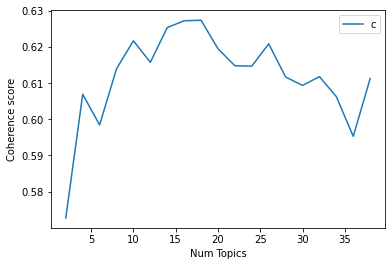

In [137]:
# Show graph
limit=40; start=2; step=2;
x = range(start, limit, step)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(("coherence_values"), loc='best')
plt.show()

In [138]:
# Print the coherence scores
for m, cv in zip(x, coherence_values):
    print("Num Topics =", m, " has Coherence Value of", round(cv, 4))

Num Topics = 2  has Coherence Value of 0.5727
Num Topics = 4  has Coherence Value of 0.6069
Num Topics = 6  has Coherence Value of 0.5984
Num Topics = 8  has Coherence Value of 0.614
Num Topics = 10  has Coherence Value of 0.6217
Num Topics = 12  has Coherence Value of 0.6158
Num Topics = 14  has Coherence Value of 0.6254
Num Topics = 16  has Coherence Value of 0.6272
Num Topics = 18  has Coherence Value of 0.6274
Num Topics = 20  has Coherence Value of 0.6195
Num Topics = 22  has Coherence Value of 0.6148
Num Topics = 24  has Coherence Value of 0.6147
Num Topics = 26  has Coherence Value of 0.6209
Num Topics = 28  has Coherence Value of 0.6117
Num Topics = 30  has Coherence Value of 0.6094
Num Topics = 32  has Coherence Value of 0.6118
Num Topics = 34  has Coherence Value of 0.6063
Num Topics = 36  has Coherence Value of 0.5953
Num Topics = 38  has Coherence Value of 0.6113


In [139]:
#display topics in data frame
#https://medium.com/swlh/topic-modeling-lda-mallet-implementation-in-python-part-2-602ffb38d396
tm_results = ldamallet[corpus]

In [140]:
topics = [[(term, round(wt, 3)) for term, wt in ldamallet.show_topic(n, topn=20)] for n in range(0, ldamallet.num_topics)]

In [141]:
topics_df = pd.DataFrame([[term for term, wt in topic] for topic in topics], columns = ['Term'+str(i) for i in range(1, 21)], index=['Topic '+str(t) for t in range(1, ldamallet.num_topics+1)]).T
topics_df

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14
Term1,work,meter,sugar,ac,fast,doctor,change,feel,diet,people,issue,insulin,eat,bread
Term2,time,insurance,blood,month,hour,test,life,time,low,post,problem,type,carbs,rice
Term3,exercise,reading,high,weight,meal,result,great,family,keto,health,symptom,body,food,add
Term4,walk,check,glucose,year,bg,advice,lot,year,carb,question,pain,resistance,drink,cheese
Term5,bit,strip,level,lose,metformin,talk,thing,felt,fat,medical,foot,gt,water,egg
Term6,long,libre,normal,start,morning,doc,work,thought,body,understand,effect,disease,cut,potato
Term7,pretty,sensor,low,med,time,give,dr,happen,protein,research,bad,people,meal,meat
Term8,day,finger,range,diagnose,number,diagnose,make,care,calorie,information,eye,medication,carb,cream
Term9,start,cover,control,metformin,week,endo,learn,make,lot,study,year,risk,avoid,fruit
Term10,minute,cgm,number,week,mg,read,hope,deal,liver,read,damage,cure,lot,veggie


In [142]:
# set column width
pd.set_option('display.max_colwidth', -1)
topics_df = pd.DataFrame([', '.join([term for term, wt in topic]) for topic in topics], columns = ['Terms per Topic'], index=['Topic'+str(t) for t in range(1, ldamallet.num_topics+1)] )
topics_df

<ipython-input-142-22448409583d>:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


,Terms per Topic
Topic1,"work, time, exercise, walk, bit, long, pretty, day, start, minute, run, ill, thing, week, stress, home, stay, big, lot, hit"
Topic2,"meter, insurance, reading, check, strip, libre, sensor, finger, cover, cgm, free, pay, app, stick, test, track, buy, freestyle, monitor, difference"
Topic3,"sugar, blood, high, glucose, level, normal, low, range, control, number, spike, check, average, mgdl, raise, point, fast, affect, measure, test"
Topic4,"ac, month, weight, year, lose, start, med, diagnose, metformin, week, diet, stop, lb, change, medication, drop, loss, exercise, pound, control"
Topic5,"fast, hour, meal, bg, metformin, morning, time, number, week, mg, night, eat, effect, day, start, low, dinner, breakfast, sleep, reading"
Topic6,"doctor, test, result, advice, talk, doc, give, diagnose, endo, read, appointment, wait, endocrinologist, follow, diagnosis, time, thought, adjust, mention, idea"
Topic7,"change, life, great, lot, thing, work, dr, make, learn, hope, luck, live, easy, control, love, healthy, manage, hard, lifestyle, sound"
Topic8,"feel, time, family, year, felt, thought, happen, care, make, deal, mom, friend, turn, kind, super, shit, die, guess, hard, suck"
Topic9,"diet, low, keto, carb, fat, body, protein, calorie, lot, liver, carbs, healthy, process, cholesterol, reduce, energy, high, carbohydrate, intake, muscle"
Topic10,"people, post, health, question, medical, understand, research, information, study, read, answer, agree, link, support, comment, patient, diabetic, base, opinion, group"


In [143]:
#export list of topics
topics_df.to_csv('diabetes_all_topics.csv', index = False)

In [144]:
#https://www.machinelearningplus.com/nlp/topic-modeling-gensim-python/
#https://medium.com/swlh/topic-modeling-lda-mallet-implementation-in-python-part-2-602ffb38d396

from gensim.models.ldamodel import LdaModel

def convertldaMalletToldaGen(mallet_model):
    model_gensim = LdaModel(
        id2word=mallet_model.id2word, num_topics=mallet_model.num_topics,
        alpha=mallet_model.alpha) 
    model_gensim.state.sstats[...] = mallet_model.wordtopics
    model_gensim.sync_state()
    return model_gensim

In [145]:
ldagensim = convertldaMalletToldaGen(ldamallet)

In [146]:
import pyLDAvis.gensim as gensimvis
vis_data = gensimvis.prepare(ldagensim, corpus, id2word, sort_topics=False)
pyLDAvis.display(vis_data)

IndexError: index 14 is out of bounds for axis 0 with size 14

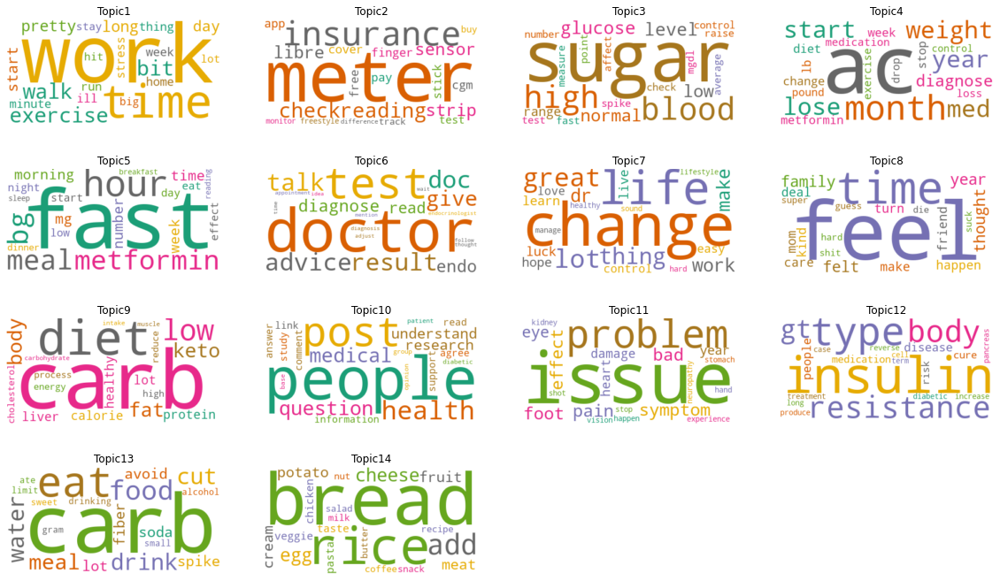

In [147]:
#word cloud
# initiate wordcloud object
wc = WordCloud(background_color="white", colormap="Dark2", max_font_size=150, random_state=42)

# set the figure size
plt.rcParams['figure.figsize'] = [20, 15]

# Create subplots for each topic
for i in range(28):

    wc.generate(text=topics_df["Terms per Topic"][i])
    
    plt.subplot(5, 4, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.title(topics_df.index[i])

plt.show()

In [153]:
#revalue row index
diabetes_all.index = range(85265)
diabetes_all

,Post ID,Author,Publish Date,Text,text_lemmatized,Permalink,Title,month_year
0,7ng7rl,penguinsarefun,2018-01-01 9:16,"Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. I've been crazy fatigued and thirsty x many months. My fasting glucose that morning was 151. I was started on metformin and trulicity and have been eating very well since then. I already feel better, generally less hungry and tired. My fasting glucose has been 100-110 every morning since. I'm looking forward to this journey!","[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, glucose, morning, start, metformin, trulicity, eat, feel, better, generally, hungry, tire, fast, glucose, morning, look, forward, journey]",/r/diabetes/comments/7ng7rl/t2_newbie/,T2 Newbie,2018-01
1,7nlbda,MrCanoe,2018-01-02 0:58,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now as a way to lose weight and hopefully lower the medication i'm on. I currently take 3 metformin, 1 Gliclazide and 1 Jardiance a day(5 pills total) How risky is doing the Keto diet if i'm on that much medication? The jardiance(also called empagliflozin) is new as My A1C had risen from mid 5's to 7.0 in 2017. One of the reasons was I got a new doctor in late 2016 and my old doctor had me on 3 metformin's and 2 Gliclazide's a day and on that I was getting 5.4-5.7 A1C but my new doctor told me A1C's in the 5's was bad for a diabetic and that Gliclazide isn't to great for your heart. So he reduced it down to 1. Problem became though I still wasn't eating great with bad habits(too much snacking and having a meal before bed since I work 10 hour days and don't get home till 1 am) so my A1C went back up till it hit 7 so he put me on the Jardiance(rather expensive drug). So I feel like a failure. I had brought up Keto with him last summer but he just deflected me and said ""Huh, oh I think that's one of those starvation diets isn't it?, no don't do that just eat right and exercise"" So what i'm getting at with this the rambling is if I start Keto how likely will I experience hypoglycemic episodes if I start this diet?","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin, gliclazide, jardiance, pill, total, risky, keto, diet, medication, jardiancealso, call, empagliflozin, new, ac, risen, mid, reason, get, new, doctor, late, old, doctor, metformin, gliclazides, get, ac, new, doctor, ac, gliclazide, great, heart, reduce, problem, wasnt, eat, great, habitstoo, snack, meal, bed, work, hour, day, home, till, ac, go, till, hit, jardiancerather, expensive, drug, feel, failure, brought, keto, summer, deflect, say, huh, oh, think, starvation, diet, eat, right, exercise, get, ramble, start, keto, likely, experience, hypoglycemic, episode, start, diet]",/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Looking into Keto diet, how serious are risks of hypoglycemia?",2018-01
2,7nnmor,Heylola2,2018-01-02 8:55,"I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being taken off metformin (and I'll be tested again in three months to see) and I'm just so excited but I don't have anyone else to share this news with \nI'm honestly shocked, I thought maybe it would be down a couple decimal points at most, based off what I read\n\nI have a deskcycle and I try to get my steps in every day (currently at a 6,000/day goal) and I've been trying (somewhat successfully) to eat healthier and I've lost 20 pounds (started off at 260, I'm going to try to keep losing)\n\nanyone else have good news or a good drive/motivation to work hard at it this new year?","[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, honestly, shock, thought, maybe, couple, decimal, point, base, read, deskcycle, try, step, currently, goal, try, somewhat, successfully, eat, healthier, lose, pound, 

In [155]:
#find weight of each topic per row
#https://medium.com/swlh/topic-modeling-lda-mallet-implementation-in-python-part-3-ab03e01b7cd7
topic_weights_all = pd.DataFrame.from_records([{v: k for v, k in row} for row in tm_results])
topic_weights_all.columns = ['Topic ' + str(i) for i in range(1,15)]
topic_weights_all

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14
0,0.054302,0.046992,0.079156,0.124478,0.123016,0.063074,0.073308,0.087928,0.046992,0.054302,0.073308,0.067460,0.058688,0.046992
1,0.055684,0.038658,0.035074,0.181132,0.132744,0.083461,0.044931,0.067332,0.113927,0.038658,0.069124,0.059268,0.049411,0.030594
2,0.083847,0.061625,0.044631,0.155742,0.057703,0.100840,0.120448,0.060317,0.053782,0.055089,0.043324,0.069468,0.051167,0.042017
3,0.115216,0.080733,0.061576,0.061576,0.063492,0.067323,0.096059,0.061576,0.061576,0.082649,0.061576,0.063492,0.061576,0.061576
4,0.144873,0.063744,0.061980,0.056689,0.097254,0.056689,0.063744,0.074326,0.056689,0.058453,0.072562,0.056689,0.076090,0.060217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85260,0.067385,0.071578,0.067385,0.067385,0.077868,0.067385,0.067385,0.067385,0.075771,0.075771,0.075771,0.084157,0.067385,0.067385
85261,0.063776,0.063776,0.065760,0.097506,0.113379,0.063776,0.063776,0.067744,0.081633,0.063776,0.063776,0.063776,0.063776,0.063776
85262,0.090852,0.046992,0.061612,0.108396,0.051378,0.083542,0.065998,0.155180,0.055764,0.063074,0.049916,0.071846,0.046992,0.048454
85263,0.087187,0.059811,0.051760,0.071084,0.103290,0.063032,0.066253,0.109731,0.051760,0.067863,0.082356,0.056591,0.077525,0.051760


In [156]:
#convert date to date time object
diabetes_all['month_year'] = pd.to_datetime(diabetes_all['Publish Date']).dt.to_period('M')
diabetes_all

,Post ID,Author,Publish Date,Text,text_lemmatized,Permalink,Title,month_year
0,7ng7rl,penguinsarefun,2018-01-01 9:16,"Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. I've been crazy fatigued and thirsty x many months. My fasting glucose that morning was 151. I was started on metformin and trulicity and have been eating very well since then. I already feel better, generally less hungry and tired. My fasting glucose has been 100-110 every morning since. I'm looking forward to this journey!","[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, glucose, morning, start, metformin, trulicity, eat, feel, better, generally, hungry, tire, fast, glucose, morning, look, forward, journey]",/r/diabetes/comments/7ng7rl/t2_newbie/,T2 Newbie,2018-01
1,7nlbda,MrCanoe,2018-01-02 0:58,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now as a way to lose weight and hopefully lower the medication i'm on. I currently take 3 metformin, 1 Gliclazide and 1 Jardiance a day(5 pills total) How risky is doing the Keto diet if i'm on that much medication? The jardiance(also called empagliflozin) is new as My A1C had risen from mid 5's to 7.0 in 2017. One of the reasons was I got a new doctor in late 2016 and my old doctor had me on 3 metformin's and 2 Gliclazide's a day and on that I was getting 5.4-5.7 A1C but my new doctor told me A1C's in the 5's was bad for a diabetic and that Gliclazide isn't to great for your heart. So he reduced it down to 1. Problem became though I still wasn't eating great with bad habits(too much snacking and having a meal before bed since I work 10 hour days and don't get home till 1 am) so my A1C went back up till it hit 7 so he put me on the Jardiance(rather expensive drug). So I feel like a failure. I had brought up Keto with him last summer but he just deflected me and said ""Huh, oh I think that's one of those starvation diets isn't it?, no don't do that just eat right and exercise"" So what i'm getting at with this the rambling is if I start Keto how likely will I experience hypoglycemic episodes if I start this diet?","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin, gliclazide, jardiance, pill, total, risky, keto, diet, medication, jardiancealso, call, empagliflozin, new, ac, risen, mid, reason, get, new, doctor, late, old, doctor, metformin, gliclazides, get, ac, new, doctor, ac, gliclazide, great, heart, reduce, problem, wasnt, eat, great, habitstoo, snack, meal, bed, work, hour, day, home, till, ac, go, till, hit, jardiancerather, expensive, drug, feel, failure, brought, keto, summer, deflect, say, huh, oh, think, starvation, diet, eat, right, exercise, get, ramble, start, keto, likely, experience, hypoglycemic, episode, start, diet]",/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Looking into Keto diet, how serious are risks of hypoglycemia?",2018-01
2,7nnmor,Heylola2,2018-01-02 8:55,"I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being taken off metformin (and I'll be tested again in three months to see) and I'm just so excited but I don't have anyone else to share this news with \nI'm honestly shocked, I thought maybe it would be down a couple decimal points at most, based off what I read\n\nI have a deskcycle and I try to get my steps in every day (currently at a 6,000/day goal) and I've been trying (somewhat successfully) to eat healthier and I've lost 20 pounds (started off at 260, I'm going to try to keep losing)\n\nanyone else have good news or a good drive/motivation to work hard at it this new year?","[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, honestly, shock, thought, maybe, couple, decimal, point, base, read, deskcycle, try, step, currently, goal, try, somewhat, successfully, eat, healthier, lose, pound, 

In [157]:
#find topics per month / year
#topic_weights2018['month'] = diabetes2018["Publish Date"].dt.month
#topic_weights2018['year'] = diabetes2018["Publish Date"].dt.year
topic_weights_all['month_year'] = diabetes_all.month_year
topic_weights_all

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,month_year
0,0.054302,0.046992,0.079156,0.124478,0.123016,0.063074,0.073308,0.087928,0.046992,0.054302,0.073308,0.067460,0.058688,0.046992,2018-01
1,0.055684,0.038658,0.035074,0.181132,0.132744,0.083461,0.044931,0.067332,0.113927,0.038658,0.069124,0.059268,0.049411,0.030594,2018-01
2,0.083847,0.061625,0.044631,0.155742,0.057703,0.100840,0.120448,0.060317,0.053782,0.055089,0.043324,0.069468,0.051167,0.042017,2018-01
3,0.115216,0.080733,0.061576,0.061576,0.063492,0.067323,0.096059,0.061576,0.061576,0.082649,0.061576,0.063492,0.061576,0.061576,2018-03
4,0.144873,0.063744,0.061980,0.056689,0.097254,0.056689,0.063744,0.074326,0.056689,0.058453,0.072562,0.056689,0.076090,0.060217,2018-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85260,0.067385,0.071578,0.067385,0.067385,0.077868,0.067385,0.067385,0.067385,0.075771,0.075771,0.075771,0.084157,0.067385,0.067385,2021-02
85261,0.063776,0.063776,0.065760,0.097506,0.113379,0.063776,0.063776,0.067744,0.081633,0.063776,0.063776,0.063776,0.063776,0.063776,2021-02
85262,0.090852,0.046992,0.061612,0.108396,0.051378,0.083542,0.065998,0.155180,0.055764,0.063074,0.049916,0.071846,0.046992,0.048454,2021-02
85263,0.087187,0.059811,0.051760,0.071084,0.103290,0.063032,0.066253,0.109731,0.051760,0.067863,0.082356,0.056591,0.077525,0.051760,2021-02


In [158]:
#find dominant topic of the record
topic_weights_all['Dominant'] = topic_weights_all.drop('month_year', axis=1).idxmax(axis=1)
topic_weights_all

,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,month_year,Dominant
0,0.054302,0.046992,0.079156,0.124478,0.123016,0.063074,0.073308,0.087928,0.046992,0.054302,0.073308,0.067460,0.058688,0.046992,2018-01,Topic 4
1,0.055684,0.038658,0.035074,0.181132,0.132744,0.083461,0.044931,0.067332,0.113927,0.038658,0.069124,0.059268,0.049411,0.030594,2018-01,Topic 4
2,0.083847,0.061625,0.044631,0.155742,0.057703,0.100840,0.120448,0.060317,0.053782,0.055089,0.043324,0.069468,0.051167,0.042017,2018-01,Topic 4
3,0.115216,0.080733,0.061576,0.061576,0.063492,0.067323,0.096059,0.061576,0.061576,0.082649,0.061576,0.063492,0.061576,0.061576,2018-03,Topic 1
4,0.144873,0.063744,0.061980,0.056689,0.097254,0.056689,0.063744,0.074326,0.056689,0.058453,0.072562,0.056689,0.076090,0.060217,2018-05,Topic 1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85260,0.067385,0.071578,0.067385,0.067385,0.077868,0.067385,0.067385,0.067385,0.075771,0.075771,0.075771,0.084157,0.067385,0.067385,2021-02,Topic 12
85261,0.063776,0.063776,0.065760,0.097506,0.113379,0.063776,0.063776,0.067744,0.081633,0.063776,0.063776,0.063776,0.063776,0.063776,2021-02,Topic 5
85262,0.090852,0.046992,0.061612,0.108396,0.051378,0.083542,0.065998,0.155180,0.055764,0.063074,0.049916,0.071846,0.046992,0.048454,2021-02,Topic 8
85263,0.087187,0.059811,0.051760,0.071084,0.103290,0.063032,0.066253,0.109731,0.051760,0.067863,0.082356,0.056591,0.077525,0.051760,2021-02,Topic 8


In [159]:
#extract topic weighting
topic_weights_all.to_csv('topic_weight_all.csv', index = False)

In [160]:
#percentage of dominant topics per a month
topic_dominant_all = topic_weights_all.groupby('month_year')['Dominant'].value_counts(normalize=True).unstack()
topic_dominant_all

Dominant,Topic 1,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9
month_year,,,,,,,,,,,,,,
2018-01,0.068966,0.097701,0.068966,0.068966,0.074713,0.091954,0.022989,0.057471,0.097701,0.068966,0.057471,0.074713,0.063218,0.086207
2018-02,0.050409,0.098093,0.046322,0.095368,0.050409,0.084469,0.084469,0.053134,0.066757,0.104905,0.077657,0.072207,0.047684,0.068120
2018-03,0.066236,0.110662,0.068659,0.080775,0.033926,0.059774,0.085622,0.040388,0.063813,0.094507,0.119548,0.051696,0.067851,0.056543
2018-04,0.046711,0.116301,0.060057,0.060057,0.056244,0.102955,0.051478,0.074357,0.083889,0.075310,0.076263,0.067684,0.059104,0.069590
2018-05,0.043779,0.103687,0.047235,0.055300,0.065668,0.152074,0.047235,0.076037,0.078341,0.104839,0.047235,0.055300,0.035714,0.087558
2018-06,0.045655,0.113402,0.055228,0.069219,0.099411,0.117084,0.047865,0.051546,0.062592,0.103093,0.060383,0.053756,0.047865,0.072901
2018-07,0.056788,0.091393,0.055901,0.089618,0.054126,0.077196,0.091393,0.074534,0.079858,0.060337,0.063886,0.079858,0.058563,0.066548
2018-08,0.074074,0.080933,0.064472,0.082305,0.035665,0.048011,0.111111,0.075446,0.074074,0.068587,0.072702,0.074074,0.067215,0.071331
2018-09,0.053712,0.107425,0.067930,0.048973,0.052133,0.085308,0.060032,0.053712,0.096367,0.091627,0.067930,0.083728,0.071090,0.060032


In [161]:
#dominant topic by year
topic_dominant_all['Dominant'] = topic_dominant_all.idxmax(axis=1)
topic_dominant_all

Dominant,Topic 1,Topic 10,Topic 11,Topic 12,Topic 13,Topic 14,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7,Topic 8,Topic 9,Dominant
month_year,,,,,,,,,,,,,,,
2018-01,0.068966,0.097701,0.068966,0.068966,0.074713,0.091954,0.022989,0.057471,0.097701,0.068966,0.057471,0.074713,0.063218,0.086207,Topic 10
2018-02,0.050409,0.098093,0.046322,0.095368,0.050409,0.084469,0.084469,0.053134,0.066757,0.104905,0.077657,0.072207,0.047684,0.068120,Topic 5
2018-03,0.066236,0.110662,0.068659,0.080775,0.033926,0.059774,0.085622,0.040388,0.063813,0.094507,0.119548,0.051696,0.067851,0.056543,Topic 6
2018-04,0.046711,0.116301,0.060057,0.060057,0.056244,0.102955,0.051478,0.074357,0.083889,0.075310,0.076263,0.067684,0.059104,0.069590,Topic 10
2018-05,0.043779,0.103687,0.047235,0.055300,0.065668,0.152074,0.047235,0.076037,0.078341,0.104839,0.047235,0.055300,0.035714,0.087558,Topic 14
2018-06,0.045655,0.113402,0.055228,0.069219,0.099411,0.117084,0.047865,0.051546,0.062592,0.103093,0.060383,0.053756,0.047865,0.072901,Topic 14
2018-07,0.056788,0.091393,0.055901,0.089618,0.054126,0.077196,0.091393,0.074534,0.079858,0.060337,0.063886,0.079858,0.058563,0.066548,Topic 10
2018-08,0.074074,0.080933,0.064472,0.082305,0.035665,0.048011,0.111111,0.075446,0.074074,0.068587,0.072702,0.074074,0.067215,0.071331,Topic 2
2018-09,0.053712,0.107425,0.067930,0.048973,0.052133,0.085308,0.060032,0.053712,0.096367,0.091627,0.067930,0.083728,0.071090,0.060032,Topic 10


In [162]:
topic_dominant_all.to_csv('topic_dominant_all.csv', index = False)

In [163]:
#merge dataframes together
diabetes_all['Dominant'] = topic_weights_all['Dominant']
diabetes_all['month_year'] = topic_weights_all['month_year']
diabetes_all

,Post ID,Author,Publish Date,Text,text_lemmatized,Permalink,Title,month_year,Dominant
0,7ng7rl,penguinsarefun,2018-01-01 9:16,"Hey all! Happy New year's! Just wanted to say hi. I was diagnosed with type 2 DM on Thursday. I've been crazy fatigued and thirsty x many months. My fasting glucose that morning was 151. I was started on metformin and trulicity and have been eating very well since then. I already feel better, generally less hungry and tired. My fasting glucose has been 100-110 every morning since. I'm looking forward to this journey!","[happy, new, year, want, diagnose, type, dm, thursday, crazy, fatigue, thirsty, x, month, fast, glucose, morning, start, metformin, trulicity, eat, feel, better, generally, hungry, tire, fast, glucose, morning, look, forward, journey]",/r/diabetes/comments/7ng7rl/t2_newbie/,T2 Newbie,2018-01,Topic 4
1,7nlbda,MrCanoe,2018-01-02 0:58,"Hello I'm a 6'1, 260lbs male with Type 2 diabetes. I've been looking into Keto for a while now as a way to lose weight and hopefully lower the medication i'm on. I currently take 3 metformin, 1 Gliclazide and 1 Jardiance a day(5 pills total) How risky is doing the Keto diet if i'm on that much medication? The jardiance(also called empagliflozin) is new as My A1C had risen from mid 5's to 7.0 in 2017. One of the reasons was I got a new doctor in late 2016 and my old doctor had me on 3 metformin's and 2 Gliclazide's a day and on that I was getting 5.4-5.7 A1C but my new doctor told me A1C's in the 5's was bad for a diabetic and that Gliclazide isn't to great for your heart. So he reduced it down to 1. Problem became though I still wasn't eating great with bad habits(too much snacking and having a meal before bed since I work 10 hour days and don't get home till 1 am) so my A1C went back up till it hit 7 so he put me on the Jardiance(rather expensive drug). So I feel like a failure. I had brought up Keto with him last summer but he just deflected me and said ""Huh, oh I think that's one of those starvation diets isn't it?, no don't do that just eat right and exercise"" So what i'm getting at with this the rambling is if I start Keto how likely will I experience hypoglycemic episodes if I start this diet?","[lb, male, type, look, keto, way, lose, weight, hopefully, low, medication, currently, metformin, gliclazide, jardiance, pill, total, risky, keto, diet, medication, jardiancealso, call, empagliflozin, new, ac, risen, mid, reason, get, new, doctor, late, old, doctor, metformin, gliclazides, get, ac, new, doctor, ac, gliclazide, great, heart, reduce, problem, wasnt, eat, great, habitstoo, snack, meal, bed, work, hour, day, home, till, ac, go, till, hit, jardiancerather, expensive, drug, feel, failure, brought, keto, summer, deflect, say, huh, oh, think, starvation, diet, eat, right, exercise, get, ramble, start, keto, likely, experience, hypoglycemic, episode, start, diet]",/r/diabetes/comments/7nlbda/looking_into_keto_diet_how_serious_are_risks_of/,"Looking into Keto diet, how serious are risks of hypoglycemia?",2018-01,Topic 4
2,7nnmor,Heylola2,2018-01-02 8:55,"I had my a1c checked today and it's at 5.1!!! Three/four months ago it was at 7.9! \nI'm being taken off metformin (and I'll be tested again in three months to see) and I'm just so excited but I don't have anyone else to share this news with \nI'm honestly shocked, I thought maybe it would be down a couple decimal points at most, based off what I read\n\nI have a deskcycle and I try to get my steps in every day (currently at a 6,000/day goal) and I've been trying (somewhat successfully) to eat healthier and I've lost 20 pounds (started off at 260, I'm going to try to keep losing)\n\nanyone else have good news or a good drive/motivation to work hard at it this new year?","[ac, checked, today, threefour, month, take, metformin, ill, test, month, excite, share, news, honestly, shock, thought, maybe, couple, decimal, point, base, read, deskcycle, try, step, currently, goal, try, somewhat, successfully, eat,

In [164]:
#export dataframe
diabetes_all.to_csv('diabetes_all_lda.csv', index = False)